In [2]:
import glob
import astropy
import importlib
import math
import numpy as np
import xlwt
import xlsxwriter
import warnings
warnings.filterwarnings('ignore')

from xlwt import Workbook
from reduct_funcs import funcs_calib_and_plot
from reduct_funcs import funcs_star_finder
from reduct_funcs import funcs_apt_phot
from reduct_funcs import funcs_utils

importlib.reload(funcs_calib_and_plot)
importlib.reload(funcs_star_finder)
importlib.reload(funcs_apt_phot)
importlib.reload(funcs_utils)

<module 'reduct_funcs.funcs_utils' from 'C:\\Users\\afiq-Astro\\Desktop\\TSSP\\reductions_4\\reduct_funcs\\funcs_utils.py'>

In [3]:
#fp = 'C:/Users/afiq-Astro/Desktop/TSSP/reductions_4/files_sorted/2020-04-30'
#funcs_utils.make_dir(fp )

In [3]:
#Takes into consideration the pol flat
MJD = '2020-04-18'
pol_flat_MJD = 'moaf' #26 was the first flat thing
p_3 = 'P3-R'
p_1 = 'P1-R'
target_name='EE_Cep'

bias = glob.glob('./files_sorted/'+MJD+'/bias/*')
dark = glob.glob('./files_sorted/'+MJD+'/dark/*')
p_1_pol_std_flat = glob.glob('./files_sorted/pol_flats/'+pol_flat_MJD+'/'+p_1 +'/*')
p_3_pol_std_flat = glob.glob('./files_sorted/pol_flats/'+pol_flat_MJD+'/'+p_3 +'/*')

target = glob.glob('./files_sorted/'+MJD+'/'+target_name+'/*')
pol_std = glob.glob('./files_sorted/'+MJD+'/pol_std/*')

print("Bias:", str(len(bias))+".", 
      "Dark:", str(len(dark))+".", 
      "p_1 Flat:", str(len(p_1_pol_std_flat))+".",
      "p_3 Flat:", str(len(p_3_pol_std_flat))+".", 
      "Target:", str(len(target))+".", 
      "Polarization Standard:", str(len(pol_std))+".")

funcs_calib_and_plot.file_splits(bias)
funcs_calib_and_plot.file_splits(dark)
funcs_calib_and_plot.file_splits(p_1_pol_std_flat)
funcs_calib_and_plot.file_splits(p_3_pol_std_flat)
funcs_calib_and_plot.file_splits(target)
funcs_calib_and_plot.file_splits(pol_std)

Bias: 30. Dark: 15. p_1 Flat: 121. p_3 Flat: 79. Target: 100. Polarization Standard: 20.
zero {'bias'} Filters: [('N-B', 30)] 
dark {'dark'} Filters: [('N-B', 15)] 
flat {'flat'} Filters: [('P1-R', 121)] 
flat {'flat'} Filters: [('P3-R', 79)] 
object {'EE Cet'} Filters: [('P1-R', 50), ('P3-R', 50)] total 33.0 min exposure time
object {'OJ287'} Filters: [('P1-R', 10), ('P3-R', 10)] total 30.0 min exposure time


In [4]:
#m_biast, m_dark, m_flat = funcs_calib_and_plot.make_calib_files(bias, dark, flat) #unable to make 

m_biast, m_dark, p_1_m_flat = funcs_calib_and_plot.make_calib_files(bias, dark, p_1_pol_std_flat)
m_biast, m_dark, p_3_m_flat = funcs_calib_and_plot.make_calib_files(bias, dark, p_3_pol_std_flat)

#Where do the R bands start?

In [6]:
funcs_utils.print_list(MJD, target)

2020-04-18
0 21:22:54.46 P1-R 20.0 EE Cet
1 21:23:46.07 P1-R 20.0 EE Cet
2 21:24:37.55 P1-R 20.0 EE Cet
3 21:25:28.97 P1-R 20.0 EE Cet
4 21:26:20.40 P1-R 20.0 EE Cet
5 21:27:11.83 P1-R 20.0 EE Cet
6 21:28:03.26 P1-R 20.0 EE Cet
7 21:28:54.70 P1-R 20.0 EE Cet
8 21:29:46.12 P1-R 20.0 EE Cet
9 21:30:37.54 P1-R 20.0 EE Cet
10 21:31:28.96 P1-R 20.0 EE Cet
11 21:32:20.47 P1-R 20.0 EE Cet
12 21:33:11.86 P1-R 20.0 EE Cet
13 21:34:03.34 P1-R 20.0 EE Cet
14 21:34:54.78 P1-R 20.0 EE Cet
15 21:35:46.21 P1-R 20.0 EE Cet
16 21:36:37.63 P1-R 20.0 EE Cet
17 21:37:29.07 P1-R 20.0 EE Cet
18 21:38:20.55 P1-R 20.0 EE Cet
19 21:39:11.98 P1-R 20.0 EE Cet
20 21:40:03.41 P1-R 20.0 EE Cet
21 21:40:54.90 P1-R 20.0 EE Cet
22 21:41:46.34 P1-R 20.0 EE Cet
23 21:42:37.82 P1-R 20.0 EE Cet
24 21:43:29.24 P1-R 20.0 EE Cet
25 21:44:20.67 P1-R 20.0 EE Cet
26 21:45:12.11 P1-R 20.0 EE Cet
27 21:46:03.53 P1-R 20.0 EE Cet
28 21:46:54.93 P1-R 20.0 EE Cet
29 21:47:46.45 P1-R 20.0 EE Cet
30 21:48:37.87 P1-R 20.0 EE Cet
31 21:4

In [35]:
#Question, what else is a zero polarization standard star
#607-504
#zeroeing is important

#51 to 102

#Ok. New Procedure. For Each time you run the pipe. Look at all your targets

#Its dope that you are astronomer enough to notice that they are upside down. I recognize these stars!

#Write your loops as you need them

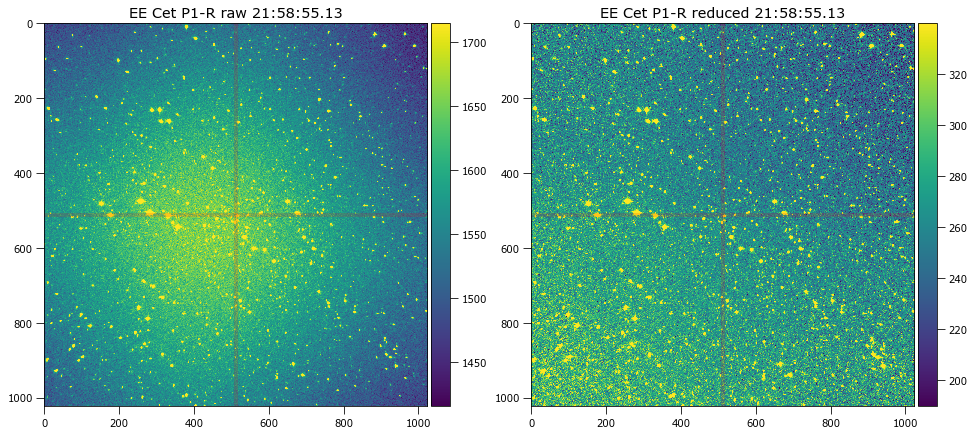

<Figure size 1008x1008 with 0 Axes>

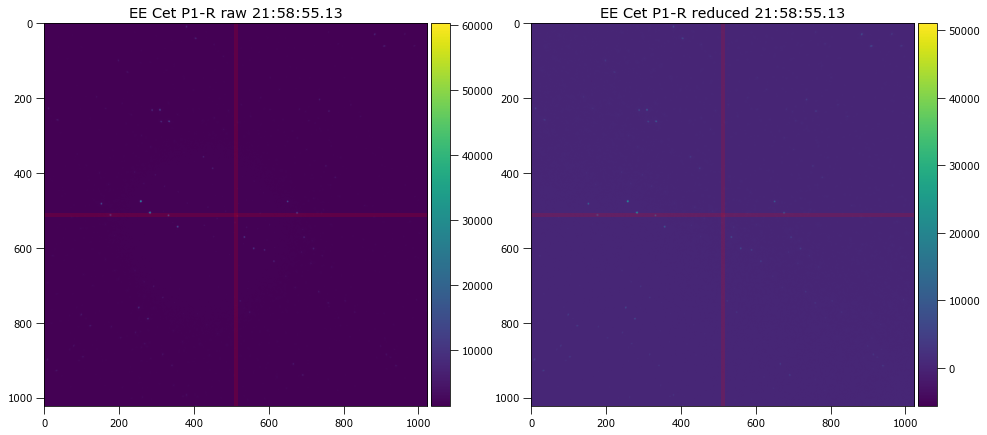

<Figure size 1008x1008 with 0 Axes>

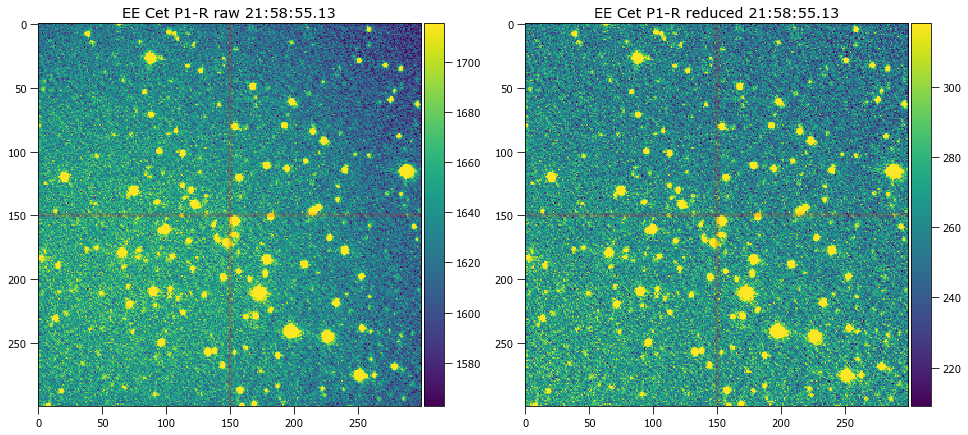

<Figure size 1008x1008 with 0 Axes>

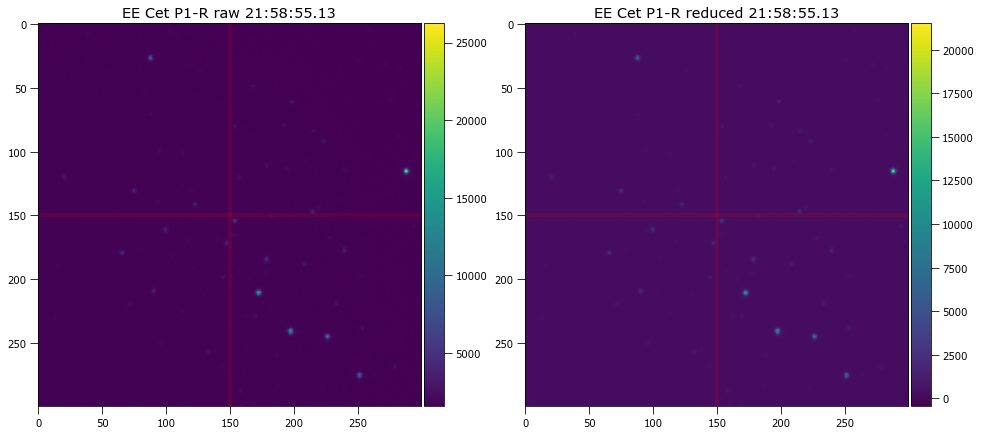

<Figure size 1008x1008 with 0 Axes>

In [15]:
#If target not detected by DAO, use the location of the peak finder...
#your pipeline is macklunky. but it works
target_n=42

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[target_n]),
                                    [512, 512, 512, 512], 
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    True, True, True) 

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[target_n]),
                                    [512, 512, 512, 512], 
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    False, True, True) 

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[target_n]),
                                    [512, 512, 150, 150], 
                                    (m_biast, m_dark,  p_1_m_flat), 
                                    True, True, True) 

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[target_n]),
                                    [512, 512, 150, 150], 
                                    (m_biast, m_dark,  p_1_m_flat),
                                    False, True, True) 

#I want that gradient to disappear

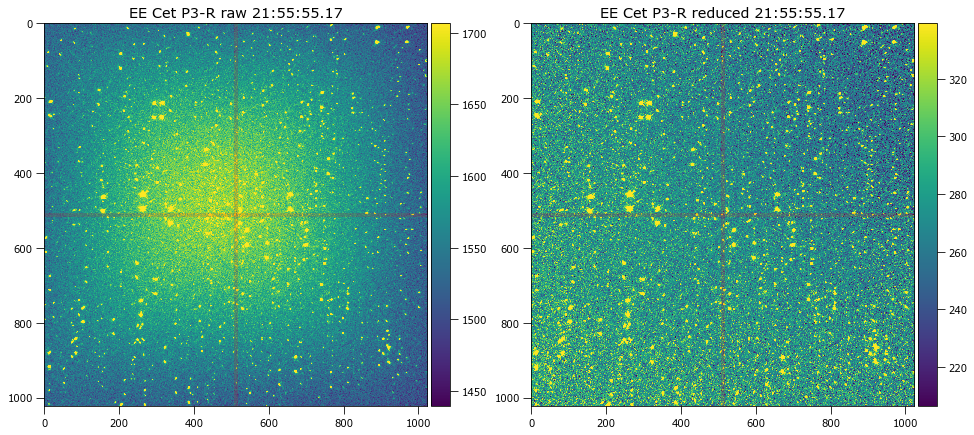

<Figure size 1008x1008 with 0 Axes>

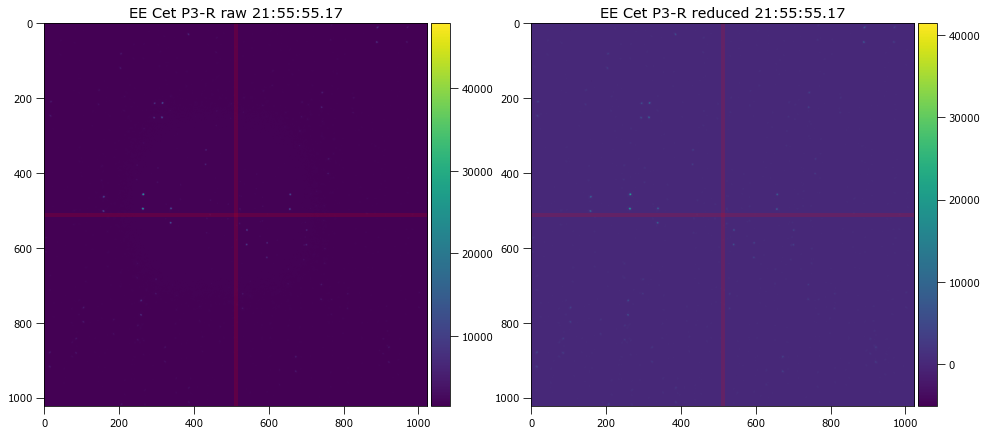

<Figure size 1008x1008 with 0 Axes>

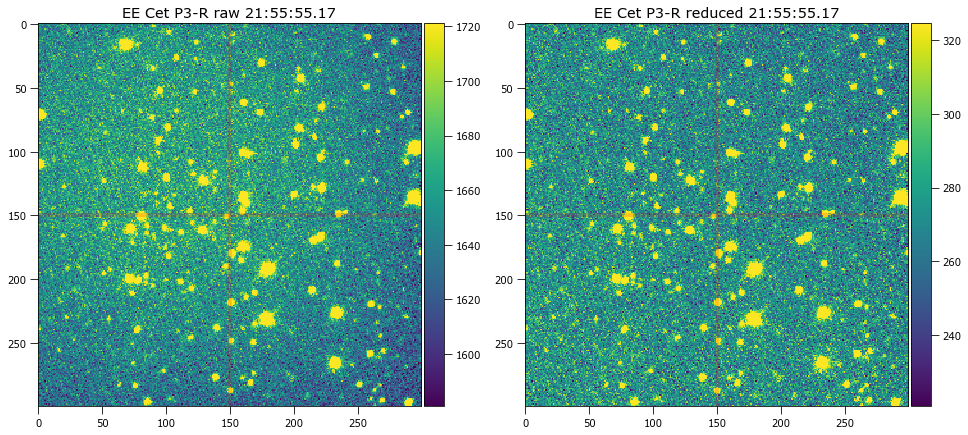

<Figure size 1008x1008 with 0 Axes>

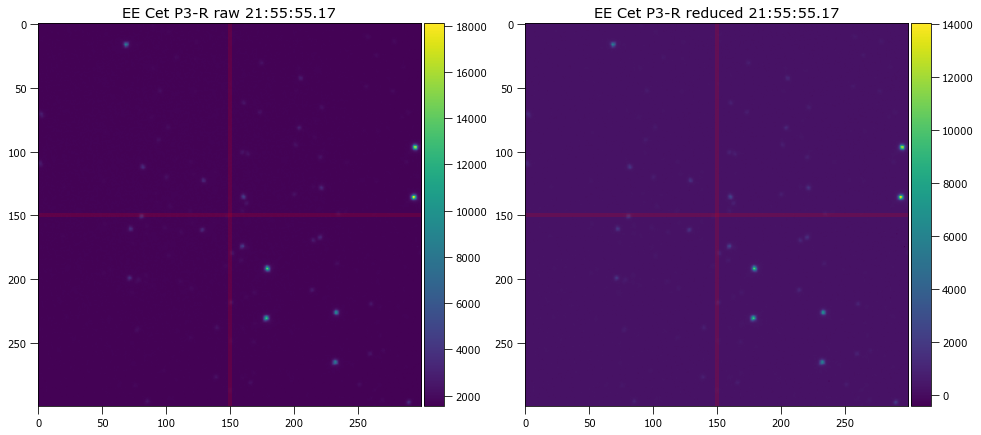

<Figure size 1008x1008 with 0 Axes>

In [26]:
#If target not detected by DAO, use the location of the peak finder...
#your pipeline is macklunky. but it works
target_n=88

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[target_n]),
                                    [512, 512, 512, 512], 
                                    (m_biast, m_dark,  p_3_m_flat), 
                                    True, True, True) 

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[target_n]),
                                    [512, 512, 512, 512], 
                                    (m_biast, m_dark,  p_3_m_flat), 
                                    False, True, True) 

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[target_n]),
                                    [512, 512, 150, 150], 
                                    (m_biast, m_dark,  p_3_m_flat), 
                                    True, True, True) 

reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[target_n]),
                                    [512, 512, 150, 150], 
                                    (m_biast, m_dark,  p_3_m_flat),
                                    False, True, True) 

In [30]:
#I'm looking at the pol std star through a p1 - r filter

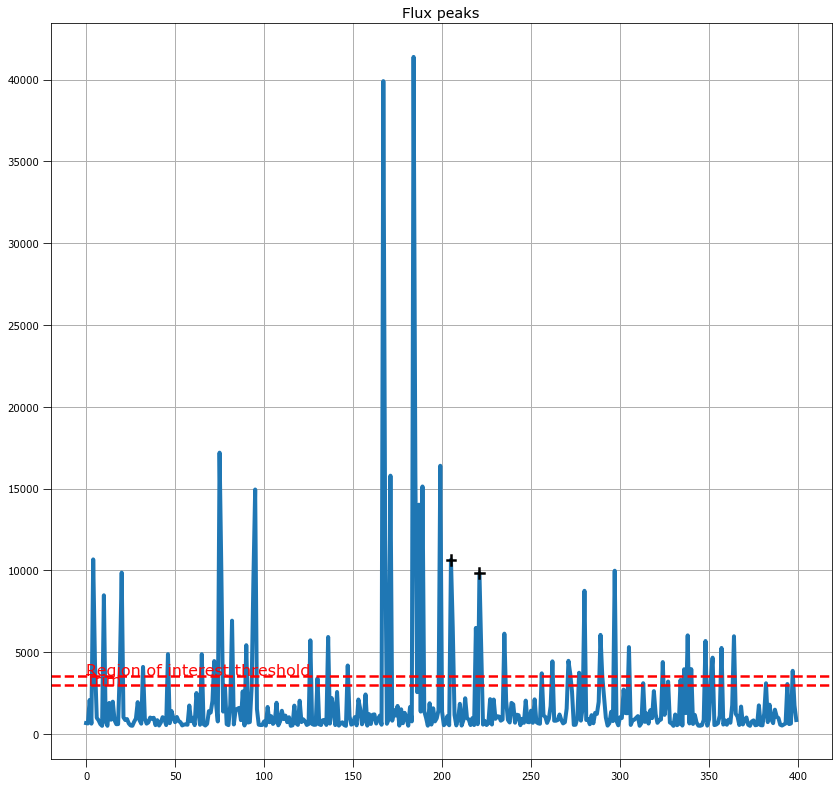

400 peaks detected from image of size 1024 x 1024 with sigma: 3 and threshold: 3562.4205996326987 valid
Targets within region of interest:  2


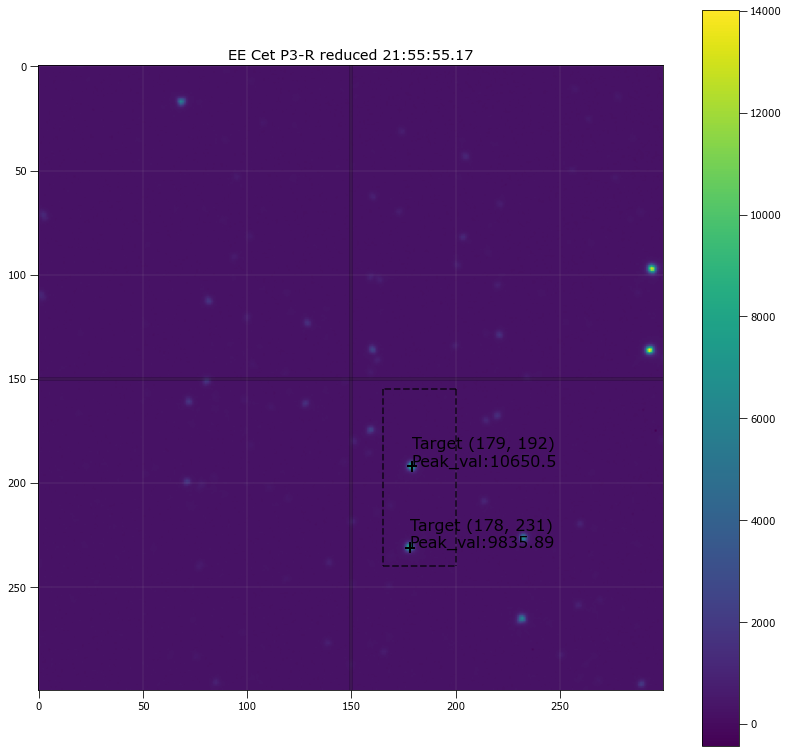

Aperture positions are: [(541, 554), (540, 593)] from the 1024 x 1024 image
Aperture positions are: [(179, 192), (178, 231)] from the 150 x 150 image


In [28]:
search_off = 150
search_bracket = [-5, 90, -15, 50]
x_targ, y_targ, peak_targ  = funcs_star_finder.source_peak_finder(reduced_obj,3,search_bracket,3000 , True, True) #what do I return from this?
apt_pos = funcs_star_finder.plot_spotted(reduced_obj, search_off, search_bracket,x_targ, y_targ, peak_targ, True, False)

apt_positions = []
for h in range(0 , len(x_targ)):
    apt_positions.append((x_targ[h], y_targ[h])) #This must undergo some translation    
    
print("Aperture positions are:", apt_positions, "from the", reduced_obj[0].header['NAXIS1'], "x", reduced_obj[0].header['NAXIS2'], "image")
print("Aperture positions are:", apt_pos, "from the", str(search_off), "x", str(search_off) ,"image")

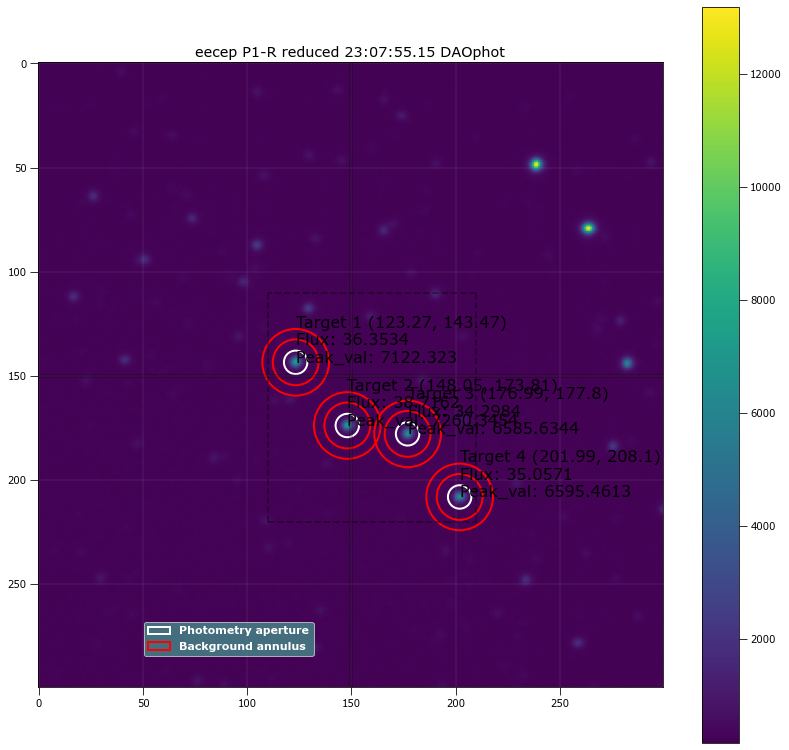

In [56]:
#DAO star finder
siegma_search = 3
DAO_positions = funcs_star_finder.dao_star_finder(reduced_obj, search_bracket, siegma_search , 2000, 150, 5.62, 11 , 16, True, False) #siegma and offset
#print("Positions of aperture from DAO",DAO_positions, "within the region of interest")
#phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, 100, DAO_positions,  5.62, 11 , 17, False  )

In [57]:
#Its like an injection, make the output of the first star finder equal to the input of DAO starfinder

print("Results of the First Star Finder:")
print(apt_positions, "aperture positions from the", reduced_obj[0].header['NAXIS1'], "x", reduced_obj[0].header['NAXIS2'], "image")
print(apt_pos, "aperture positions from the", str(search_off), "x", str(search_off) ,"image")
print("\n")
print([list(x) for x in  DAO_positions], "\naperture positions from DAO positions")

Results of the First Star Finder:
[(485, 505), (510, 536), (539, 540), (564, 570)] aperture positions from the 1024 x 1024 image
[(123, 143), (148, 174), (177, 178), (202, 208)] aperture positions from the 150 x 150 image


[[123.2675201532751, 143.46627533197469], [148.05382209073528, 173.80566469317804], [176.99192622479873, 177.80284871966387], [201.98723047621854, 208.09942845425388]] 
aperture positions from DAO positions


Good radii: 4.559322033898305


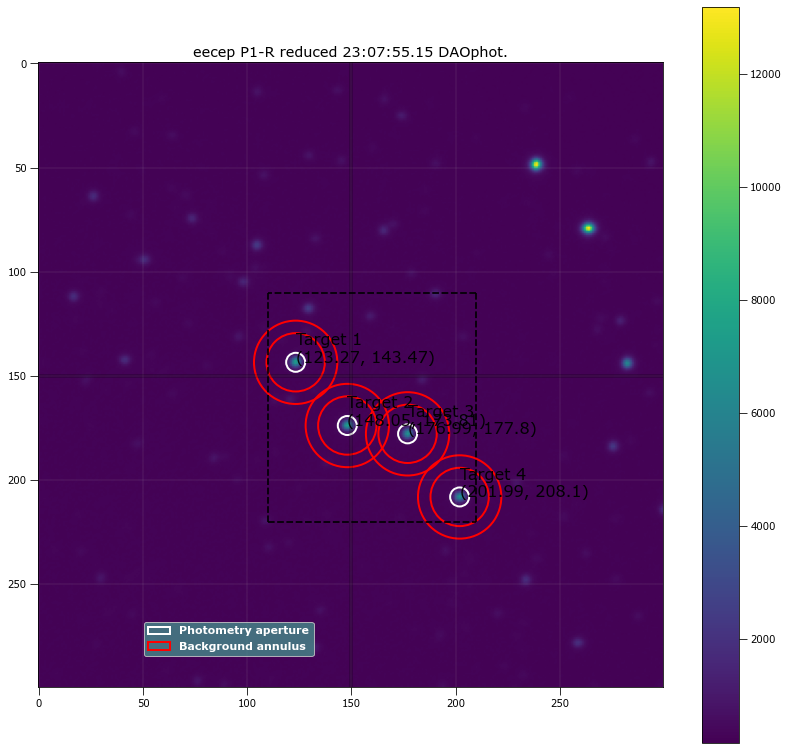

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 123.26752 143.46628 ...          2367.7118      182906.52          750.76198
  2 148.05382 173.80566 ...          2370.4181      165023.63          654.95787
  3 176.99193 177.80285 ...          2113.8525         162437          643.42809
  4 201.98723 208.09943 ...          2103.9078      165107.25          654.94492

 Aperture are: 65.30559781856107 Annulus Area: 640.8849013323178 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 123.26752 143.46628 ...                 2291.2098             131098.74
  2 148.05382 173.80566 ...                 2303.6785        

In [59]:
trial_radii = np.linspace(3.0, 7, num=60) #tries different radii
target_a = []
target_b = []
target_c = []
target_d = []

for radii in trial_radii:
    #Its this loop thats taking up the compute time
    DAO_positions = funcs_star_finder.dao_star_finder(reduced_obj, search_bracket, siegma_search , 2500, 150, 5.62, 11 , 16, False, False) 
    
    #print("DAO positions original:", len(DAO_positions) )
    
    if (len(DAO_positions) != 4):
        DAO_positions = funcs_star_finder.peak_to_DAO(apt_pos)
    
    #print("New DAO positions:", len(DAO_positions))
    
    phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, 150,search_bracket , DAO_positions, radii, 14 , 20, False,False)
    target_a.append(phot_tab['residual_aperture_sum'][0])
    target_b.append(phot_tab['residual_aperture_sum'][1])
    target_c.append(phot_tab['residual_aperture_sum'][2])
    target_d.append(phot_tab['residual_aperture_sum'][3])
    
combine_target = [target_a, target_b, target_c, target_d]

good_radii=funcs_apt_phot.solve_apt(combine_target, trial_radii, False)

print("Good radii:",good_radii)

phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, 150, search_bracket ,DAO_positions,good_radii, 14 , 20, True, False)

In [ ]:
#write an exception. If it cannot find anything. Then reduce the siegma. Or better yet just go for another set of coordinates

#1 and 4, 2 and 3

P1-R Filter


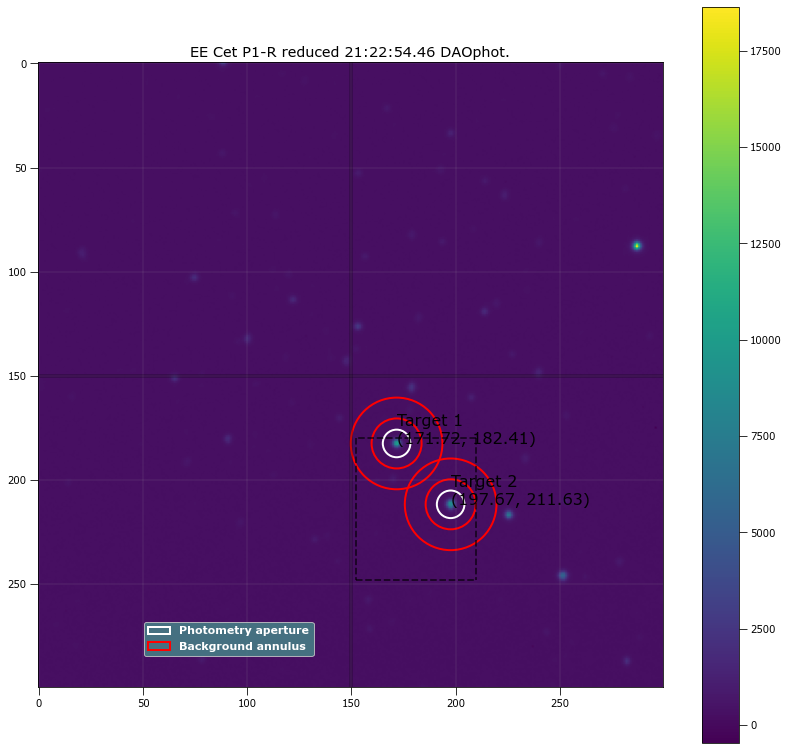

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 171.71753 182.41246 ...          2584.8646      330505.24           1025.495
  2  197.6663 211.63257 ...          2466.2571      314649.79          965.65227

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 171.71753 182.41246 ...                 2452.6188             115707.91
  2  197.6663 211.63257 ...                 2341.7285             119449.76

Write this out the excel
0 21:22:54.46 P1-R 20.0 6.621610169491525 171.71753265221048 182.4124641492194 115707.90715032798 2452.618832234769 197.

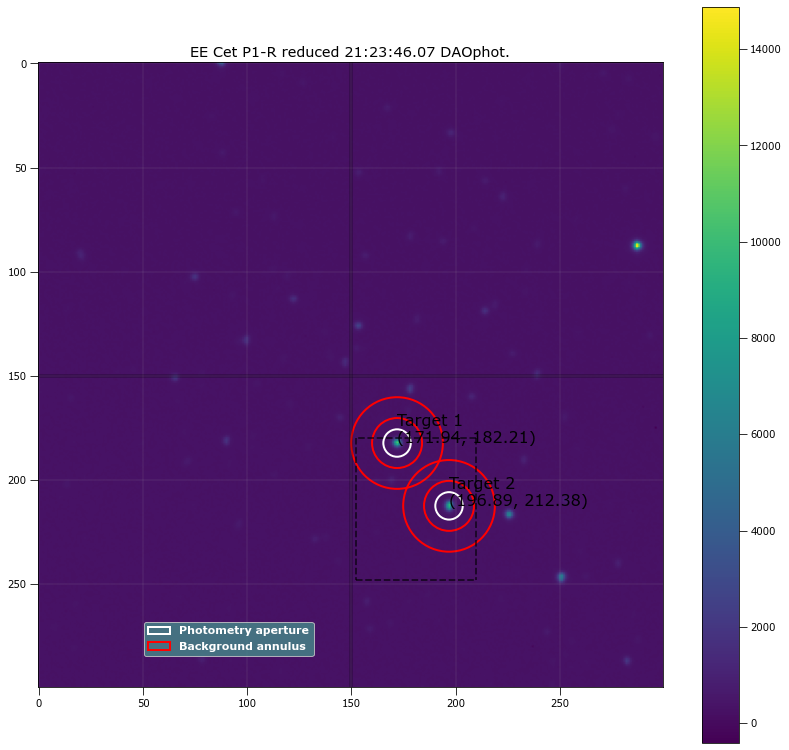

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 171.93893 182.21458 ...          2500.3224      343314.18          1063.9281
  2 196.88537 212.37661 ...          2452.3539      332011.73            1018.76

 Aperture are: 136.18086893684796 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 171.93893 182.21458 ...                 2364.6787             111250.27
  2 196.88537 212.37661 ...                 2322.4689             114562.94

Write this out the excel
1 21:23:46.07 P1-R 20.0 6.5838983050847455 171.93892641426032 182.21458208026098 111250.27103728593 2364.6787093437956 

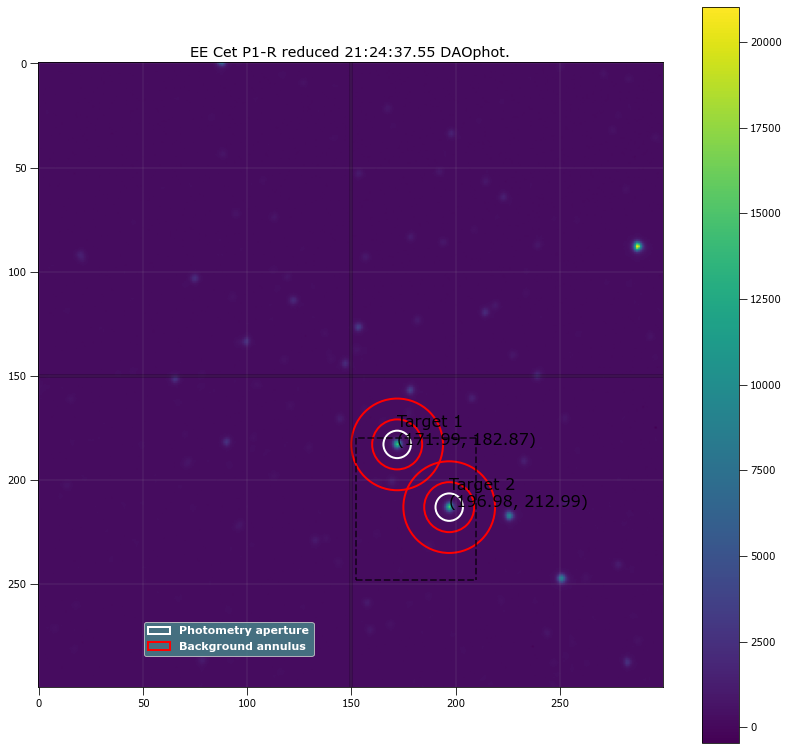

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  171.9886 182.87224 ...          3530.8504      287103.23          913.07918
  2 196.97659 212.98882 ...          3574.0274      269322.76          829.29584

 Aperture are: 136.18086893684796 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  171.9886 182.87224 ...                 3414.4389              167074.4
  2 196.97659 212.98882 ...                 3468.2978             172581.81

Write this out the excel
2 21:24:37.55 P1-R 20.0 6.5838983050847455 171.98860410643786 182.87224492666437 167074.40199901158 3414.4389109260474 

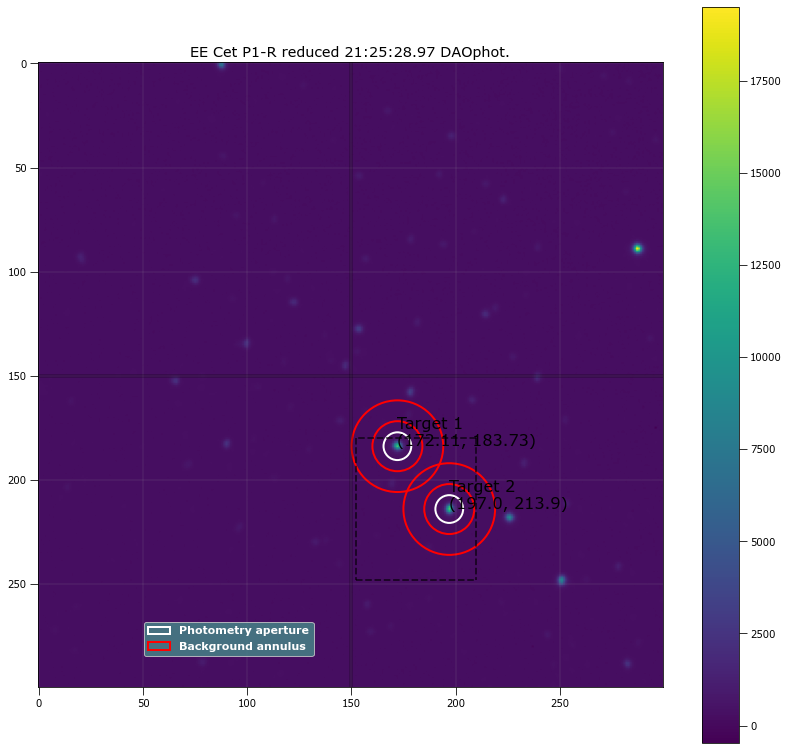

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.10523 183.73405 ...          3294.7837      299716.32          947.81442
  2 196.99728 213.90246 ...          3400.0197      284008.44          873.79615

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.10523 183.73405 ...                 3171.1592             155676.55
  2 196.99728 213.90246 ...                 3286.0495              161263.4

Write this out the excel
3 21:25:28.97 P1-R 20.0 6.659322033898304 172.10523151992138 183.73405032493392 155676.55191672064 3171.15924457405 196

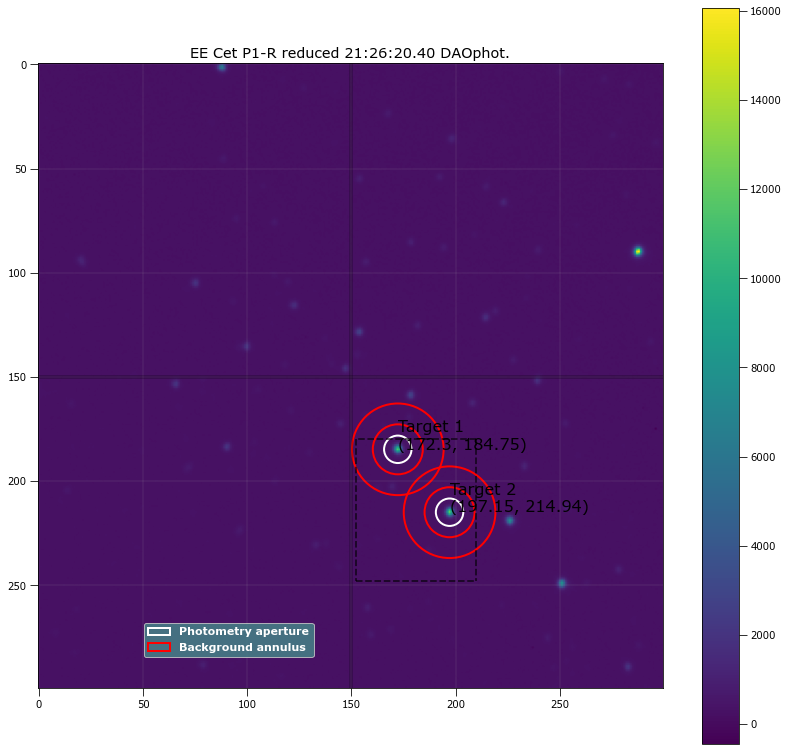

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.29513 184.75227 ...          2797.5938      320879.64          1001.9594
  2 197.15136 214.94322 ...          2901.7057         307897          946.10055

 Aperture are: 136.18086893684796 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.29513 184.75227 ...                 2669.8507             128553.05
  2 197.15136 214.94322 ...                 2781.0842             133523.87

Write this out the excel
4 21:26:20.40 P1-R 20.0 6.5838983050847455 172.2951275079004 184.75226556746 128553.04973522783 2669.850701346611 197.1

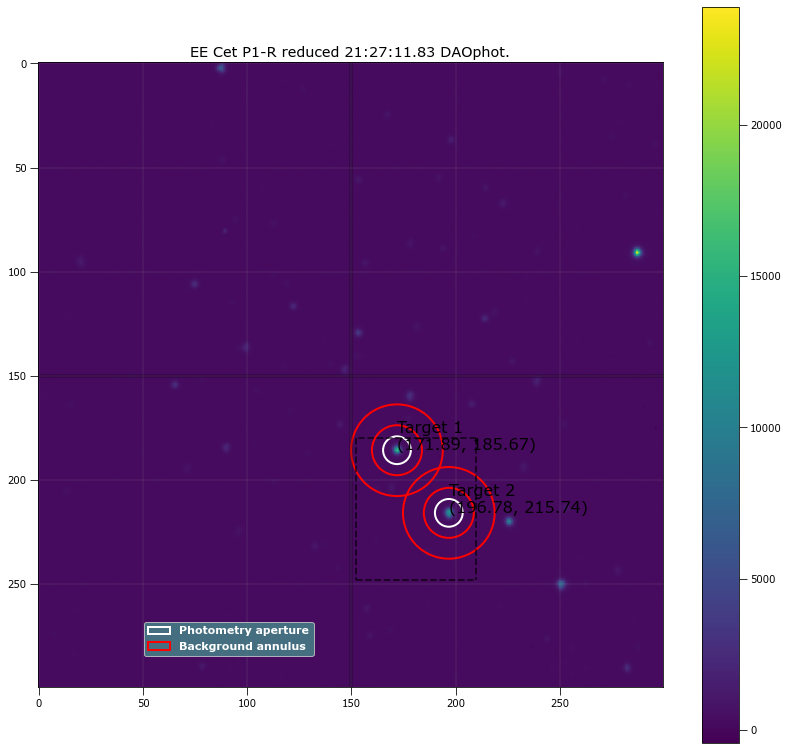

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 171.89352 185.66733 ...          3565.3581      301293.51          950.90242
  2 196.78213 215.73645 ...          3289.8368      284227.32          874.57161

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 171.89352 185.66733 ...                 3441.3308             156040.33
  2 196.78213 215.73645 ...                 3175.7655             161080.11

Write this out the excel
5 21:27:11.83 P1-R 20.0 6.659322033898304 171.8935182995221 185.6673343232546 156040.3289620922 3441.330845144823 196.7

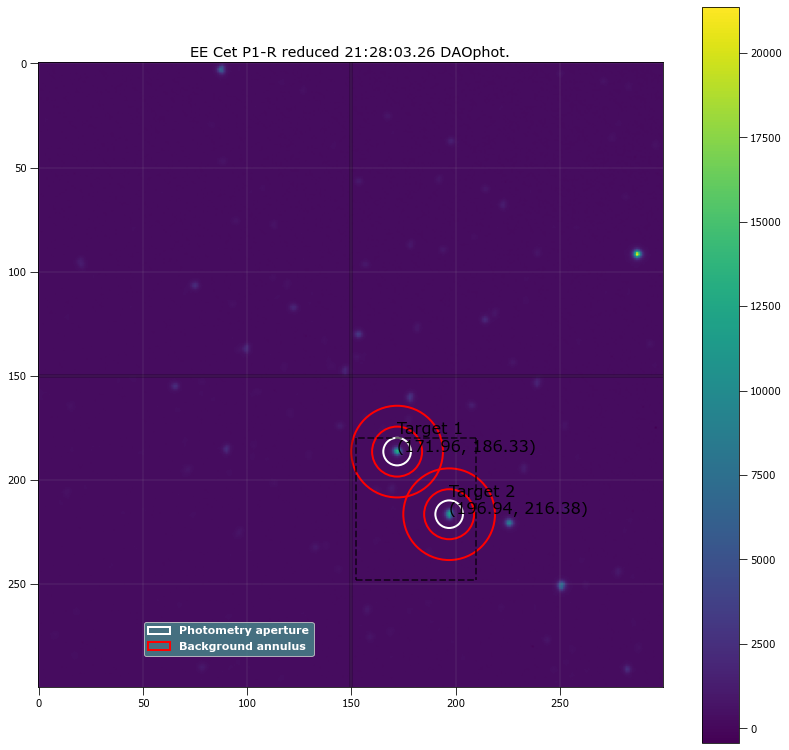

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 171.96015 186.32633 ...          3126.4188      314911.45          987.10432
  2 196.94312 216.38353 ...          3031.1473      300531.86          923.66825

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 171.96015 186.32633 ...                 2999.1238             136053.06
  2 196.94312 216.38353 ...                 2912.0329             140503.57

Write this out the excel
6 21:28:03.26 P1-R 20.0 6.621610169491525 171.96015036076514 186.32633055278845 136053.06013009913 2999.123837854713 196

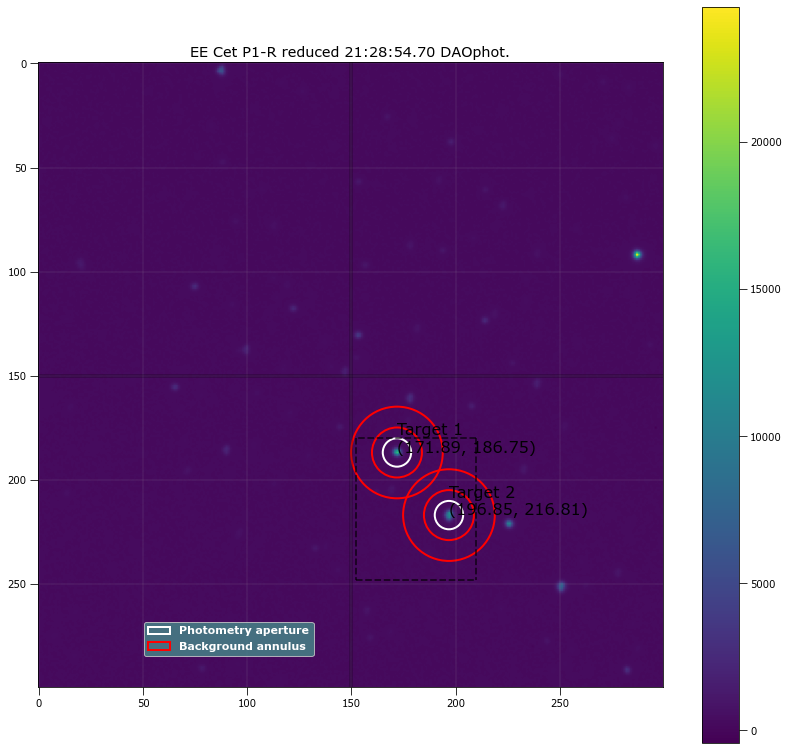

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 171.89168 186.75203 ...          3525.1565      299917.16          945.63554
  2  196.8478 216.81029 ...          3225.8512      282115.14          867.90423

 Aperture are: 145.7020674391651 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 171.89168 186.75203 ...                 3396.1651             151644.97
  2  196.8478 216.81029 ...                 3107.4629             158094.75

Write this out the excel
7 21:28:54.70 P1-R 20.0 6.810169491525423 171.8916787503428 186.75203009132446 151644.96851673594 3396.165074325552 196.

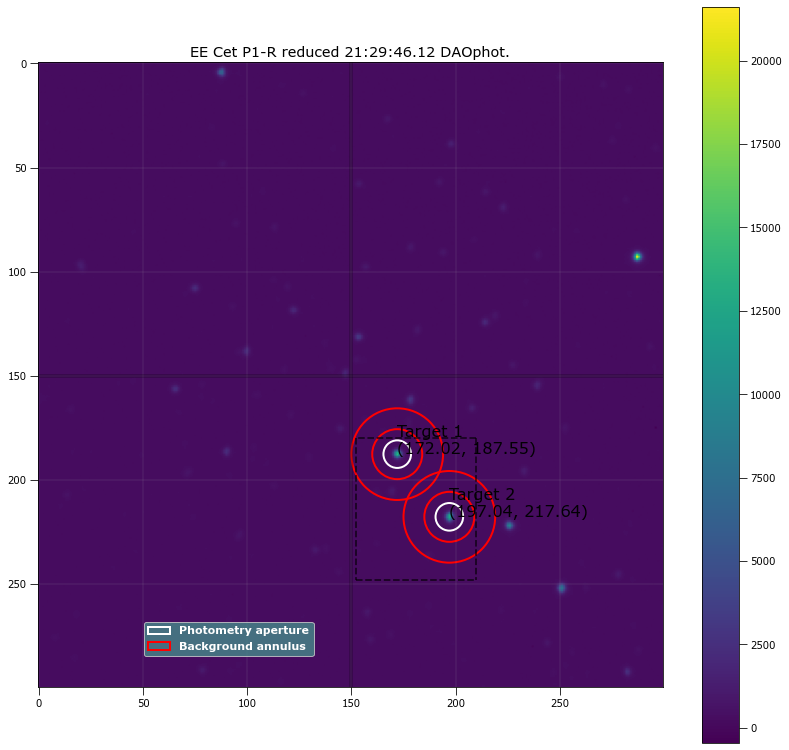

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.02476 187.54962 ...          3216.4927      308713.26          970.07114
  2 197.03719  217.6422 ...          3142.2107      293513.33          902.49669

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.02476 187.54962 ...                 3091.3942             140182.01
  2 197.03719  217.6422 ...                 3025.8265             144817.83

Write this out the excel
8 21:29:46.12 P1-R 20.0 6.621610169491525 172.02476254360204 187.54962244665867 140182.0135040392 3091.394215222046 197.

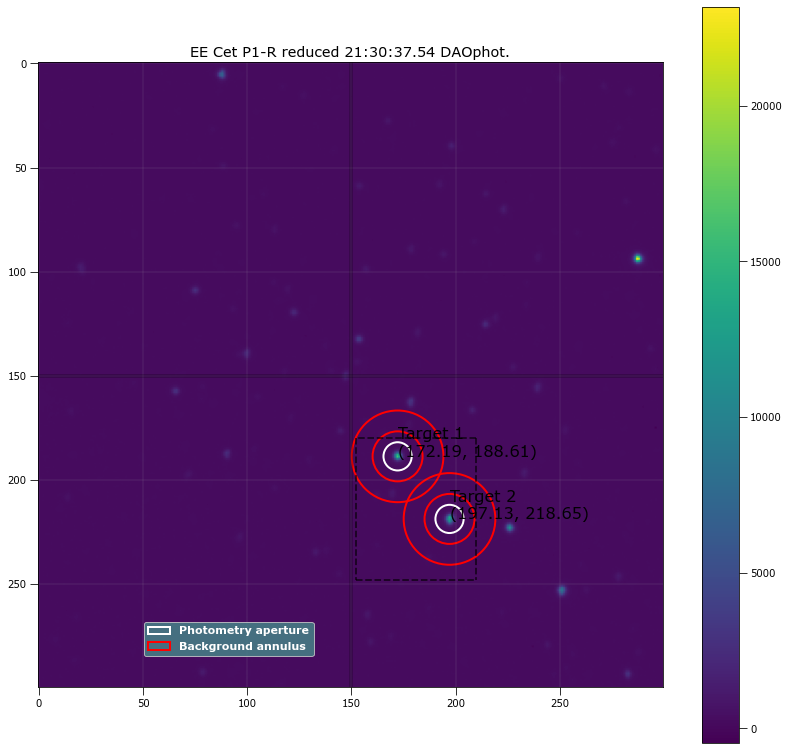

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.19339 188.60678 ...          3585.3258      295709.92          936.33063
  2 197.12839 218.64736 ...          3386.1224      278198.44          856.19406

 Aperture are: 144.0928613968168 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.19339 188.60678 ...                 3459.0143             153872.84
  2 197.12839 218.64736 ...                 3270.6213             159580.09

Write this out the excel
9 21:30:37.54 P1-R 20.0 6.772457627118643 172.19338762899443 188.6067839043488 153872.83980470334 3459.014328455709 197.

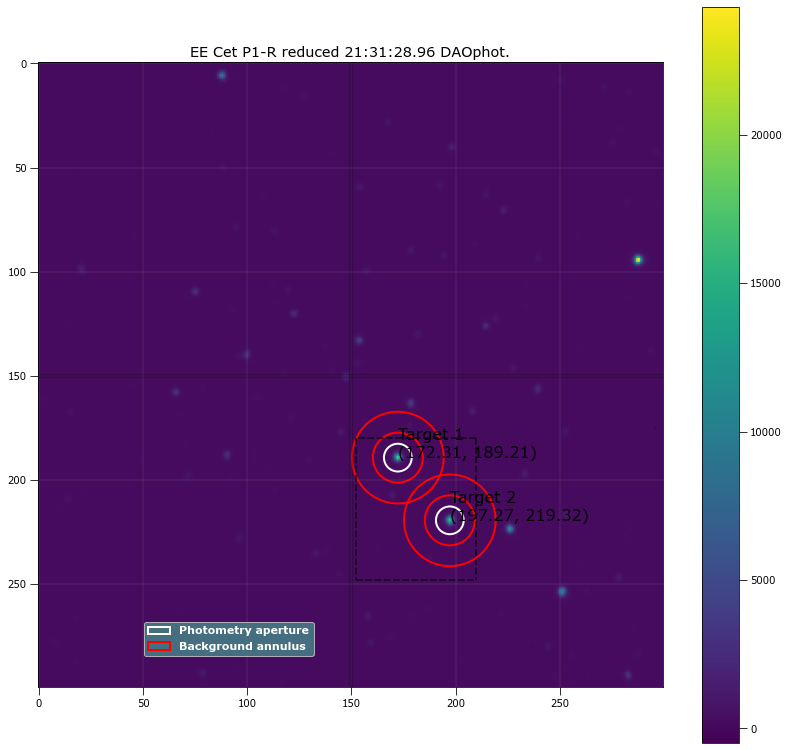

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.31088 189.21412 ...          4148.9349      269641.33          873.41839
  2 197.27073 219.32157 ...           4038.488      248943.11          769.10679

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.31088 189.21412 ...                  4035.014             182737.81
  2 197.27073 219.32157 ...                 3938.1725             188652.23

Write this out the excel
10 21:31:28.96 P1-R 20.0 6.659322033898304 172.3108829175446 189.21411774243535 182737.81042235036 4035.0139555490214 1

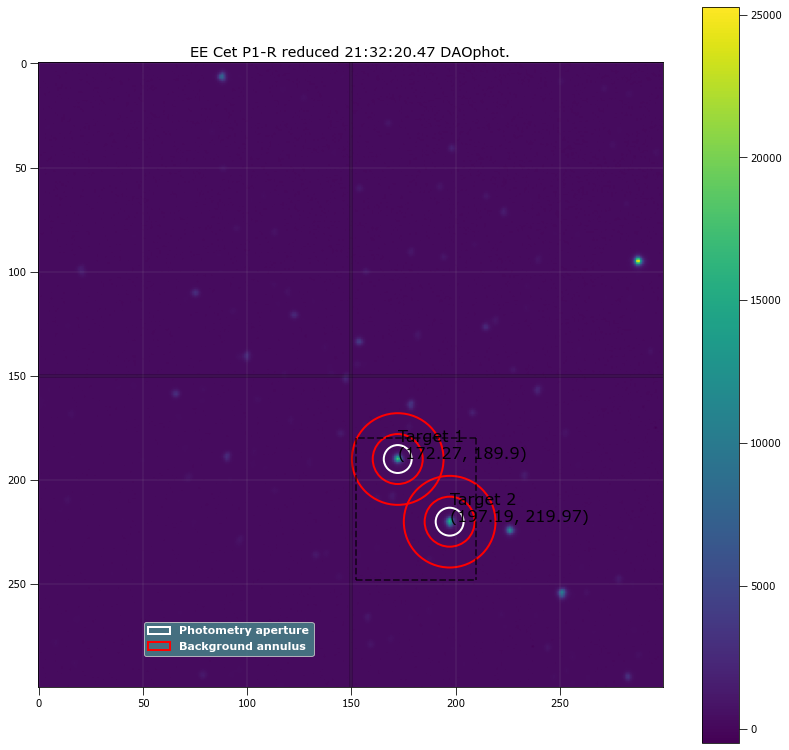

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.26526 189.89522 ...          3990.1398      274069.29          882.17453
  2 197.18816 219.97073 ...          3856.6349      254839.53          786.49153

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.26526 189.89522 ...                   3873.77             175984.89
  2 197.18816 219.97073 ...                 3752.8868             181666.58

Write this out the excel
11 21:32:20.47 P1-R 20.0 6.697033898305085 172.2652580771709 189.8952224391318 175984.89014943517 3873.769952898347 197

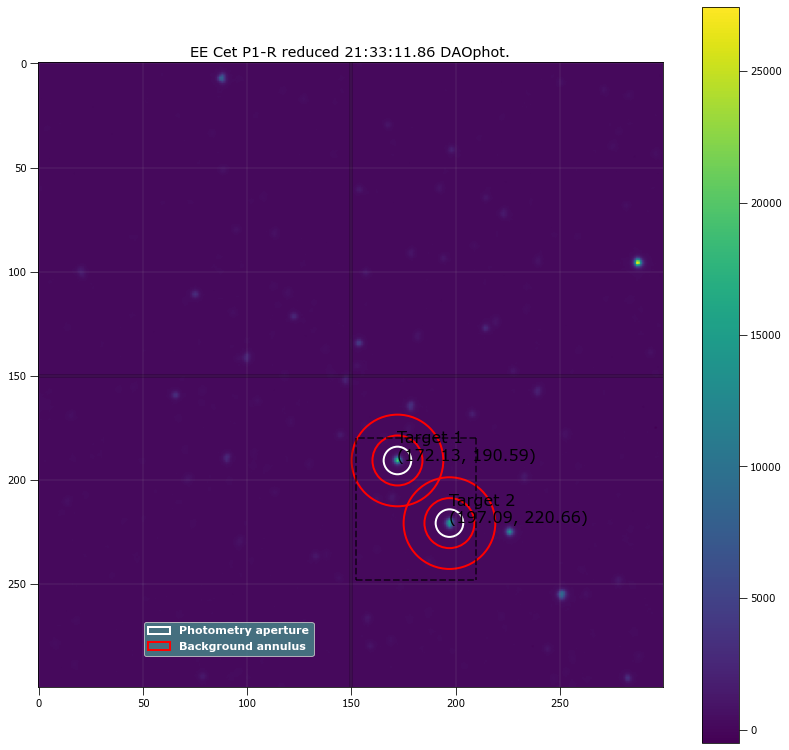

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.13416 190.58667 ...          4271.1936      268062.38          866.38437
  2 197.09369  220.6634 ...          3933.8713      248127.86          765.98248

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.13416 190.58667 ...                 4159.4664             182041.36
  2 197.09369  220.6634 ...                 3835.0917             188420.91

Write this out the excel
12 21:33:11.86 P1-R 20.0 6.621610169491525 172.13415798366844 190.5866707814497 182041.36425760895 4159.46636136688 197.

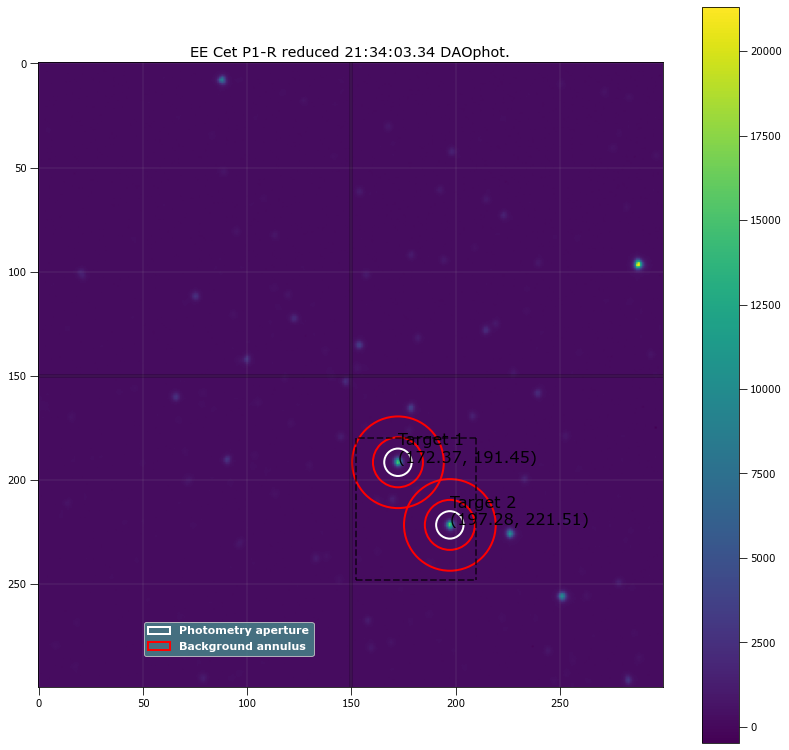

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.37012 191.45142 ...          3685.6887      280745.52          899.72359
  2 197.28137 221.51319 ...          3806.3211      262389.86          809.37912

 Aperture are: 136.18086893684796 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.37012 191.45142 ...                 3570.9799             167307.66
  2 197.28137 221.51319 ...                 3703.1307             173189.42

Write this out the excel
13 21:34:03.34 P1-R 20.0 6.5838983050847455 172.37012073361694 191.45141832599055 167307.6629270758 3570.97994252149 19

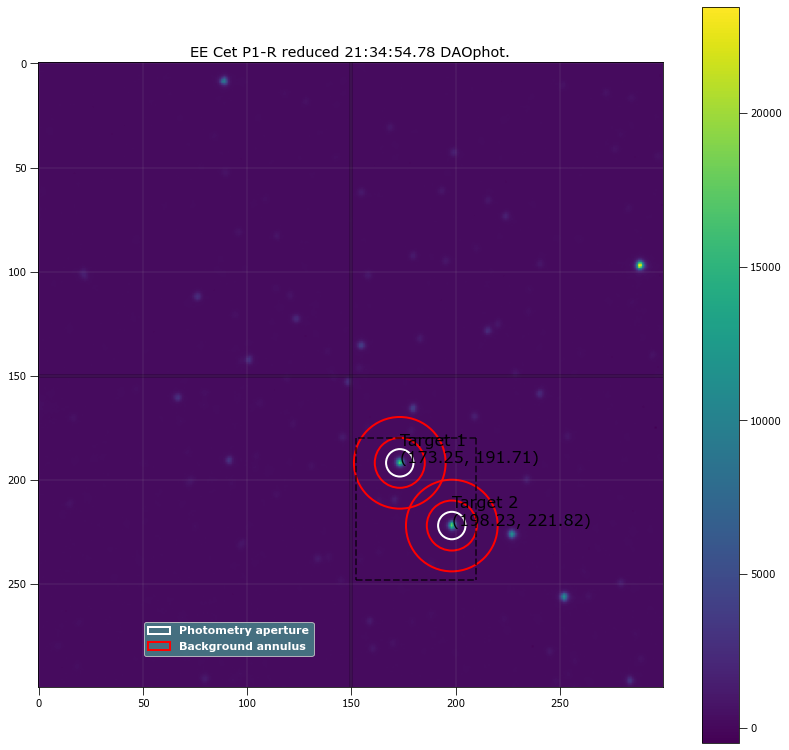

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 173.24939 191.71236 ...           4039.444      270741.99          878.78659
  2 198.22671 221.82059 ...          4159.2072       250126.5           772.6717

 Aperture are: 136.18086893684796 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 173.24939 191.71236 ...                 3927.4047             180661.88
  2 198.22671 221.82059 ...                 4060.6968              186978.9

Write this out the excel
14 21:34:54.78 P1-R 20.0 6.5838983050847455 173.2493932778204 191.71236451256885 180661.87862887816 3927.404652727368 1

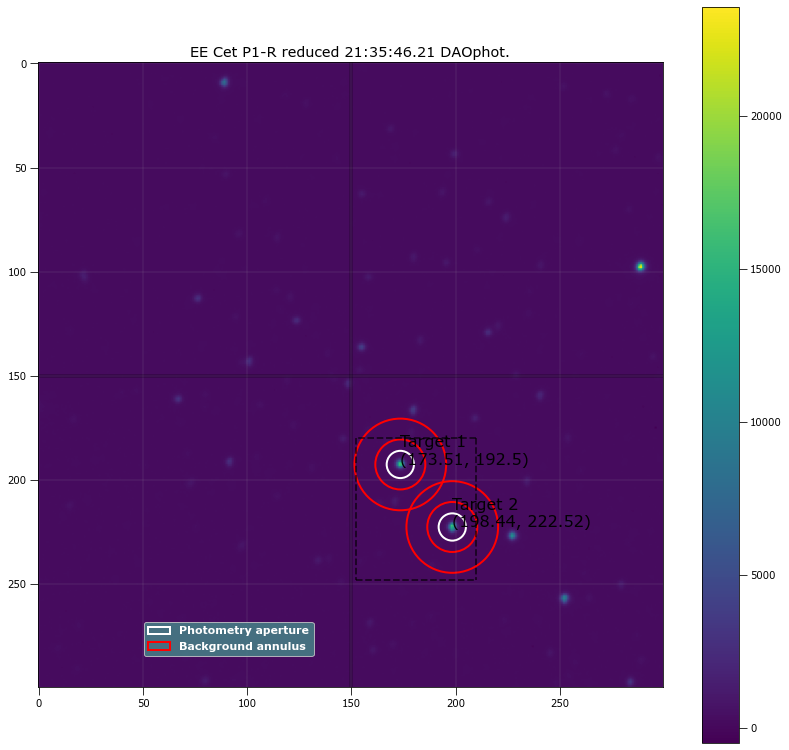

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 173.50791 192.49947 ...          3989.6585      270638.02          872.88422
  2 198.44421 222.51647 ...          3948.5588      250194.76          772.47802

 Aperture are: 134.62527799520868 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 173.50791 192.49947 ...                 3879.6428             178530.14
  2 198.44421 222.51647 ...                  3851.198             185637.53

Write this out the excel
15 21:35:46.21 P1-R 20.0 6.546186440677966 173.5079109610471 192.4994674076523 178530.14012113455 3879.6428366589985 19

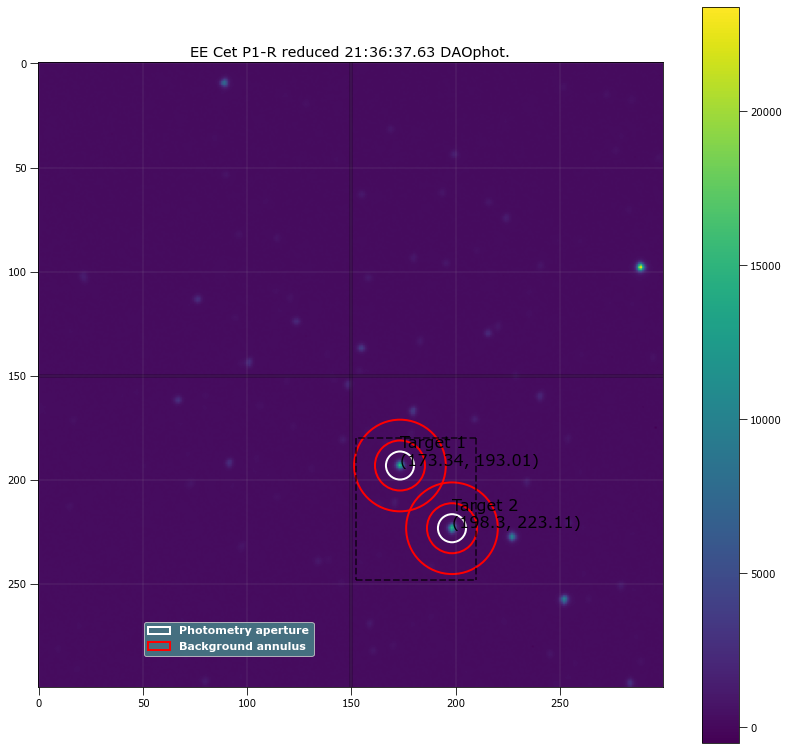

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 173.34262 193.00586 ...          3611.8084      282620.07          902.31154
  2  198.3031 223.11354 ...          3633.3608       264358.7          814.42395

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 173.34262 193.00586 ...                 3491.4379             162743.59
  2  198.3031 223.11354 ...                 3524.7147             168807.98

Write this out the excel
16 21:36:37.63 P1-R 20.0 6.734745762711864 173.34261918213556 193.00586192451163 162743.58523725512 3491.437880664797 19

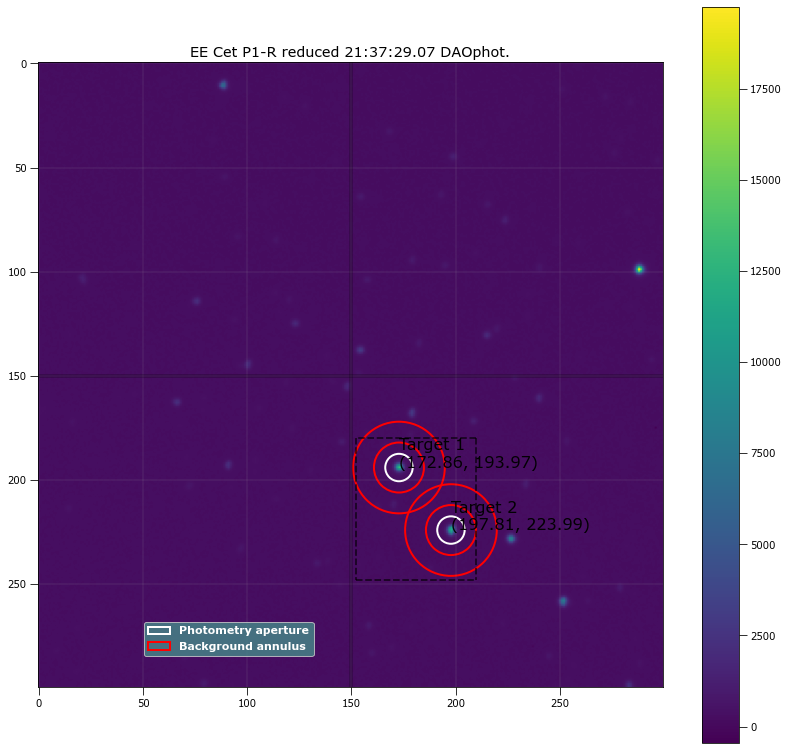

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.85614 193.97426 ...          3082.9308      305308.06           958.2092
  2 197.81008 223.98956 ...          3081.7786      290137.12          891.86096

 Aperture are: 136.18086893684796 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.85614 193.97426 ...                 2960.7656             138790.21
  2 197.81008 223.98956 ...                 2968.0723             143142.77

Write this out the excel
17 21:37:29.07 P1-R 20.0 6.5838983050847455 172.85614457623007 193.97426016543503 138790.2075596245 2960.7655656458414 

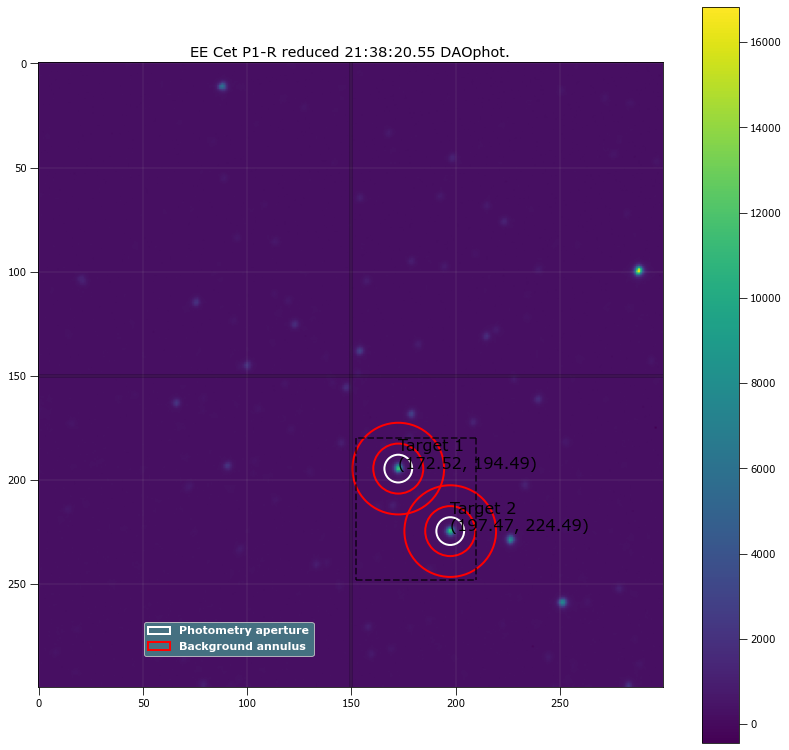

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.52321 194.48671 ...          2980.4935      309355.69          970.19088
  2 197.46759 224.49145 ...          3008.4061      294255.62          904.61343

 Aperture are: 139.318858370481 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.52321 194.48671 ...                 2853.9505             135282.51
  2 197.46759 224.49145 ...                 2890.4164              139797.6

Write this out the excel
18 21:38:20.55 P1-R 20.0 6.659322033898305 172.52320940072735 194.48670978653178 135282.50803806577 2853.9504898810033 19

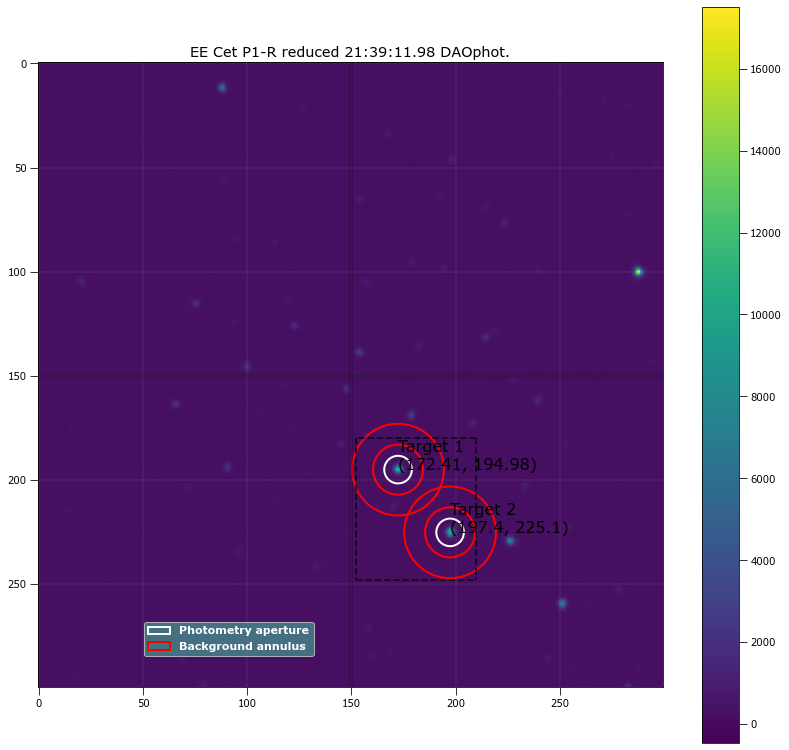

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  172.4052 194.97766 ...           2821.089      317521.33          991.98435
  2 197.40024 225.10223 ...          2833.7803      303219.47          931.31629

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  172.4052 194.97766 ...                 2693.1647              125219.5
  2 197.40024 225.10223 ...                 2713.6796             129687.71

Write this out the excel
19 21:39:11.98 P1-R 20.0 6.621610169491525 172.4052008560585 194.9776557563767 125219.49791337994 2693.164679431124 197.

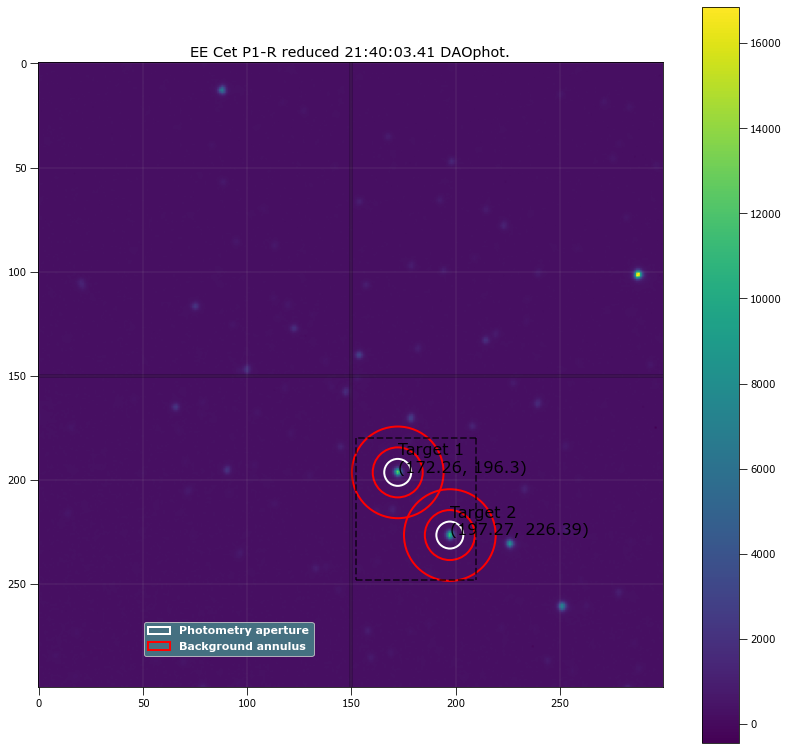

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  172.2601  196.3008 ...          2913.2667      318861.75          996.19911
  2 197.27282 226.39161 ...          2846.8837       305048.5          936.87138

 Aperture are: 131.54090366228465 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  172.2601  196.3008 ...                 2790.5855              123450.1
  2 197.27282 226.39161 ...                 2731.5087             127776.18

Write this out the excel
20 21:40:03.41 P1-R 20.0 6.470762711864406 172.26009886628773 196.30079697341966 123450.09802691214 2790.585478591309 1

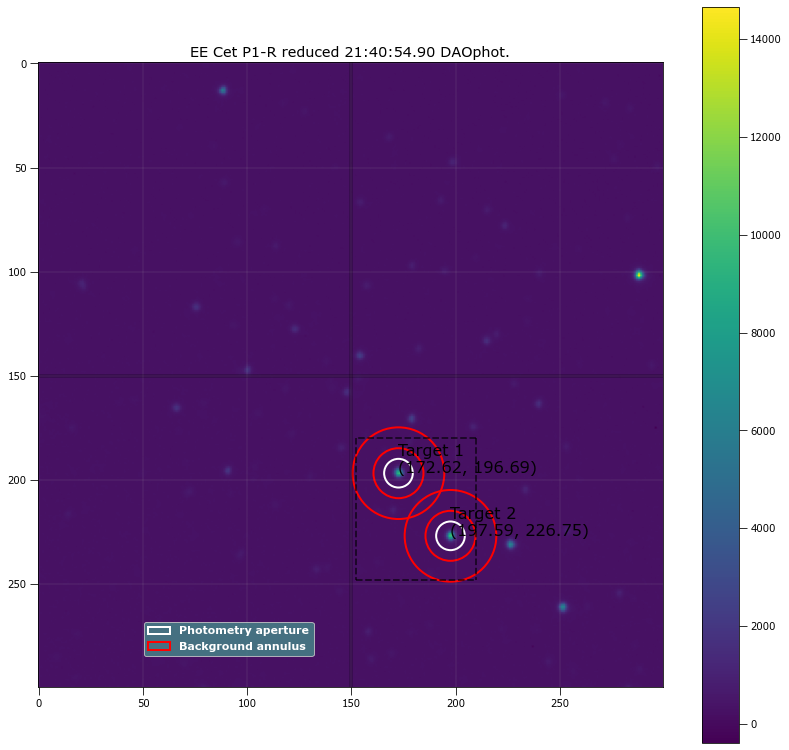

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.61982 196.69141 ...          2457.6494      332520.21           1032.836
  2 197.58888  226.7547 ...           2564.927      320985.32           985.1453

 Aperture are: 148.9472870742162 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.61982 196.69141 ...                 2313.6253             111291.48
  2 197.58888  226.7547 ...                 2427.5532             114917.74

Write this out the excel
21 21:40:54.90 P1-R 20.0 6.885593220338983 172.6198214413871 196.691413340023 111291.47574589125 2313.625346436923 197.5

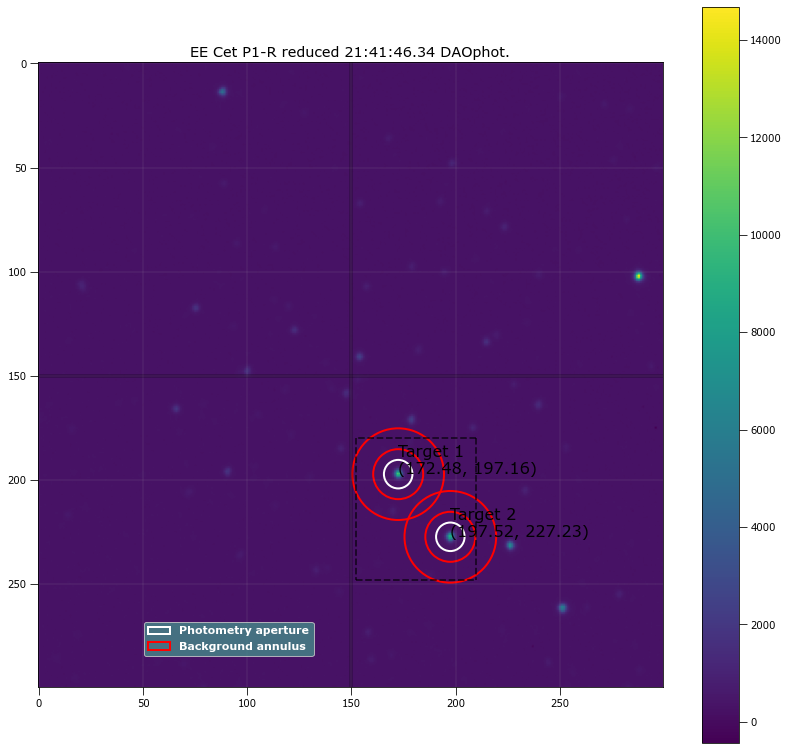

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.48291 197.15829 ...          2447.4193      337459.61          1045.3265
  2 197.51557 227.22852 ...          2363.5042      326277.03           1001.098

 Aperture are: 147.3202093316316 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.48291 197.15829 ...                 2303.2458             104843.92
  2 197.51557 227.22852 ...                 2225.4308             107752.58

Write this out the excel
22 21:41:46.34 P1-R 20.0 6.847881355932203 172.4829138272969 197.1582918361373 104843.92068353413 2303.2458299889104 197

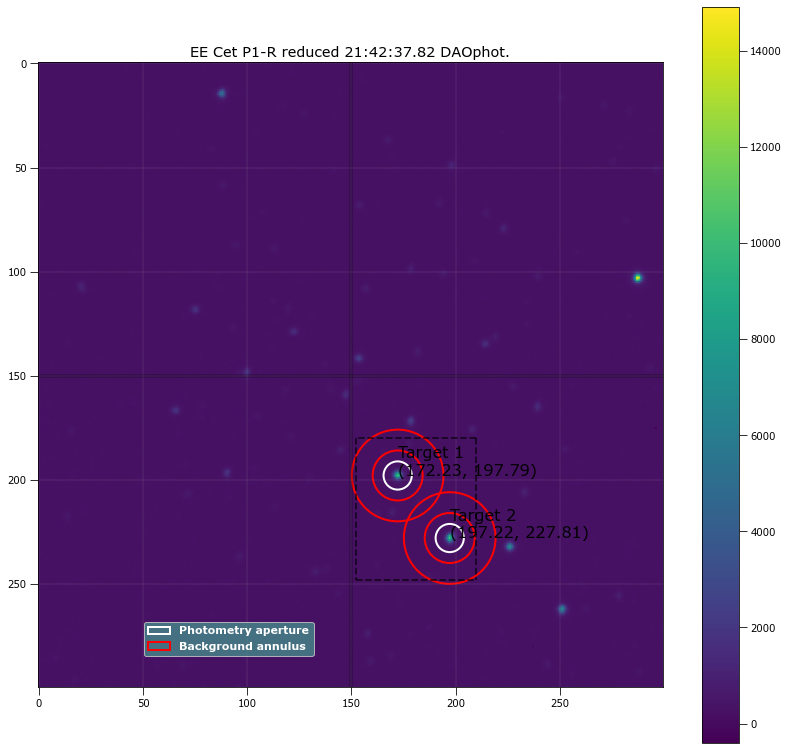

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.23139  197.7942 ...          2456.2887      333228.64          1034.0489
  2 197.22452 227.81202 ...          2484.0546      320640.78          984.15195

 Aperture are: 144.0928613968168 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.23139  197.7942 ...                 2316.7949             106244.18
  2 197.22452 227.81202 ...                  2351.292             110251.92

Write this out the excel
23 21:42:37.82 P1-R 20.0 6.772457627118643 172.23138670166145 197.7942002915438 106244.17581780443 2316.7949197588196 19

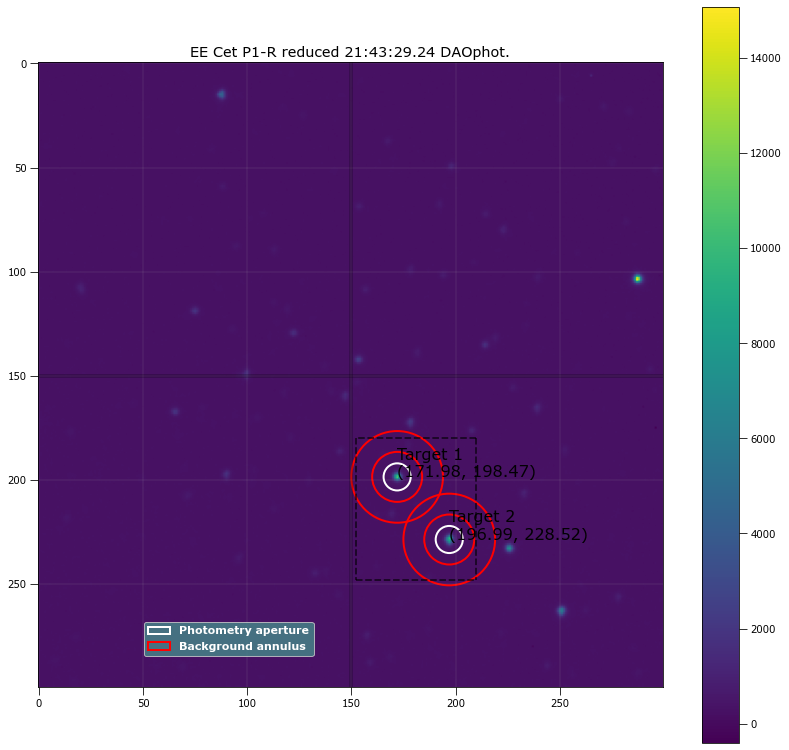

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 171.98258 198.46789 ...          2466.0731      334615.47          1036.9055
  2 196.99462 228.52313 ...          2351.3002      323168.77          991.62594

 Aperture are: 133.07862290368763 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 171.98258 198.46789 ...                 2336.8861             104742.65
  2 196.99462 228.52313 ...                 2227.7546             107853.43

Write this out the excel
24 21:43:29.24 P1-R 20.0 6.508474576271187 171.98257558444783 198.46788685934004 104742.6469477251 2336.886090278432 19

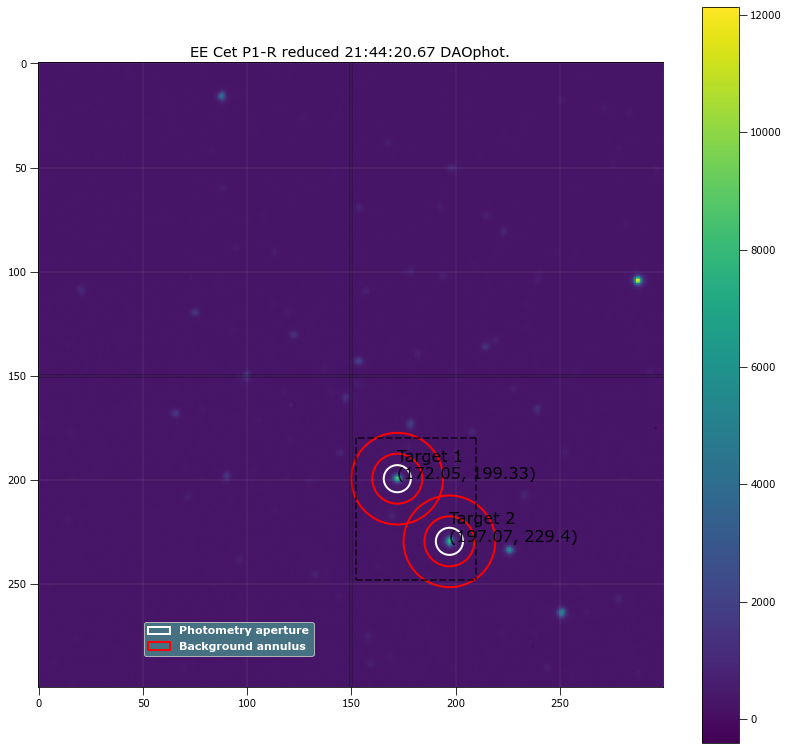

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.05318 199.32724 ...          2155.7788      350200.82          1081.6978
  2 197.06994 229.39968 ...          2107.1602      340180.38          1043.4021

 Aperture are: 133.07862290368763 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.05318 199.32724 ...                 2021.0112             91738.049
  2 197.06994 229.39968 ...                 1977.1638             95354.278

Write this out the excel
25 21:44:20.67 P1-R 20.0 6.508474576271187 172.0531768204535 199.32723898322416 91738.04934805381 2021.0112221419356 19

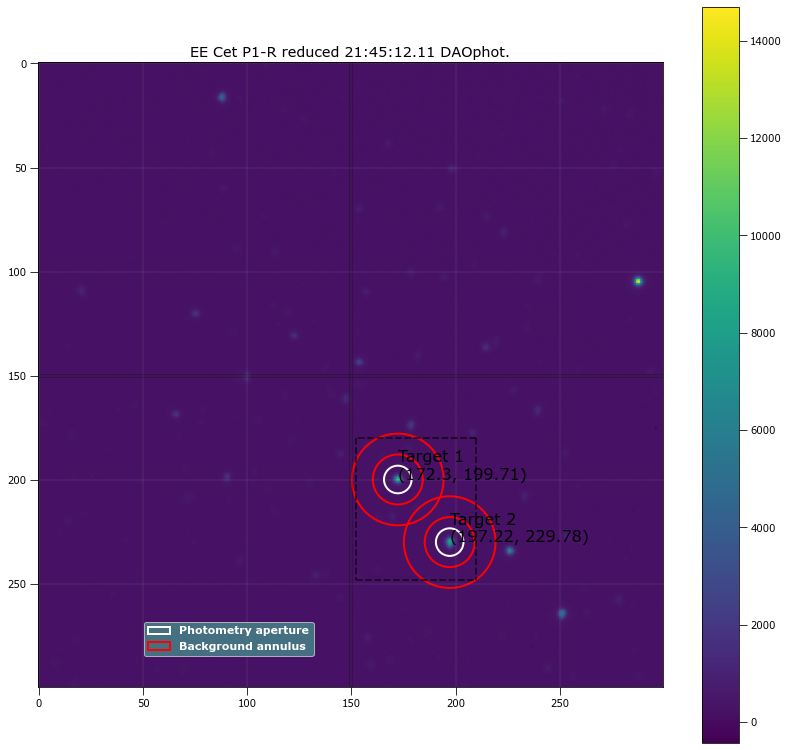

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.29701 199.71441 ...          2342.9802      340774.07          1054.2868
  2 197.21647 229.77736 ...          2236.2248       329949.4          1012.1489

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.29701 199.71441 ...                 2207.0215             98546.056
  2 197.21647 229.77736 ...                 2105.7001             101588.55

Write this out the excel
26 21:45:12.11 P1-R 20.0 6.621610169491525 172.29701280651665 199.71440807663188 98546.05624218844 2207.021488614082 197

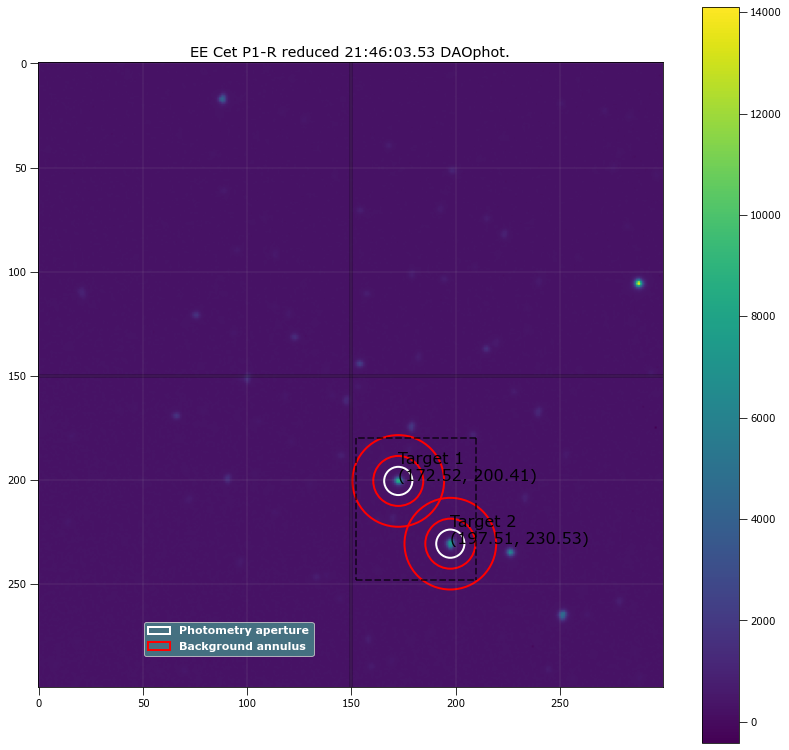

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.52356 200.41237 ...          2206.4408      344369.98           1064.718
  2 197.50922 230.52776 ...          2101.3178      333952.47          1024.1082

 Aperture are: 144.09286139681686 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.52356 200.41237 ...                 2062.8098             94000.479
  2 197.50922 230.52776 ...                 1963.1651             97277.322

Write this out the excel
27 21:46:03.53 P1-R 20.0 6.772457627118644 172.52355951449746 200.41237456582942 94000.47855977474 2062.809813439967 19

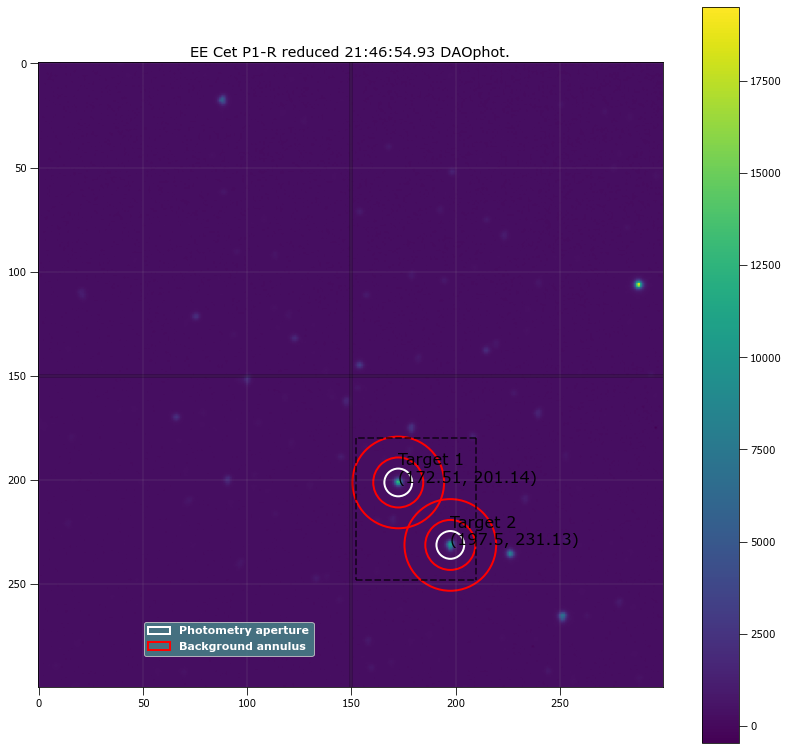

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.51447 201.13896 ...          2960.8029      309029.41          966.37197
  2  197.5031 231.13403 ...          2825.4662      295217.28          907.03975

 Aperture are: 139.318858370481 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.51447 201.13896 ...                 2834.7579             126903.33
  2  197.5031 231.13403 ...                   2707.16             131283.95

Write this out the excel
28 21:46:54.93 P1-R 20.0 6.659322033898305 172.514467156863 201.1389636026424 126903.33074068137 2834.75792380465 197.503

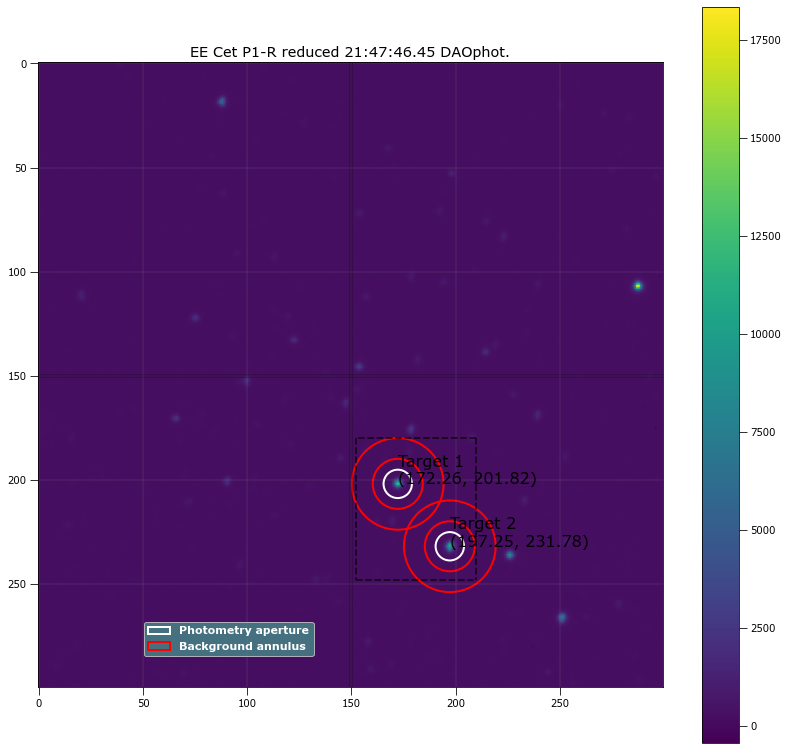

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.26399 201.82324 ...          2857.4962      307159.04          959.90645
  2 197.25343 231.77612 ...          2755.9407      294264.51          903.95502

 Aperture are: 145.7020674391651 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.26399 201.82324 ...                 2726.5581             124655.53
  2 197.25343 231.77612 ...                 2632.6348             129472.05

Write this out the excel
29 21:47:46.45 P1-R 20.0 6.810169491525423 172.26398971300955 201.82324452924308 124655.52764114167 2726.5581144000053 1

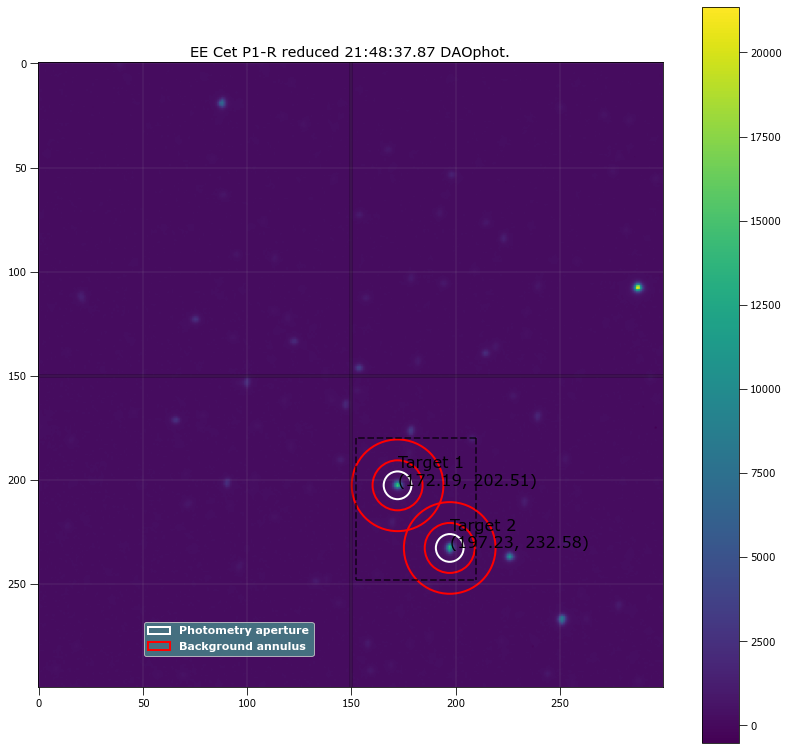

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.18616 202.50776 ...          3537.2417      274608.92          874.11274
  2 197.22761 232.57687 ...          3459.2164      256552.58          790.32985

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.18616 202.50776 ...                 3423.2302              159136.8
  2 197.22761 232.57687 ...                 3356.1328             165404.95

Write this out the excel
30 21:48:37.87 P1-R 20.0 6.659322033898304 172.1861588501171 202.50776018573632 159136.79889652334 3423.230206058069 19

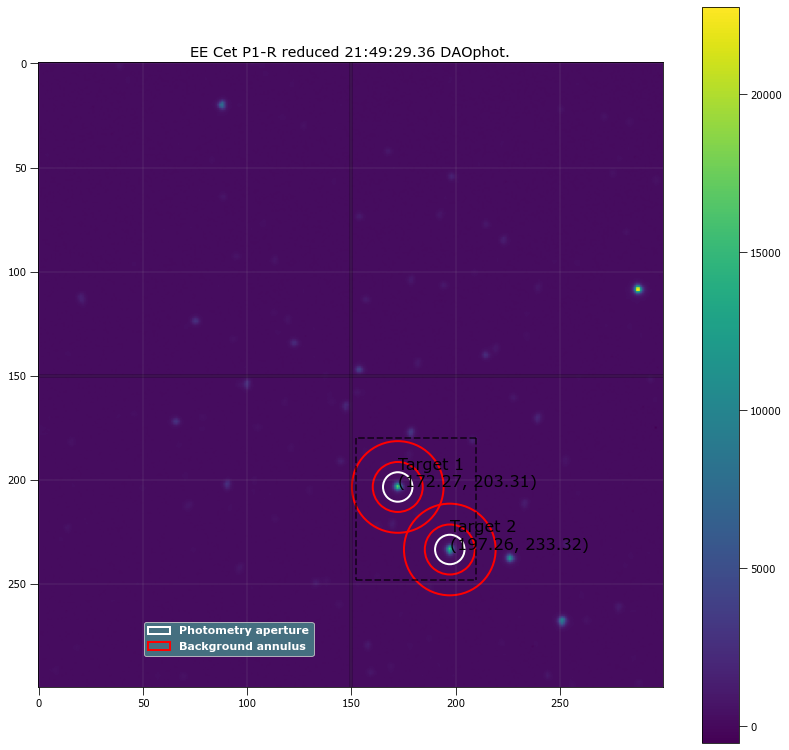

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.26874 203.30567 ...          3852.7773      267381.87          858.78022
  2 197.26067 233.32133 ...          3721.3677      248354.73          766.33892

 Aperture are: 157.21671353891202 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.26874 203.30567 ...                 3726.3759             169226.86
  2 197.26067 233.32133 ...                 3608.5724              175116.3

Write this out the excel
31 21:49:29.36 P1-R 20.0 7.0741525423728815 172.26874252303594 203.30566556661842 169226.85582208782 3726.375879091558 

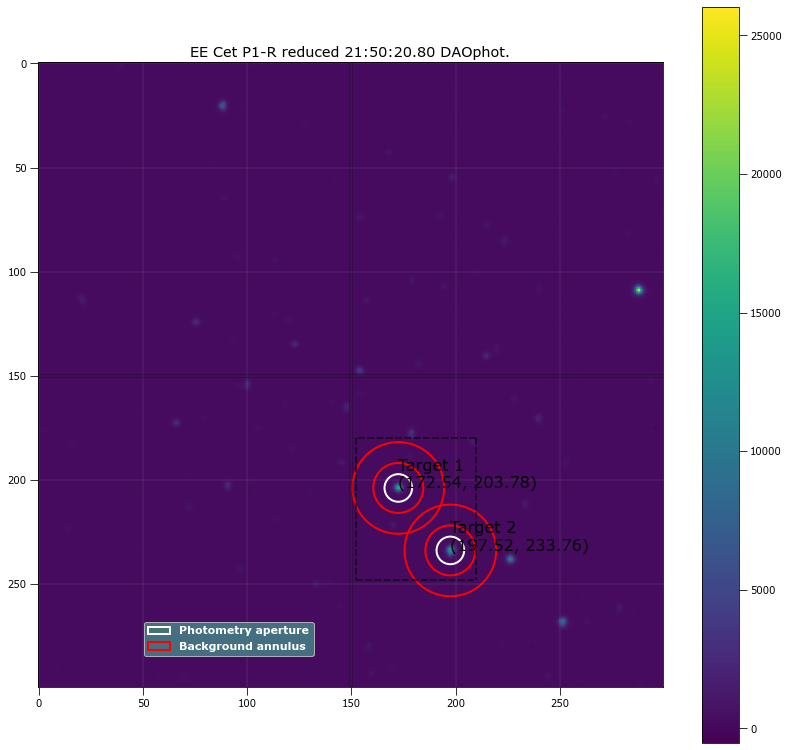

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.53623 203.77712 ...          3681.7738      273497.87          873.94458
  2  197.5208 233.76185 ...          3537.6645      254111.97          783.38113

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.53623 203.77712 ...                 3569.0716             162194.91
  2  197.5208 233.76185 ...                 3436.6412             168482.06

Write this out the excel
32 21:50:20.80 P1-R 20.0 6.621610169491525 172.5362313435776 203.77712334040865 162194.91018646298 3569.071602078306 197

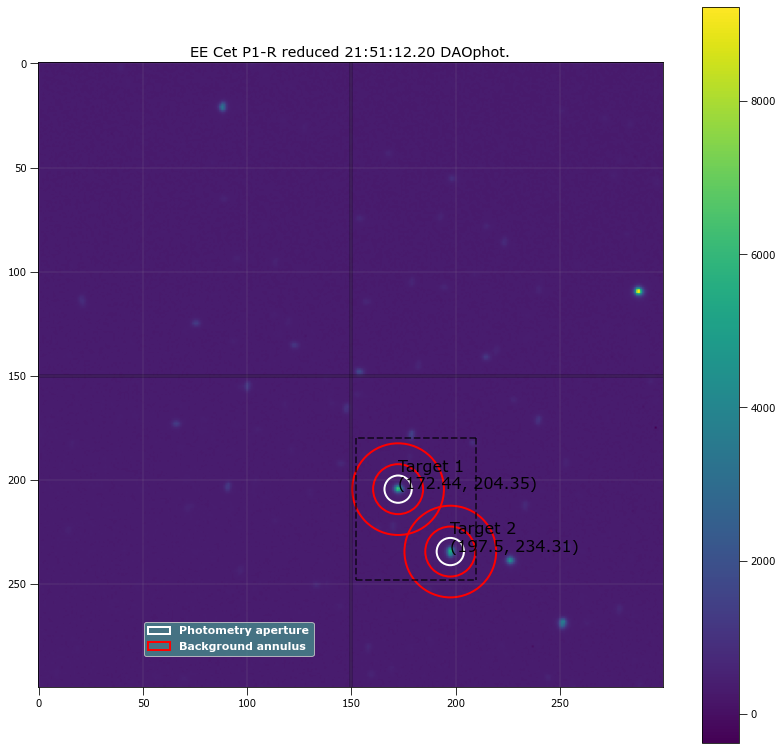

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.44351 204.35226 ...          1647.3733      379812.04          1167.9028
  2 197.49697 234.30891 ...          1616.6715      372925.04          1142.9481

 Aperture are: 134.62527799520868 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.44351 204.35226 ...                 1500.1745             69509.836
  2 197.49697 234.30891 ...                 1472.6178             71392.203

Write this out the excel
33 21:51:12.20 P1-R 20.0 6.546186440677966 172.44350672148482 204.3522598455728 69509.83575395966 1500.174461992937 197

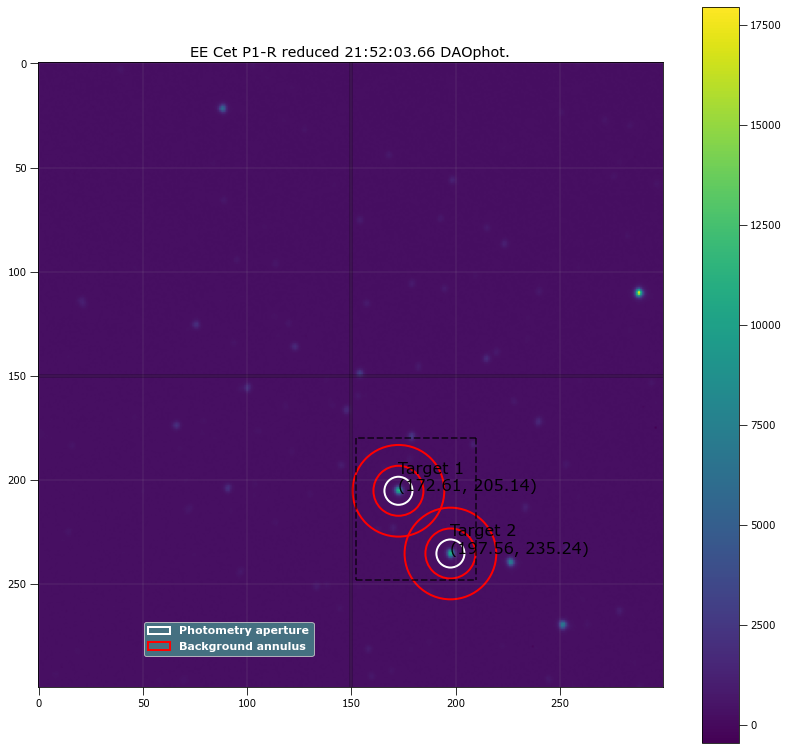

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.61045 205.14003 ...          2685.3412      314819.49          981.81226
  2 197.55882 235.24343 ...          2707.5423      301993.67          927.27889

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.61045 205.14003 ...                 2554.3651             114489.24
  2 197.55882 235.24343 ...                 2583.8412             119000.17

Write this out the excel
34 21:52:03.66 P1-R 20.0 6.734745762711864 172.61045405510257 205.14003215593505 114489.2389956355 2554.36509541305 197.

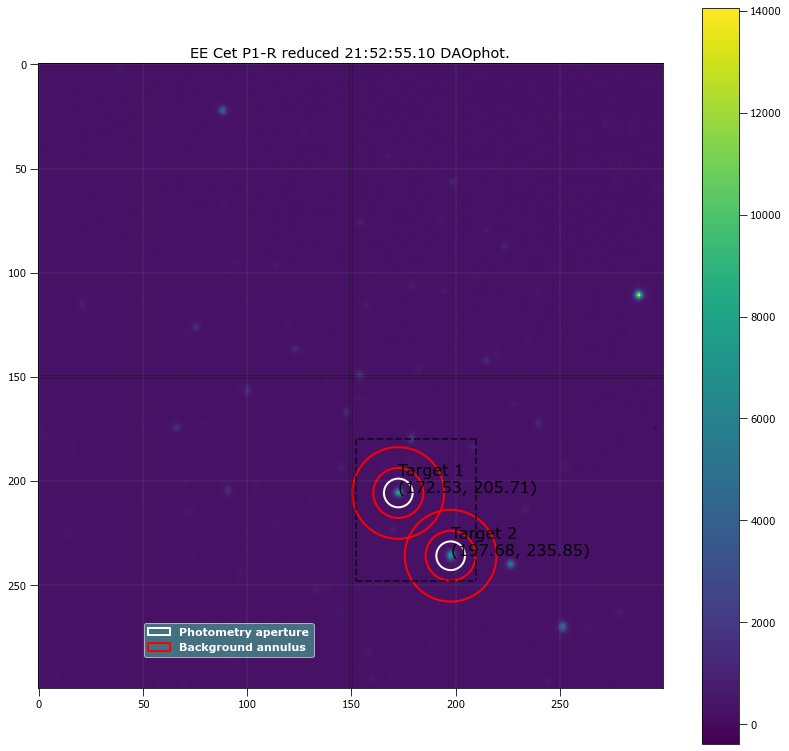

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.53163 205.70716 ...          2058.4809      343253.01          1059.2629
  2 197.67627 235.84641 ...          1989.5118      333428.15          1022.5591

 Aperture are: 148.9472870742162 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.53163 205.70716 ...                 1910.7716             86990.854
  2 197.67627 235.84641 ...                 1846.9207             89717.613

Write this out the excel
35 21:52:55.10 P1-R 20.0 6.885593220338983 172.53163235013267 205.70715775978906 86990.85393537767 1910.7716462565718 19

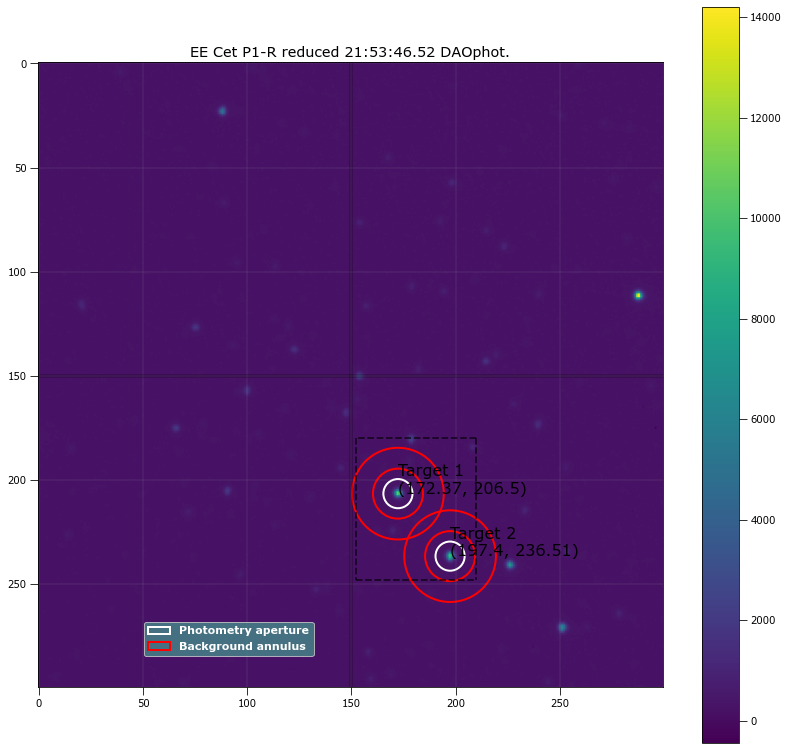

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.36891 206.50356 ...          2590.3766       320696.9          997.53677
  2 197.39573 236.50663 ...          2505.2347      306336.43          940.47896

 Aperture are: 153.88213540267918 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.36891 206.50356 ...                 2446.6662             110220.53
  2 197.39573 236.50663 ...                 2369.7443             113267.91

Write this out the excel
36 21:53:46.52 P1-R 20.0 6.998728813559322 172.36890992333159 206.50355771342936 110220.53151134428 2446.666156554461 1

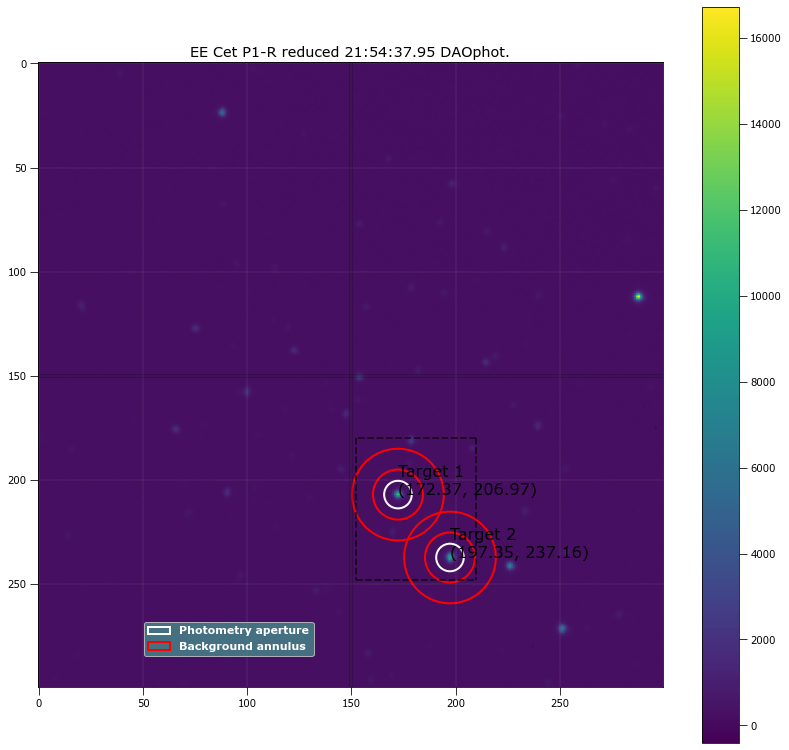

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.36853 206.96524 ...          2477.7196       319069.1          991.44936
  2 197.34661 237.15775 ...          2426.3304       307989.9          945.36647

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.36853 206.96524 ...                 2349.8643             103794.43
  2 197.34661 237.15775 ...                 2304.4178             107473.43

Write this out the excel
37 21:54:37.95 P1-R 20.0 6.621610169491525 172.368526744607 206.96524473423077 103794.42651227603 2349.8642694207724 197

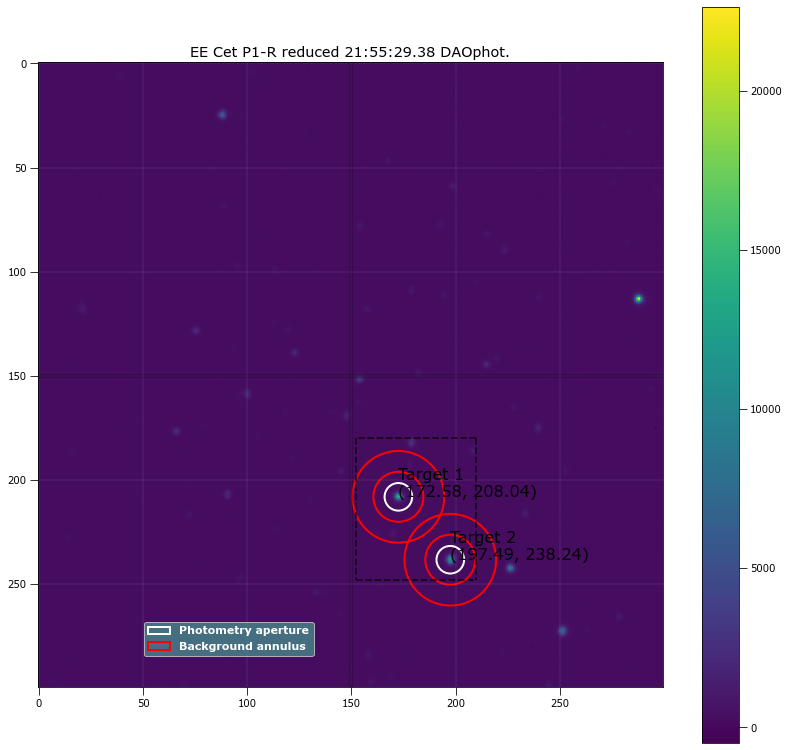

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.57854 208.04056 ...          3164.5738      296047.81          930.86569
  2  197.4918 238.23821 ...          2943.3025      279489.65          859.28544

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.57854 208.04056 ...                 3044.5312             130342.48
  2  197.4918 238.23821 ...                 2832.4908              134453.8

Write this out the excel
38 21:55:29.38 P1-R 20.0 6.621610169491525 172.5785410666775 208.040559990025 130342.48151423263 3044.5312445001073 197.

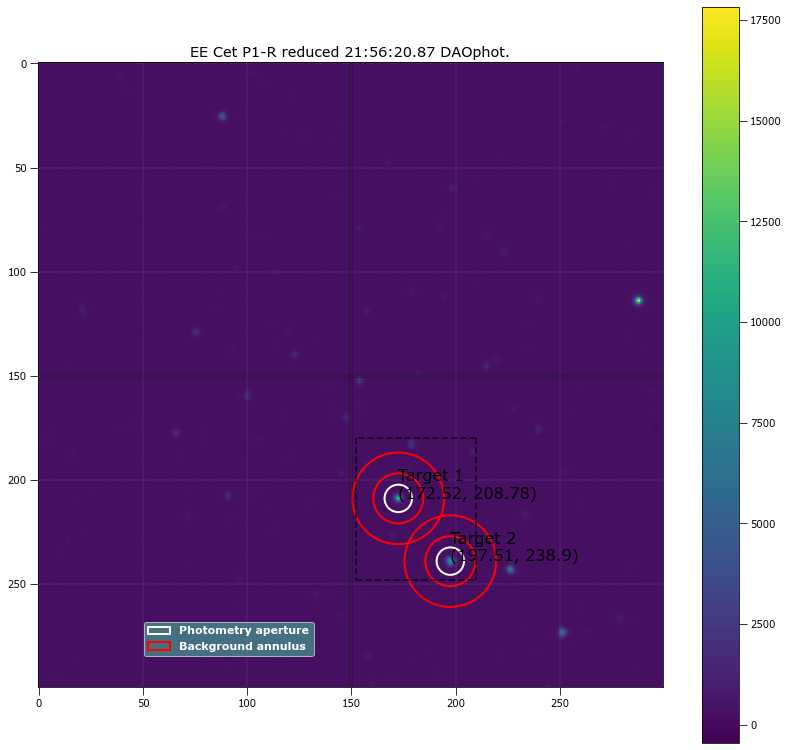

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.52268 208.78395 ...          2572.5705       319134.2          991.15109
  2 197.50664 238.90314 ...          2362.8534      306882.01          942.02452

 Aperture are: 136.18086893684796 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.52268 208.78395 ...                 2446.2054              104023.8
  2 197.50664 238.90314 ...                 2242.7516             106546.34

Write this out the excel
39 21:56:20.87 P1-R 20.0 6.5838983050847455 172.52267790365724 208.78395082139136 104023.7952422325 2446.2053980423148 

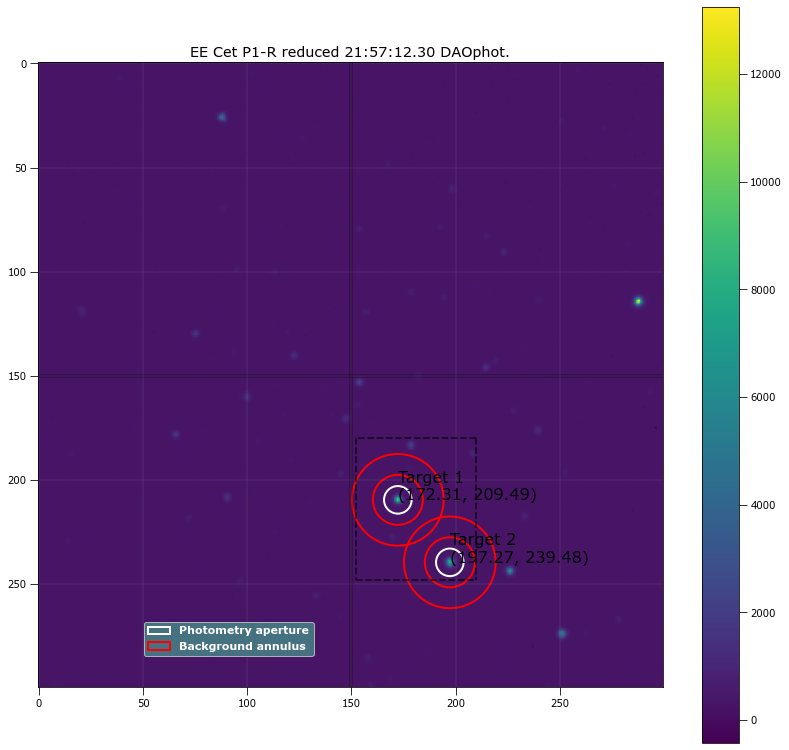

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.31132 209.49053 ...          2120.9538       336802.8          1041.0849
  2 197.26972 239.48436 ...          2022.4166       326383.1          1000.9941

 Aperture are: 137.7453957286054 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.31132 209.49053 ...                 1986.6976             85028.686
  2 197.26972 239.48436 ...                 1893.3304             87612.892

Write this out the excel
40 21:57:12.30 P1-R 20.0 6.621610169491525 172.3113231044488 209.49052976530976 85028.6855909412 1986.6975922336428 197.

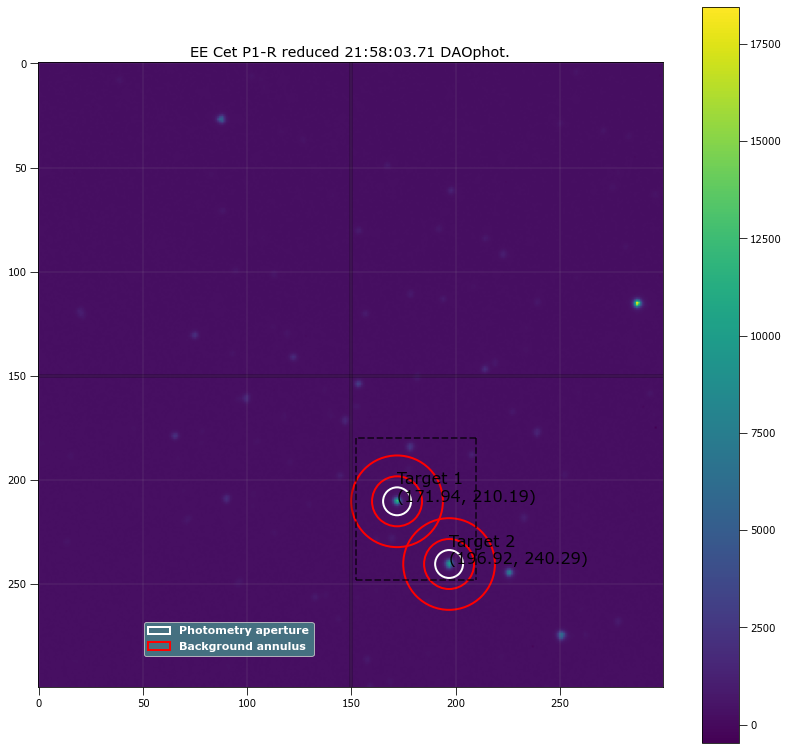

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 171.93545 210.18698 ...          2611.3961      306234.82          953.61976
  2 196.91523 240.29071 ...          2457.5483      294946.88          905.82384

 Aperture are: 140.90125686247475 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 171.93545 210.18698 ...                 2485.6017             108253.87
  2 196.91523 240.29071 ...                 2338.0588             112117.83

Write this out the excel
41 21:58:03.71 P1-R 20.0 6.697033898305085 171.93544848669944 210.1869785602518 108253.87386608613 2485.601690262264 19

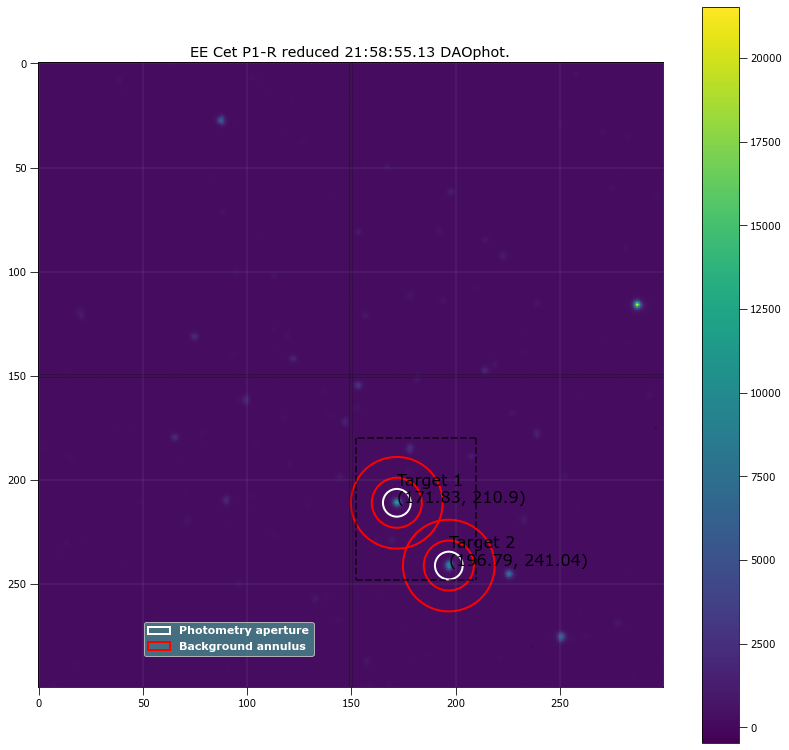

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1   171.828 210.89949 ...          2775.5714       301412.3          941.35982
  2 196.78704 241.03584 ...          2625.7658      287064.39          881.95755

 Aperture are: 139.31885837048094 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1   171.828 210.89949 ...                 2652.7888             117084.57
  2 196.78704 241.03584 ...                 2510.7311             120438.25

Write this out the excel
42 21:58:55.13 P1-R 20.0 6.659322033898304 171.82800291921535 210.89949277659653 117084.57419102799 2652.788782682968 1

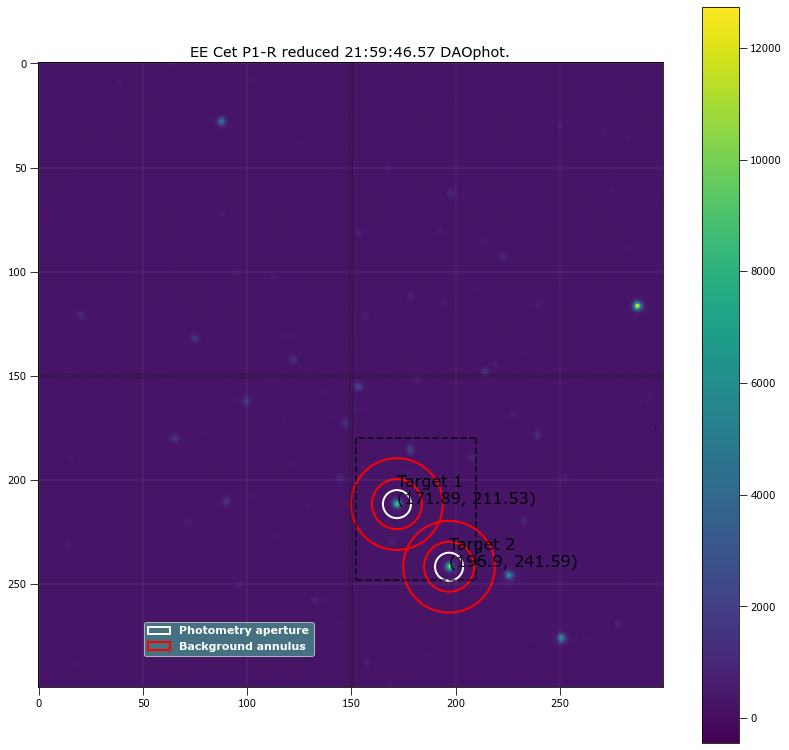

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 171.88535 211.52625 ...          2283.9833      317099.84          984.12687
  2 196.89944 241.58772 ...          2371.8954      304667.21          935.14036

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 171.88535 211.52625 ...                 2152.6985               99105.2
  2 196.89944 241.58772 ...                 2247.1455             102323.68

Write this out the excel
43 21:59:46.57 P1-R 20.0 6.734745762711864 171.88535149428225 211.5262484477271 99105.19992218181 2152.6984851608163 196

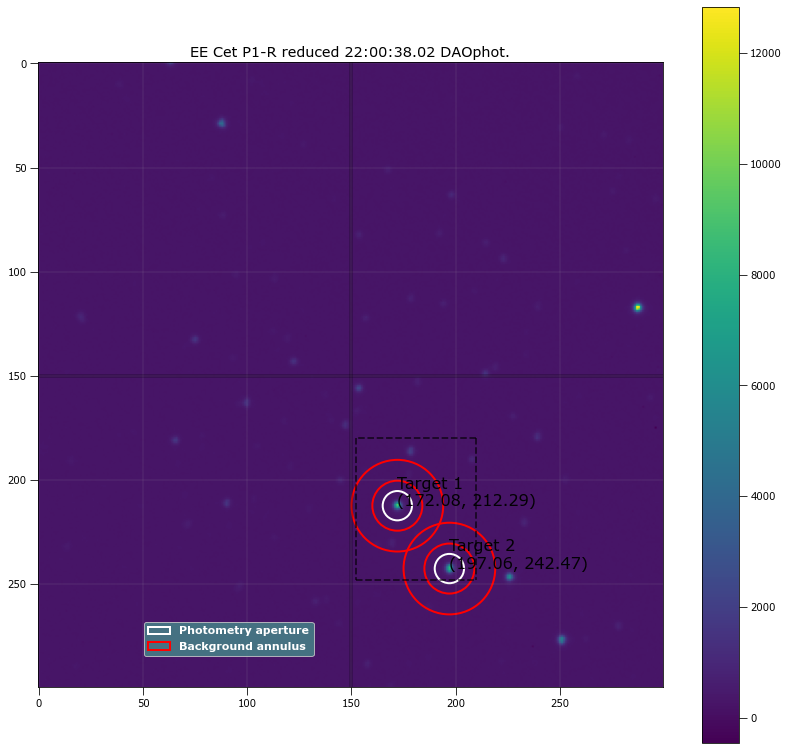

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  172.0816 212.29429 ...          2122.8168      316788.11          980.72312
  2 197.06084 242.47111 ...          2066.8684      307292.79          942.85954

 Aperture are: 155.54495654573648 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  172.0816 212.29429 ...                 1980.0019             88798.724
  2 197.06084 242.47111 ...                 1929.5673             91683.086

Write this out the excel
44 22:00:38.02 P1-R 20.0 7.036440677966102 172.08160034183604 212.29429275167163 88798.7235718097 1980.0018959541674 19

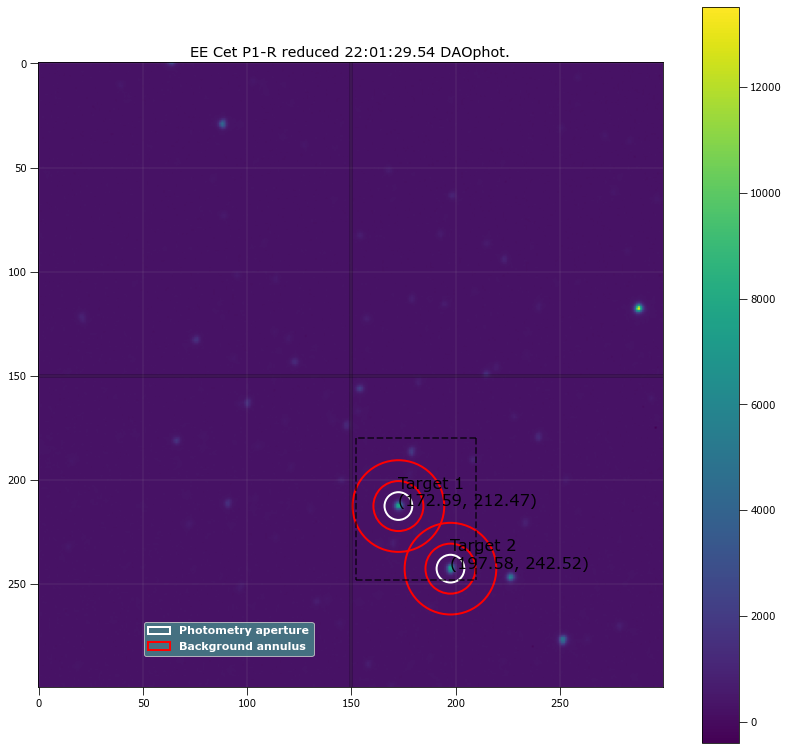

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.58726 212.46791 ...          2023.0188      316295.64           978.3435
  2 197.58056 242.51879 ...           2021.223      306535.18           940.7099

 Aperture are: 139.318858370481 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.58726 212.46791 ...                 1895.4124             86222.289
  2 197.58056 242.51879 ...                 1898.5251             89271.935

Write this out the excel
45 22:01:29.54 P1-R 20.0 6.659322033898305 172.58725994405168 212.4679099009442 86222.28905399026 1895.4123865734148 197.

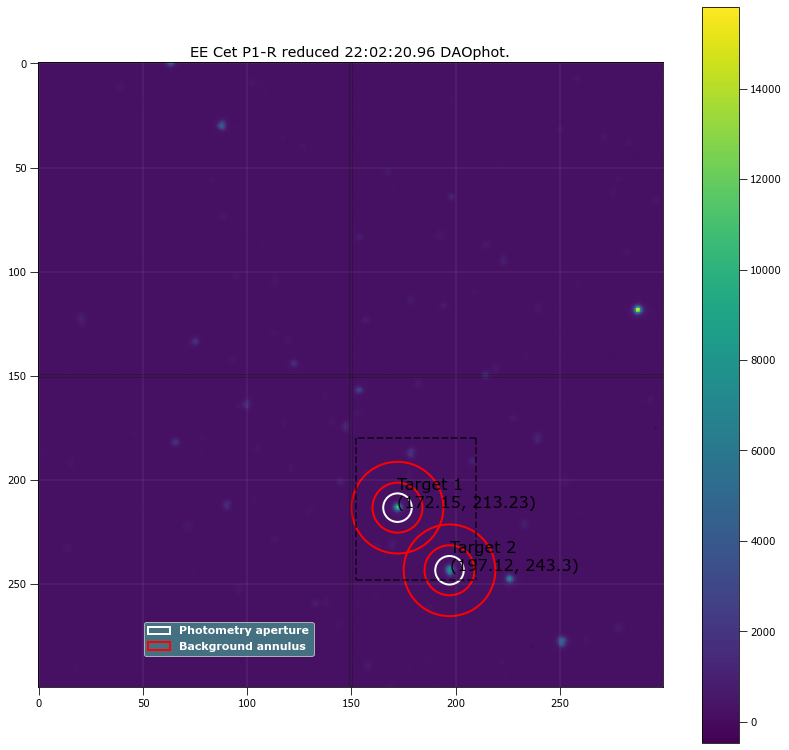

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.14697 213.23271 ...          2459.7177      299032.99          928.36855
  2 197.11987 243.29606 ...          2219.1306      288860.02          886.80299

 Aperture are: 147.3202093316316 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.14697 213.23271 ...                 2331.6752             101093.66
  2 197.11987 243.29606 ...                 2096.8209             104597.51

Write this out the excel
46 22:02:20.96 P1-R 20.0 6.847881355932203 172.14697478965306 213.2327091219515 101093.65842298421 2331.675236639132 197

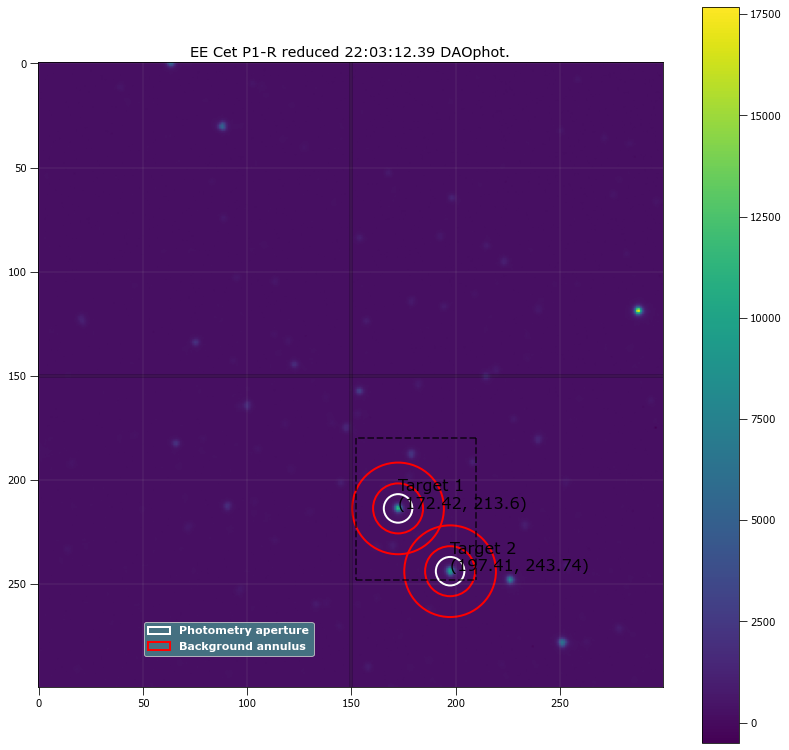

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.42492  213.5971 ...          2755.7949      279918.12          875.92136
  2 197.40945 243.74026 ...          2614.6502      265893.97          817.57786

 Aperture are: 147.3202093316316 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.42492  213.5971 ...                 2634.9861             120441.53
  2 197.40945 243.74026 ...                 2501.8883             124303.53

Write this out the excel
47 22:03:12.39 P1-R 20.0 6.847881355932203 172.42491500772067 213.59710149801194 120441.53465871289 2634.986055424582 19

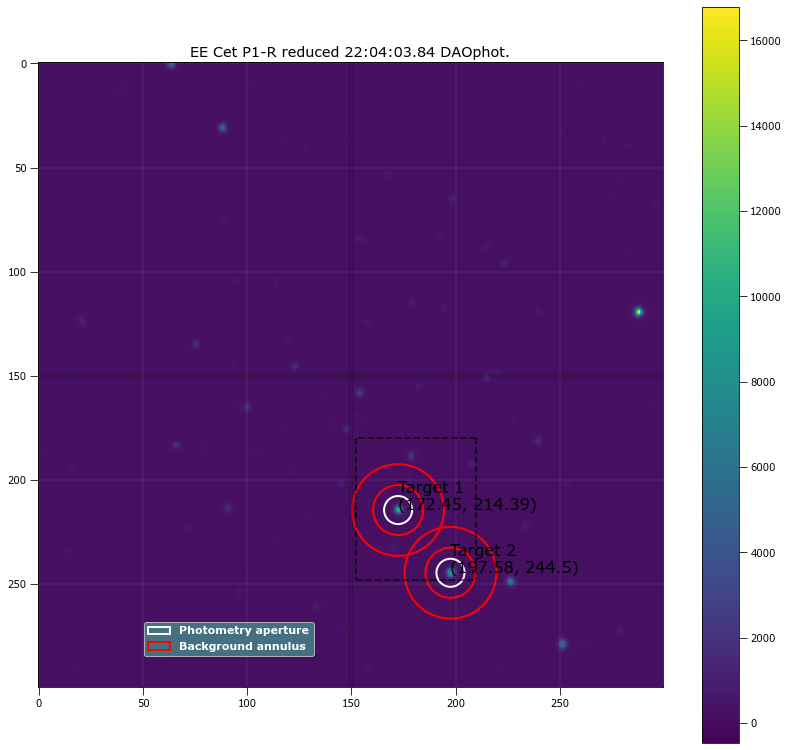

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.44531 214.38525 ...          2600.7899      284590.94          888.76082
  2 197.58339 244.50391 ...          2498.9376      272816.56          838.27245

 Aperture are: 142.4925912045867 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.44531 214.38525 ...                 2482.2271             111995.68
  2 197.58339 244.50391 ...                 2387.1101             116552.76

Write this out the excel
48 22:04:03.84 P1-R 20.0 6.734745762711864 172.44531262918062 214.385250752185 111995.67685525751 2482.227105322583 197.

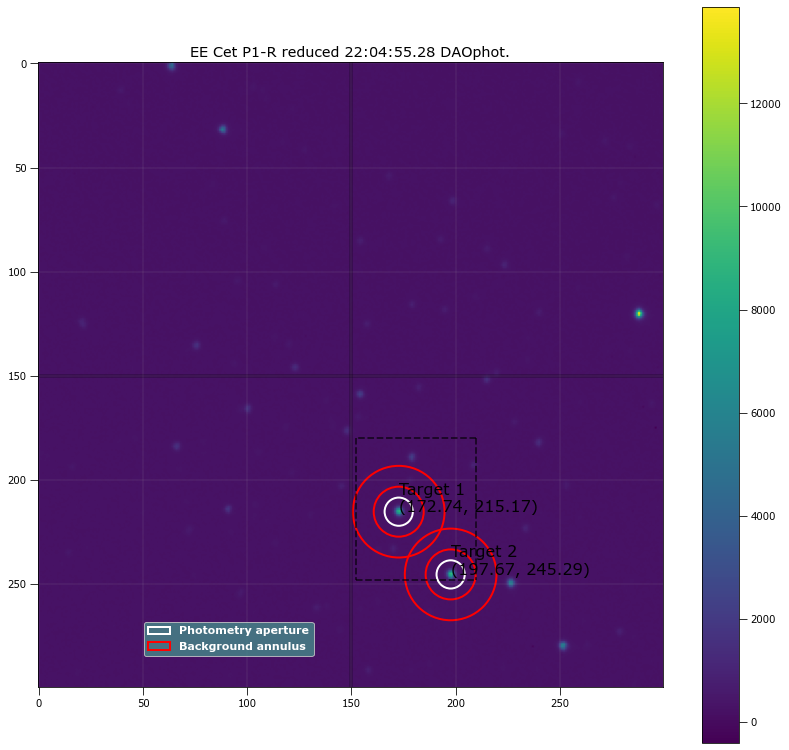

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 172.73863 215.16947 ...          2174.8068      303217.58          941.46255
  2 197.66736 245.28757 ...          2219.5508      292655.69          898.42027

 Aperture are: 144.09286139681686 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 172.73863 215.16947 ...                  2047.803             94125.336
  2 197.66736 245.28757 ...                 2098.3534             96962.191

Write this out the excel
49 22:04:55.28 P1-R 20.0 6.772457627118644 172.73862600674616 215.1694675288364 94125.33610556163 2047.8029895436564 19

In [17]:
#The pipe!
#we expect 4 targets
#37 doesnt work
#Here is a work around. Incorporate the peak finder into the pipeline and tell the process such that if DAO cannot find the 
#targets, use the peak find coordinates. I suspect the problem is the FWHM.

print("P1-R Filter")

res_apt_sum_list = []

start = 0
end = 50
filename = astropy.io.fits.open(target[start])[0].header['OBJECT']+"_"+astropy.io.fits.open(target[start])[0].header['FILTER']

workbook = xlsxwriter.Workbook('./stats/'+MJD+"_"+ filename+str(start)+"-" +str(end)  +'.xlsx')
worksheet = workbook.add_worksheet()
worksheet.write('A1', 'int')
worksheet.write('B1', 'time obs')
worksheet.write('C1', 'filter')
worksheet.write('D1', 'exptime')
worksheet.write('E1', 'aperture radius')
worksheet.write('F1', 'target 1 x center')
worksheet.write('G1', 'target 1 y center')
worksheet.write('H1', 'target 1 counts')
worksheet.write('I1', 'target 1 error')
worksheet.write('J1', 'target 2 x center')
worksheet.write('K1', 'target 2 y center')
worksheet.write('L1', 'target 2 counts')
worksheet.write('M1', 'target 2 error')
worksheet.write('N1', 'q')
worksheet.write('O1', 'q error')
worksheet.write('P1', 'u')
worksheet.write('Q1', 'u error')
worksheet.write('R1', 'PD')
worksheet.write('S1', 'PD error')
worksheet.write('T1', 'PA')
worksheet.write('U1', 'PA error')

row = 1
column = 0
search_off = 150
siegma_search = 3
search_bracket = [-30, 98, -2, 60]

for k in range(start, end ):
    reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[k]),
                                        [512, 512, 512, 512], 
                                        (m_biast, m_dark, p_1_m_flat), 
                                        False, True, False)

    trial_radii = np.linspace(5, 9.45, num=60)
    target_a = []
    target_b = []
    for radii in trial_radii:
        DAO_positions = funcs_star_finder.dao_star_finder(reduced_obj, search_bracket, siegma_search, 
                                                          4000, search_off, radii, 12 , 22, False, False)
        
        if (len(DAO_positions) != 2):
            x_targ, y_targ, peak_targ  = funcs_star_finder.source_peak_finder(reduced_obj, 4,search_bracket, 3600 , False, False) #what do I return from this?
            apt_pos = funcs_star_finder.plot_spotted(reduced_obj, search_off, search_bracket , x_targ, y_targ, peak_targ, False, False)
            DAO_positions = funcs_star_finder.peak_to_DAO(apt_pos)        
        
        #Insert Trial
        phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, search_off, search_bracket, DAO_positions, radii, 12 , 22, False, False)
        target_a.append(phot_tab['residual_aperture_sum'][0])
        target_b.append(phot_tab['residual_aperture_sum'][1])

    combine_target = [target_a, target_b]
    
    good_radii=funcs_apt_phot.solve_apt(combine_target, trial_radii, False)

    phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, search_off, search_bracket, DAO_positions,good_radii, 12 , 22, True, False)

    res_apt_sum_list.append(phot_tab['residual_aperture_sum'])
    
    print("\nWrite this out the excel")
    print(k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'],
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1],"\n")
    
    write_this = [k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'],
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1]]
    
    for item in write_this :
        worksheet.write(row, column, item)
        column += 1
        
    column = 0
    row += 1
    
workbook.close()

target_1 = []
target_2 = []

for things in res_apt_sum_list:
    target_1.append(things[0])
    target_2.append(things[1])

In [8]:
#You have two options. Write code that fixes the image or

#here is something fun to write.

#write a function that takes two input script 

#and merges them together to become one.

#You have to do a manual Fit before you do a physical fit.
#Now I am seeing a case where with the threshold lowered, long compute time I am picking up unwanted background sources
#I'm looking at the example from P1-R
#Target_1

#The pipe!
#we expect 4 targets
#37 doesnt work
#Here is a work around. Incorporate the peak finder into the pipeline and tell the process such that if DAO cannot find the 
#targets, use the peak find coordinates. I suspect the problem is the FWHM.

P3-R Filter


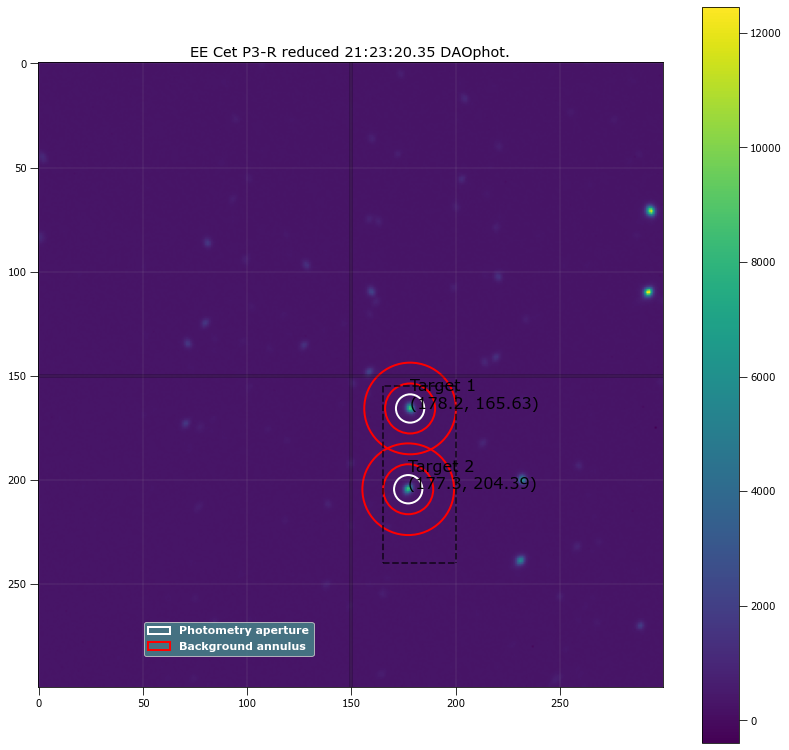

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.20425 165.62806 ...          2361.9168      336966.93          1035.2063
  2 177.29764 204.39082 ...          2299.5512      338654.36          1039.5058

 Aperture are: 145.18035765031303 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.20425 165.62806 ...                 2221.2129             112242.45
  2 177.29764 204.39082 ...                  2158.263             109079.21

Write this out the excel
50 21:23:20.35 P3-R 20.0 6.797966101694915 178.2042540291408 165.62805794316768 112242.44594865934 2221.2129004008325 1

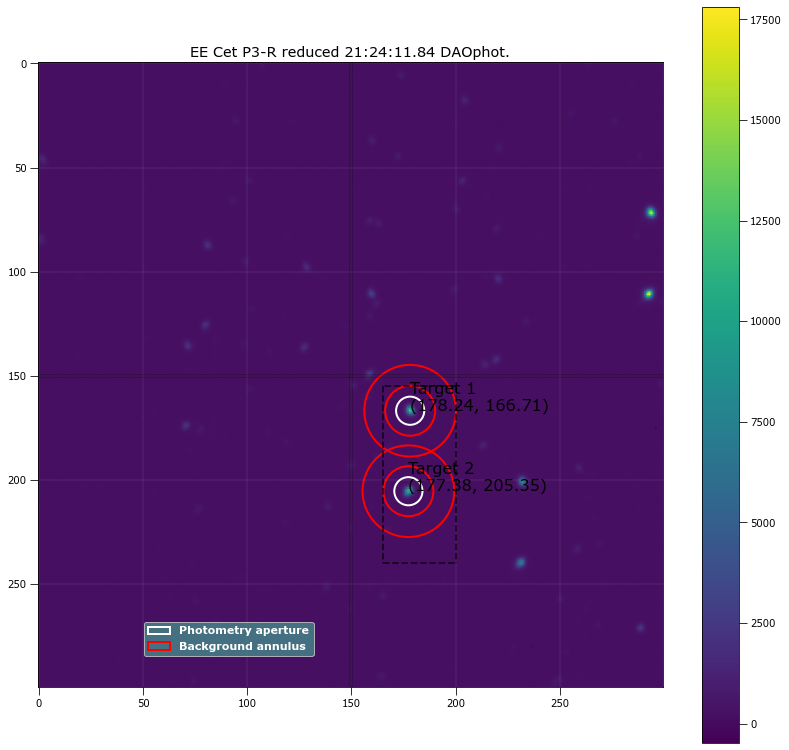

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.23702 166.71002 ...          3101.8935       290924.3          897.69246
  2 177.37972 205.34742 ...          2972.1747      292130.26          899.45139

 Aperture are: 143.5848423772425 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.23702 166.71002 ...                 2981.2213             146201.64
  2 177.37972 205.34742 ...                  2851.266             142510.94

Write this out the excel
51 21:24:11.84 P3-R 20.0 6.760508474576271 178.2370152900217 166.71002190441087 146201.64156680604 2981.2212802100694 17

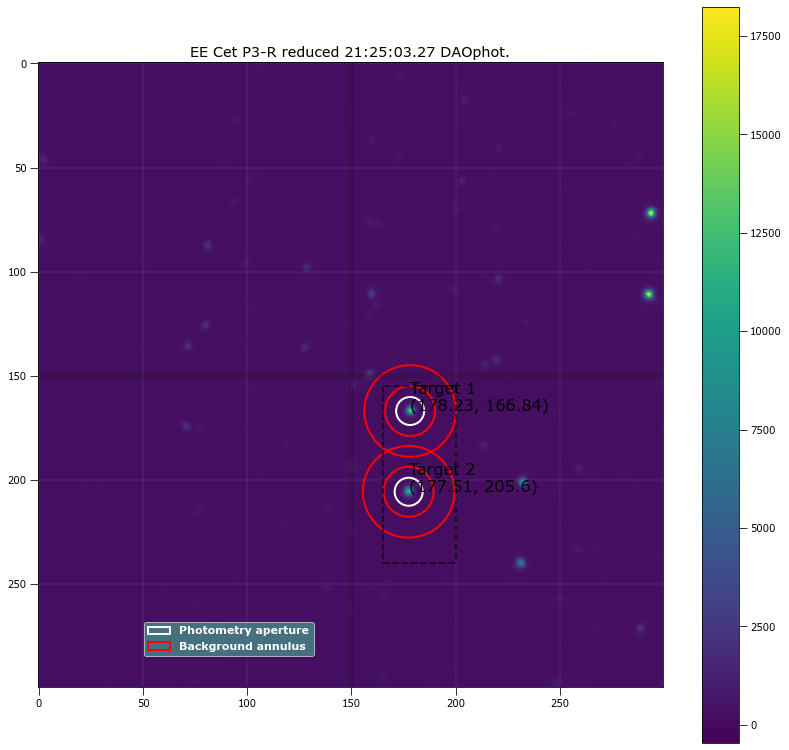

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.22572 166.83734 ...          3422.4196      272644.19          842.84716
  2 177.51288  205.5968 ...          3155.1301      271435.14          836.96883

 Aperture are: 141.99814287704146 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.22572 166.83734 ...                 3310.3719             165113.86
  2 177.51288  205.5968 ...                 3043.8639              160048.8

Write this out the excel
52 21:25:03.27 P3-R 20.0 6.723050847457627 178.2257153231746 166.8373448809891 165113.8633583662 3310.3719239087227 177

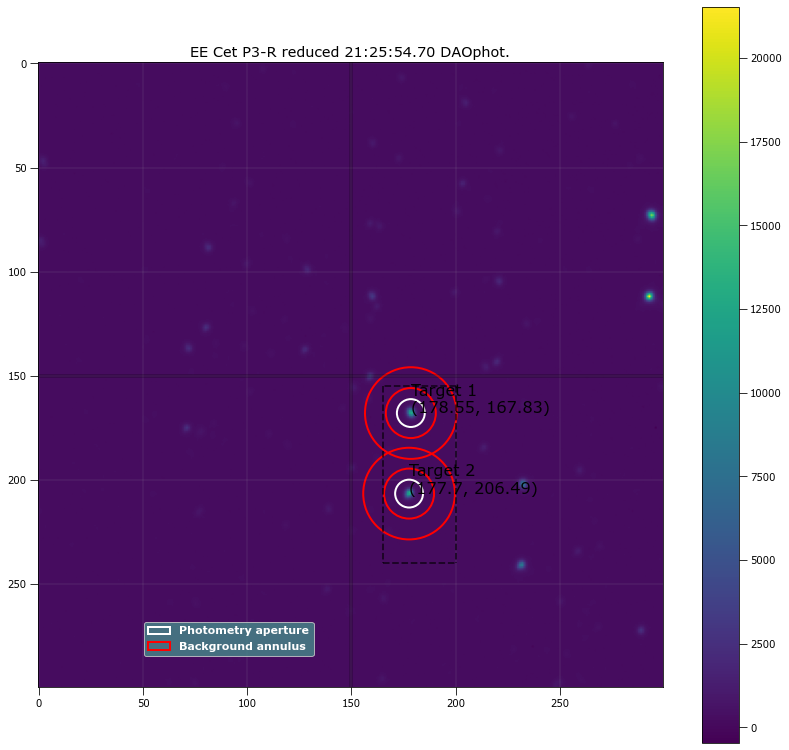

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.55327 167.82987 ...          3232.8521      280640.88          867.15346
  2 177.70492 206.48585 ...          3184.6818      281229.19          867.06768

 Aperture are: 140.42025914971 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.55327 167.82987 ...                 3118.8542             155307.59
  2 177.70492 206.48585 ...                 3070.6952             150189.24

Write this out the excel
53 21:25:54.70 P3-R 20.0 6.685593220338983 178.5532748024362 167.82986688614577 155307.58788323833 3118.8541713057252 177.

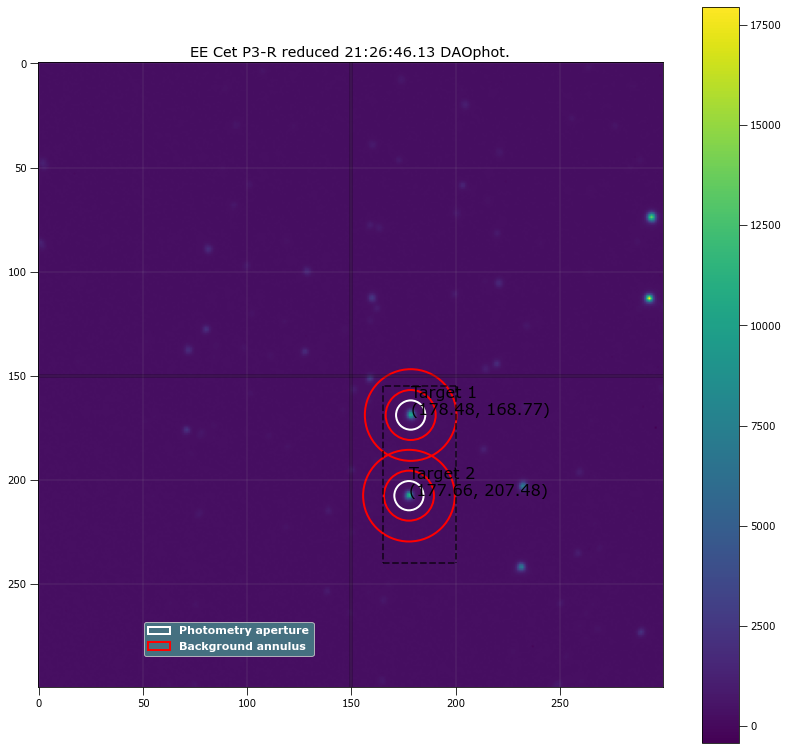

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.48252 168.77373 ...          2686.5247      319564.05           983.2959
  2 177.65586 207.48202 ...          2728.3156      318947.76          980.25588

 Aperture are: 154.93858051899616 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.48252 168.77373 ...                 2543.8933             125579.66
  2 177.65586 207.48202 ...                 2586.1252              122210.1

Write this out the excel
54 21:26:46.13 P3-R 20.0 7.02271186440678 178.48251927796488 168.77373390036115 125579.65785367528 2543.8933402783814 1

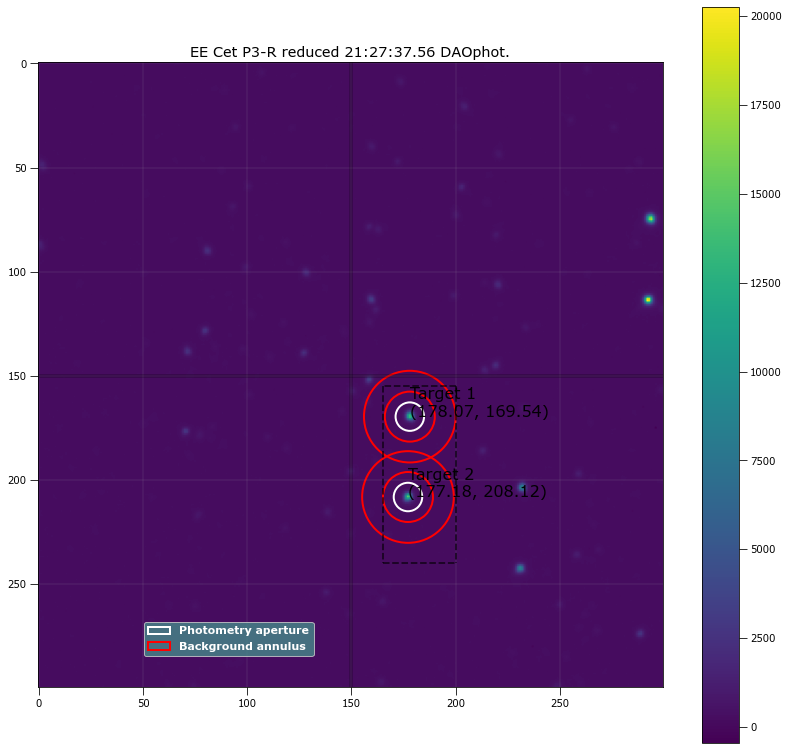

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.06502 169.53918 ...          3520.3368      271011.14          839.44088
  2  177.1794 208.12335 ...          3470.7746      270904.03          836.83788

 Aperture are: 146.78468869625308 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.06502 169.53918 ...                 3404.9803              168040.9
  2  177.1794 208.12335 ...                 3355.7758             162577.57

Write this out the excel
55 21:27:37.56 P3-R 20.0 6.835423728813559 178.06502236352483 169.53918164634263 168040.8954423293 3404.98030497686 177

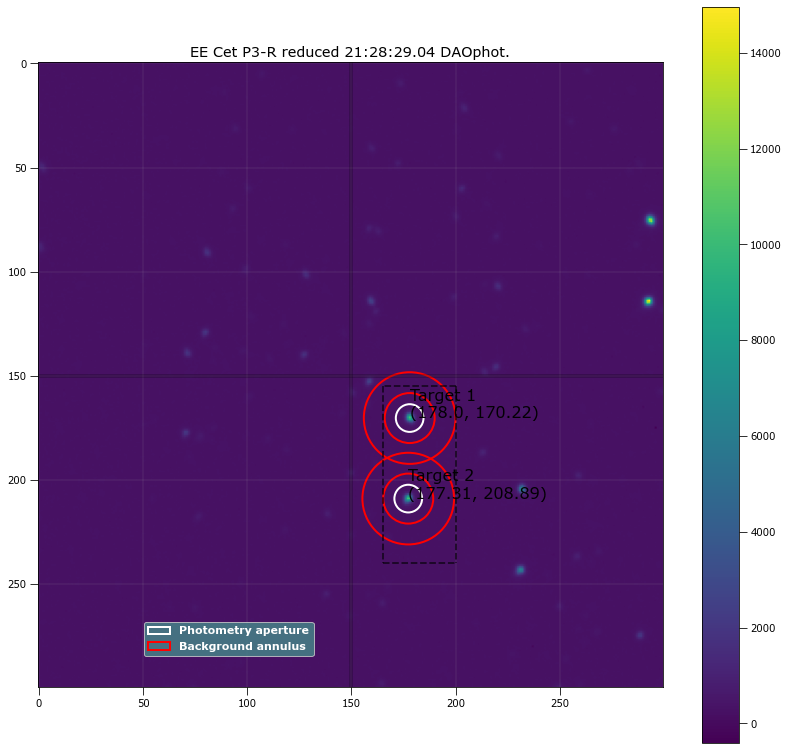

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  177.9992 170.22309 ...          2556.1066      320973.15            987.196
  2 177.30607 208.89017 ...          2514.9924      320550.66          984.92565

 Aperture are: 138.851191195248 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  177.9992 170.22309 ...                 2427.7777             115397.85
  2 177.30607 208.89017 ...                 2386.9587              112693.1

Write this out the excel
56 21:28:29.04 P3-R 20.0 6.6481355932203385 177.99919958662755 170.22309487786762 115397.84609860994 2427.7777351062227 1

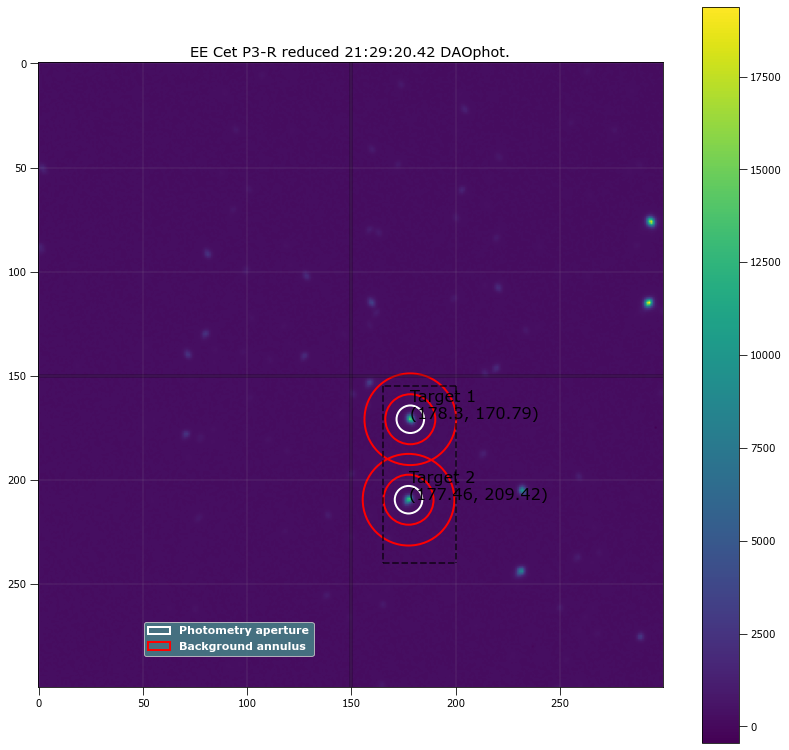

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  178.3044 170.79486 ...          3444.0088      279367.75          863.71066
  2 177.45943 209.42408 ...          3290.0405         279487          862.09676

 Aperture are: 137.29093901365553 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  178.3044 170.79486 ...                 3332.9939             159175.61
  2 177.45943 209.42408 ...                  3179.233             154915.18

Write this out the excel
57 21:29:20.42 P3-R 20.0 6.610677966101695 178.304400377314 170.7948620271114 159175.6077897099 3332.9938788975383 177.

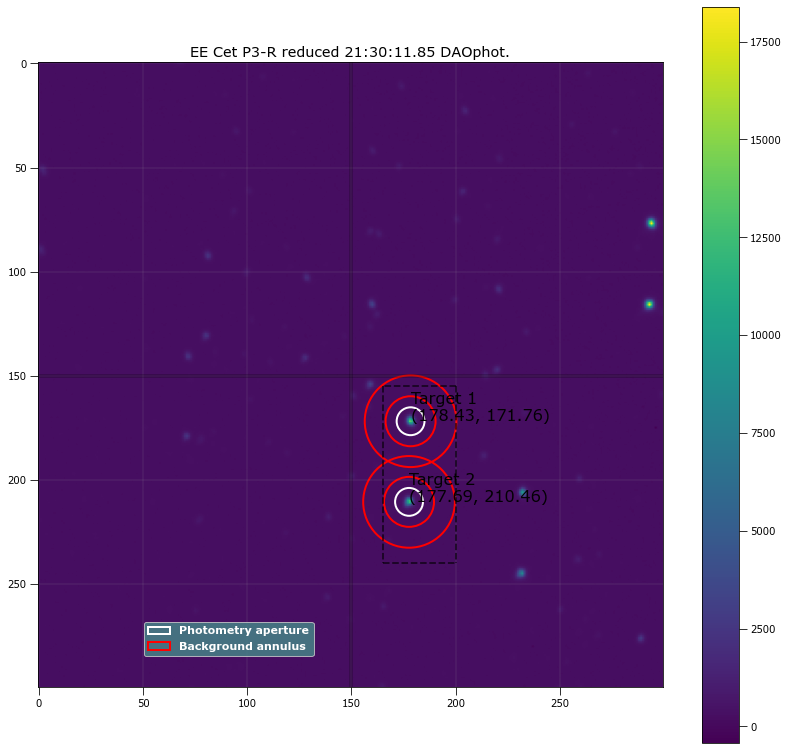

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.43327 171.75667 ...          3201.1411      292091.87          901.72412
  2 177.68608 210.46085 ...          3003.5412      292314.54          900.33898

 Aperture are: 140.42025914971 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.43327 171.75667 ...                 3082.5984             141940.53
  2 177.68608 210.46085 ...                 2885.1806             138216.89

Write this out the excel
58 21:30:11.85 P3-R 20.0 6.685593220338983 178.43327128906787 171.75667264851032 141940.53358802706 3082.5984397838165 177

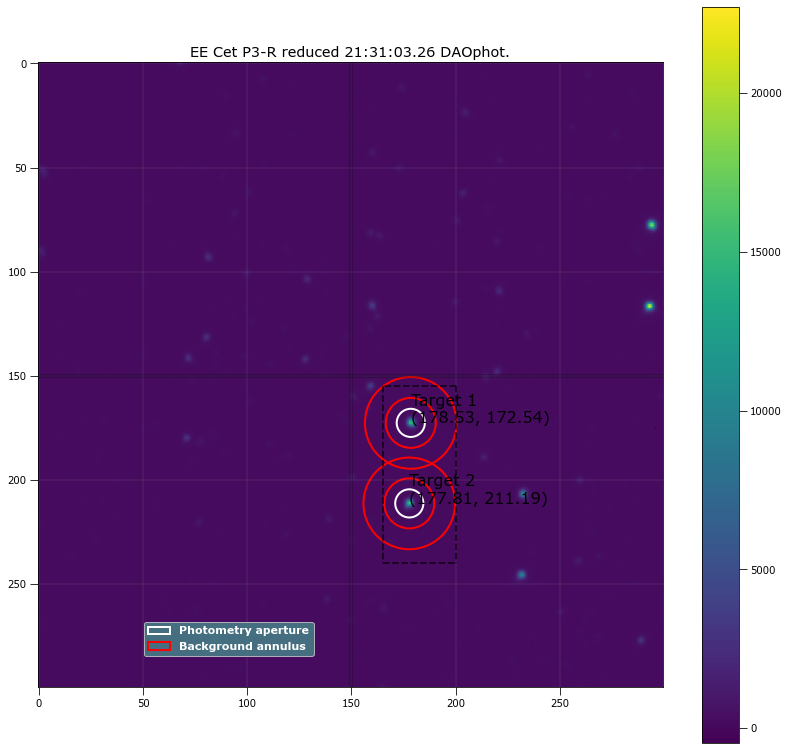

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.52834 172.54069 ...          3726.8738      260362.32          808.51192
  2 177.81187 211.19435 ...          3689.9156       260811.9          807.13807

 Aperture are: 143.5848423772425 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.52834 172.54069 ...                 3618.1896             173868.33
  2 177.81187 211.19435 ...                 3581.4161             169744.15

Write this out the excel
59 21:31:03.26 P3-R 20.0 6.760508474576271 178.52834065112035 172.54069450808288 173868.3272577804 3618.1896087766686 17

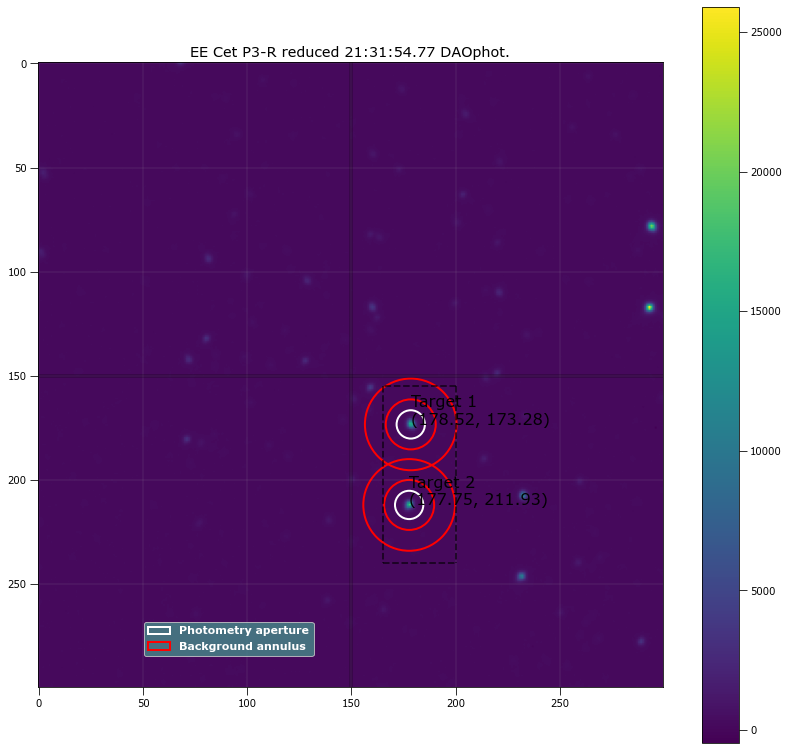

 id xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
      pix       pix    ...                                                     
--- -------- --------- ... ------------------ -------------- ------------------
  1 178.5156 173.27509 ...          3954.2249      250191.46          779.54009
  2 177.7469 211.93301 ...          3972.9406      250823.07          777.98572

 Aperture are: 145.18035765031303 Annulus Area: 1068.1415022205297 

 id xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
      pix       pix    ...                                                
--- -------- --------- ... ------------------------- ---------------------
  1 178.5156 173.27509 ...                 3848.2708             186540.54
  2 177.7469 211.93301 ...                 3867.1979             181884.25

Write this out the excel
60 21:31:54.77 P3-R 20.0 6.797966101694915 178.51560133678072 173.2750922548492 186540.5405472567 3848.2708329552684 177.74689844

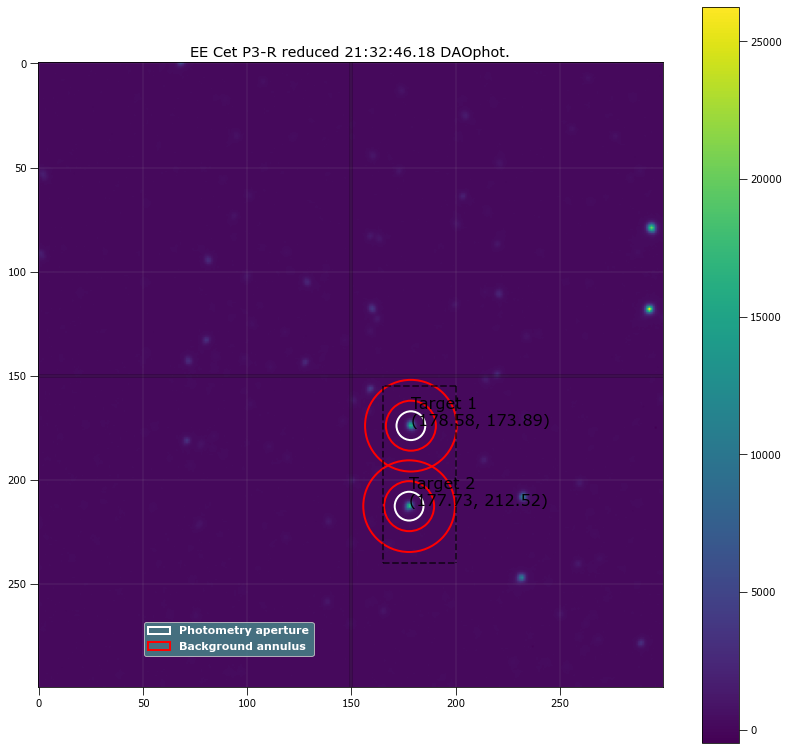

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  178.5817 173.89224 ...          4006.1574       247672.7          772.21997
  2 177.73016 212.51993 ...          3994.0467       247088.1          765.97932

 Aperture are: 150.01979810674172 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  178.5817 173.89224 ...                 3897.6996             186203.98
  2 177.73016 212.51993 ...                 3886.4654             181360.94

Write this out the excel
61 21:32:46.18 P3-R 20.0 6.910338983050847 178.58169917773714 173.89224393590413 186203.98116369138 3897.69955269942 17

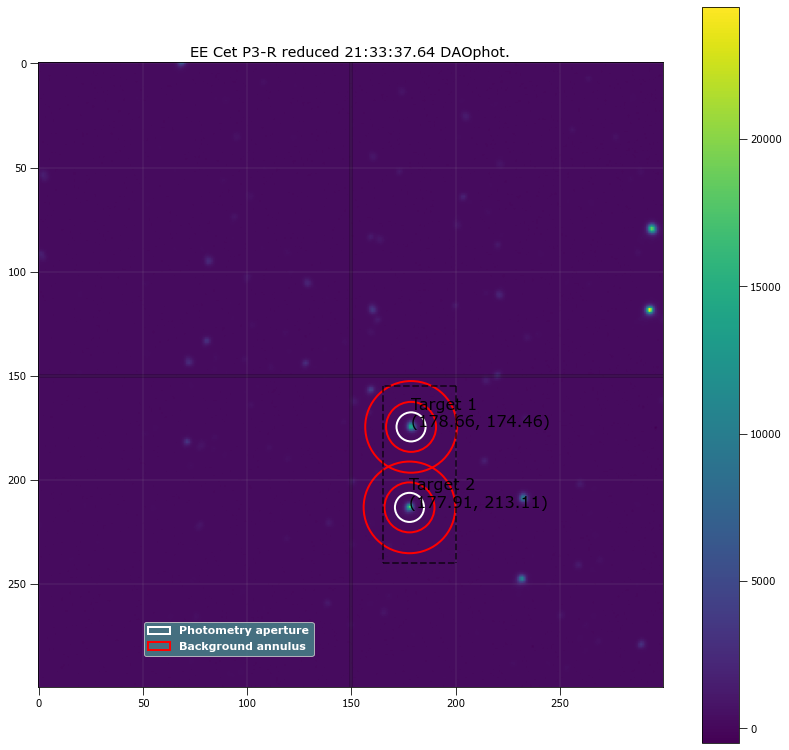

 id xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
      pix       pix    ...                                                     
--- -------- --------- ... ------------------ -------------- ------------------
  1 178.6634 174.46174 ...          3813.9477      248090.43          773.43976
  2 177.9072 213.10783 ...           3962.456      247746.78          769.21089

 Aperture are: 153.29017060870845 Annulus Area: 1068.1415022205297 

 id xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
      pix       pix    ...                                                
--- -------- --------- ... ------------------------- ---------------------
  1 178.6634 174.46174 ...                 3702.9505             184368.97
  2 177.9072 213.10783 ...                 3852.0657             180143.85

Write this out the excel
62 21:33:37.64 P3-R 20.0 6.985254237288135 178.66340331809118 174.46174175805692 184368.972188051 3702.95051648248 177.9071968443

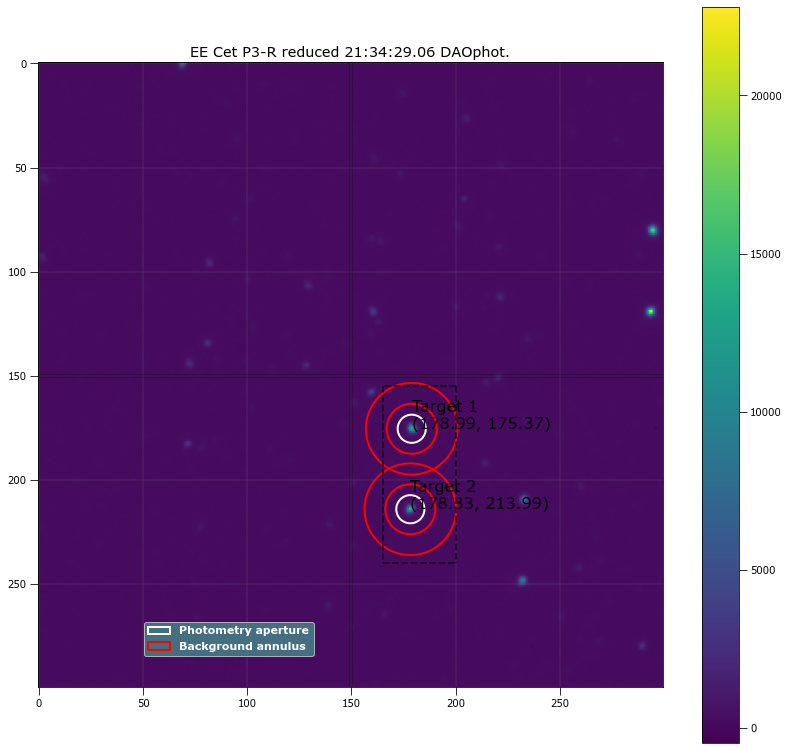

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.98742  175.3655 ...          3485.4171      266443.43          825.63866
  2 178.32755 213.99116 ...           3499.629      264312.97          816.64809

 Aperture are: 143.5848423772425 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.98742  175.3655 ...                 3374.4307             162461.52
  2 178.32755 213.99116 ...                 3389.8511             158715.42

Write this out the excel
63 21:34:29.06 P3-R 20.0 6.760508474576271 178.98742274681092 175.3654969379938 162461.52125760308 3374.430653111554 178

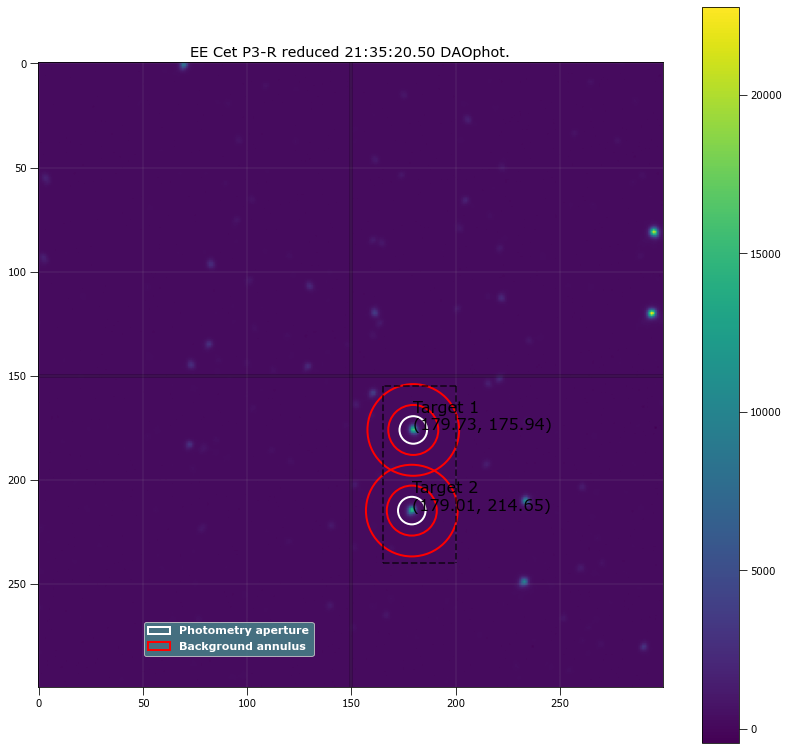

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 179.72872 175.93673 ...          3817.2977      252580.02          784.81007
  2 179.01234 214.64676 ...           3686.408      251004.96          776.73073

 Aperture are: 137.29093901365556 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 179.72872 175.93673 ...                 3716.4241             177704.43
  2 179.01234 214.64676 ...                 3586.5728             173255.14

Write this out the excel
64 21:35:20.50 P3-R 20.0 6.6106779661016954 179.7287190125948 175.93672735611497 177704.43191676965 3716.424094181144 1

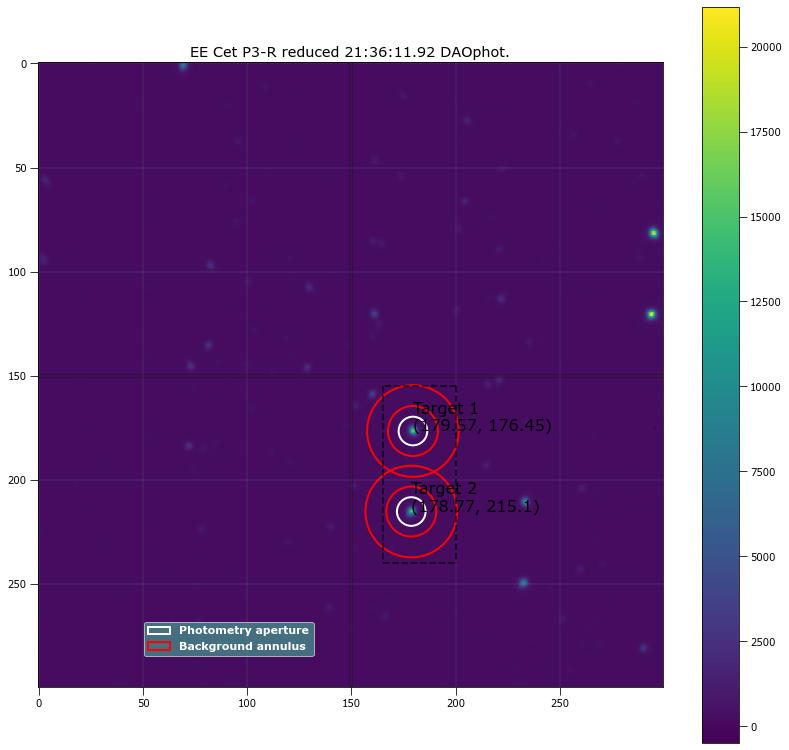

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 179.56937 176.45032 ...          3876.2545      251220.36          780.36919
  2 178.76958 215.09788 ...          3682.9739      250894.84          777.22291

 Aperture are: 148.39783551506267 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 179.56937 176.45032 ...                 3767.8371             180213.01
  2 178.76958 215.09788 ...                 3574.9937             175960.84

Write this out the excel
65 21:36:11.92 P3-R 20.0 6.872881355932203 179.5693744574704 176.45032283786244 180213.0085206324 3767.837101884664 178

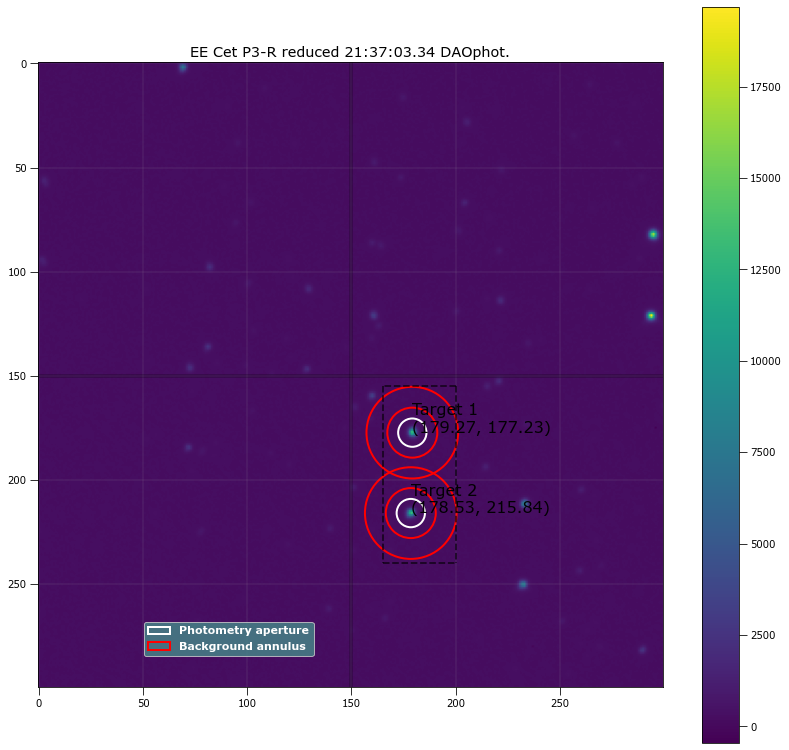

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 179.26522 177.22708 ...          3187.3766      278128.23          859.08781
  2 178.53211 215.83886 ...          3124.8609      278382.83          858.55665

 Aperture are: 145.18035765031303 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 179.26522 177.22708 ...                 3070.6106             148782.95
  2 178.53211 215.83886 ...                  3008.167             144767.69

Write this out the excel
66 21:37:03.34 P3-R 20.0 6.797966101694915 179.26522446448098 177.22707735173796 148782.94941541465 3070.610558233361 1

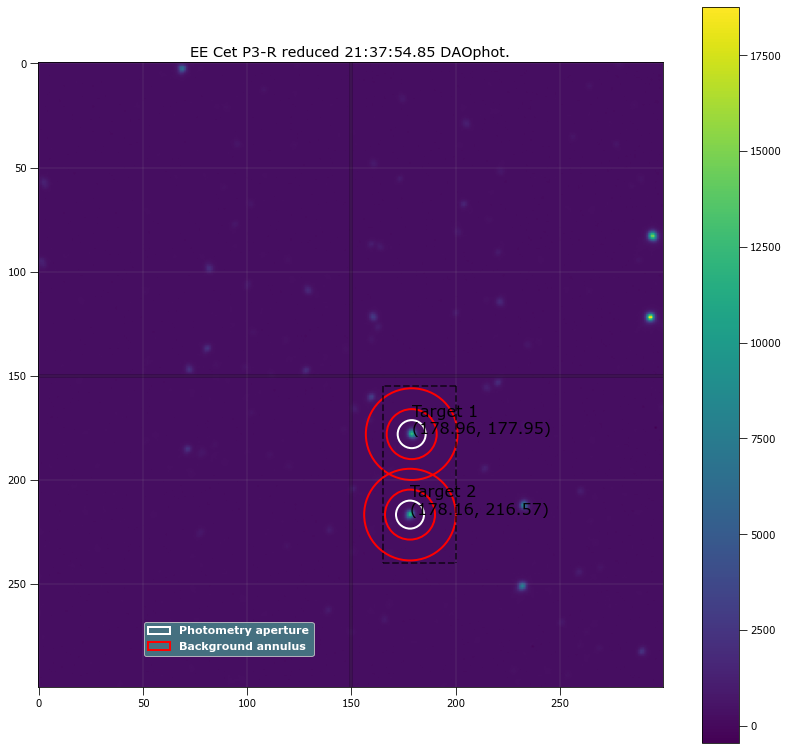

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.96275 177.94842 ...          3050.6529      290520.64          895.75856
  2 178.15709 216.56979 ...          3043.3479      289888.79          892.53416

 Aperture are: 141.99814287704146 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.96275 177.94842 ...                 2931.5712             142018.86
  2 178.15709 216.56979 ...                 2924.6949             138388.47

Write this out the excel
67 21:37:54.85 P3-R 20.0 6.7230508474576265 178.96275039361547 177.94842414385363 142018.8559961876 2931.571206168216 1

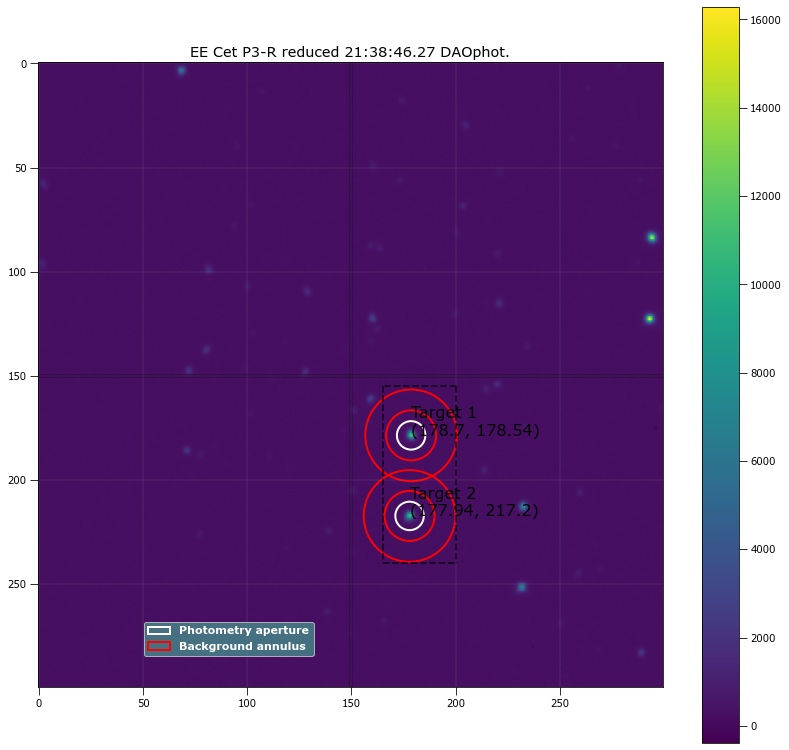

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.69987  178.5404 ...            2926.46      294352.08          907.06496
  2 177.94436 217.20288 ...          2831.2806      292898.88          901.24531

 Aperture are: 146.78468869625308 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.69987  178.5404 ...                 2801.8106             135193.71
  2 177.94436 217.20288 ...                 2707.4309              132403.5

Write this out the excel
68 21:38:46.27 P3-R 20.0 6.835423728813559 178.6998710088338 178.5404033846379 135193.7097854048 2801.8105833777745 177

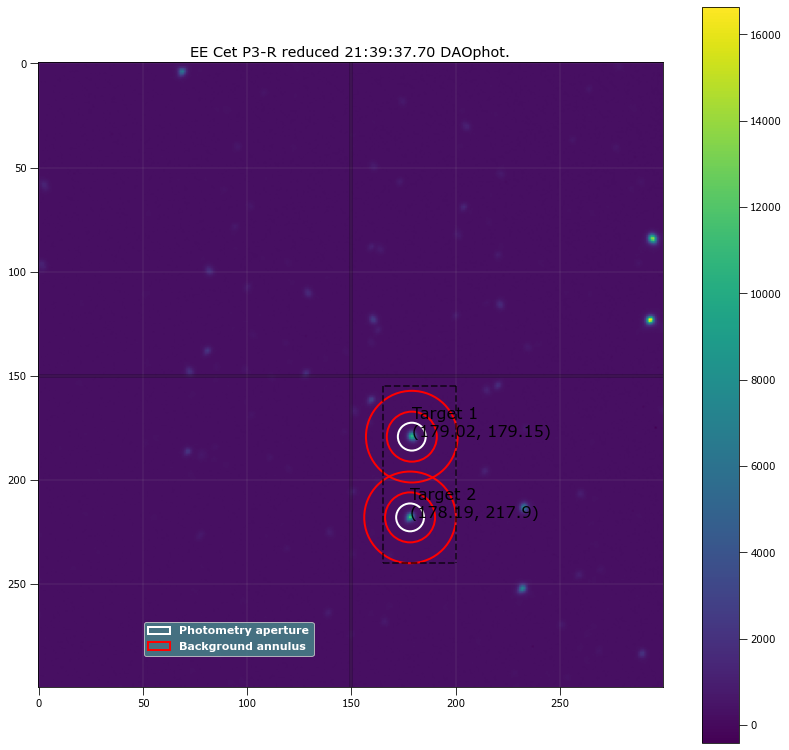

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  179.0162 179.15205 ...          2743.0322      296481.29          913.50671
  2 178.18745 217.90302 ...          2790.0066       296578.6          912.11733

 Aperture are: 140.42025914971 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  179.0162 179.15205 ...                 2622.9406             130954.65
  2 178.18745 217.90302 ...                 2670.0977             127313.34

Write this out the excel
69 21:39:37.70 P3-R 20.0 6.685593220338983 179.0161998111618 179.15204895764336 130954.6469919271 2622.9405825131157 178.1

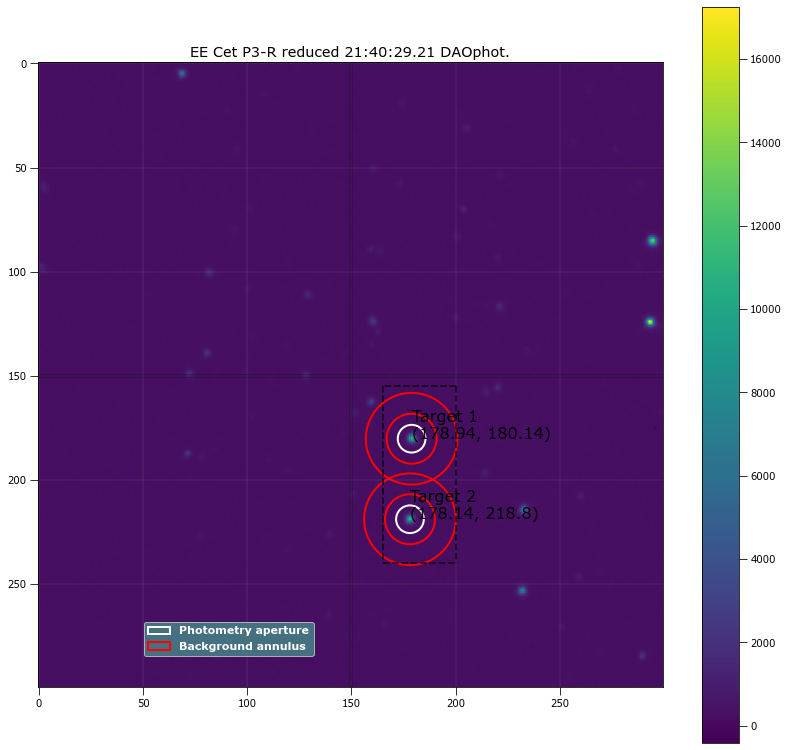

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  178.9372 180.13823 ...          2683.0169      303853.17          935.69837
  2 178.13789 218.80297 ...          2700.7181      303909.58          934.45266

 Aperture are: 138.851191195248 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  178.9372 180.13823 ...                 2561.3824             124801.91
  2 178.13789 218.80297 ...                 2579.2455             121338.46

Write this out the excel
70 21:40:29.21 P3-R 20.0 6.6481355932203385 178.93719979877704 180.13823340196873 124801.90577997366 2561.382384946228 17

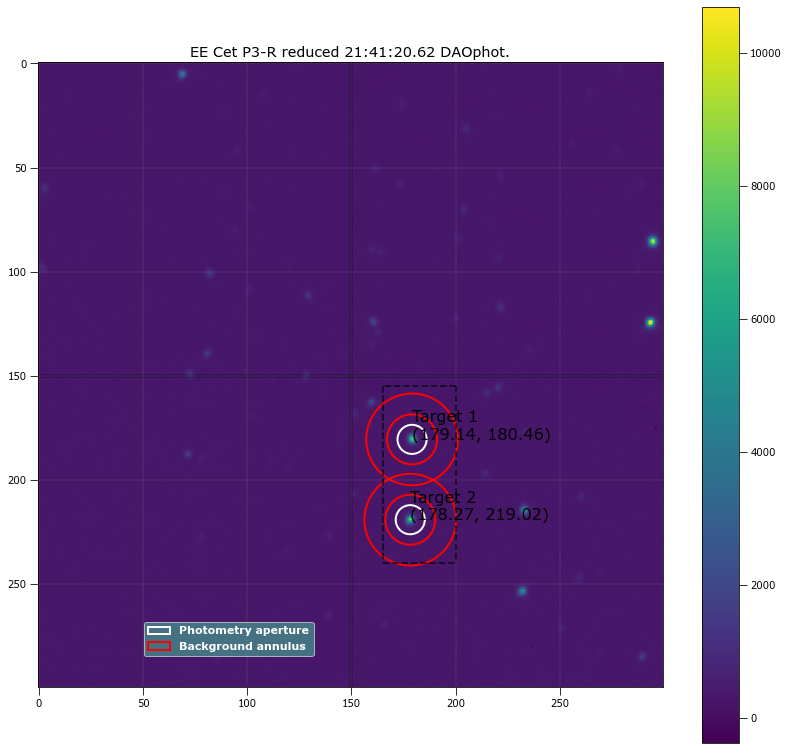

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 179.14103 180.46233 ...          2061.7521      343048.47           1053.371
  2 178.27135 219.01951 ...          2036.0265      343710.32          1054.5863

 Aperture are: 153.29017060870845 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 179.14103 180.46233 ...                 1910.5817              92591.47
  2 178.27135 219.01951 ...                 1884.6817             89998.788

Write this out the excel
71 21:41:20.62 P3-R 20.0 6.985254237288135 179.14103067033892 180.46232617195275 92591.46996363372 1910.5817110100888 1

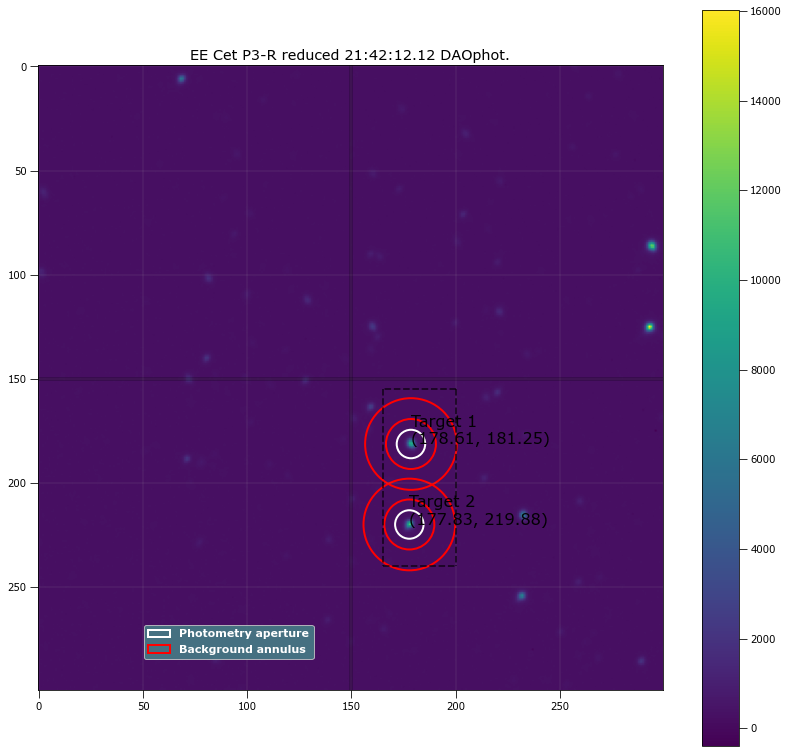

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1    178.61 181.24516 ...          2498.5003       313147.8          963.46901
  2 177.83391 219.87607 ...           2541.343      314522.31          966.61108

 Aperture are: 146.78468869625308 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1    178.61 181.24516 ...                 2366.0997              114577.3
  2 177.83391 219.87607 ...                 2408.5107             111550.95

Write this out the excel
72 21:42:12.12 P3-R 20.0 6.835423728813559 178.61000064185177 181.24515725016076 114577.30151409793 2366.099730401207 1

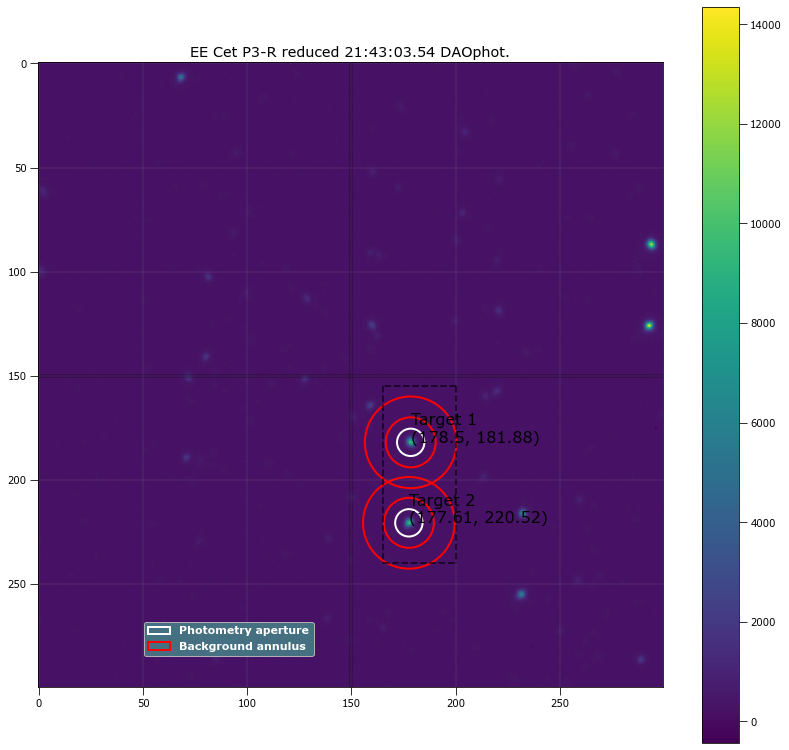

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  178.4992 181.88189 ...          2417.7594      316151.53          971.84967
  2 177.61176 220.51893 ...          2373.3067      316511.46          972.33082

 Aperture are: 135.7395026049326 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  178.4992 181.88189 ...                 2294.2566              109759.5
  2 177.61176 220.51893 ...                 2249.7428             107278.87

Write this out the excel
73 21:43:03.54 P3-R 20.0 6.573220338983051 178.49919988199414 181.8818865298636 109759.49762256653 2294.2566204575196 17

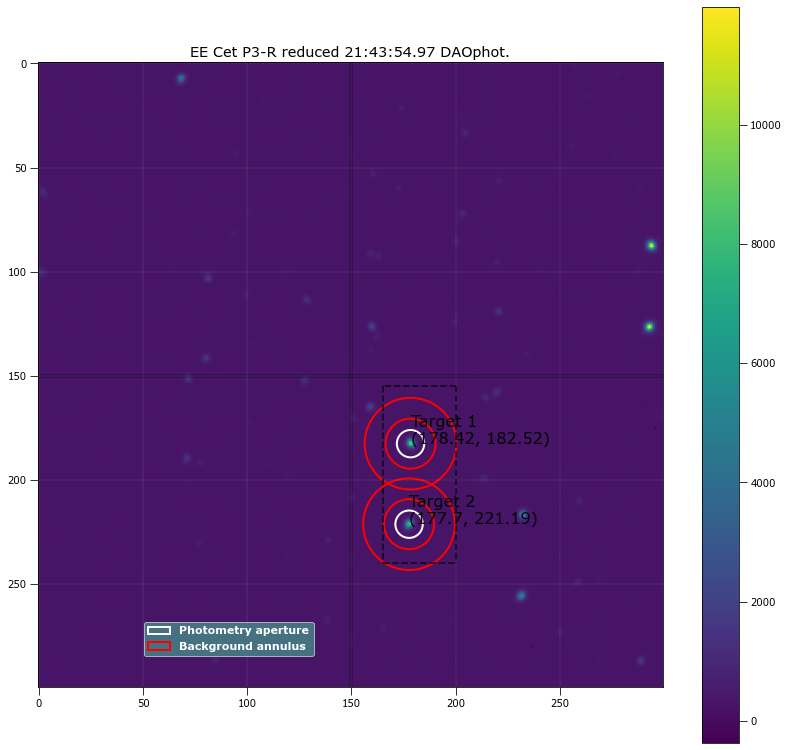

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.41963 182.51875 ...          2263.9087      324045.52          995.67621
  2 177.69879  221.1856 ...          2136.1551      324407.87          996.02702

 Aperture are: 135.7395026049326 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.41963 182.51875 ...                 2137.3781             100443.73
  2 177.69879  221.1856 ...                 2009.5799             98838.089

Write this out the excel
74 21:43:54.97 P3-R 20.0 6.573220338983051 178.419625442229 182.5187501731917 100443.7325638801 2137.378093922026 177.69

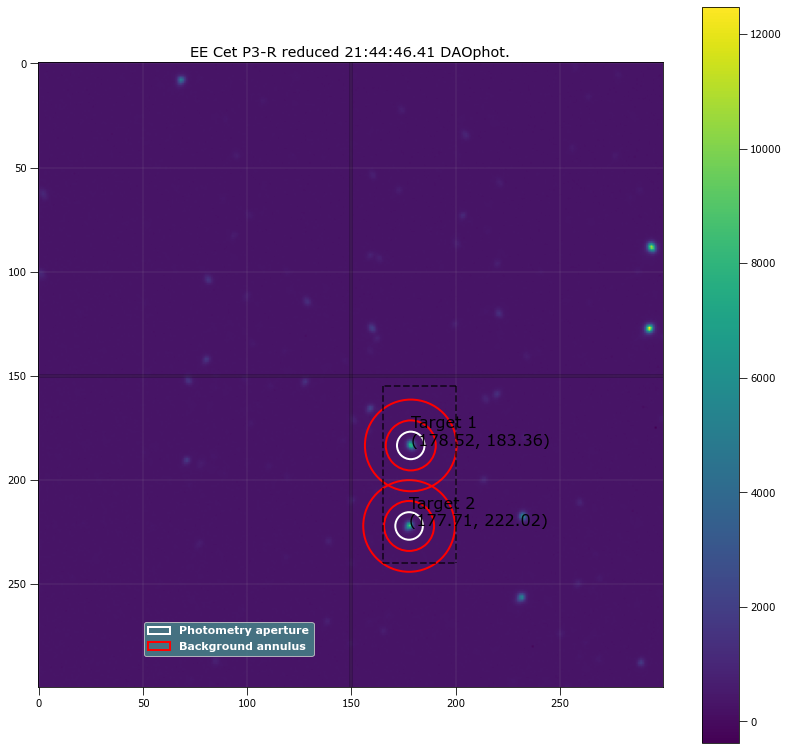

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.51982 183.36022 ...          2086.1203      337384.88          1035.8674
  2 177.71342 222.02016 ...          2069.3439      336683.59          1033.0296

 Aperture are: 137.29093901365553 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.51982 183.36022 ...                 1952.9777             92340.017
  2 177.71342 222.02016 ...                 1936.5659             90809.057

Write this out the excel
75 21:44:46.41 P3-R 20.0 6.610677966101695 178.51982456989748 183.360216365209 92340.01740995803 1952.9776823058705 177

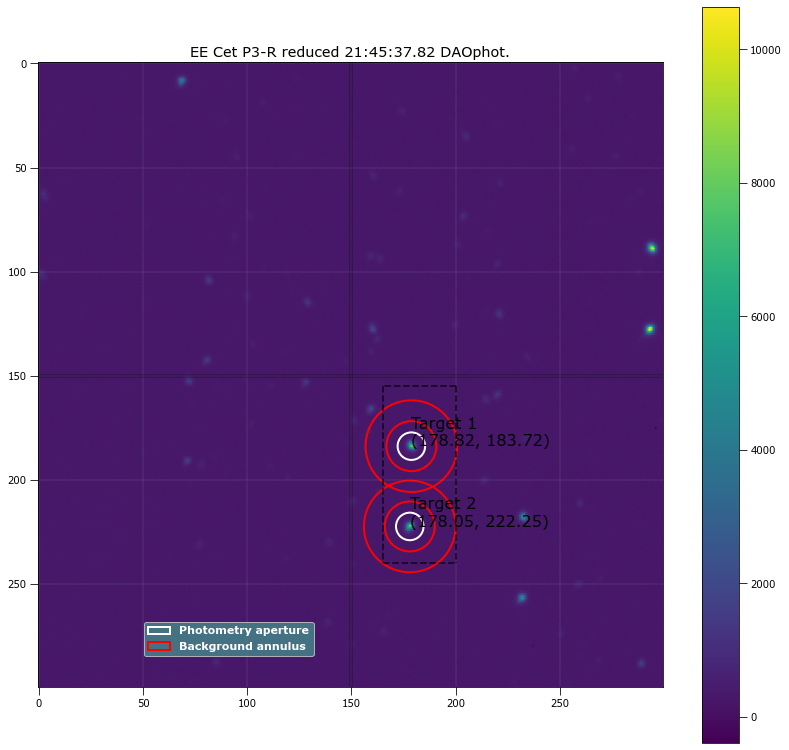

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.82044 183.71578 ...          1977.9327      342832.13          1052.2113
  2 178.04855 222.25163 ...           1951.066       341661.2          1048.2106

 Aperture are: 137.29093901365553 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.82044 183.71578 ...                 1842.6893             86868.644
  2 178.04855 222.25163 ...                 1816.3369             85877.719

Write this out the excel
76 21:45:37.82 P3-R 20.0 6.610677966101695 178.82044498223178 183.71578410425533 86868.6439700177 1842.6892809218386 17

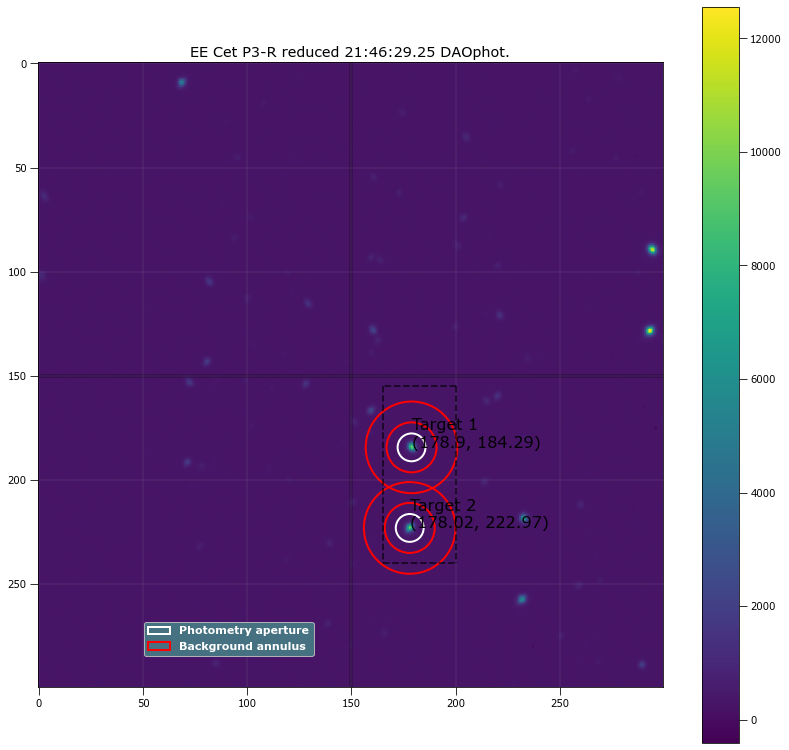

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.89712 184.29102 ...           2395.334      316978.31          974.48283
  2 178.02219 222.96617 ...          2332.0088      317357.26          974.91672

 Aperture are: 140.42025914971 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.89712 184.29102 ...                 2267.2263             107096.56
  2 178.02219 222.96617 ...                  2203.844             104287.82

Write this out the excel
77 21:46:29.25 P3-R 20.0 6.685593220338983 178.89711988388584 184.29101622776395 107096.56204512648 2267.226348795451 178.

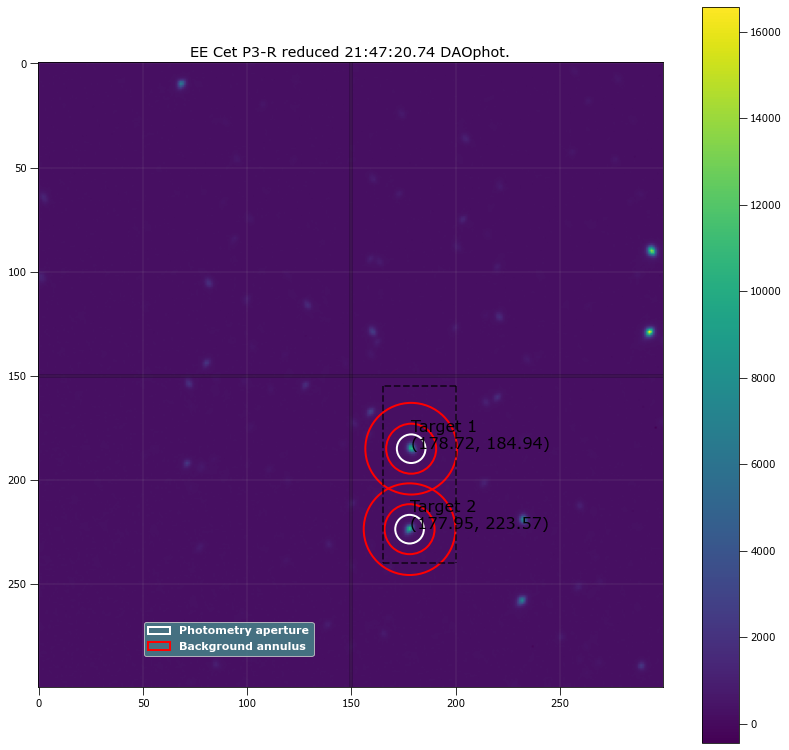

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.71622 184.93583 ...          2665.7112      293429.96          904.06293
  2 177.94608 223.56702 ...          2628.4043      294797.95          906.72271

 Aperture are: 148.39783551506267 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.71622 184.93583 ...                 2540.1089             124289.65
  2 177.94608 223.56702 ...                 2502.4325             121110.55

Write this out the excel
78 21:47:20.74 P3-R 20.0 6.872881355932203 178.71622139890337 184.9358263250534 124289.64859801784 2540.10891582919 177

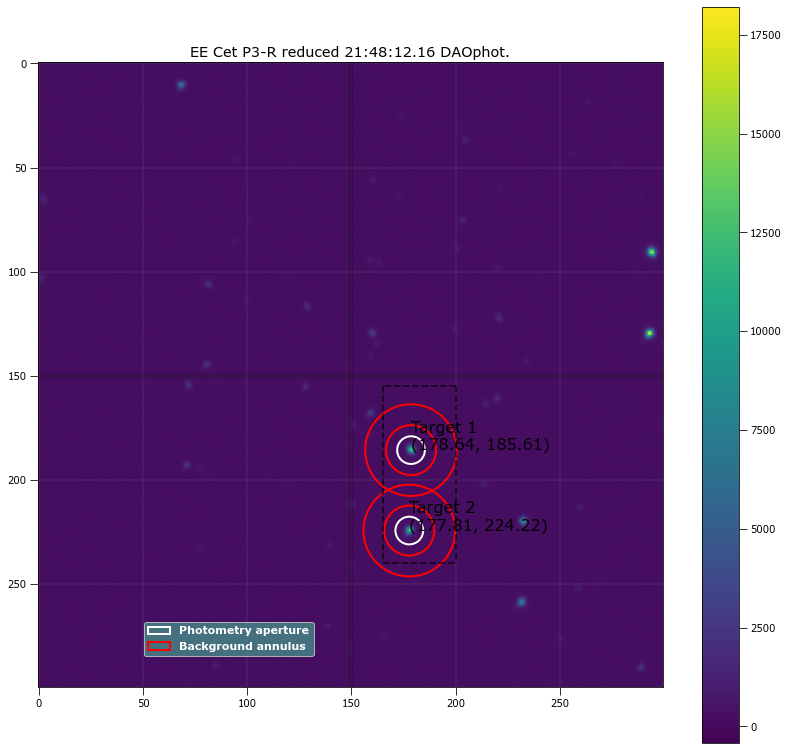

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.64214 185.61475 ...          3087.7013      275650.54          851.35216
  2 177.80948 224.22208 ...          3009.9886      276460.98           851.9968

 Aperture are: 138.851191195248 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.64214 185.61475 ...                 2977.0313             140434.53
  2 177.80948 224.22208 ...                 2899.2347             136967.48

Write this out the excel
79 21:48:12.16 P3-R 20.0 6.6481355932203385 178.64214366269414 185.61474890874607 140434.52868754658 2977.031308174155 17

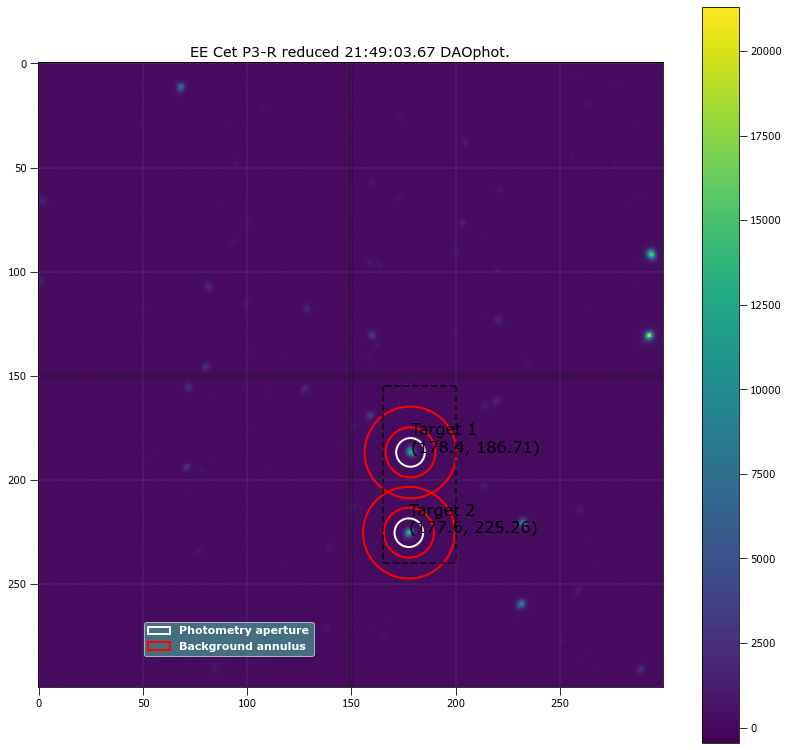

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.39916 186.71144 ...          3411.0144       253985.6          787.32582
  2 177.60291 225.25538 ...          3480.7363      253544.44          783.85452

 Aperture are: 148.39783551506267 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.39916 186.71144 ...                 3301.6306             163964.69
  2 177.60291 225.25538 ...                 3371.8347             160645.43

Write this out the excel
80 21:49:03.67 P3-R 20.0 6.872881355932203 178.39916172557471 186.71144444899628 163964.69123364898 3301.630563102227 1

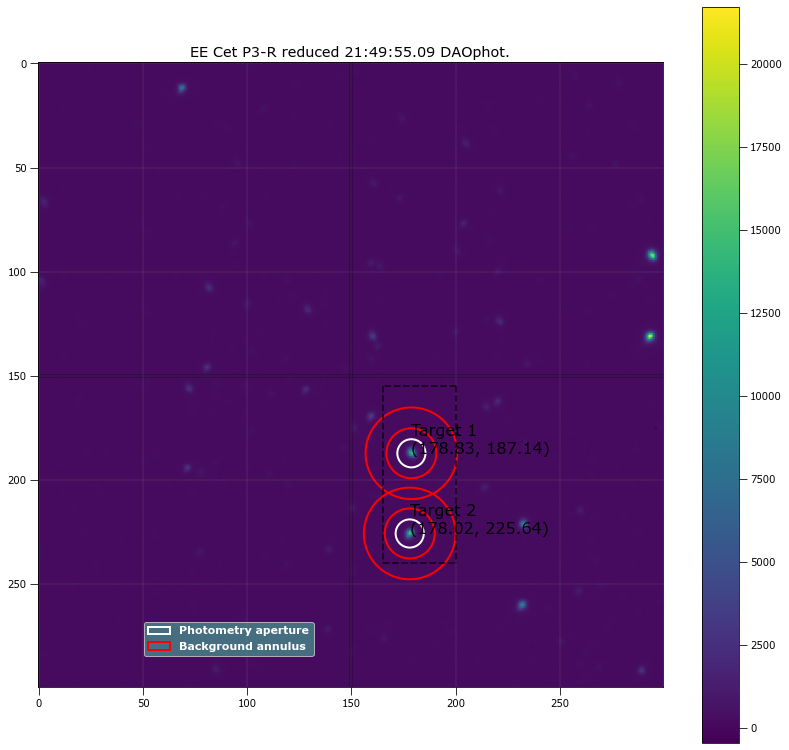

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  178.8256 187.14012 ...             3600.3      248290.34          771.39829
  2 178.01699 225.63817 ...          3600.1327      248404.12          769.61056

 Aperture are: 143.5848423772425 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  178.8256 187.14012 ...                 3496.6048             170755.73
  2 178.01699 225.63817 ...                 3496.6779              166087.6

Write this out the excel
81 21:49:55.09 P3-R 20.0 6.760508474576271 178.82560162250488 187.1401239219381 170755.7346030284 3496.604829550472 178.

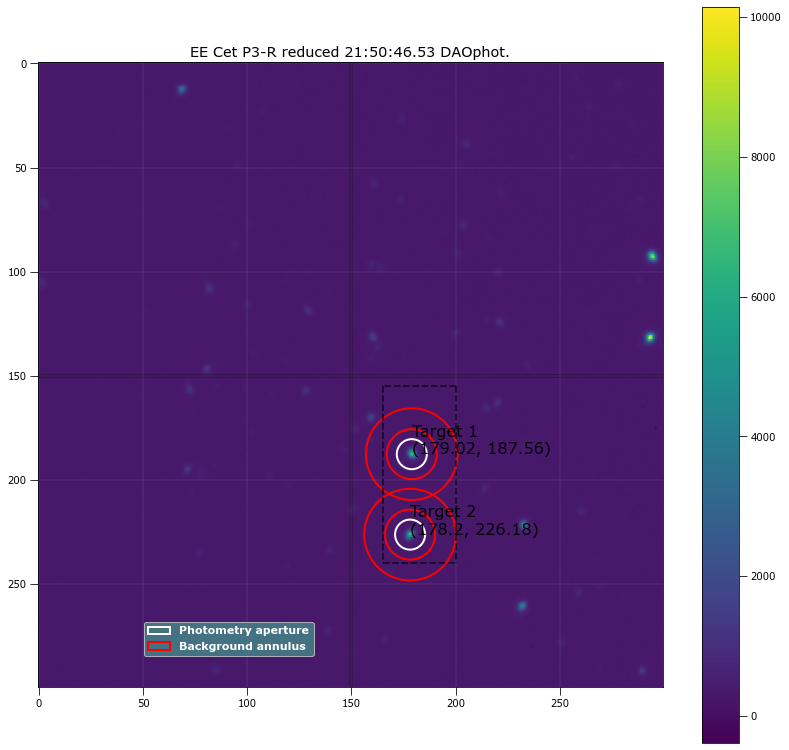

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 179.02256 187.56394 ...          1792.4233      350619.08          1075.7099
  2 178.19534 226.18015 ...          1772.4151      350730.92           1075.718

 Aperture are: 163.31286666347717 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 179.02256 187.56394 ...                 1627.9532             80240.347
  2 178.19534 226.18015 ...                 1607.9438             78083.241

Write this out the excel
82 21:50:46.53 P3-R 20.0 7.21 179.02255753816831 187.5639392451847 80240.34728162742 1627.9532287371253 178.19534344505

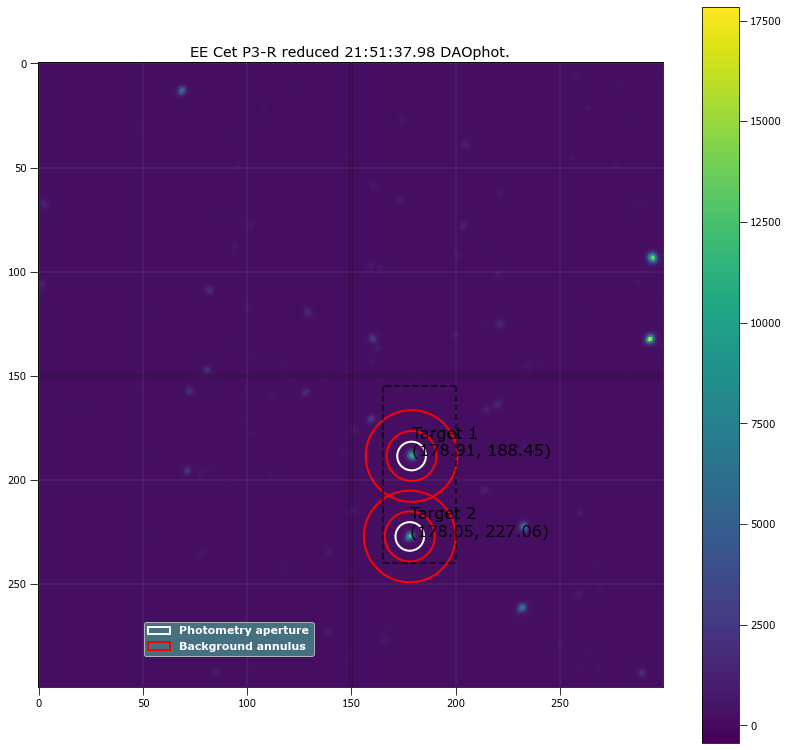

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.91065 188.44896 ...          2929.3786      279144.79          861.66623
  2 178.04854 227.05789 ...          2998.5148      279736.27          861.94248

 Aperture are: 148.39783551506267 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.91065 188.44896 ...                 2809.6666             138585.98
  2 178.04854 227.05789 ...                 2878.7644             135437.71

Write this out the excel
83 21:51:37.98 P3-R 20.0 6.872881355932203 178.91064684674774 188.44896017806428 138585.97595533912 2809.666562471326 1

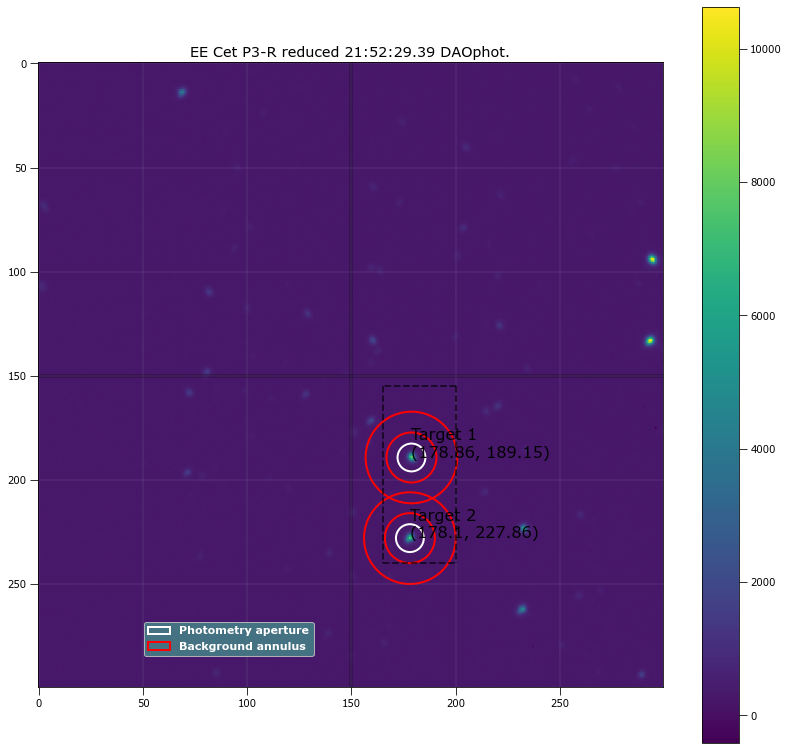

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.85965 189.15224 ...          1967.3972      331733.23          1018.4924
  2 178.09644 227.86344 ...          1892.6085      331775.84          1018.0362

 Aperture are: 140.42025914971 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.85965 189.15224 ...                 1833.5039             85364.467
  2 178.09644 227.86344 ...                 1758.7752             83793.304

Write this out the excel
84 21:52:29.39 P3-R 20.0 6.685593220338983 178.85964767390817 189.15224219521477 85364.46674071377 1833.5039405391021 178.

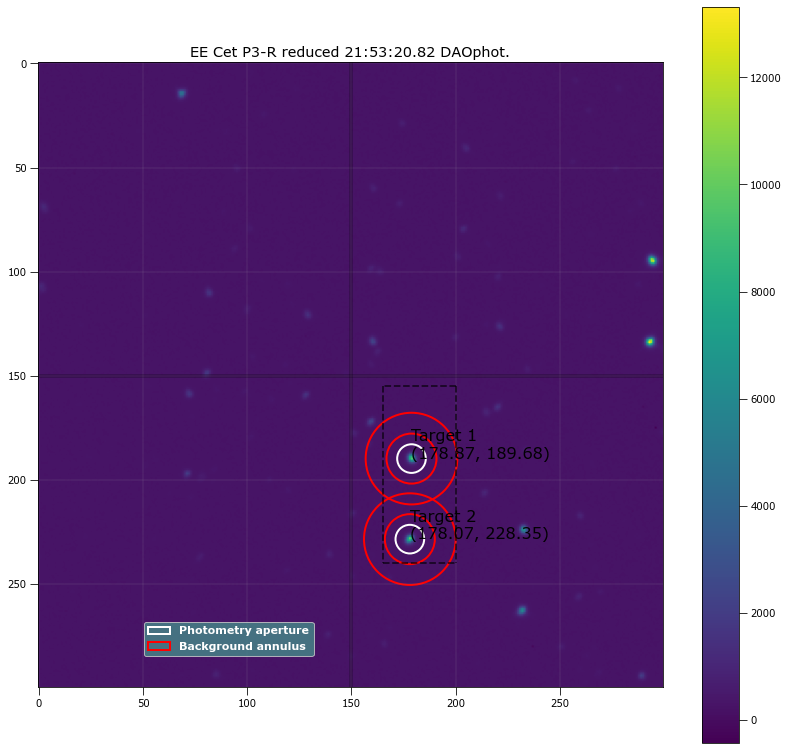

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.87143 189.68472 ...          2379.5662      308403.18          948.38777
  2 178.07452 228.35143 ...           2335.531      308410.52          947.26486

 Aperture are: 148.39783551506267 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.87143 189.68472 ...                 2247.8059             105973.11
  2 178.07452 228.35143 ...                 2203.9267             103033.58

Write this out the excel
85 21:53:20.82 P3-R 20.0 6.872881355932203 178.87142608878673 189.68472349624201 105973.11005989497 2247.805899978788 1

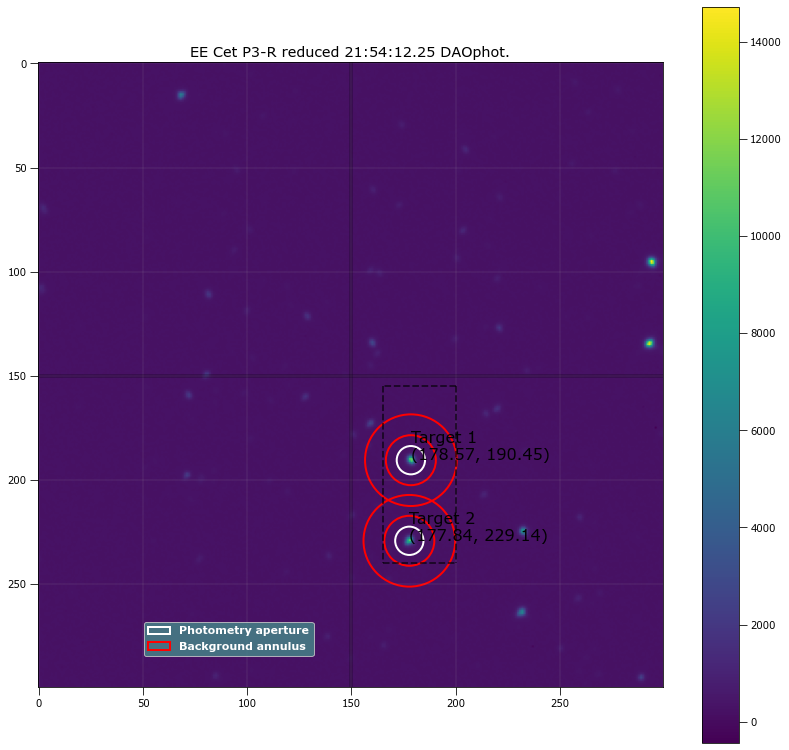

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.57342 190.45069 ...          2727.1566      297221.39          915.55942
  2 177.83676 229.14249 ...          2551.6034      296269.81          911.30971

 Aperture are: 145.18035765031303 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.57342 190.45069 ...                  2602.715             116928.77
  2 177.83676 229.14249 ...                 2427.7394             114594.32

Write this out the excel
86 21:54:12.25 P3-R 20.0 6.797966101694915 178.57341922355565 190.45069064151932 116928.76858801566 2602.714982149408 1

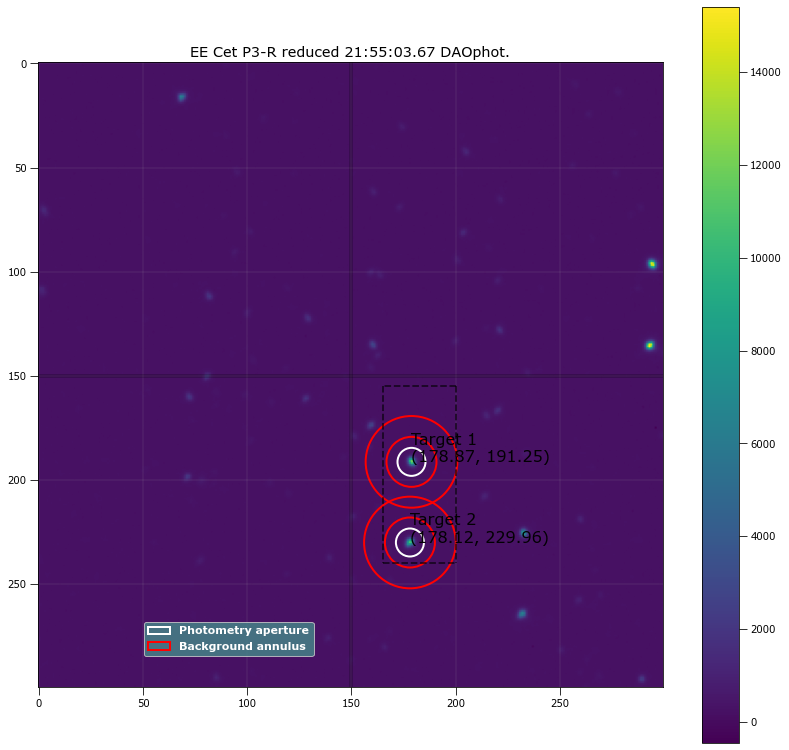

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  178.8744 191.25246 ...          2821.0625      284169.64          876.10339
  2 178.11732 229.95758 ...          2669.8169      284443.34          875.50893

 Aperture are: 141.99814287704146 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  178.8744 191.25246 ...                 2704.5938              124524.6
  2 178.11732 229.95758 ...                 2553.4273             121660.08

Write this out the excel
87 21:55:03.67 P3-R 20.0 6.7230508474576265 178.87439961956704 191.2524632083749 124524.59603772519 2704.593806809949 1

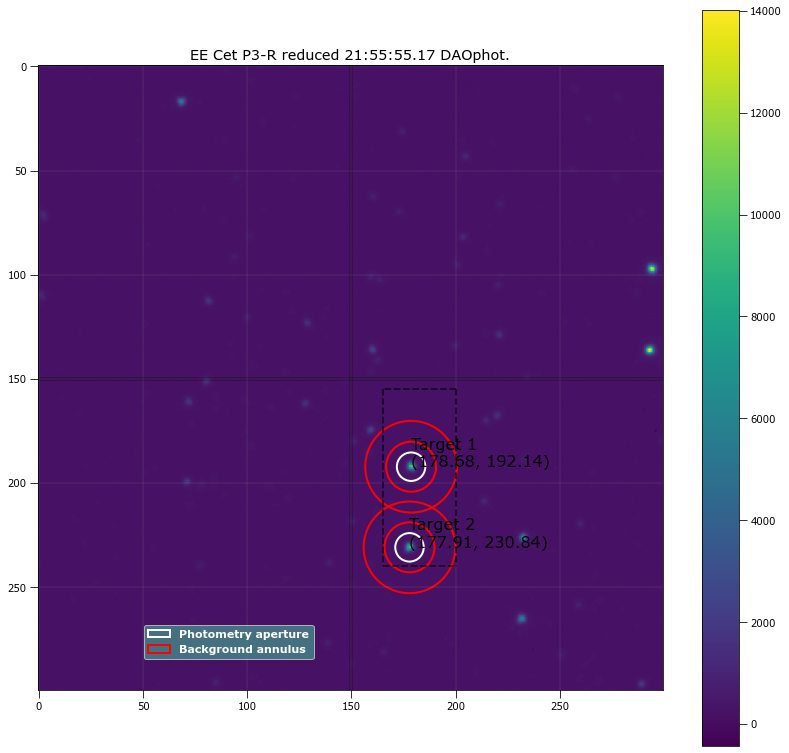

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.68309 192.14458 ...           2471.151      296808.32          913.18739
  2 177.91495  230.8417 ...           2369.038       296869.3          912.48296

 Aperture are: 146.78468869625308 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.68309 192.14458 ...                 2345.6602             108491.39
  2 177.91495  230.8417 ...                  2243.644             106031.23

Write this out the excel
88 21:55:55.17 P3-R 20.0 6.835423728813559 178.6830878444218 192.14458292259255 108491.38788147109 2345.6601968198006 1

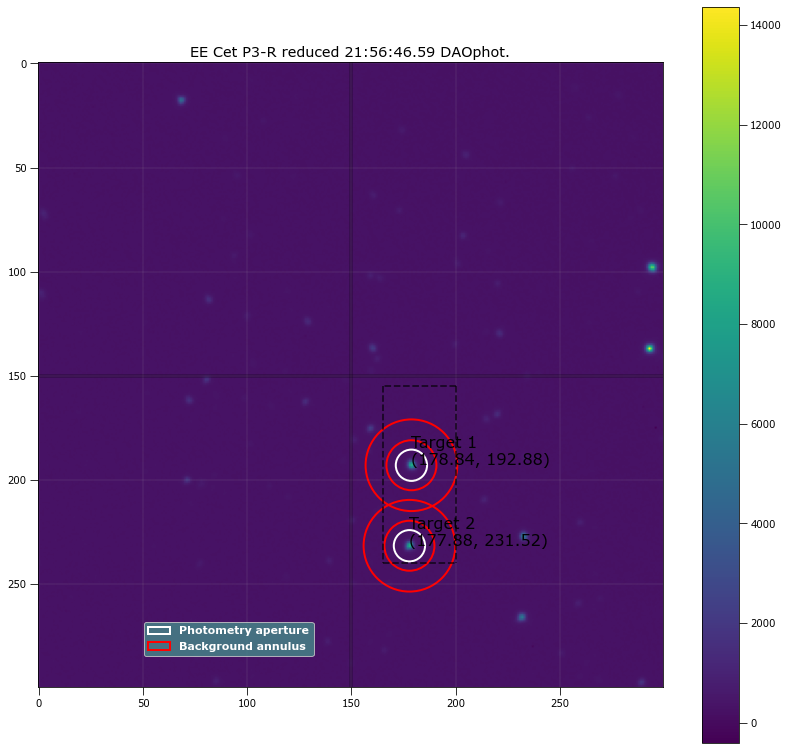

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.83981 192.88044 ...          2145.4545      316981.25          973.70588
  2 177.88441 231.51749 ...          2133.0427      318018.12          976.44186

 Aperture are: 177.17014468386182 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.83981 192.88044 ...                 1983.9482             94561.166
  2 177.88441 231.51749 ...                 1971.0826             92873.889

Write this out the excel
89 21:56:46.59 P3-R 20.0 7.509661016949153 178.83980883297048 192.88043883788262 94561.16618870778 1983.9482053761922 1

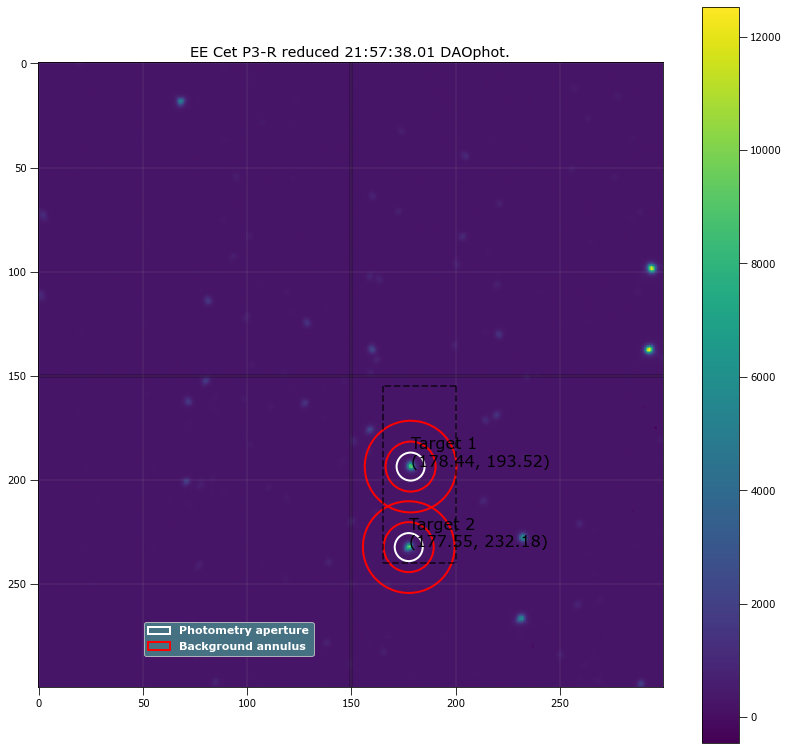

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.44121 193.51865 ...          2383.5416      294393.22          905.88147
  2  177.5454 232.17613 ...          2321.1175      295359.13          907.70513

 Aperture are: 141.99814287704146 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.44121 193.51865 ...                 2263.1142             108623.22
  2  177.5454 232.17613 ...                 2200.4477             105495.48

Write this out the excel
90 21:57:38.01 P3-R 20.0 6.7230508474576265 178.44121210956556 193.51864799209574 108623.21550054578 2263.1141944158726

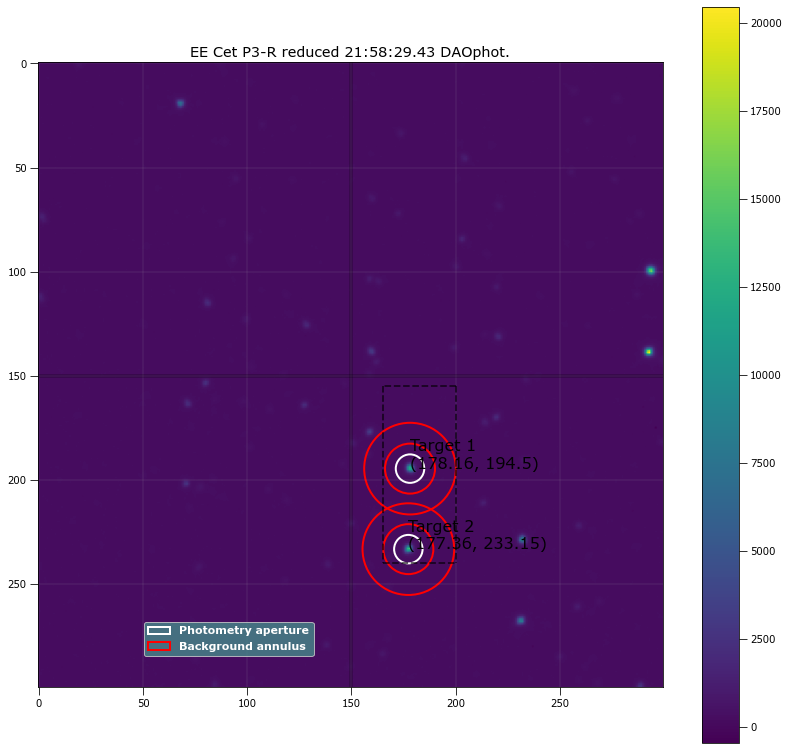

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.16407 194.49514 ...          3050.4839      270317.65          835.60384
  2 177.36436 233.14744 ...          3093.5087      269748.18          832.11637

 Aperture are: 146.78468869625308 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.16407 194.49514 ...                 2935.6547             136318.91
  2 177.36436 233.14744 ...                 2979.1587             133815.25

Write this out the excel
91 21:58:29.43 P3-R 20.0 6.835423728813559 178.16406840494938 194.49513639431413 136318.90979985447 2935.6546941422 177

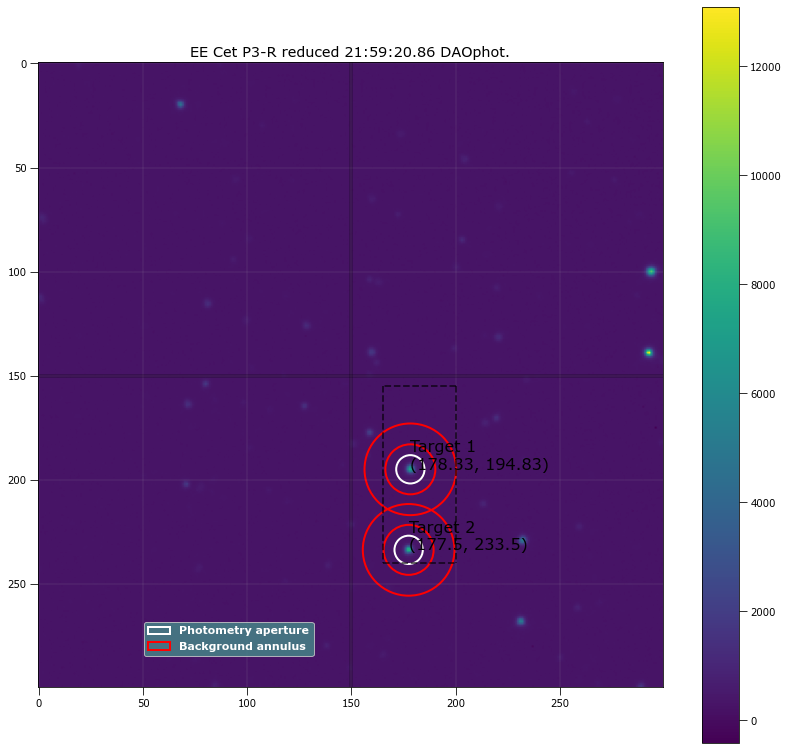

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.32553 194.83161 ...          1906.0186      317512.83           975.2416
  2 177.49811 233.49552 ...          1987.8925         318670           978.1438

 Aperture are: 145.18035765031303 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.32553 194.83161 ...                 1773.4651             86143.674
  2 177.49811 233.49552 ...                 1854.9445             83570.151

Write this out the excel
92 21:59:20.86 P3-R 20.0 6.797966101694915 178.325530287009 194.83160822068558 86143.67384379565 1773.4650593492136 177

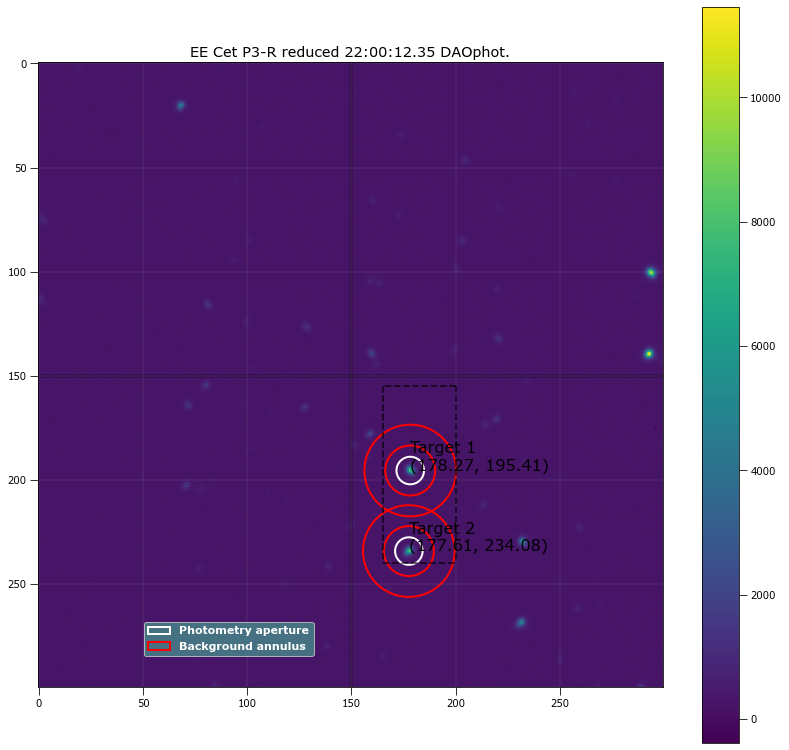

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.27167 195.41487 ...          1996.7605      302159.86          928.43783
  2 177.60877 234.07624 ...          1968.8167      302126.04          927.57081

 Aperture are: 137.29093901365556 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.27167 195.41487 ...                  1877.426             92028.771
  2 177.60877 234.07624 ...                 1849.5937             90078.514

Write this out the excel
93 22:00:12.35 P3-R 20.0 6.6106779661016954 178.2716736934505 195.41487188313855 92028.77107882025 1877.4259952769112 1

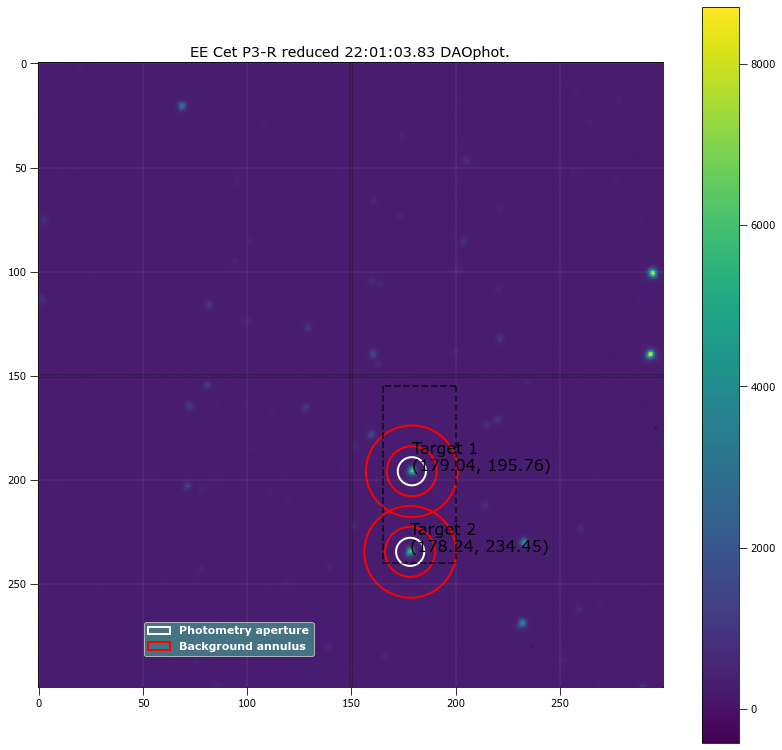

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 179.04165 195.75838 ...          1648.9005      322562.62          989.56393
  2 178.23588  234.4543 ...          1619.6736      322983.35          990.82033

 Aperture are: 143.5848423772425 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 179.04165 195.75838 ...                 1515.8784              69989.92
  2 178.23588  234.4543 ...                 1486.4826             68132.133

Write this out the excel
94 22:01:03.83 P3-R 20.0 6.760508474576271 179.04164838826676 195.7583760769649 69989.9200807868 1515.878443574004 178.2

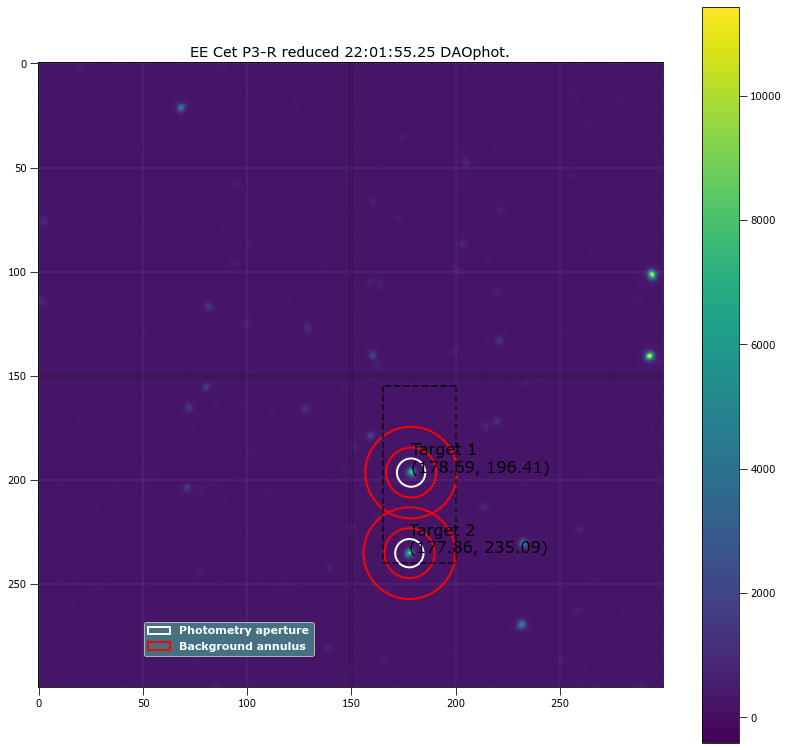

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.68905 196.40727 ...          2112.4994      294151.94          904.05502
  2  177.8573 235.09001 ...          2112.4219      292610.92          898.65726

 Aperture are: 145.18035765031303 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.68905 196.40727 ...                 1989.6214             95134.843
  2  177.8573 235.09001 ...                 1990.2776             93835.153

Write this out the excel
95 22:01:55.25 P3-R 20.0 6.797966101694915 178.68905365226064 196.40726859732112 95134.8431118976 1989.6214418599652 17

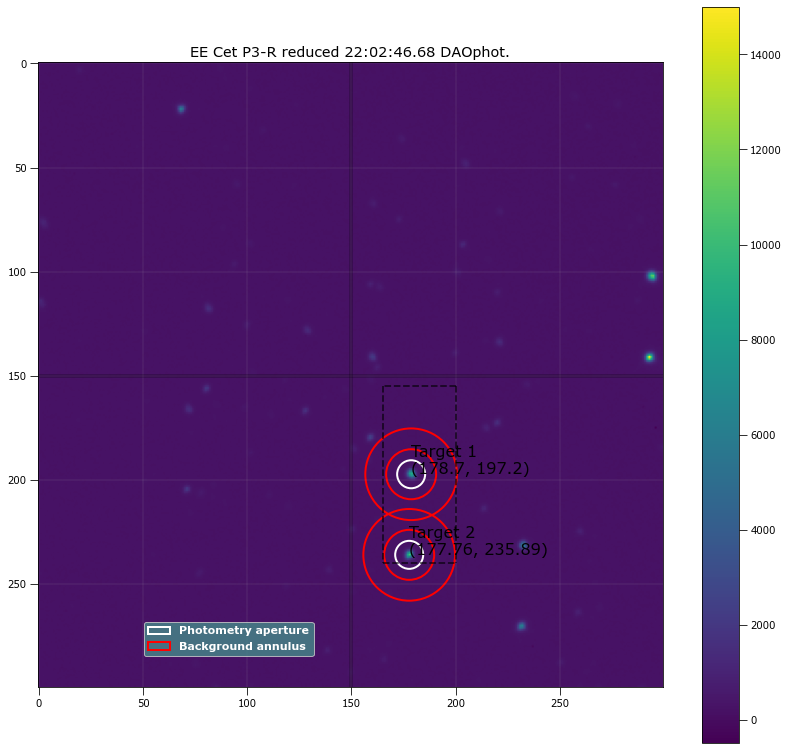

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.70283 197.20335 ...          2283.0837       280190.9          862.27242
  2 177.76357  235.8869 ...          2356.6853      281152.25          864.54643

 Aperture are: 141.99814287704146 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.70283 197.20335 ...                 2168.4537             106572.73
  2 177.76357  235.8869 ...                 2241.7529             104250.95

Write this out the excel
96 22:02:46.68 P3-R 20.0 6.7230508474576265 178.70282971063423 197.20335109698314 106572.73449271008 2168.4537171572333

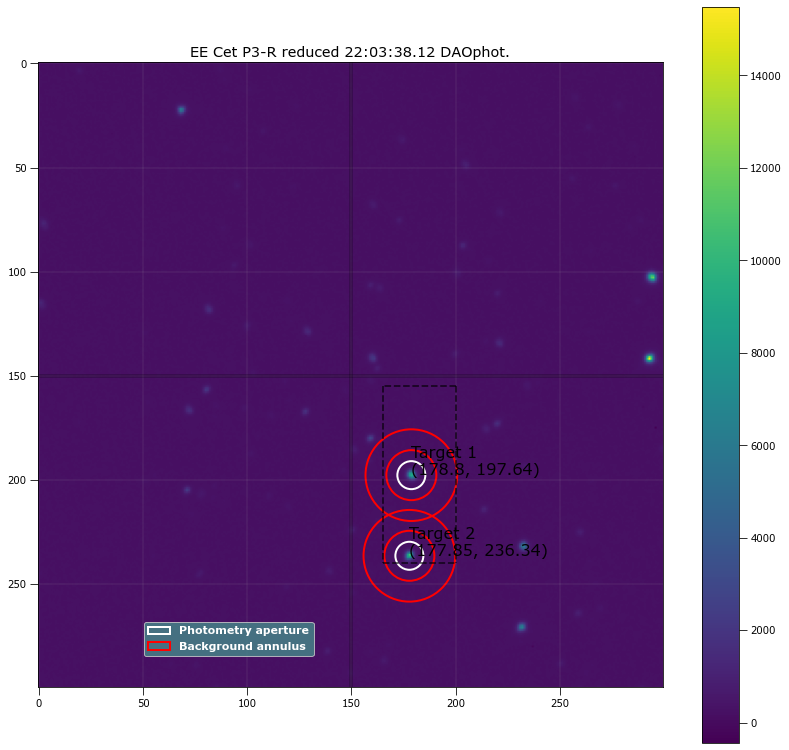

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.80115 197.63592 ...           2425.539      269171.78          829.33069
  2 177.85451 236.33738 ...          2507.2015      269343.05          828.44345

 Aperture are: 141.99814287704146 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.80115 197.63592 ...                 2315.2882             116627.78
  2 177.85451 236.33738 ...                 2397.0687             113837.53

Write this out the excel
97 22:03:38.12 P3-R 20.0 6.7230508474576265 178.80114717254702 197.63591545989289 116627.7770748346 2315.2882365406044 

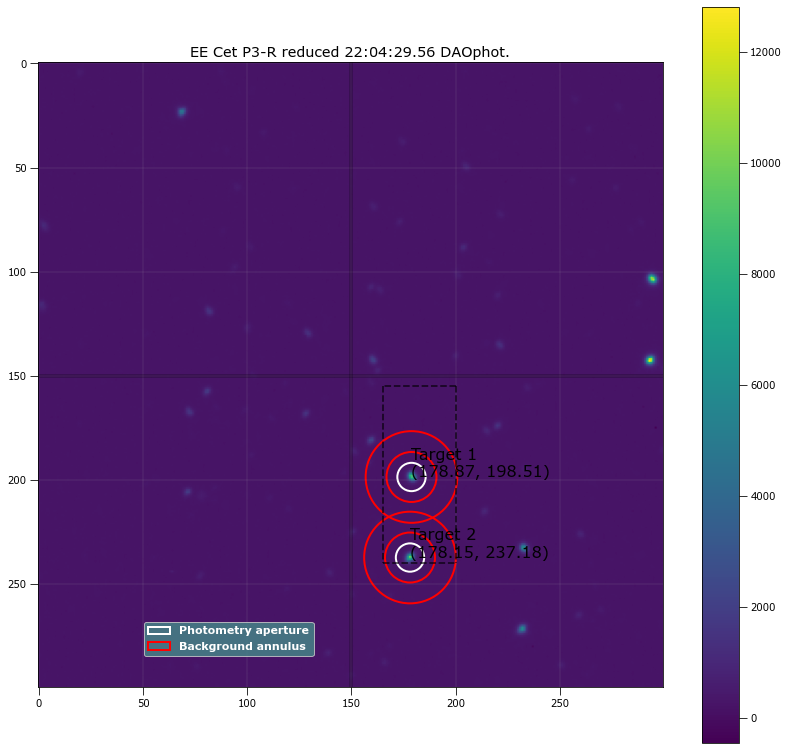

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.87221 198.51161 ...          2348.5785      275530.76          848.41755
  2 178.15386 237.17675 ...          2320.1436      275354.23          846.57868

 Aperture are: 145.18035765031303 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.87221 198.51161 ...                 2233.2627             109757.61
  2 178.15386 237.17675 ...                 2205.0778             107660.54

Write this out the excel
98 22:04:29.56 P3-R 20.0 6.797966101694915 178.87220635413647 198.51160531451345 109757.6103915027 2233.2627394247775 1

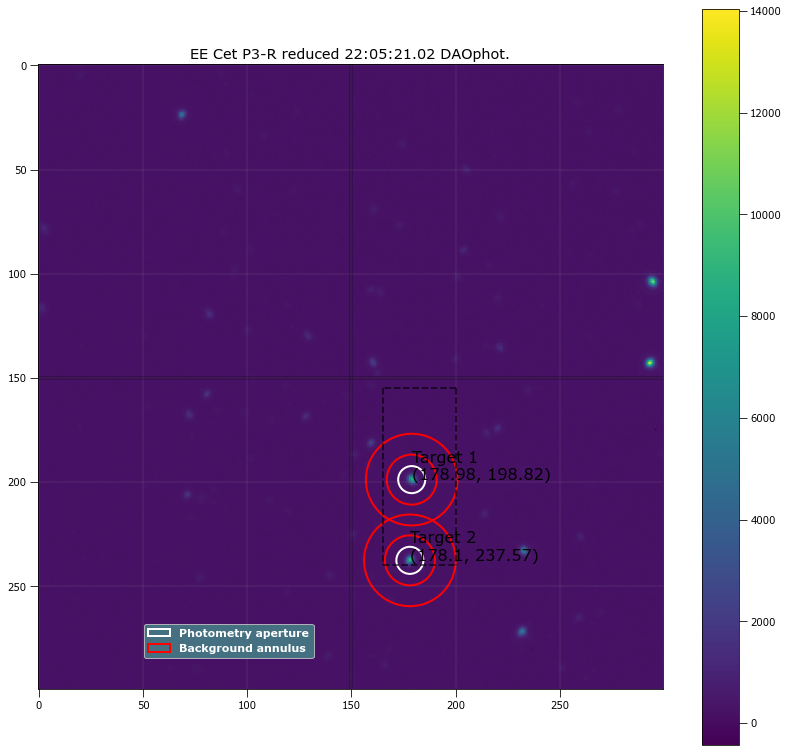

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 178.97865 198.81748 ...          2226.2246       283567.7          871.95725
  2 178.10127 237.56847 ...          2261.5324      283576.81          871.49083

 Aperture are: 132.66307710609527 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 178.97865 198.81748 ...                 2117.9275             103097.15
  2 178.10127 237.56847 ...                 2153.2933             101334.88

Write this out the excel
99 22:05:21.02 P3-R 20.0 6.498305084745763 178.97864567313277 198.8174792948648 103097.14742187038 2117.9275467631687 1

In [29]:
#The pipe!
#we expect 4 targets
#37 doesnt work
#Here is a work around. Incorporate the peak finder into the pipeline and tell the process such that if DAO cannot find the 
#targets, use the peak find coordinates. I suspect the problem is the FWHM.

print("P3-R Filter")

res_apt_sum_list = []

start = 50
end = 100 #So this things sets a new filename for a new file...
filename = astropy.io.fits.open(target[start])[0].header['OBJECT']+"_"+astropy.io.fits.open(target[start])[0].header['FILTER']

workbook = xlsxwriter.Workbook('./stats/'+MJD+"_"+ filename+str(start)+"-" +str(end)  +'.xlsx')
worksheet = workbook.add_worksheet()
worksheet.write('A1', 'int')
worksheet.write('B1', 'time obs')
worksheet.write('C1', 'filter')
worksheet.write('D1', 'exptime')
worksheet.write('E1', 'aperture radius')
worksheet.write('F1', 'target 1 x center')
worksheet.write('G1', 'target 1 y center')
worksheet.write('H1', 'target 1 counts')
worksheet.write('I1', 'target 1 error')
worksheet.write('J1', 'target 2 x center')
worksheet.write('K1', 'target 2 y center')
worksheet.write('L1', 'target 2 counts')
worksheet.write('M1', 'target 2 error')
worksheet.write('N1', 'q')
worksheet.write('O1', 'q error')
worksheet.write('P1', 'u')
worksheet.write('Q1', 'u error')
worksheet.write('R1', 'PD')
worksheet.write('S1', 'PD error')
worksheet.write('T1', 'PA')
worksheet.write('U1', 'PA error')

row = 1
column = 0
search_off = 150
siegma_search = 3
search_bracket = [-5, 90, -15, 50]
#Fit variations
#3 to 7
#4.5 to 8
#5 to 8.5

for k in range(start, end ):
    reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[k]),
                                        [512, 512, 512, 512], 
                                        (m_biast, m_dark, p_3_m_flat), 
                                        False, True, False)

    trial_radii = np.linspace(5, 9.42, num=60)
    target_a = []
    target_b = []
    for radii in trial_radii:
        #Find the position
        DAO_positions = funcs_star_finder.dao_star_finder(reduced_obj, search_bracket, siegma_search, 
                                                          2000, search_off, radii, 12 , 22, False, False)
        
        if (len(DAO_positions) != 2):
            x_targ, y_targ, peak_targ  = funcs_star_finder.source_peak_finder(reduced_obj, 4,search_bracket, 3200 , False, False) #what do I return from this?
            apt_pos = funcs_star_finder.plot_spotted(reduced_obj, search_off, search_bracket , x_targ, y_targ, peak_targ, False, False)
            DAO_positions = funcs_star_finder.peak_to_DAO(apt_pos)        
        
        #Insert Trial
        phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, search_off, search_bracket, DAO_positions, radii, 12 , 22, False, False)
        target_a.append(phot_tab['residual_aperture_sum'][0])
        target_b.append(phot_tab['residual_aperture_sum'][1])

    combine_target = [target_a, target_b]
    
    good_radii=funcs_apt_phot.solve_apt(combine_target, trial_radii, False)

    phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, search_off, search_bracket, DAO_positions,good_radii, 12 , 22, True, False)

    res_apt_sum_list.append(phot_tab['residual_aperture_sum'])
    
    print("\nWrite this out the excel")
    print(k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'], #Thats a bug bro
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1],"\n")
    
    write_this = [k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'],
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1]] #It writes by wrow
    
    for item in write_this :
        worksheet.write(row, column, item)
        column += 1
        
    column = 0
    row += 1
    
workbook.close()

target_1 = []
target_2 = []

for things in res_apt_sum_list:
    target_1.append(things[0])
    target_2.append(things[1])

P3-R Filter


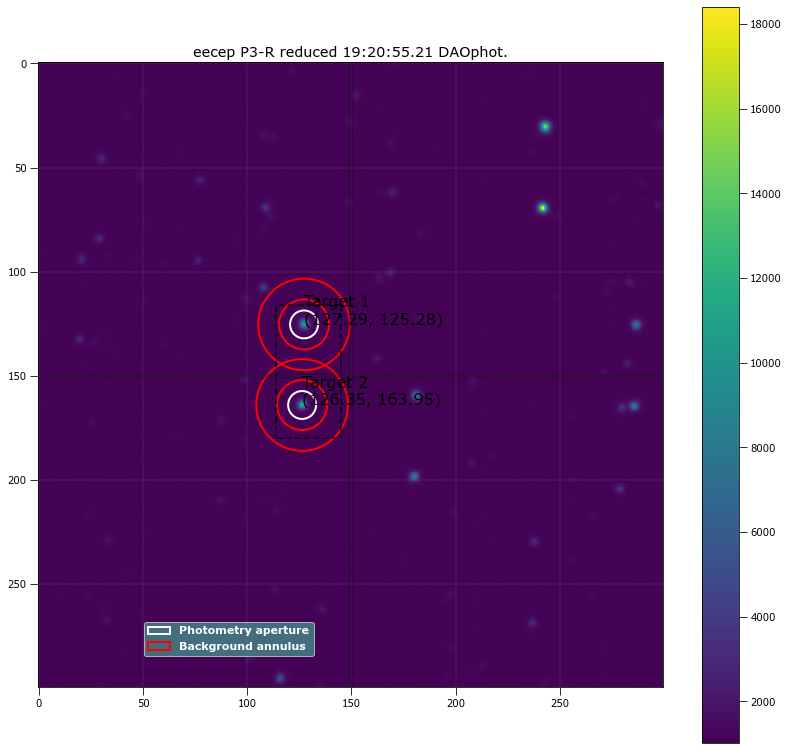

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.28859 125.27968 ...          3571.4097      1230057.5          3766.4605
  2 126.35451 163.95194 ...           3631.448      1228906.5          3762.9034

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.28859 125.27968 ...                 3074.7549             153600.94
  2 126.35451 163.95194 ...                 3135.2623             148942.75

Write this out the excel
398 19:20:55.21 P3-R 20.0 6.695762711864406 127.28859469295783 125.27968065487946 153600.94374856655 3074.754920131827 1

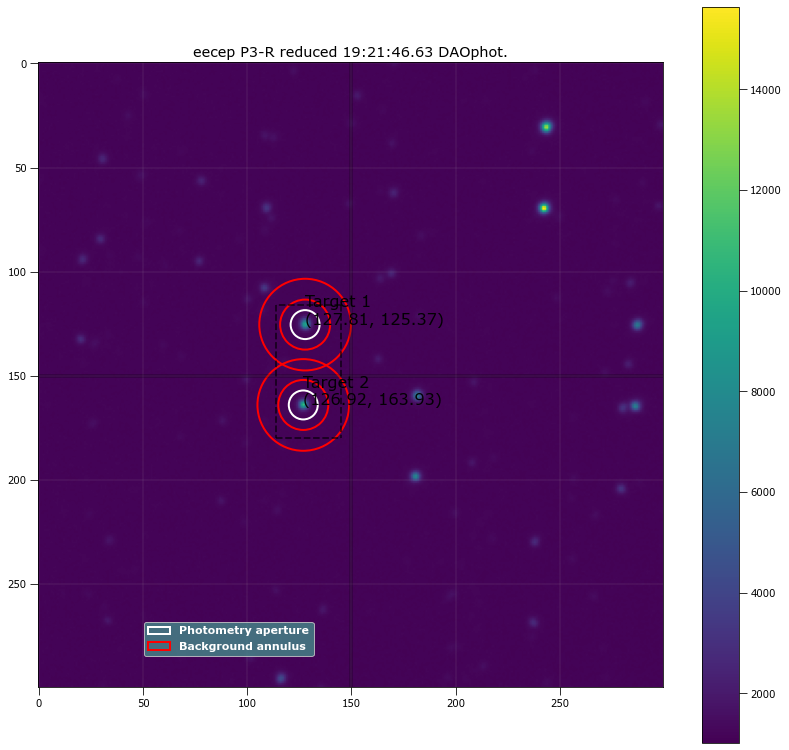

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.8052 125.36838 ...          3404.3278      1232173.8          3772.8236
  2 126.92348 163.93446 ...           3429.751      1230893.2          3768.6813

 Aperture are: 151.91335587324707 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.8052 125.36838 ...                 2867.7489             151519.02
  2 126.92348 163.93446 ...                 2893.7611             146465.45

Write this out the excel
399 19:21:46.63 P3-R 20.0 6.953813559322033 127.80519527704065 125.36837872957108 151519.023403306 2867.7488541692946 1

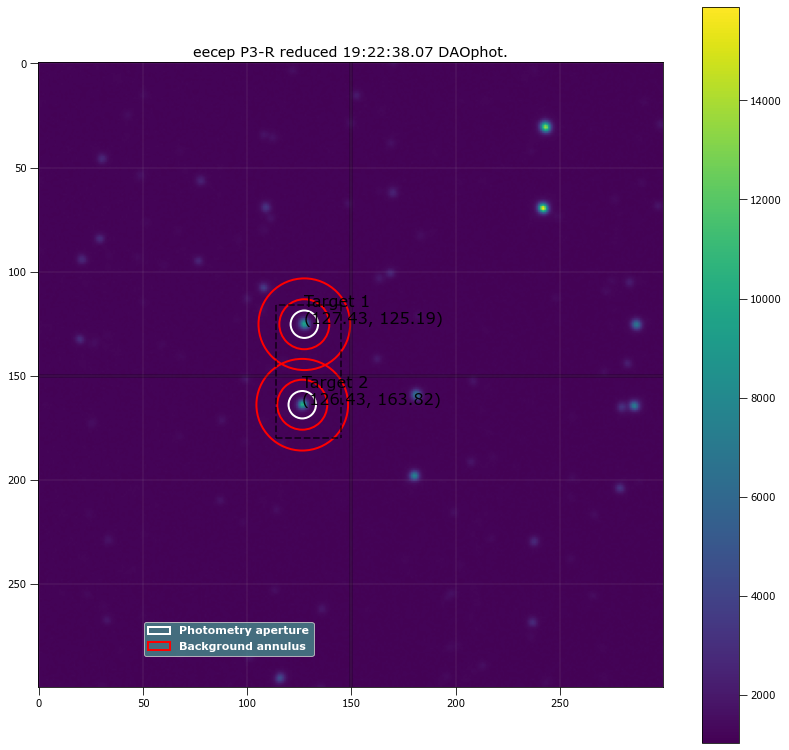

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.43388 125.18524 ...          3389.4012        1237089          3787.8793
  2 126.43178 163.82191 ...          3398.7932      1233972.6          3778.1802

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.43388 125.18524 ...                 2906.2856             150624.91
  2 126.43178 163.82191 ...                 2916.9145             145673.48

Write this out the excel
400 19:22:38.07 P3-R 20.0 6.5851694915254235 127.43387707438671 125.18524379302707 150624.90523989536 2906.285564332398

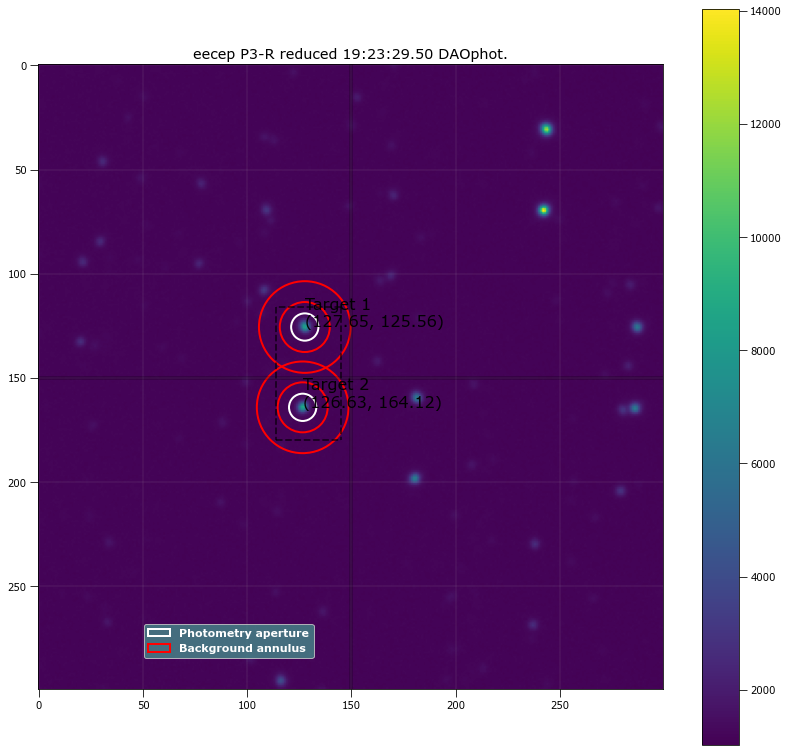

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.64873 125.56485 ...           3237.811      1235820.5          3783.7051
  2 126.63105 164.11532 ...          3227.7421      1236379.1          3785.3794

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.64873 125.56485 ...                 2760.6157             148203.24
  2 126.63105 164.11532 ...                 2750.3356             143222.18

Write this out the excel
401 19:23:29.50 P3-R 20.0 6.5483050847457624 127.64873077225256 125.5648524079215 148203.24246226982 2760.6156961397555

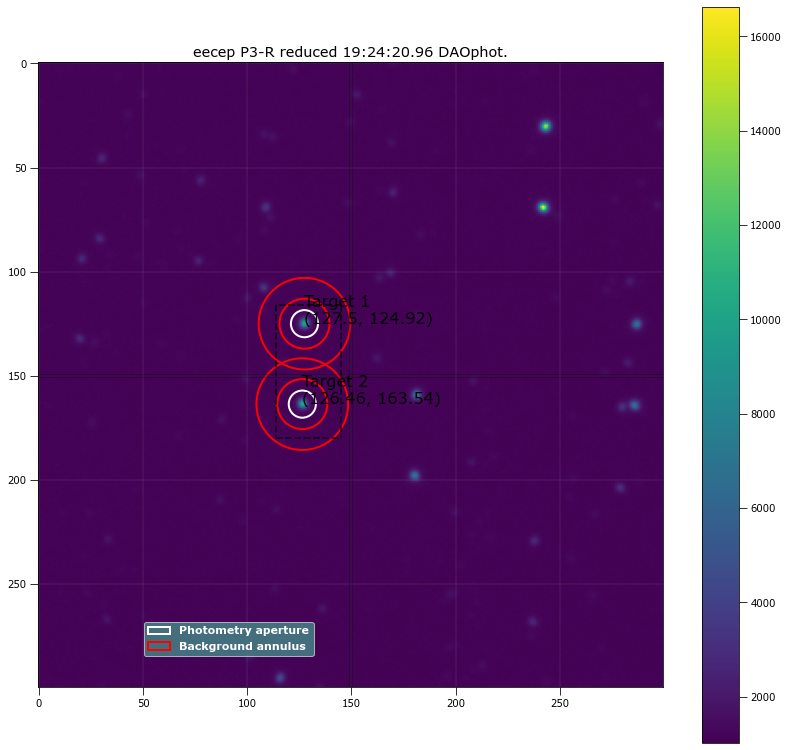

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.50007 124.92492 ...          3460.0935      1233389.5          3776.3006
  2 126.45905 163.54256 ...          3428.5688      1235088.9          3781.6396

 Aperture are: 133.19994616249755 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.50007 124.92492 ...                 2989.1793             151124.39
  2 126.45905 163.54256 ...                 2956.9888             146597.97

Write this out the excel
402 19:24:20.96 P3-R 20.0 6.511440677966101 127.50007131227748 124.92491668474524 151124.3919920051 2989.179305824818 1

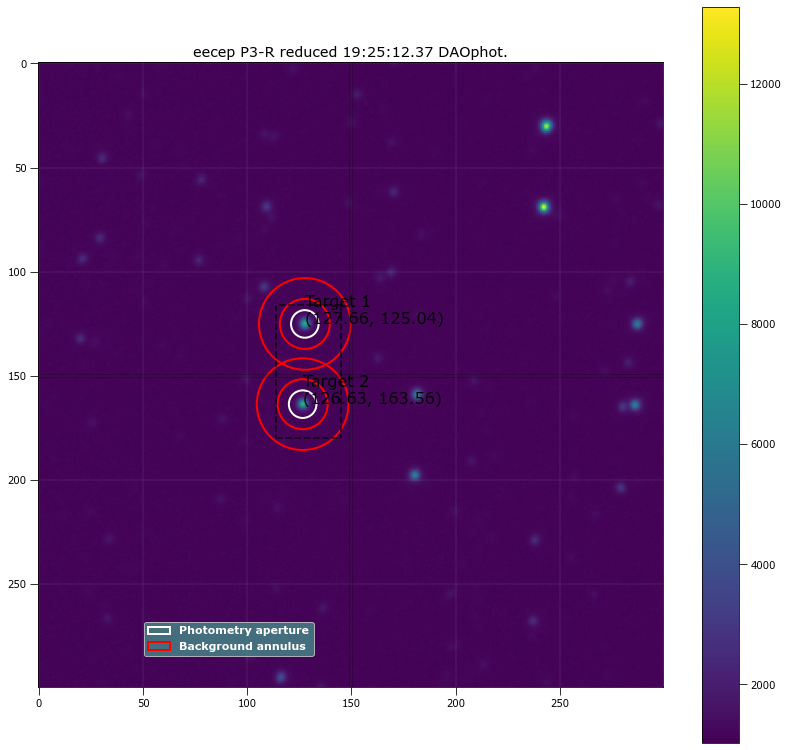

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.66288 125.04234 ...          3226.2774      1233717.7          3777.0683
  2 126.62989 163.56296 ...          3197.8427      1234262.7          3778.7956

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.66288 125.04234 ...                 2739.1319             146284.36
  2 126.62989 163.56296 ...                 2710.4744             141461.39

Write this out the excel
403 19:25:12.37 P3-R 20.0 6.622033898305084 127.66288238042739 125.0423357915128 146284.36482253188 2739.1319006566314 

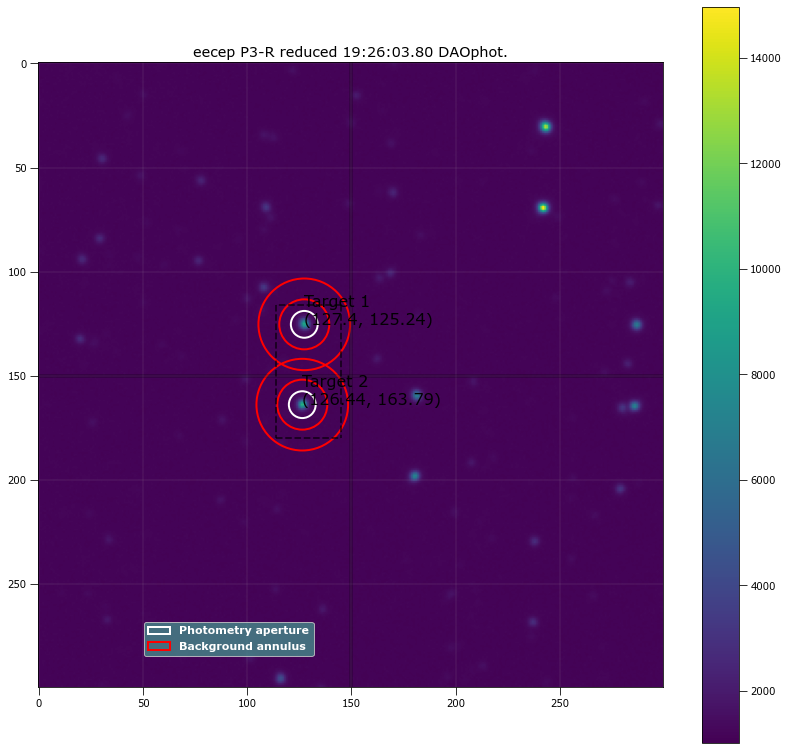

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.40136 125.23898 ...          3320.6462      1233440.6          3776.5857
  2 126.44407 163.79463 ...          3318.9961      1232893.1          3774.7533

 Aperture are: 130.20058706311798 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.40136 125.23898 ...                 2860.3011             147866.18
  2 126.44407 163.79463 ...                 2858.8744             142841.48

Write this out the excel
404 19:26:03.80 P3-R 20.0 6.437711864406779 127.40135506163571 125.23897765594434 147866.17808264773 2860.3010863729996

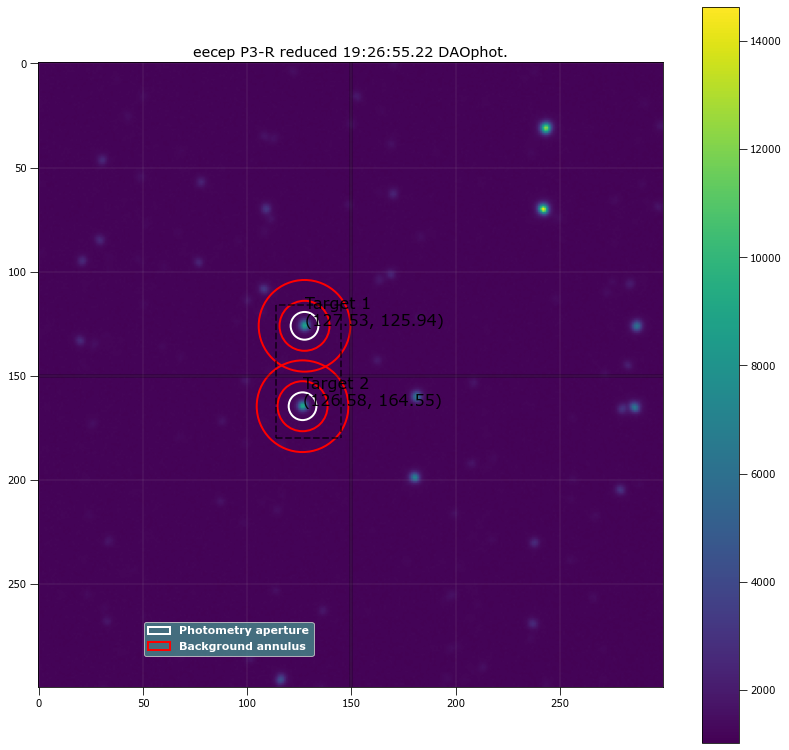

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.52647 125.94372 ...           3253.091      1234402.8          3779.2844
  2 126.57662 164.54546 ...          3234.0724      1234601.8          3779.8057

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.52647 125.94372 ...                 2760.2175             145861.68
  2 126.57662 164.54546 ...                 2741.1309              141248.3

Write this out the excel
405 19:26:55.22 P3-R 20.0 6.658898305084746 127.5264682600705 125.94372334492468 145861.68275150305 2760.2175484347135 

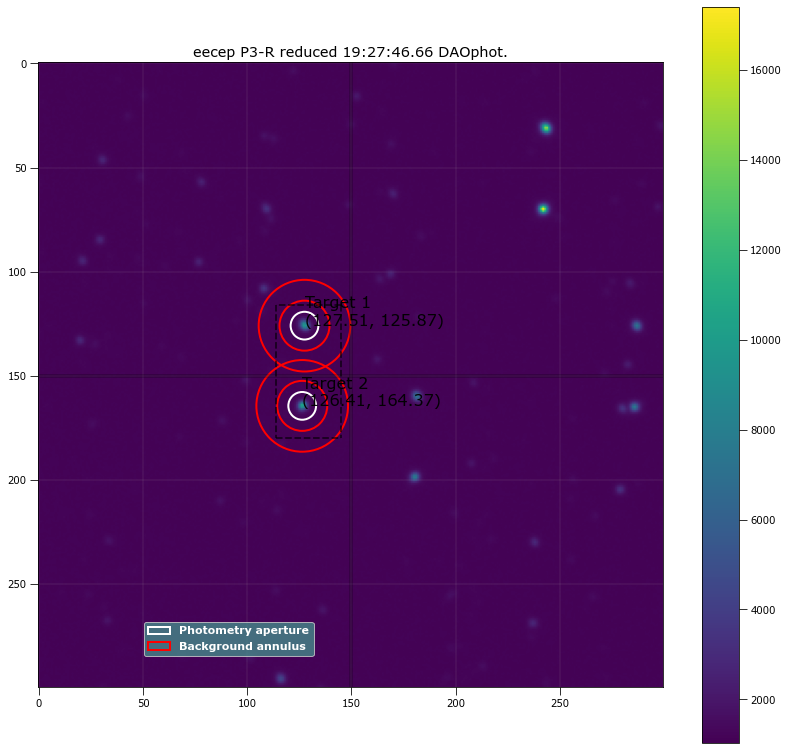

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.51334 125.87129 ...          3378.2437      1233672.9          3777.2059
  2 126.40805  164.3744 ...          3402.2256      1236365.9          3785.3903

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.51334 125.87129 ...                 2885.6413              148357.8
  2 126.40805  164.3744 ...                 2908.5558             143384.42

Write this out the excel
406 19:27:46.66 P3-R 20.0 6.658898305084746 127.51333804857921 125.87129163494384 148357.79714183894 2885.6413499589235

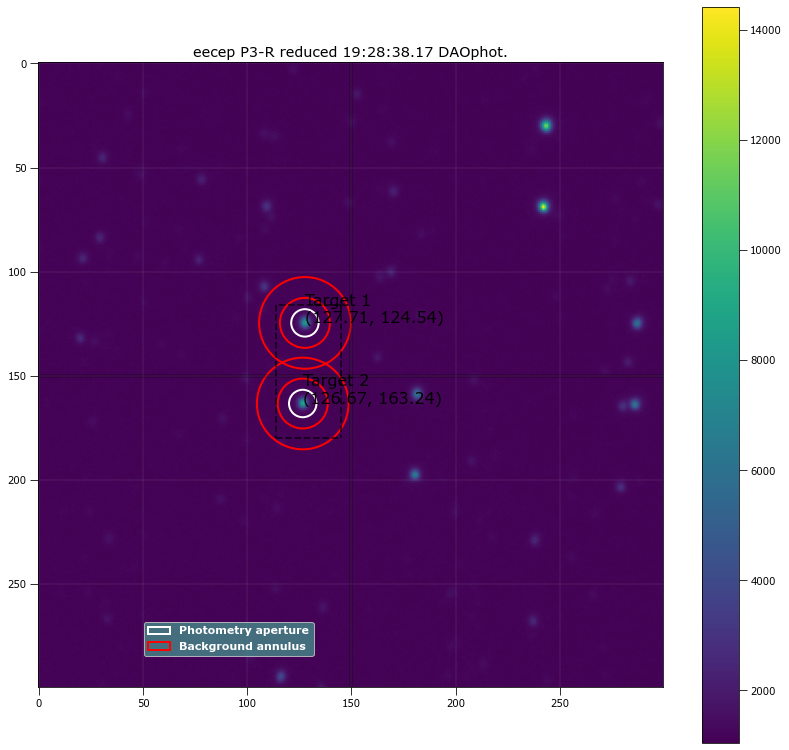

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.71364 124.54244 ...           3180.991      1240556.4           3797.897
  2 126.66751 163.24021 ...          3207.3439      1241858.3          3801.9744

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.71364 124.54244 ...                 2696.5976             144525.87
  2 126.66751 163.24021 ...                 2722.4305             140814.94

Write this out the excel
407 19:28:38.17 P3-R 20.0 6.5851694915254235 127.71364481116893 124.54244333202982 144525.86705008408 2696.597625167823

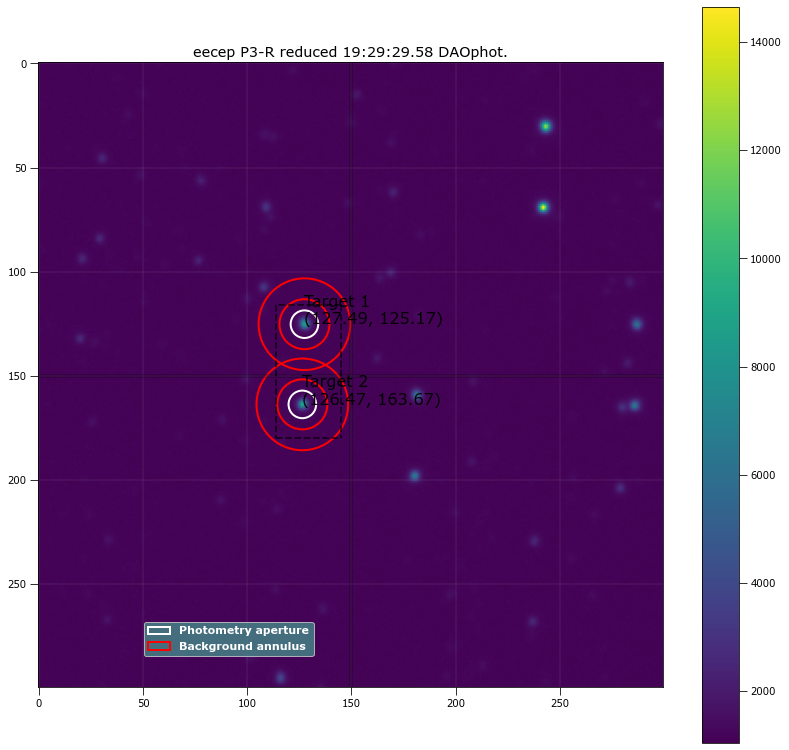

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.48869 125.17035 ...          3232.1152      1239832.2          3795.8435
  2 126.47308   163.668 ...          3240.0237      1242903.6          3805.1835

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.48869 125.17035 ...                 2742.5482             147021.83
  2 126.47308   163.668 ...                  2749.252             142220.27

Write this out the excel
408 19:29:29.58 P3-R 20.0 6.622033898305085 127.48868732336256 125.17035332208158 147021.83265072104 2742.5481892957155

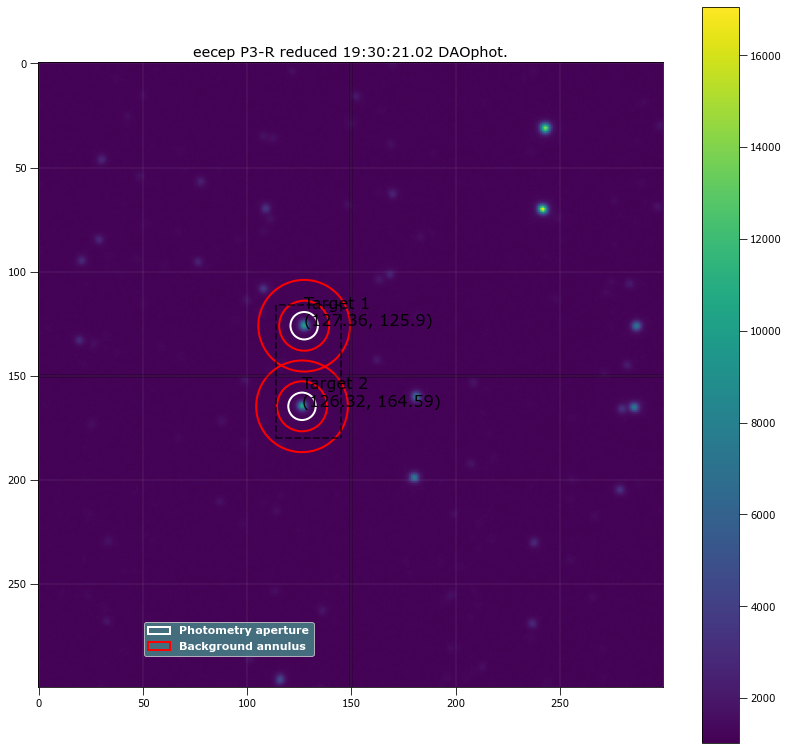

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.35774 125.90192 ...          3432.7041      1242601.9          3804.6456
  2 126.31624 164.58727 ...          3445.2531      1245528.6          3813.4099

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.35774 125.90192 ...                   2947.45             149488.38
  2 126.31624 164.58727 ...                 2958.8812             144172.99

Write this out the excel
409 19:30:21.02 P3-R 20.0 6.5851694915254235 127.35773512210449 125.90192242961179 149488.37566390648 2947.450004664455

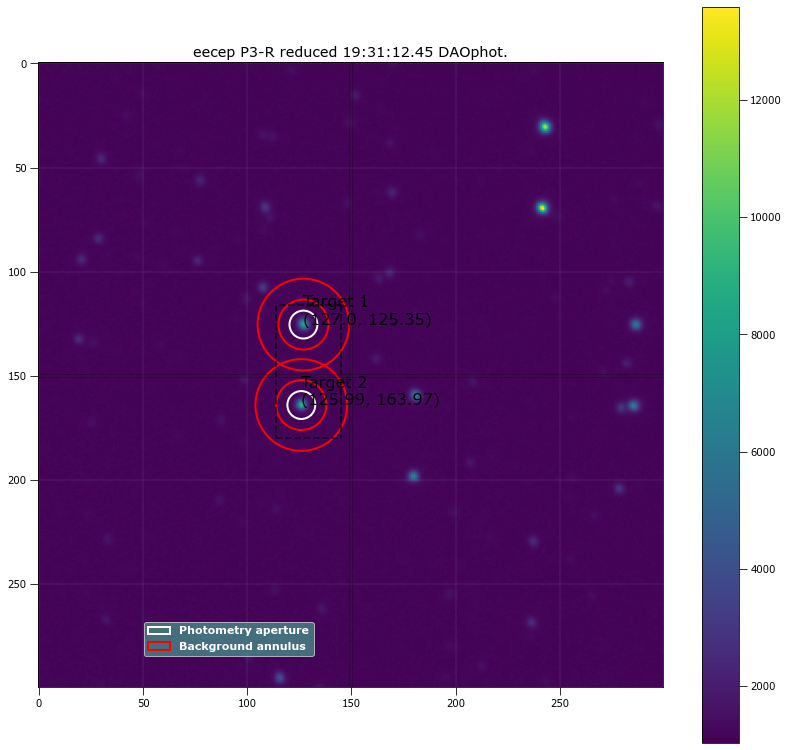

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.00496 125.35151 ...          3265.9602        1247267            3818.62
  2 125.98503 163.96998 ...          3295.1666      1249151.3          3824.3289

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.00496 125.35151 ...                 2762.4276             148664.65
  2 125.98503 163.96998 ...                 2790.8812             143688.45

Write this out the excel
410 19:31:12.45 P3-R 20.0 6.695762711864407 127.0049592374087 125.35151299708656 148664.6501082345 2762.4275879930606 1

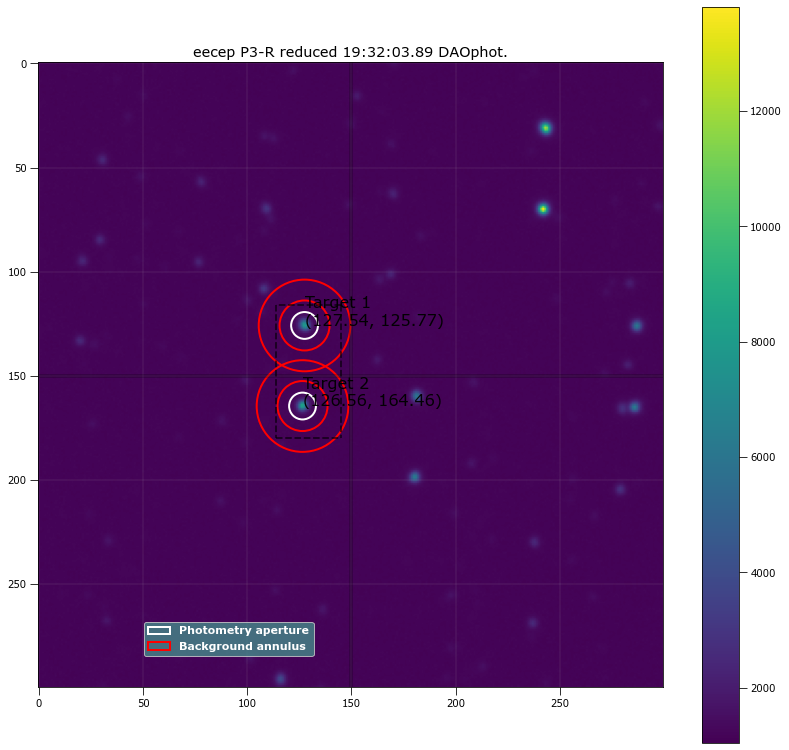

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.53651 125.77456 ...          3152.0832      1246192.2          3815.3125
  2 126.56367 164.45611 ...          3154.8298      1245641.3          3813.5603

 Aperture are: 130.20058706311798 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.53651 125.77456 ...                 2687.0176             145456.93
  2 126.56367 164.45611 ...                 2689.9778             140569.89

Write this out the excel
411 19:32:03.89 P3-R 20.0 6.437711864406779 127.53651221416017 125.77456097341377 145456.92572541063 2687.0175693868255

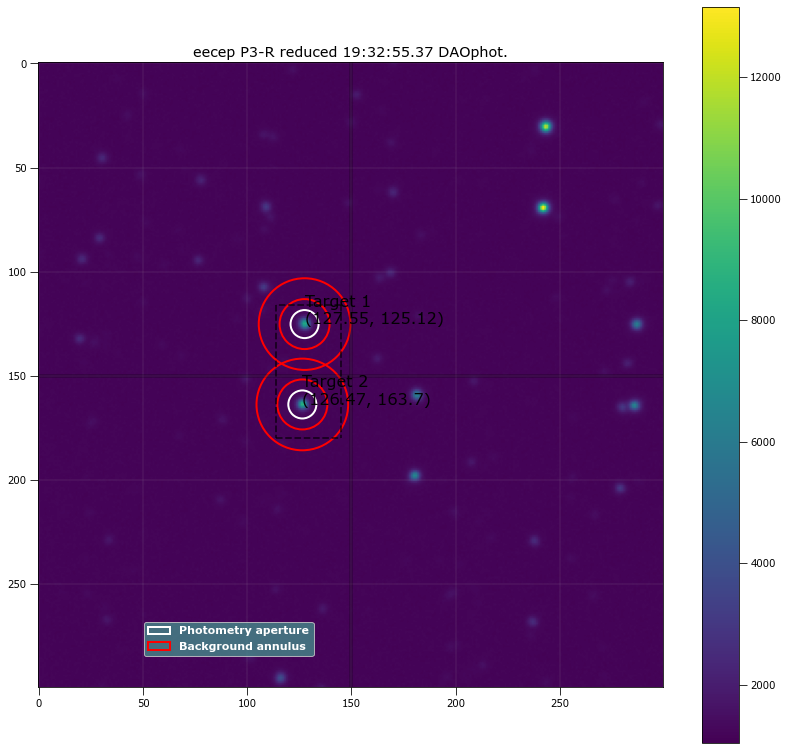

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.54971 125.11688 ...          3258.5418      1250579.1          3828.5387
  2 126.47452 163.70039 ...          3255.5607        1251777          3832.2074

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.54971 125.11688 ...                  2748.127             149231.52
  2 126.47452 163.70039 ...                 2744.6568             144739.09

Write this out the excel
412 19:32:55.37 P3-R 20.0 6.732627118644068 127.54971106964875 125.11688257172166 149231.51713977454 2748.1270284243087 

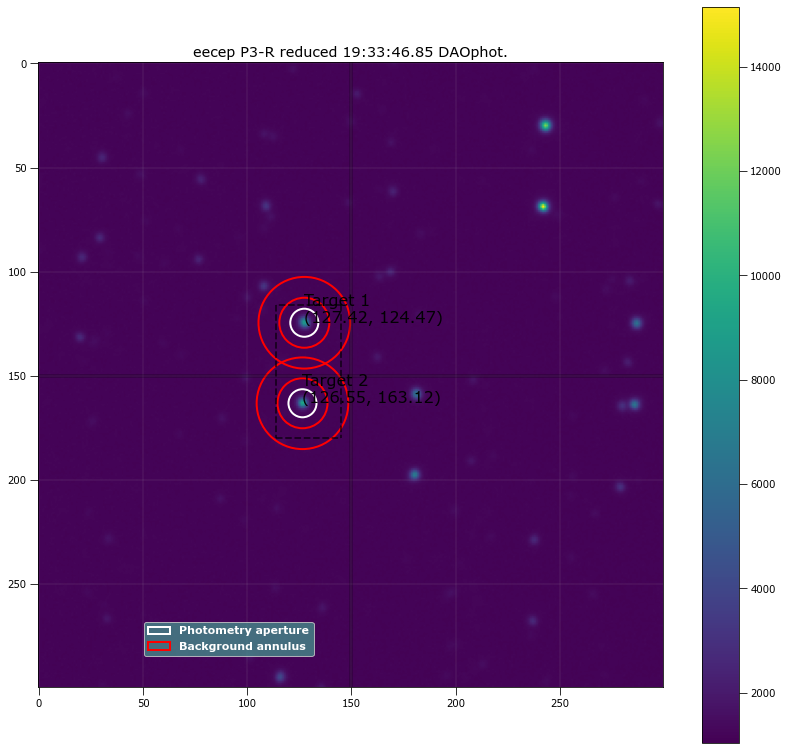

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.4244 124.47277 ...          3309.7035      1257081.7          3848.5941
  2 126.54651 163.12281 ...           3318.912      1255790.6          3844.7258

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.4244 124.47277 ...                 2796.6149             149813.96
  2 126.54651 163.12281 ...                 2806.3392             144770.69

Write this out the excel
413 19:33:46.85 P3-R 20.0 6.732627118644068 127.42440433970063 124.47276822453547 149813.95861061048 2796.6149446630902 

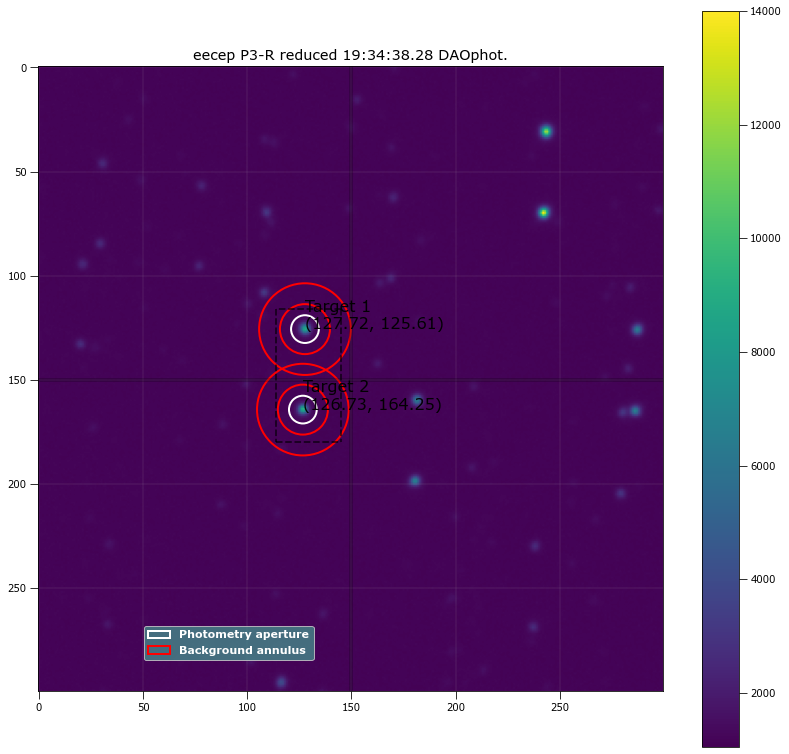

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.72391 125.60974 ...          3292.4718      1252922.7          3835.8654
  2 126.72554 164.24834 ...          3293.5105      1253310.6          3836.9945

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.72391 125.60974 ...                 2792.2194             148651.04
  2 126.72554 164.24834 ...                 2793.1109             144129.03

Write this out the excel
414 19:34:38.28 P3-R 20.0 6.658898305084746 127.7239125098352 125.6097406795291 148651.0411934106 2792.2193925928163 12

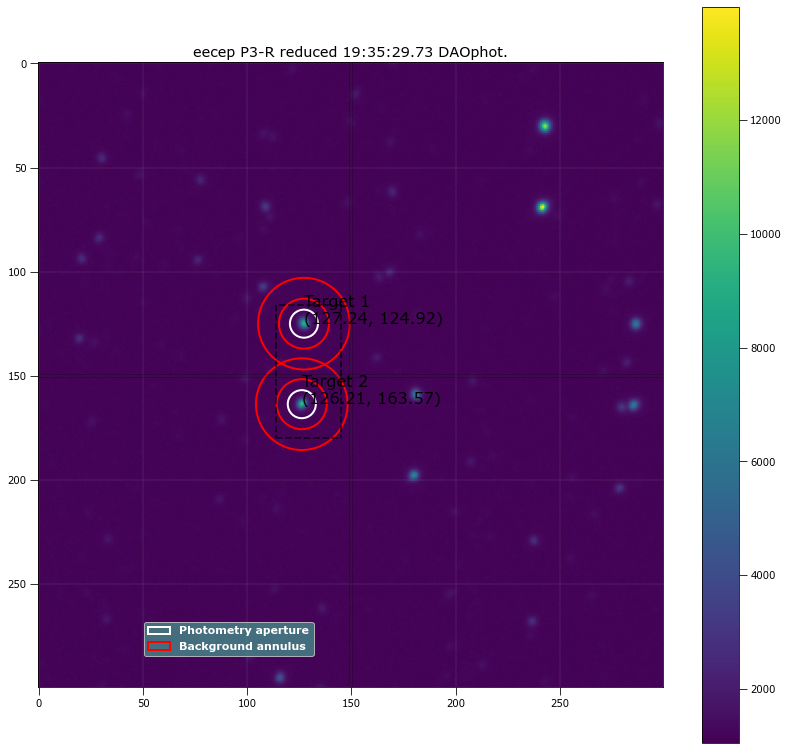

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.2405 124.91944 ...          3363.3916        1251775          3832.4254
  2 126.20813 163.56679 ...           3369.088      1254434.3          3840.5508

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.2405 124.91944 ...                 2852.4586             149828.74
  2 126.20813 163.56679 ...                 2857.0718             145309.95

Write this out the excel
415 19:35:29.73 P3-R 20.0 6.732627118644068 127.2404961959366 124.91943852285823 149828.73837223966 2852.4586098095233 1

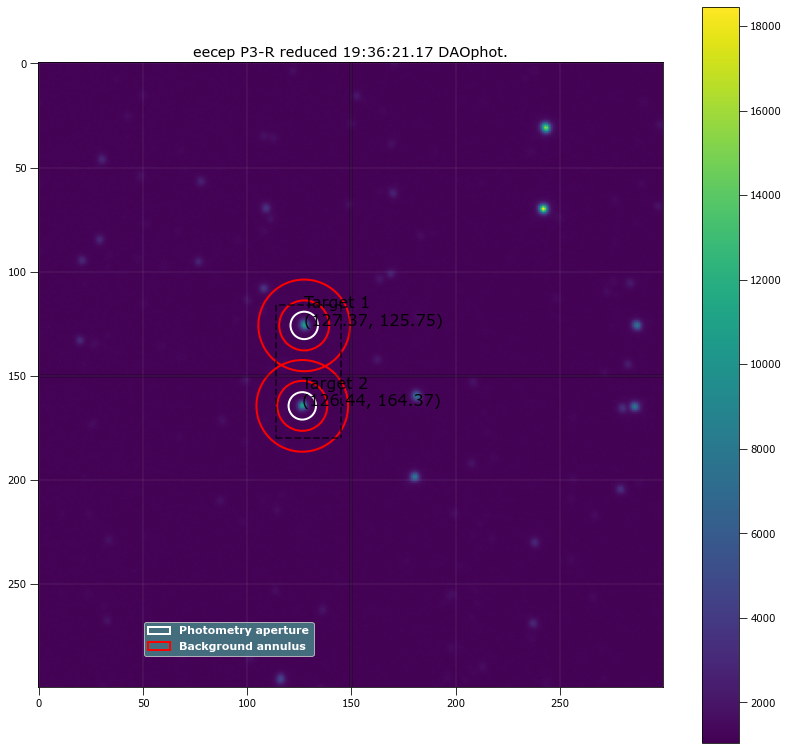

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.37389 125.75456 ...           3493.042      1255195.3          3843.3374
  2 126.44354 164.37105 ...          3511.9475      1256949.3          3848.4606

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.37389 125.75456 ...                  3002.853             147815.17
  2 126.44354 164.37105 ...                 3021.1051             143510.02

Write this out the excel
416 19:36:21.17 P3-R 20.0 6.5851694915254235 127.37388865995239 125.75456363822366 147815.16795367698 3002.85303630998 

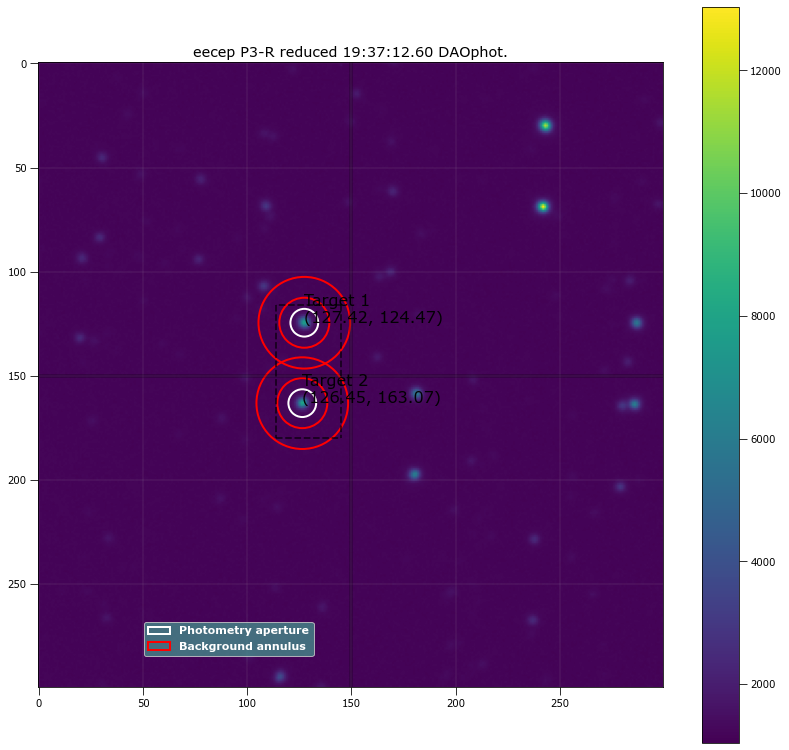

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.41903 124.46519 ...          3159.6571      1255450.5          3843.4816
  2 126.44556 163.07265 ...          3143.8012      1255458.9          3843.3384

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.41903 124.46519 ...                 2658.4114             146125.45
  2 126.44556 163.07265 ...                 2642.5741             141909.49

Write this out the excel
417 19:37:12.60 P3-R 20.0 6.658898305084746 127.41902656302125 124.46519128277211 146125.45173490516 2658.4114375435356

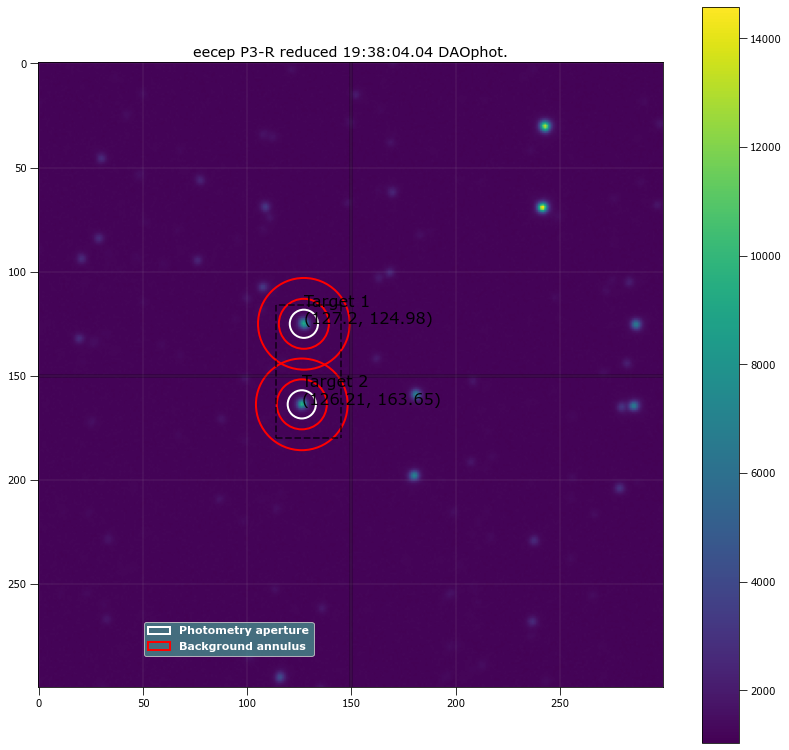

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.20481 124.97785 ...          3327.2903      1255572.8          3843.9698
  2 126.20763 163.65217 ...          3304.5997      1254962.5          3842.0985

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.20481 124.97785 ...                 2809.1909             148457.67
  2 126.20763 163.65217 ...                 2786.7524             143061.11

Write this out the excel
418 19:38:04.04 P3-R 20.0 6.769491525423728 127.20480705113657 124.9778522258469 148457.66559881184 2809.190870719818 1

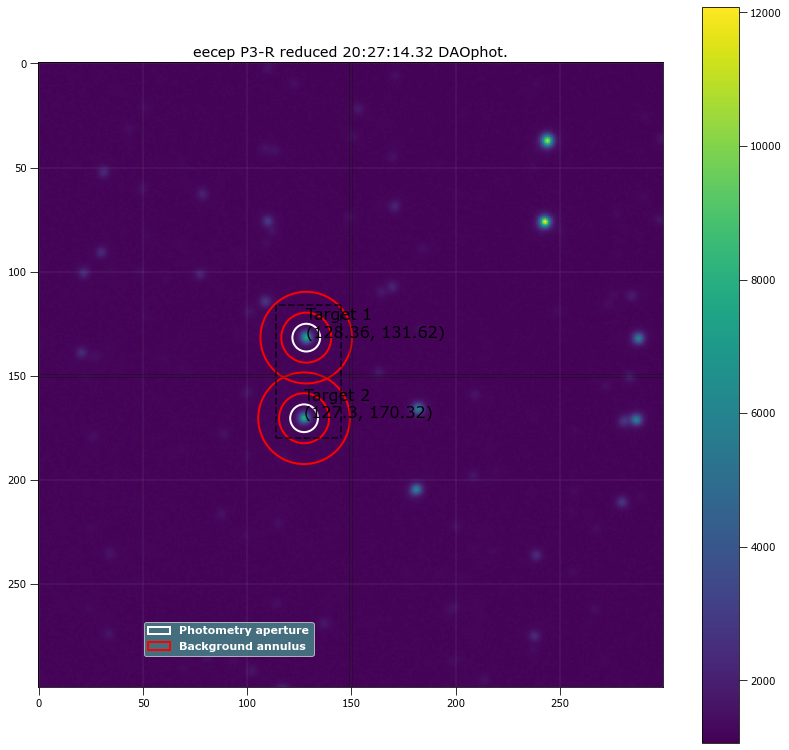

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  128.3589  131.6228 ...           3181.066      1271653.6          3893.0466
  2 127.30169 170.31797 ...          3183.7074      1273889.7          3899.8858

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  128.3589  131.6228 ...                 2673.3563             151987.09
  2 127.30169 170.31797 ...                 2675.1058             148307.79

Write this out the excel
419 20:27:14.32 P3-R 20.0 6.658898305084746 128.35890261724154 131.62279942500268 151987.08999491745 2673.3563033819 12

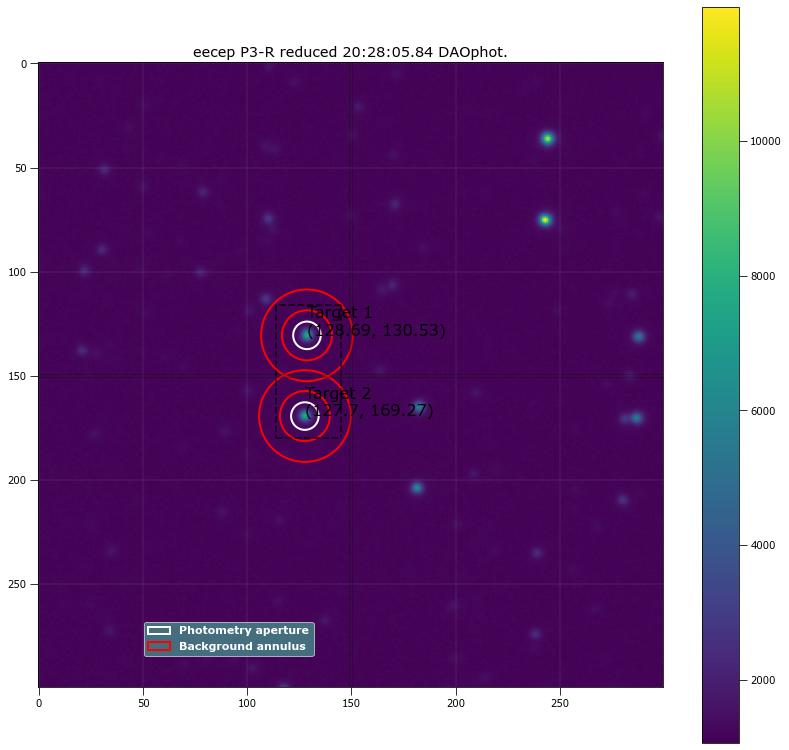

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.69426  130.5284 ...          3201.6919      1268075.8          3882.0776
  2 127.69721 169.27073 ...          3189.6976      1269522.5          3886.4992

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.69426  130.5284 ...                 2701.0028             151723.47
  2 127.69721 169.27073 ...                 2688.4383             148128.61

Write this out the excel
420 20:28:05.84 P3-R 20.0 6.622033898305085 128.69425616579497 130.52839522384411 151723.47386387974 2701.0027940132945

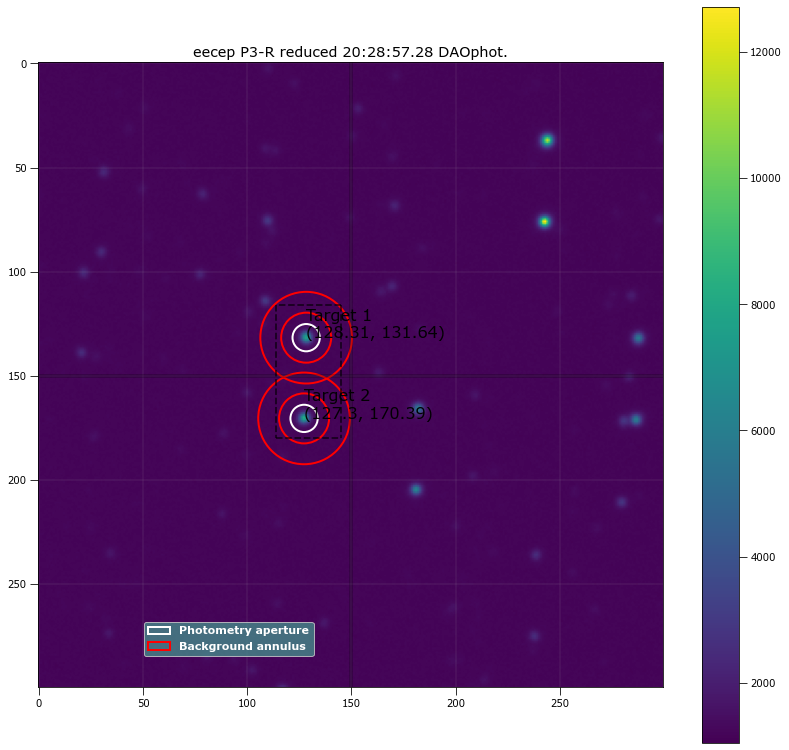

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  128.3103 131.63721 ...           3208.436      1269710.9          3887.1728
  2 127.30381 170.38989 ...          3215.6089      1271585.7           3892.753

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  128.3103 131.63721 ...                 2718.1915             151473.65
  2 127.30381 170.38989 ...                 2724.6606             148227.87

Write this out the excel
421 20:28:57.28 P3-R 20.0 6.5483050847457624 128.3102961510023 131.637209321361 151473.65063833317 2718.1915114150097 1

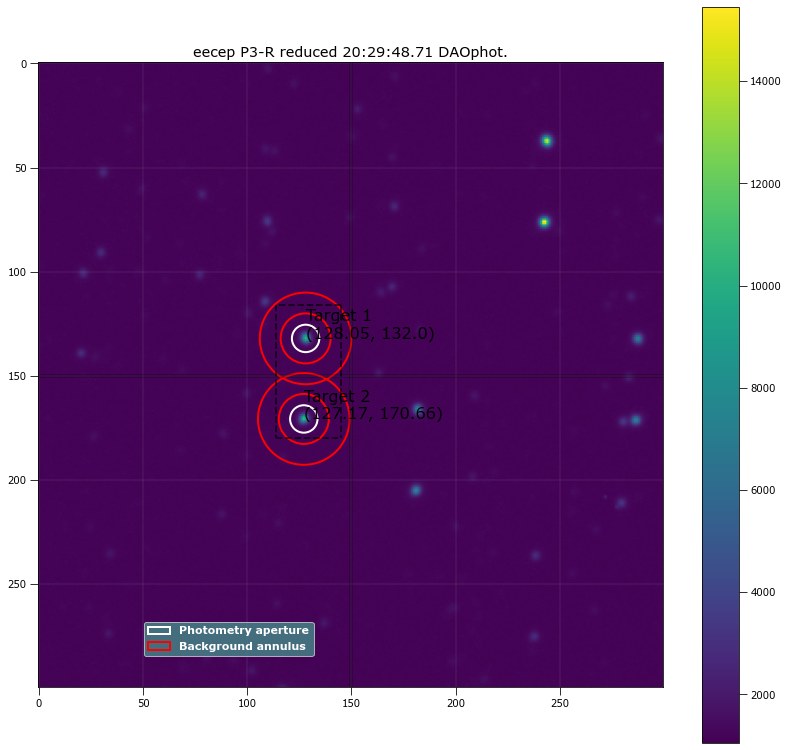

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.05144  131.9962 ...          3476.1305      1264996.7          3872.9951
  2 127.17338 170.65896 ...          3489.1854      1265378.6          3874.1841

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.05144  131.9962 ...                 2982.1589              153216.8
  2 127.17338 170.65896 ...                 2995.0622             149189.69

Write this out the excel
422 20:29:48.71 P3-R 20.0 6.5851694915254235 128.05144326760785 131.99619795639512 153216.79597836814 2982.158900635116

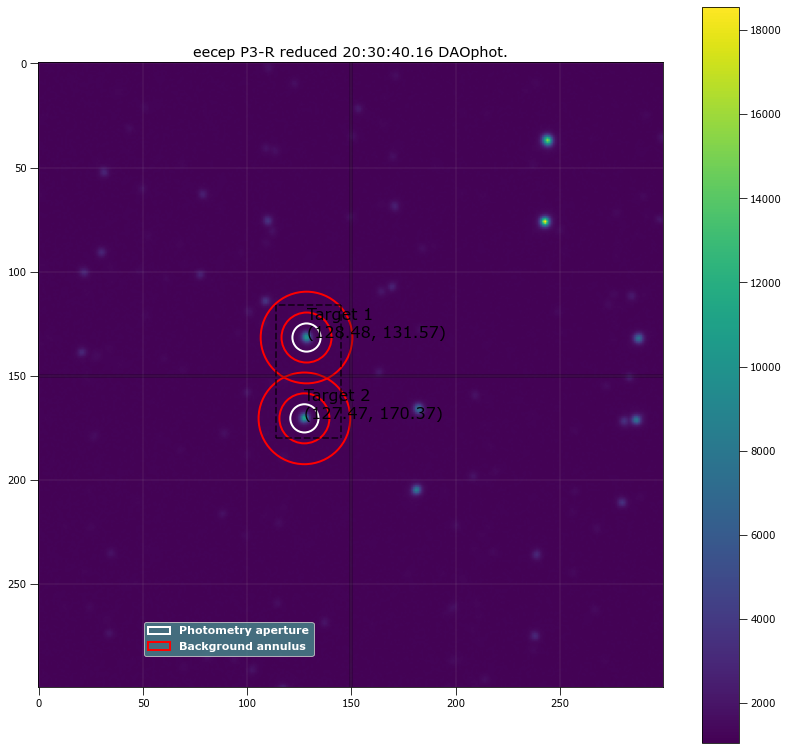

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  128.4785 131.56765 ...          3557.1509      1263569.2          3868.8549
  2 127.47066 170.37286 ...          3605.9362      1264697.3          3872.1704

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  128.4785 131.56765 ...                 3035.6974             156529.93
  2 127.47066 170.37286 ...                 3084.0358             152371.59

Write this out the excel
423 20:30:40.16 P3-R 20.0 6.769491525423728 128.47850353391425 131.5676507706219 156529.92541653378 3035.697358436479 1

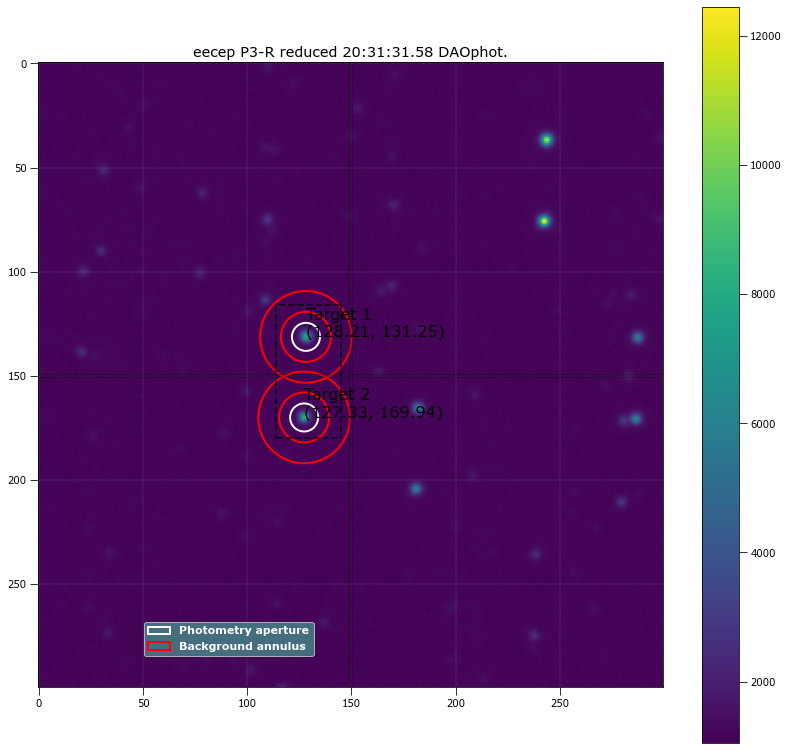

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.20909 131.25309 ...           3240.564        1263497          3868.0657
  2 127.33464  169.9421 ...          3235.2922      1262823.4          3865.9234

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.20909 131.25309 ...                 2724.8795             153955.21
  2 127.33464  169.9421 ...                 2719.8934             148731.77

Write this out the excel
424 20:31:31.58 P3-R 20.0 6.732627118644068 128.209087190645 131.25308688721844 153955.21004320038 2724.8794885734706 12

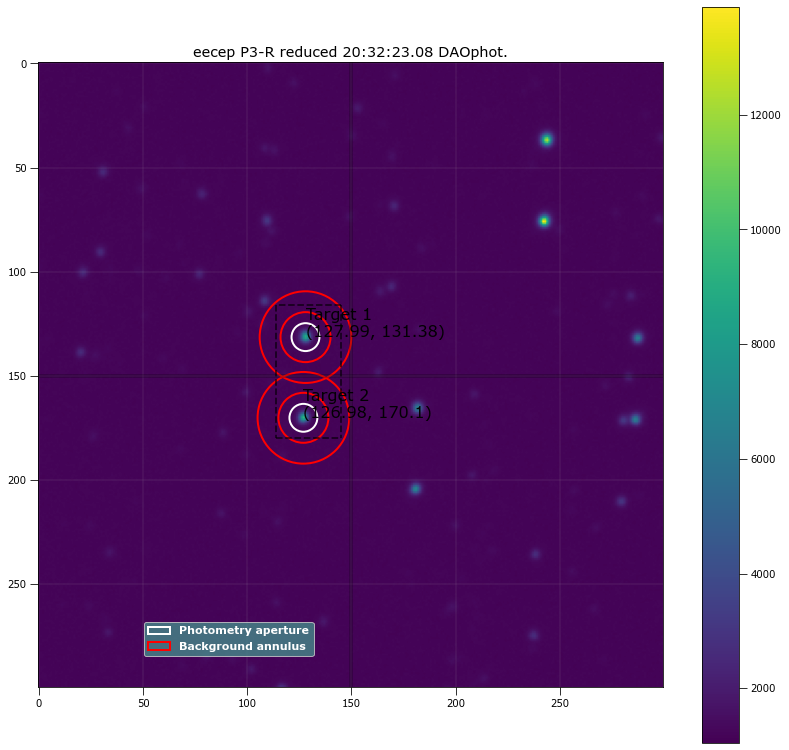

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.99419 131.37623 ...           3337.755      1266854.3          3878.4485
  2 126.98333 170.10494 ...          3340.7838      1267517.1          3880.5703

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.99419 131.37623 ...                 2826.3332              153431.7
  2 126.98333 170.10494 ...                 2829.0822             148402.27

Write this out the excel
425 20:32:23.08 P3-R 20.0 6.695762711864407 127.99419096351438 131.3762251372815 153431.6971386082 2826.333192790951 12

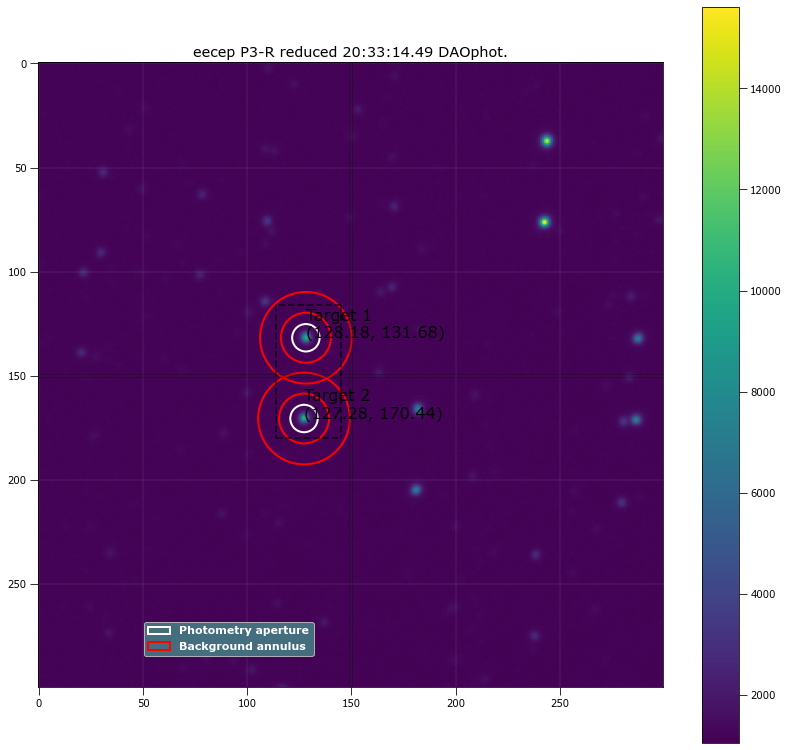

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.17643 131.68368 ...          3481.3107      1267190.7          3879.8319
  2 127.28314  170.4408 ...          3483.5192      1265195.1          3873.5179

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.17643 131.68368 ...                 2986.4672             155637.11
  2 127.28314  170.4408 ...                  2989.481             151220.25

Write this out the excel
426 20:33:14.49 P3-R 20.0 6.5851694915254235 128.17642748867647 131.68367527748163 155637.10844629625 2986.467159763034

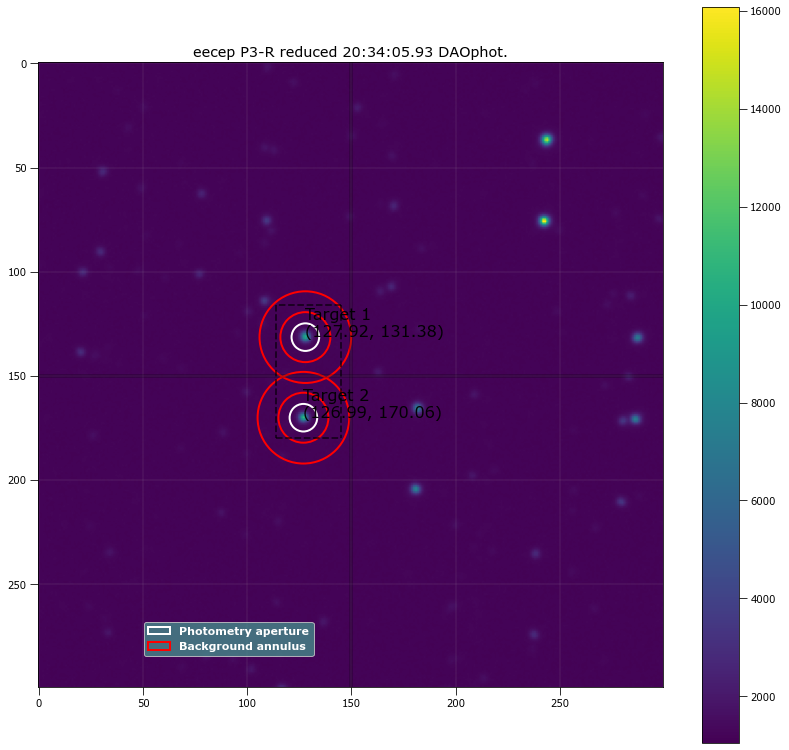

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1   127.924 131.38145 ...          3515.6593      1268593.6           3884.197
  2 126.98926   170.059 ...          3517.3894      1268307.8            3883.19

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1   127.924 131.38145 ...                 3014.6969             156053.34
  2 126.98926   170.059 ...                 3016.5569              151355.3

Write this out the excel
427 20:34:05.93 P3-R 20.0 6.622033898305085 127.92400024337687 131.38145248271186 156053.3423890831 3014.696944144464 1

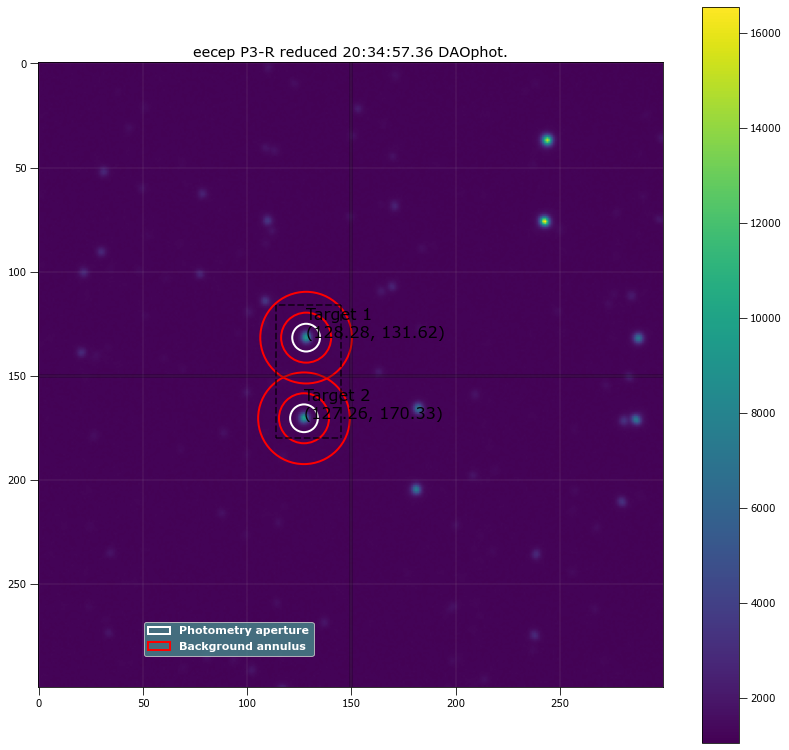

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.28489 131.62326 ...          3453.1867      1273121.1          3897.7925
  2 127.26499  170.3312 ...          3458.2937      1274716.7          3902.5898

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.28489 131.62326 ...                 2944.8581             155952.13
  2 127.26499  170.3312 ...                 2949.3394             151468.44

Write this out the excel
428 20:34:57.36 P3-R 20.0 6.658898305084746 128.2848891275055 131.62325518283512 155952.12912709234 2944.8580870293126 

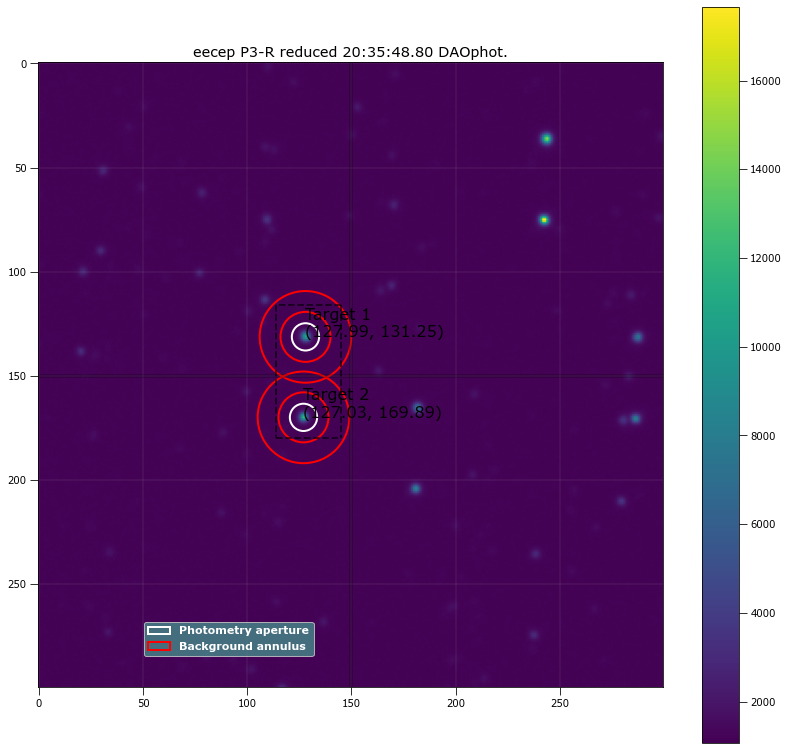

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1   127.986 131.25383 ...          3572.9128      1275626.5          3905.6657
  2 127.02781 169.89079 ...          3643.9597      1276986.6          3909.8092

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1   127.986 131.25383 ...                  3080.336             157118.29
  2 127.02781 169.89079 ...                 3150.8603             153807.32

Write this out the excel
429 20:35:48.80 P3-R 20.0 6.5483050847457624 127.98599627221688 131.25382777512058 157118.285749104 3080.3359623160727 

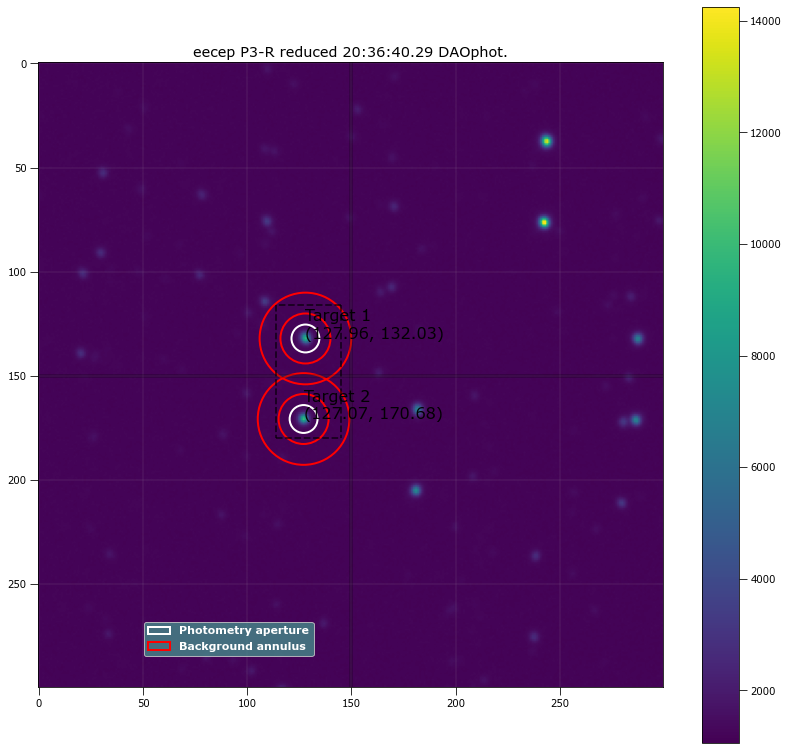

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.96231 132.02821 ...          3455.0852      1271665.3          3893.3759
  2 127.07084 170.68044 ...          3459.9049        1270716          3890.4969

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.96231 132.02821 ...                 2941.6951             157115.34
  2 127.07084 170.68044 ...                 2946.8943             153406.73

Write this out the excel
430 20:36:40.29 P3-R 20.0 6.695762711864407 127.96231205841144 132.0282085027032 157115.33807443795 2941.695086659277 1

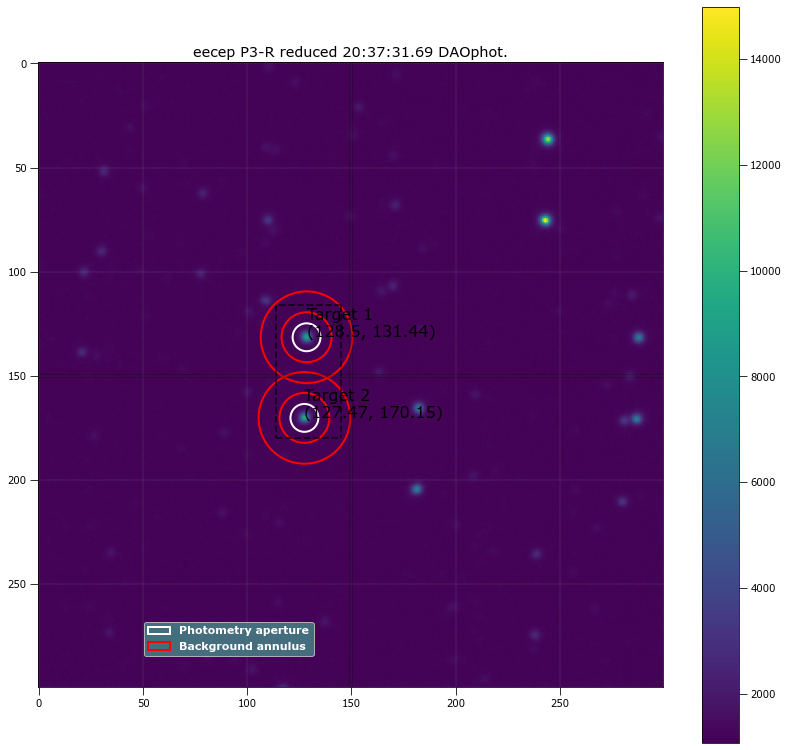

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.50108 131.43978 ...          3419.1242      1272155.4          3894.8816
  2 127.47352 170.14552 ...          3422.7162      1273077.8          3897.6699

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.50108 131.43978 ...                 2905.5355             156473.36
  2 127.47352 170.14552 ...                 2908.7598              151765.7

Write this out the excel
431 20:37:31.69 P3-R 20.0 6.695762711864406 128.50108441104717 131.43977892219127 156473.3618201666 2905.5354848321845 1

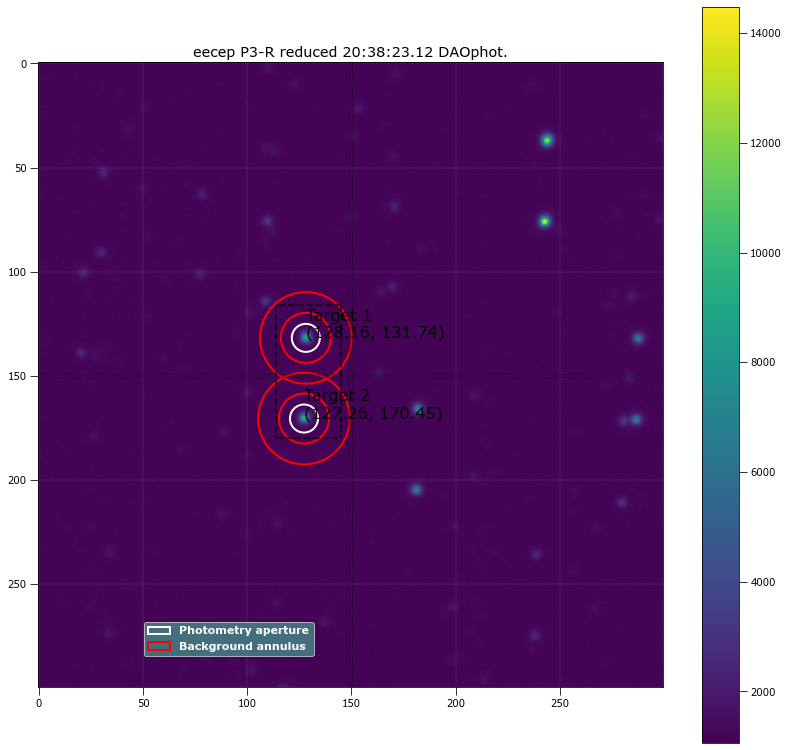

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.15601 131.74228 ...          3391.9896      1273589.1          3899.3846
  2 127.26468  170.4498 ...          3387.1691      1272289.7          3895.1483

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.15601 131.74228 ...                 2872.1298             155596.98
  2 127.26468  170.4498 ...                  2867.874             150503.14

Write this out the excel
432 20:38:23.12 P3-R 20.0 6.732627118644068 128.15600985059223 131.74228240085029 155596.97963679468 2872.1297627992 127

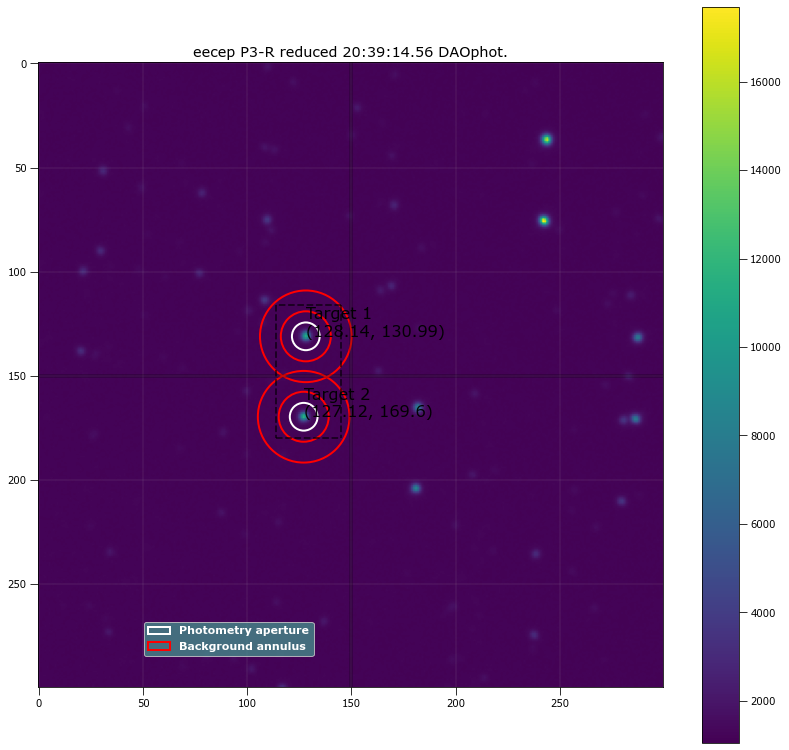

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.14216 130.98682 ...          3671.3254      1275236.5          3904.5506
  2 127.11948 169.59749 ...          3686.3654      1275548.1          3905.5129

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.14216 130.98682 ...                 3162.1154             159328.58
  2 127.11948 169.59749 ...                 3177.0299             155120.83

Write this out the excel
433 20:39:14.56 P3-R 20.0 6.658898305084746 128.14216031660501 130.98681626920737 159328.5752049799 3162.115401181325 1

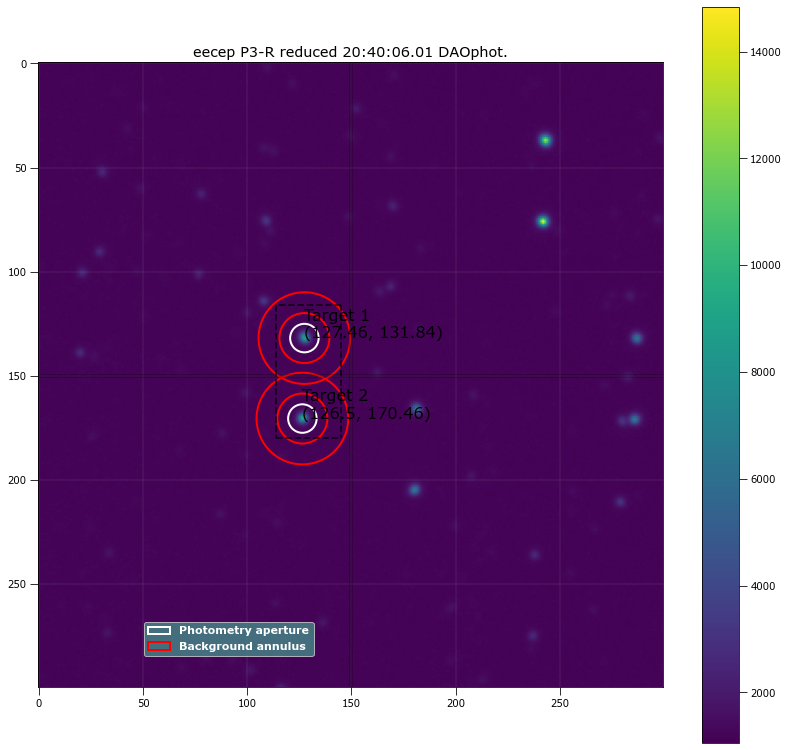

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.46118 131.83793 ...          3399.1985      1268980.4          3885.1354
  2 126.49581 170.46261 ...          3409.5244      1268690.6           3884.011

 Aperture are: 147.1197303021624 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.46118 131.83793 ...                 2864.0821             158177.98
  2 126.49581 170.46261 ...                 2874.5628             154545.78

Write this out the excel
434 20:40:06.01 P3-R 20.0 6.84322033898305 127.46118302213648 131.83793007338372 158177.9786521634 2864.0821091688863 12

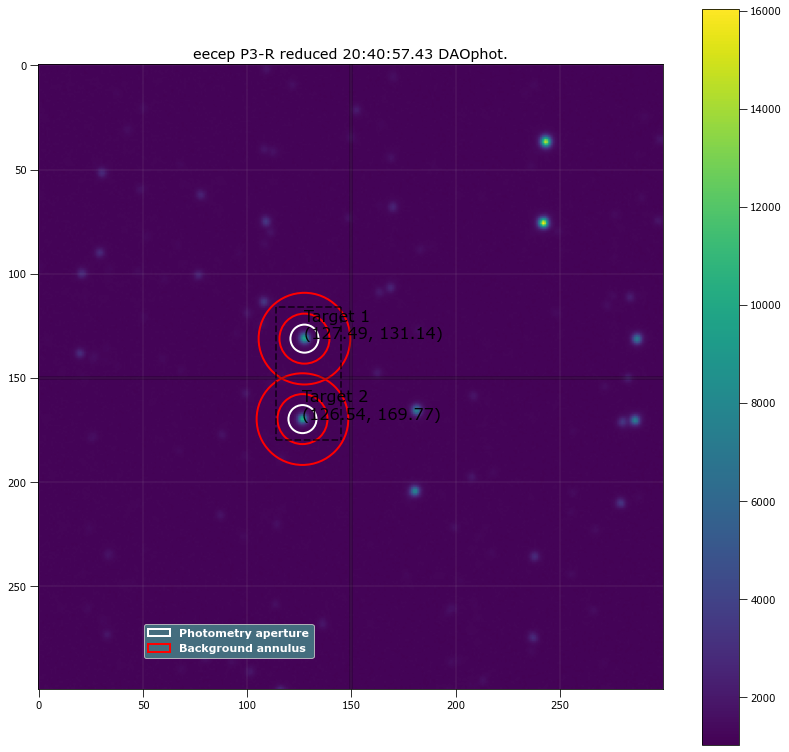

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.49224 131.14264 ...          3513.6831      1267012.1          3879.2212
  2 126.53584 169.77195 ...          3510.6821      1265199.1          3873.7003

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.49224 131.14264 ...                 2996.5114             158165.35
  2 126.53584 169.77195 ...                 2994.2464             152514.45

Write this out the excel
435 20:40:57.43 P3-R 20.0 6.732627118644068 127.49223755784384 131.14264011565922 158165.34676277588 2996.511381646194 1

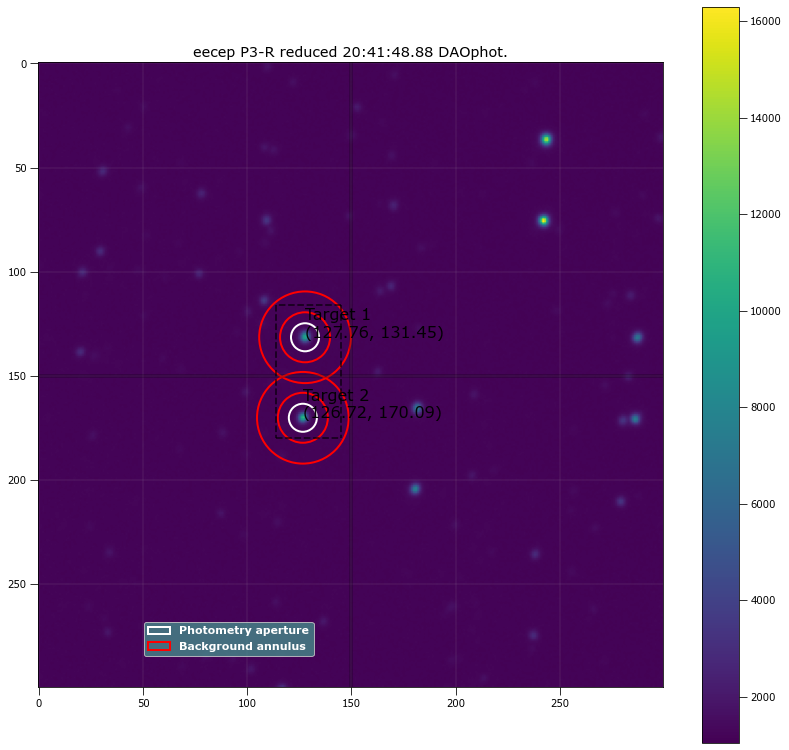

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.7643 131.44747 ...           3556.391        1262397          3865.1623
  2 126.71988 170.09027 ...          3591.3553      1264353.9           3871.001

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.7643 131.44747 ...                 3041.0936             159700.97
  2 126.71988 170.09027 ...                 3075.2795             155068.43

Write this out the excel
436 20:41:48.88 P3-R 20.0 6.732627118644068 127.7642981563374 131.44746909068724 159700.9711936091 3041.093642168745 126

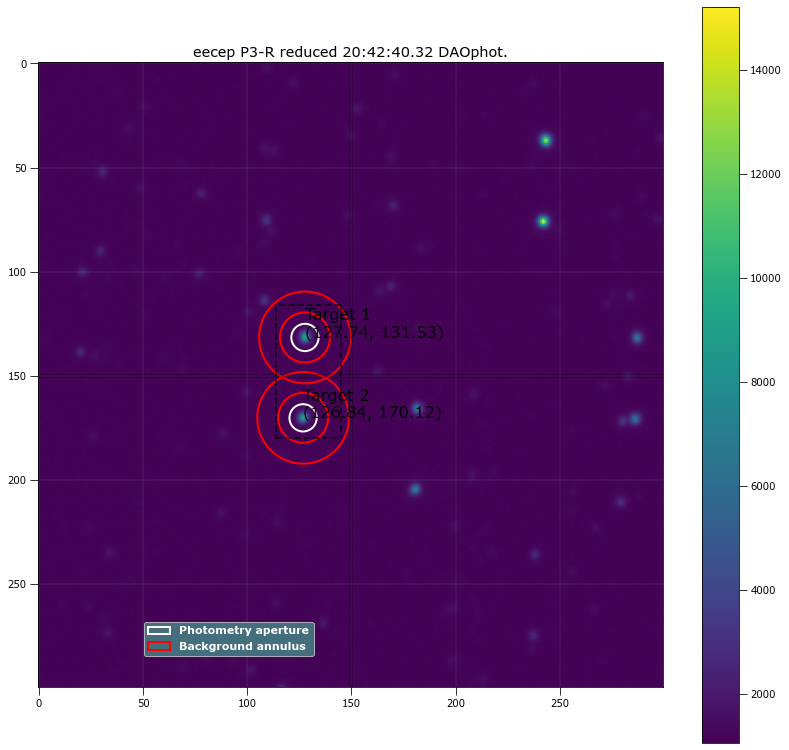

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.73682 131.53424 ...          3420.9161      1259761.7          3856.9563
  2 126.83643 170.12243 ...          3364.4274      1260279.3          3858.4527

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.73682 131.53424 ...                 2934.4825             159158.28
  2 126.83643 170.12243 ...                  2877.805             153693.88

Write this out the excel
437 20:42:40.32 P3-R 20.0 6.5483050847457624 127.73682060214547 131.5342438433544 159158.277857847 2934.482457824876 12

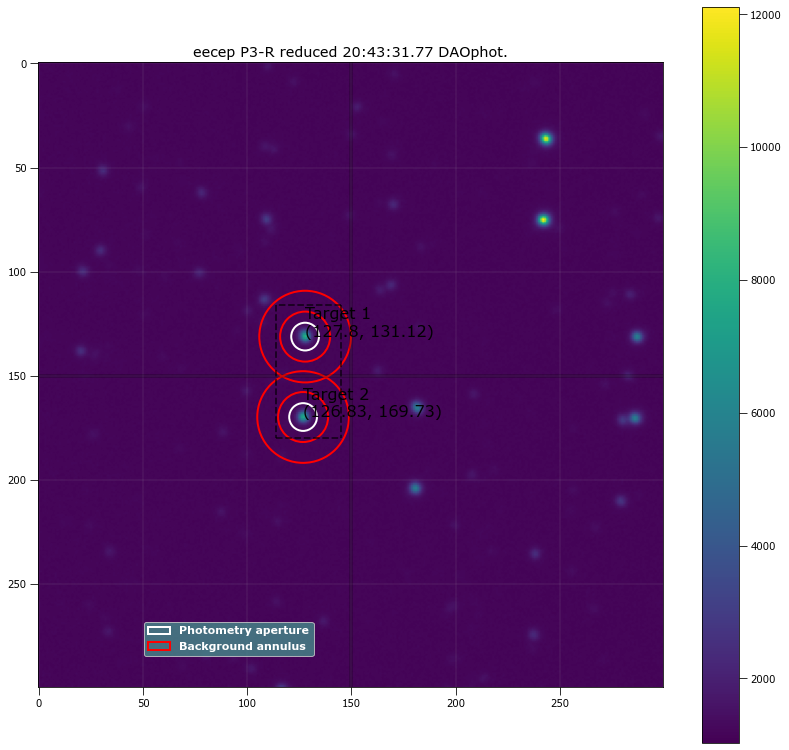

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.80401 131.12292 ...          3246.3338        1258936          3854.0578
  2 126.83374 169.73225 ...          3175.7752      1258737.4          3853.5326

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.80401 131.12292 ...                 2743.7088             155578.05
  2 126.83374 169.73225 ...                 2673.2187             149888.68

Write this out the excel
438 20:43:31.77 P3-R 20.0 6.658898305084746 127.80401108777419 131.12292103983546 155578.04758821768 2743.708799998587 

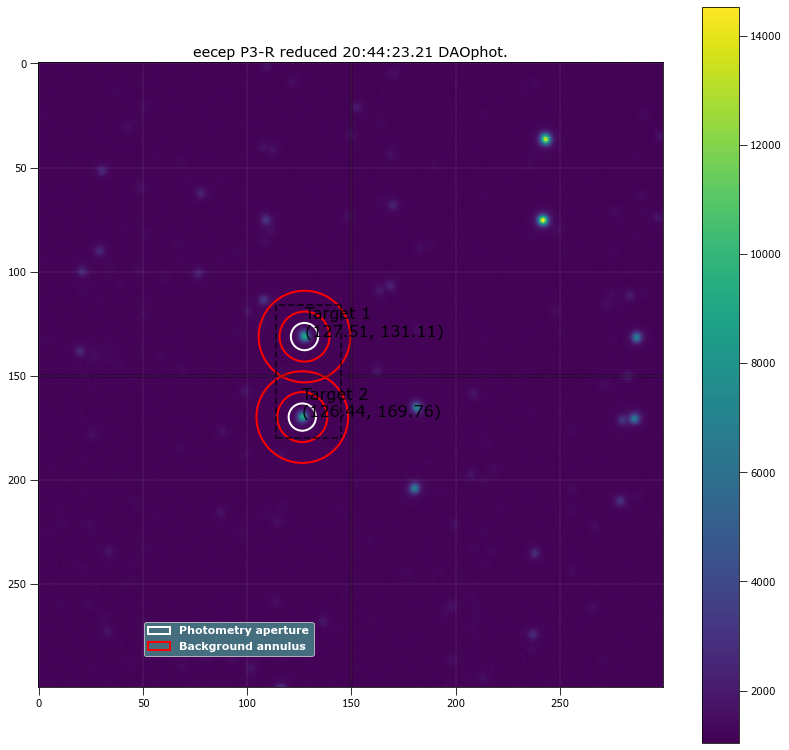

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.51401 131.11292 ...          3426.8473      1257529.9          3850.0858
  2 126.44298  169.7613 ...          3367.2731      1258901.3          3854.3587

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.51401 131.11292 ...                 2941.2802             158333.41
  2 126.44298  169.7613 ...                  2881.167             152649.71

Write this out the excel
439 20:44:23.21 P3-R 20.0 6.5483050847457624 127.51400663390517 131.11292473052538 158333.41147521482 2941.280164025789

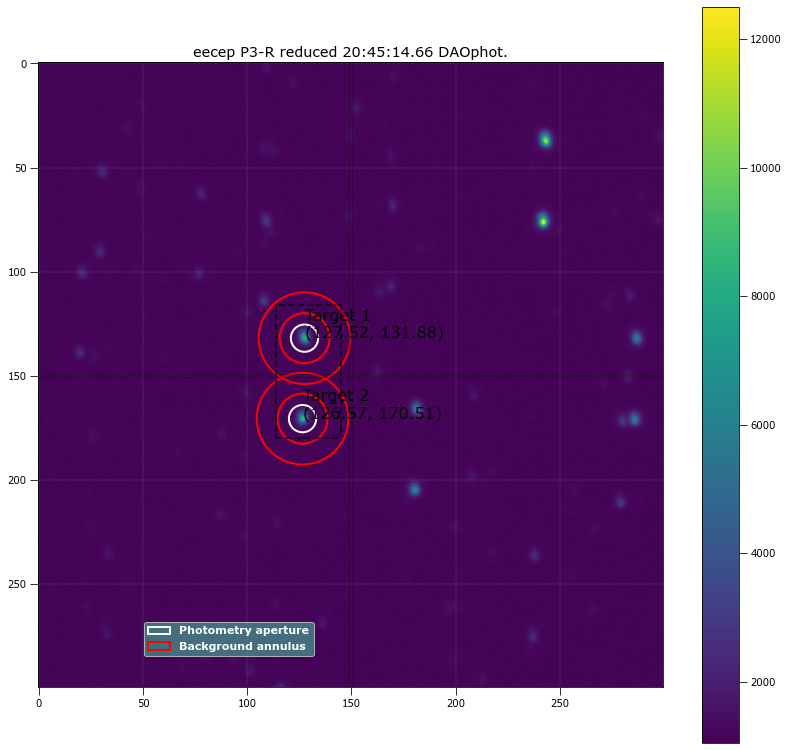

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.51972 131.87622 ...          3309.4173      1253702.8          3838.2205
  2 126.57275  170.5051 ...          3309.2074      1253292.8          3836.8395

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.51972 131.87622 ...                 2825.3466             156764.54
  2 126.57275  170.5051 ...                 2825.3108             153287.54

Write this out the excel
440 20:45:14.66 P3-R 20.0 6.5483050847457624 127.51972361115587 131.87622429493123 156764.54369577047 2825.346598087997

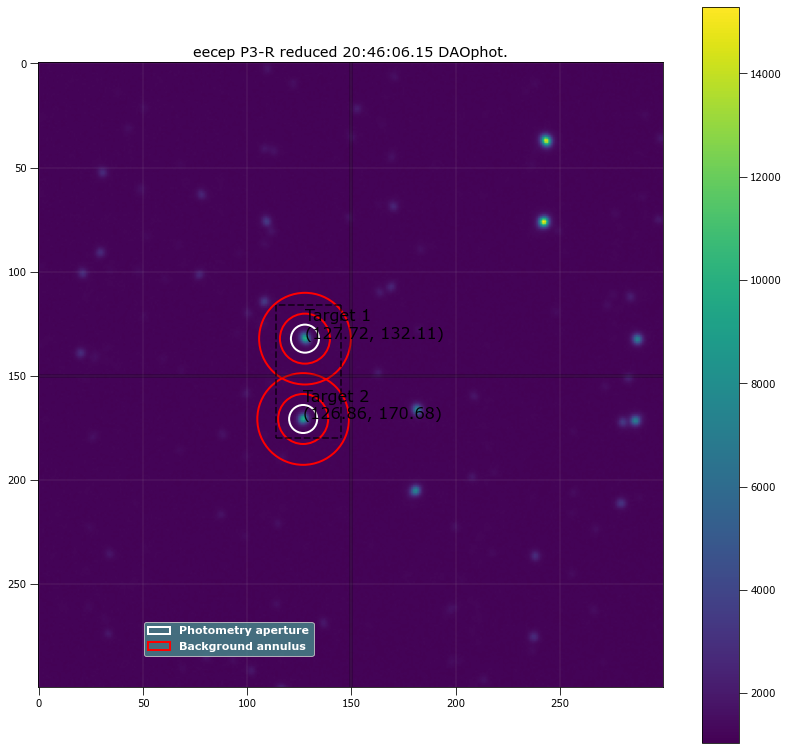

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.72398 132.10584 ...          3494.7841      1251456.3          3831.6681
  2 126.86301 170.67857 ...          3441.8172      1250880.4          3829.9384

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.72398 132.10584 ...                 2983.9521             157934.92
  2 126.86301 170.67857 ...                 2931.2158             153060.65

Write this out the excel
441 20:46:06.15 P3-R 20.0 6.732627118644068 127.7239775038916 132.10583642910672 157934.9227012918 2983.95205675223 126.

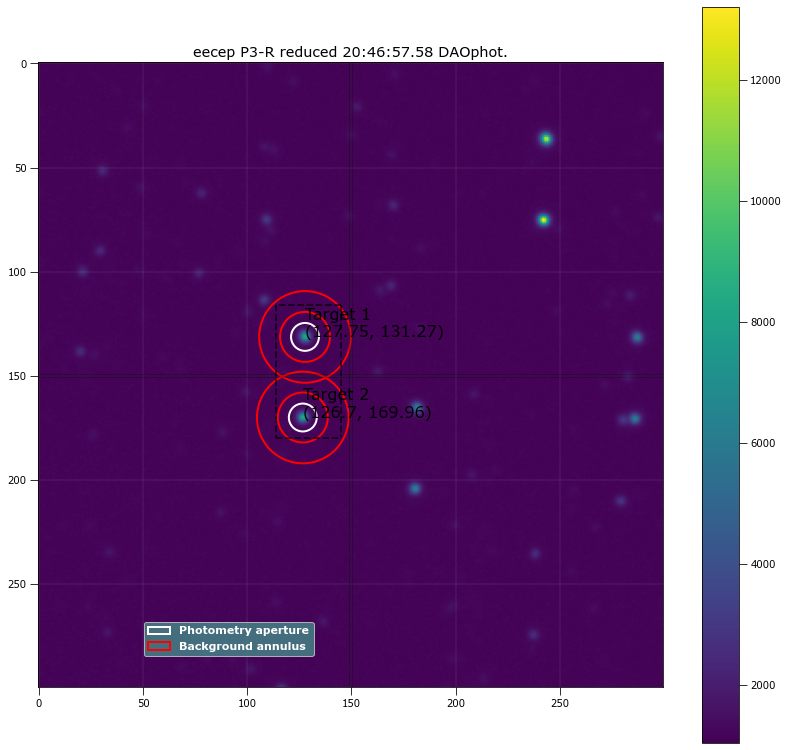

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.75243 131.27138 ...          3302.0919      1252647.8          3835.0207
  2 126.69901 169.96232 ...           3285.903      1253469.4          3837.4745

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.75243 131.27138 ...                 2796.3966             156987.66
  2 126.69901 169.96232 ...                 2779.8842              152659.4

Write this out the excel
442 20:46:57.58 P3-R 20.0 6.695762711864406 127.75242606363035 131.27138187483152 156987.65550450847 2796.396649931905 1

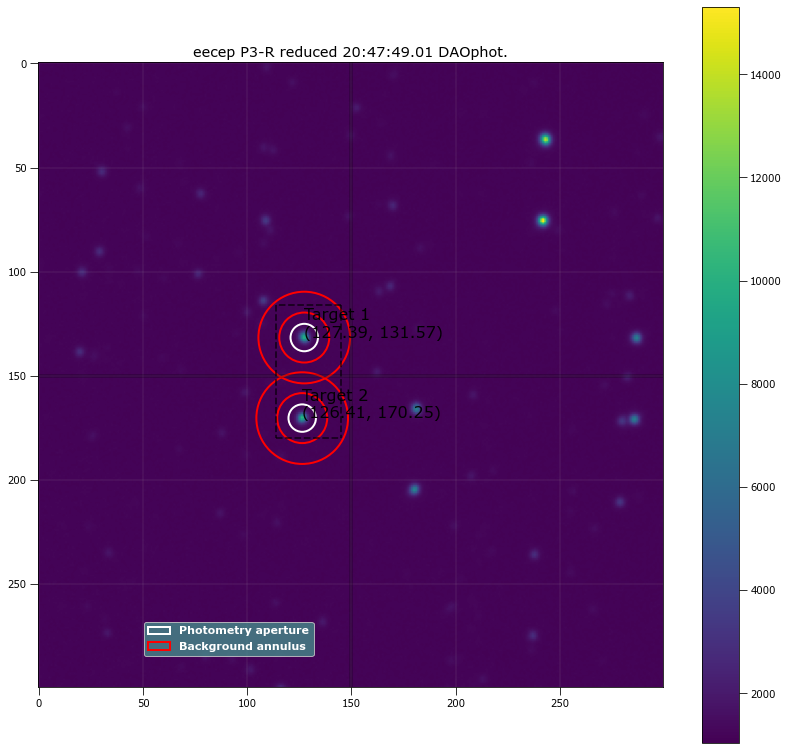

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.39307 131.57426 ...          3518.1649      1250662.6          3829.2832
  2 126.40746 170.25209 ...          3512.0887      1250413.8          3828.3481

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.39307 131.57426 ...                 3029.7685              159300.3
  2 126.40746 170.25209 ...                 3023.8115             155165.09

Write this out the excel
443 20:47:49.01 P3-R 20.0 6.5851694915254235 127.3930660175935 131.57426071694388 159300.30403079168 3029.768488698788 

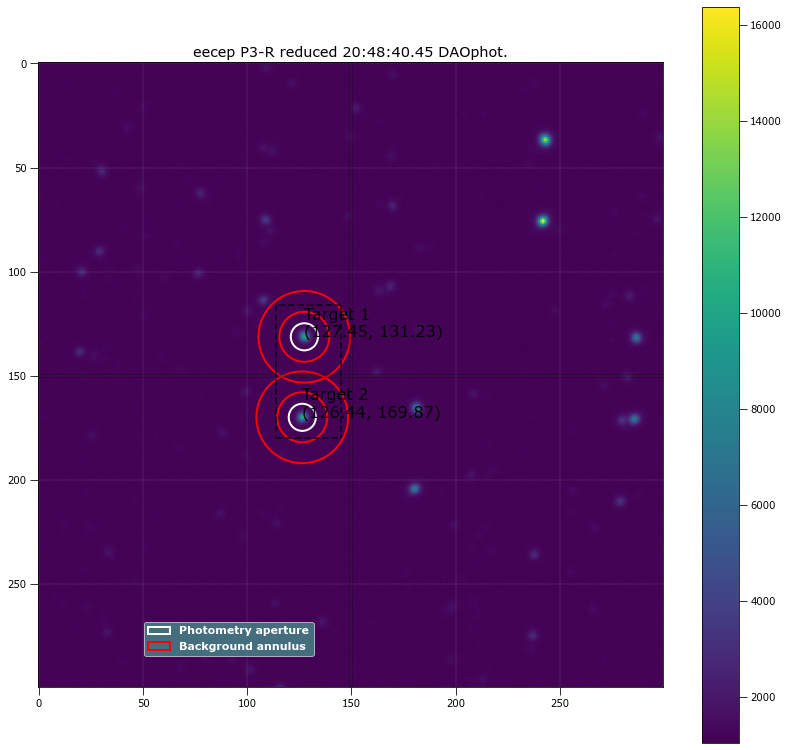

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.44626  131.2285 ...           3496.442      1248042.7          3821.4143
  2 126.44357 169.87265 ...          3516.5921        1248871          3823.7616

 Aperture are: 133.19994616249755 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.44626  131.2285 ...                  3019.902             158359.71
  2 126.44357 169.87265 ...                 3039.7593              153759.2

Write this out the excel
444 20:48:40.45 P3-R 20.0 6.511440677966101 127.4462593358573 131.2285022453873 158359.7110967915 3019.901996275352 126

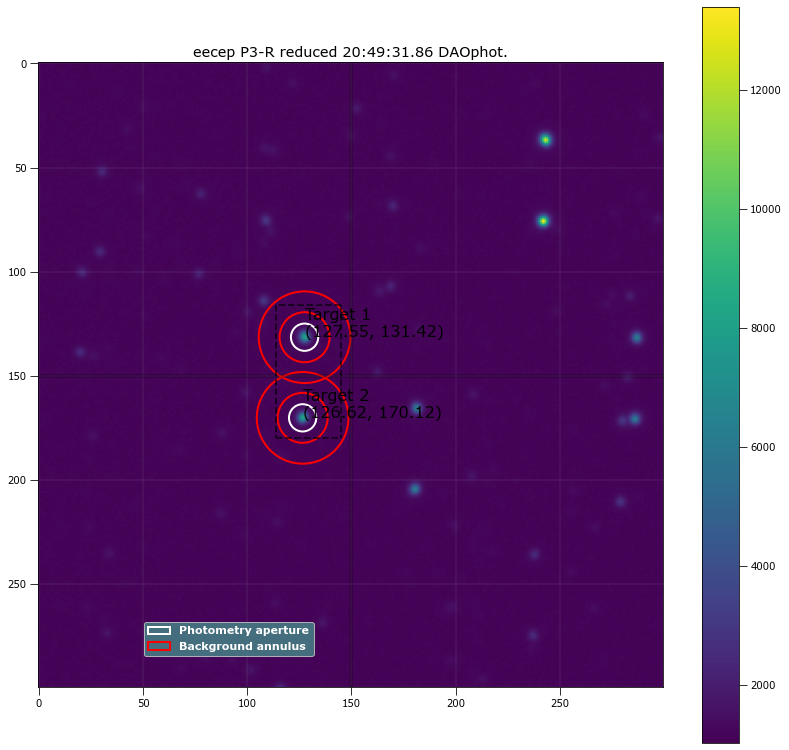

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.54952 131.41675 ...          3263.0394      1248985.1          3823.8543
  2 126.61981 170.12215 ...          3231.9769      1247741.9          3820.0083

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.54952 131.41675 ...                 2780.7805             155418.46
  2 126.61981 170.12215 ...                 2750.2031             150801.46

Write this out the excel
445 20:49:31.86 P3-R 20.0 6.5483050847457624 127.54952490500109 131.41675136992438 155418.45624470987 2780.780488996222

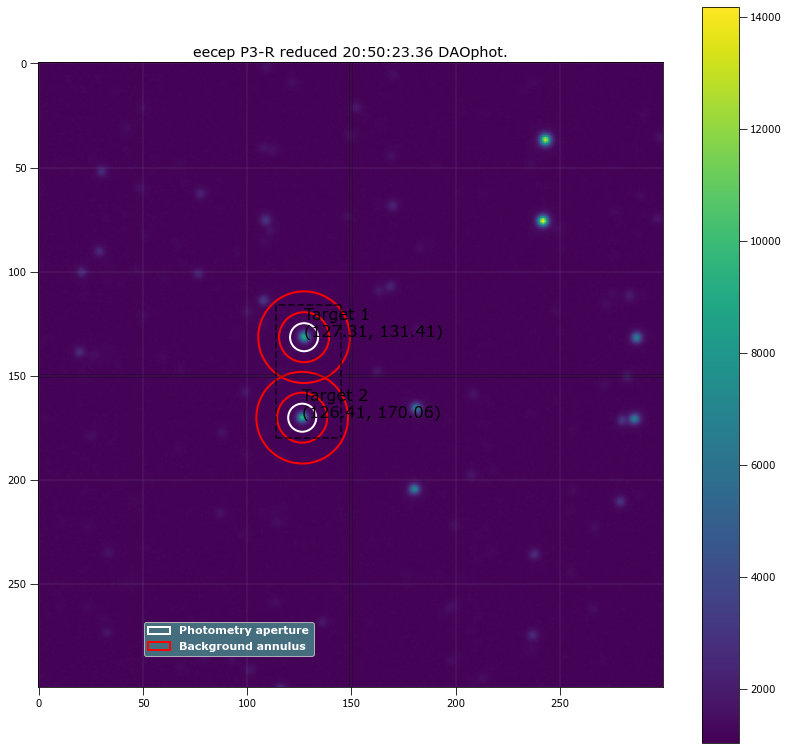

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.30602 131.41229 ...          3410.7513      1249857.5          3826.5323
  2   126.408 170.05588 ...          3419.3475        1251277          3830.8828

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.30602 131.41229 ...                  2900.604             159967.58
  2   126.408 170.05588 ...                 2908.6202             154685.08

Write this out the excel
446 20:50:23.36 P3-R 20.0 6.732627118644068 127.30601948684026 131.41228780398768 159967.58036233456 2900.6039871633075 

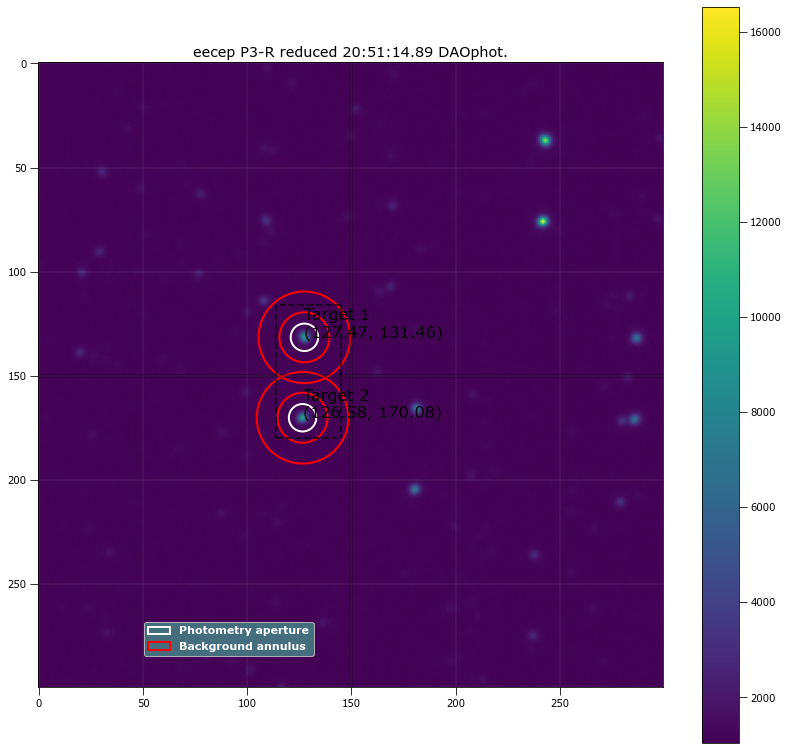

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.46658 131.46323 ...          3431.0845      1247773.4          3820.4233
  2 126.57923  170.0781 ...          3442.4233      1248261.1          3821.7221

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.46658 131.46323 ...                 2943.8181             157630.88
  2 126.57923  170.0781 ...                 2954.9912             153540.44

Write this out the excel
447 20:51:14.89 P3-R 20.0 6.5851694915254235 127.4665766645143 131.46322937006002 157630.88217673576 2943.818084733561 

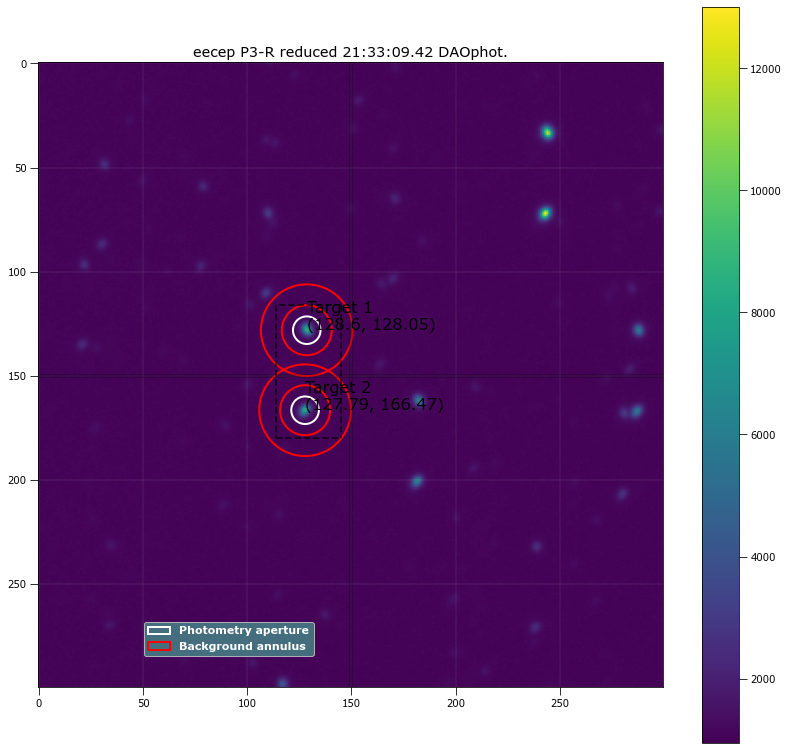

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.59871 128.05261 ...          3312.2131      1154857.3          3536.1024
  2 127.78898 166.46854 ...          3241.7154        1152119           3527.455

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.59871 128.05261 ...                  2856.146             164115.19
  2 127.78898 166.46854 ...                 2786.7637             158917.89

Write this out the excel
448 21:33:09.42 P3-R 20.0 6.622033898305085 128.59871262433768 128.0526074864053 164115.1883146164 2856.146033197244 12

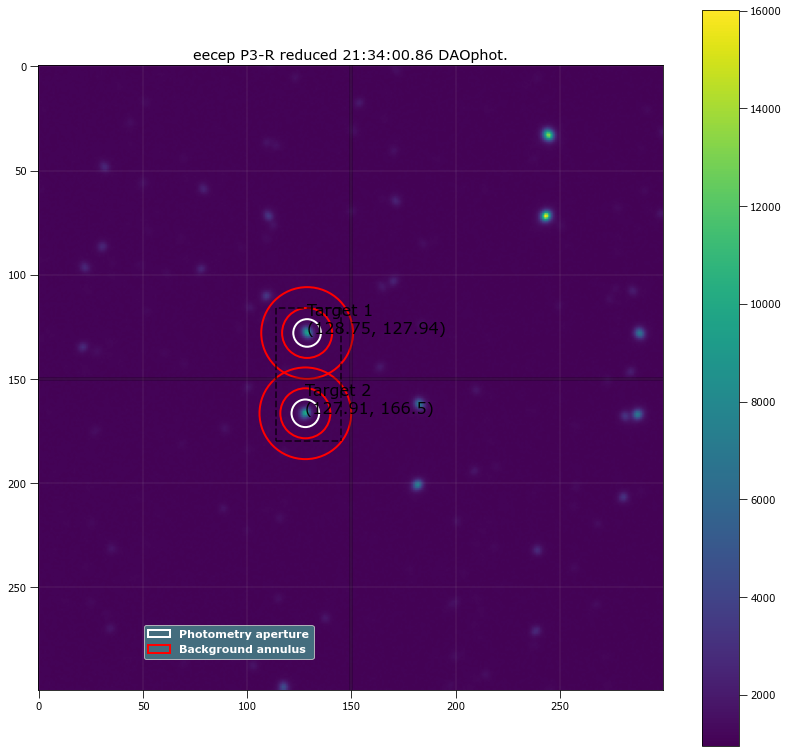

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  128.7515 127.93665 ...          3459.7608      1150765.9          3523.7365
  2 127.91427 166.50066 ...          3438.6834      1150064.4          3521.3311

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  128.7515 127.93665 ...                 3005.2886             166642.44
  2 127.91427 166.50066 ...                 2984.5215             161256.63

Write this out the excel
449 21:34:00.86 P3-R 20.0 6.622033898305085 128.75149703674077 127.93665457417225 166642.43883307496 3005.288608040235 

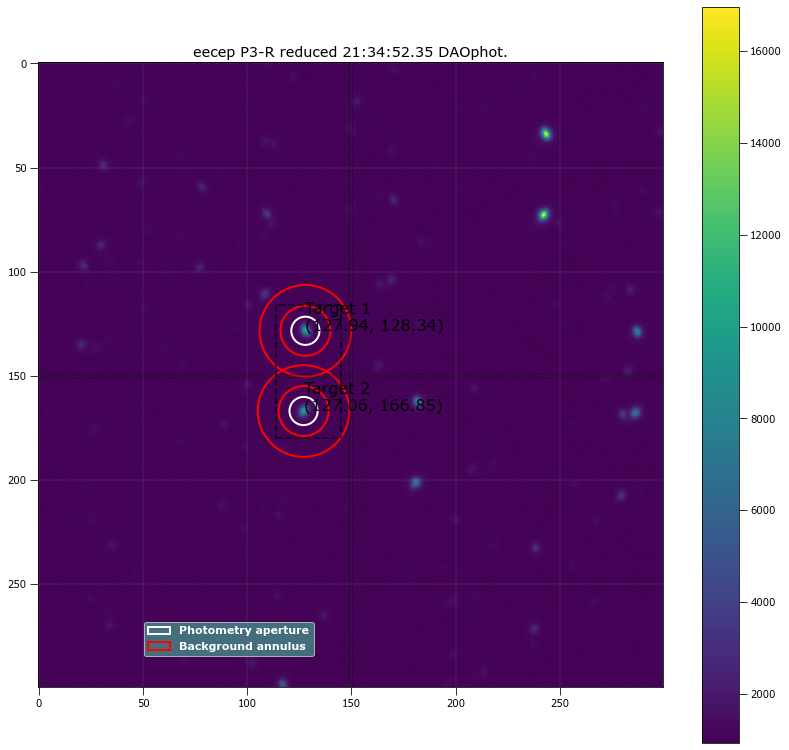

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.94189 128.34215 ...          3638.8368      1149083.1           3519.086
  2 127.06212 166.85176 ...          3501.9612      1149972.5          3521.3562

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.94189 128.34215 ...                 3164.5259             166688.71
  2 127.06212 166.85176 ...                 3027.3443             160568.62

Write this out the excel
450 21:34:52.35 P3-R 20.0 6.769491525423728 127.94188788774653 128.34214562364704 166688.70725780493 3164.5259265751724

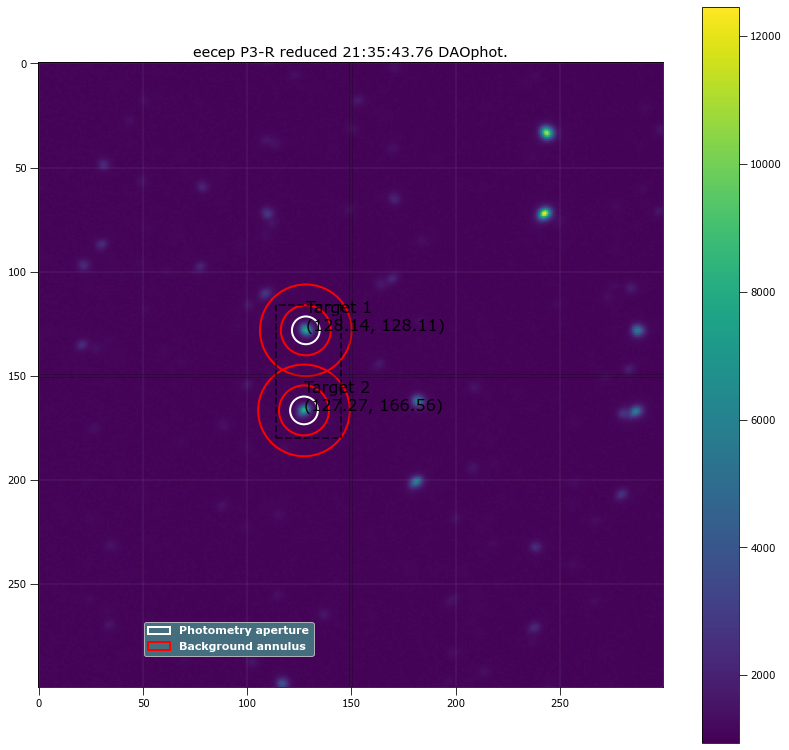

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.14267 128.10732 ...          3244.4666      1144732.6           3505.019
  2 127.26575 166.55902 ...          3241.6454      1144247.8          3503.4915

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.14267 128.10732 ...                 2787.3614             164652.86
  2 127.26575 166.55902 ...                 2784.7394                159579

Write this out the excel
451 21:35:43.76 P3-R 20.0 6.658898305084746 128.14266575799283 128.10731732826363 164652.857159877 2787.361368211732 12

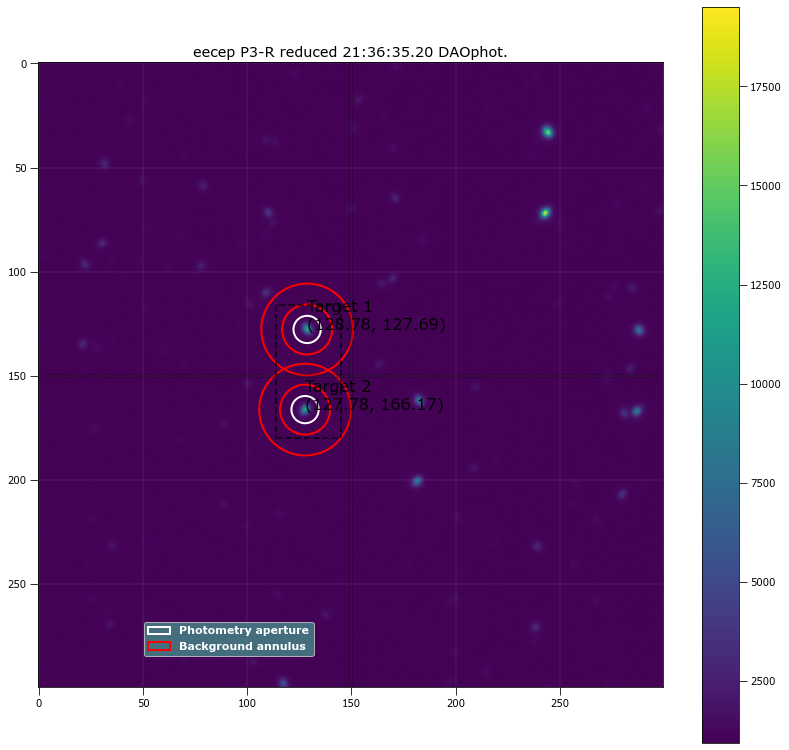

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.77778 127.69197 ...          3649.2841      1142425.3          3498.6204
  2 127.78369 166.17203 ...          3636.3689      1144834.6          3506.2735

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.77778 127.69197 ...                 3208.0432             167739.38
  2 127.78369 166.17203 ...                 3194.1629             161832.11

Write this out the excel
452 21:36:35.20 P3-R 20.0 6.5483050847457624 128.77777851667577 127.69196934154802 167739.3829717851 3208.043207098477 

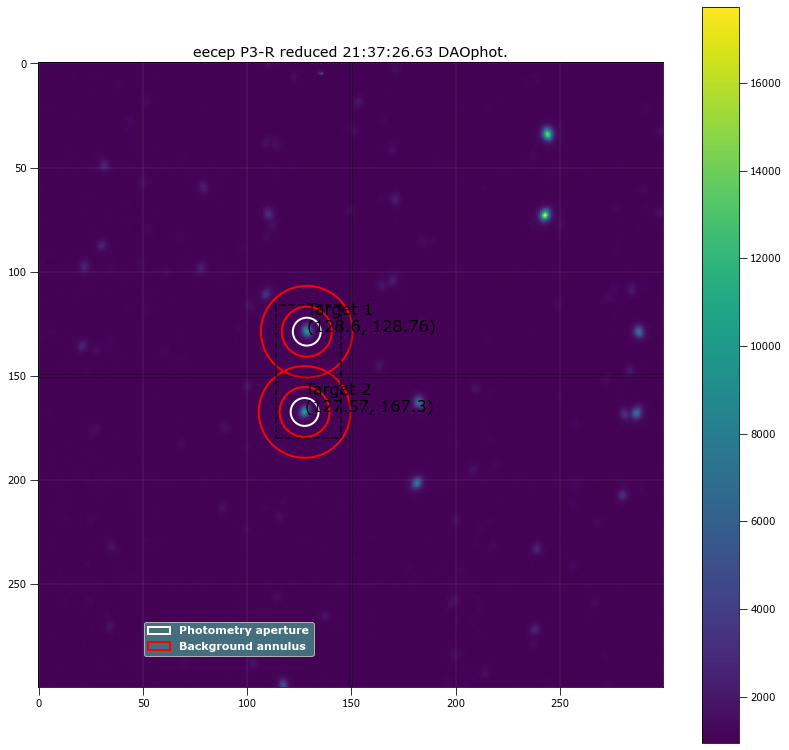

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.59954 128.75872 ...          3496.7244      1142421.9          3498.2961
  2 127.56811 167.29923 ...          3500.2176      1142483.9          3498.5005

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.59954 128.75872 ...                 3035.4305             167623.38
  2 127.56811 167.29923 ...                 3038.8966             163115.82

Write this out the excel
453 21:37:26.63 P3-R 20.0 6.695762711864406 128.5995420250565 128.75872136563646 167623.381496051 3035.430460472781 127.

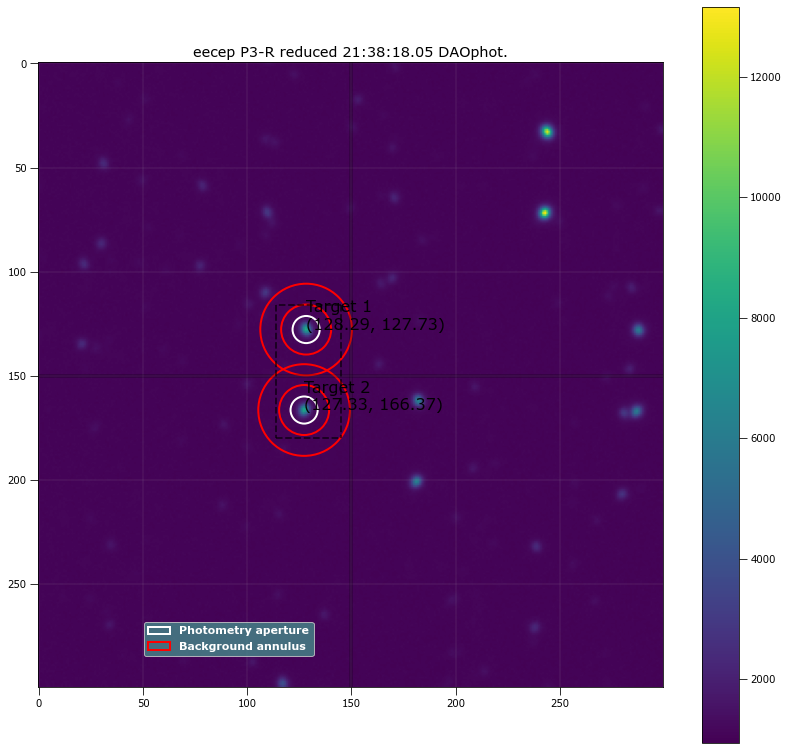

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.28989 127.73207 ...          3263.0759      1139763.8           3489.931
  2  127.3257 166.37307 ...          3204.4406      1140293.3          3491.4355

 Aperture are: 133.19994616249755 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.28989 127.73207 ...                 2827.8727             164484.53
  2  127.3257 166.37307 ...                 2769.0497             159328.63

Write this out the excel
454 21:38:18.05 P3-R 20.0 6.511440677966101 128.28988555014945 127.73206649124073 164484.53395628103 2827.872660689337 

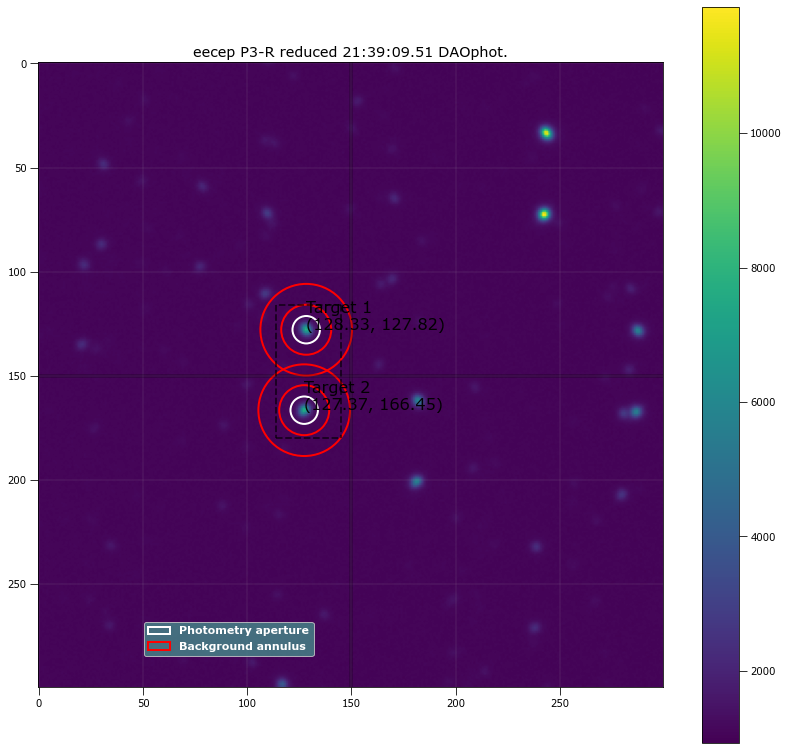

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.33078 127.82088 ...          3202.0987      1139576.8          3489.2947
  2 127.37108  166.4477 ...          3161.9452      1138032.6           3484.257

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.33078 127.82088 ...                 2757.0653             163740.48
  2 127.37108  166.4477 ...                 2717.5542             159447.07

Write this out the excel
455 21:39:09.51 P3-R 20.0 6.5851694915254235 128.33077557950497 127.82088098587467 163740.47524445466 2757.065271729701

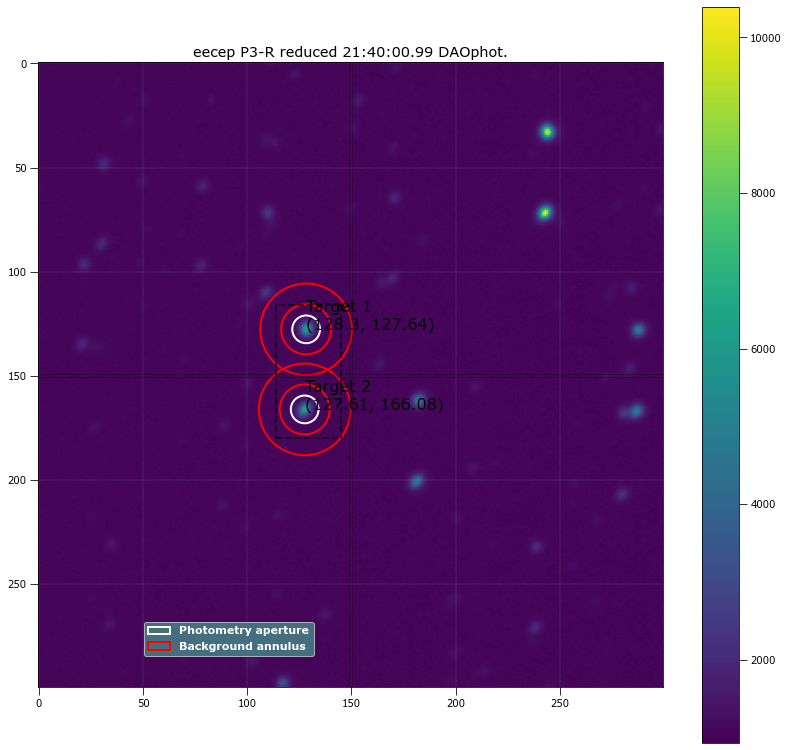

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.30056 127.63862 ...          3043.7087      1138113.6          3484.5794
  2 127.60576 166.07666 ...          2980.0203      1136072.5          3478.1297

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.30056 127.63862 ...                  2589.269             162818.11
  2 127.60576 166.07666 ...                 2526.4218             156618.42

Write this out the excel
456 21:40:00.99 P3-R 20.0 6.658898305084746 128.30055606624109 127.6386232044775 162818.1071493454 2589.269034056688 12

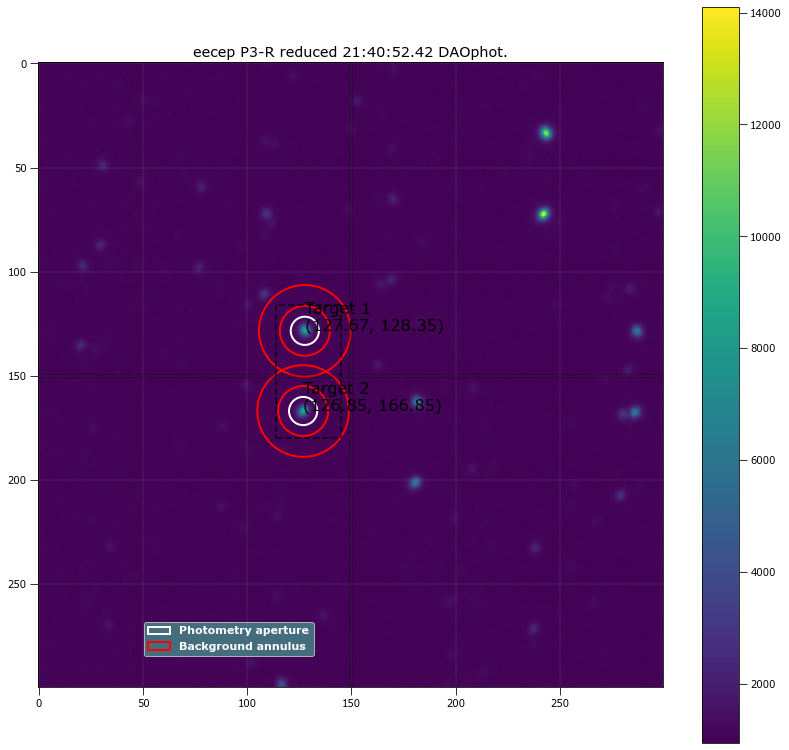

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.67079 128.34885 ...          3337.5897        1138647          3486.5573
  2 126.84556  166.8497 ...          3338.4926      1137500.5          3482.9397

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.67079 128.34885 ...                 2867.6631             165839.37
  2 126.84556  166.8497 ...                 2869.0536              160094.7

Write this out the excel
457 21:40:52.42 P3-R 20.0 6.769491525423728 127.67079034690599 128.34884647040283 165839.37485218974 2867.6631428213964

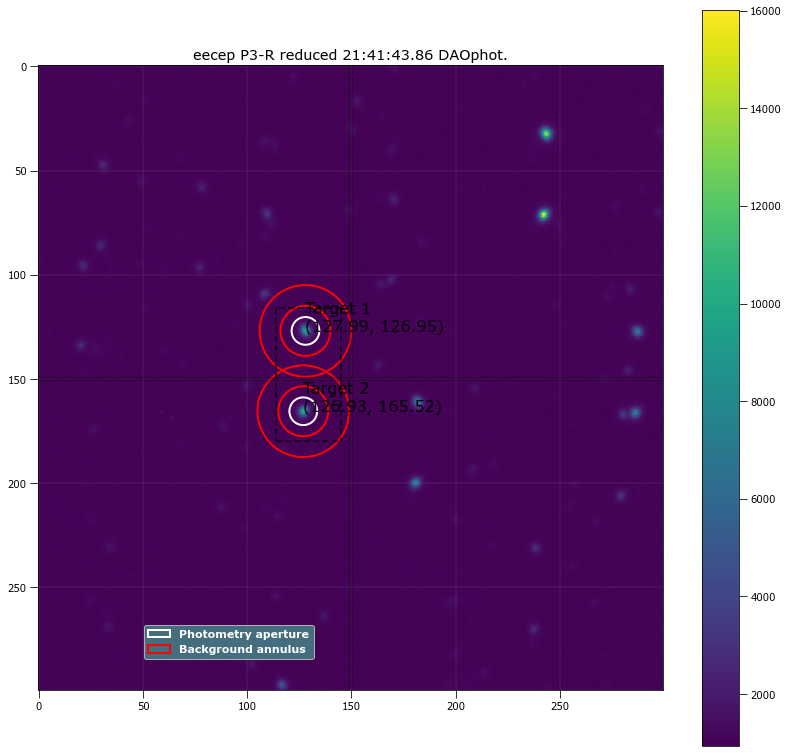

 id  xcenter  ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix      pix    ...                                                     
--- --------- -------- ... ------------------ -------------- ------------------
  1 127.98603 126.9549 ...          3497.0609        1135231          3476.4509
  2 126.92503 165.5189 ...          3482.5588        1136853          3481.2743

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter  ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix      pix    ...                                                
--- --------- -------- ... ------------------------- ---------------------
  1 127.98603 126.9549 ...                 3043.6814             167976.98
  2 126.92503 165.5189 ...                 3028.5502             162997.23

Write this out the excel
458 21:41:43.86 P3-R 20.0 6.658898305084746 127.98602818872826 126.9549031044284 167976.98087995735 3043.6813619098716 126.925027

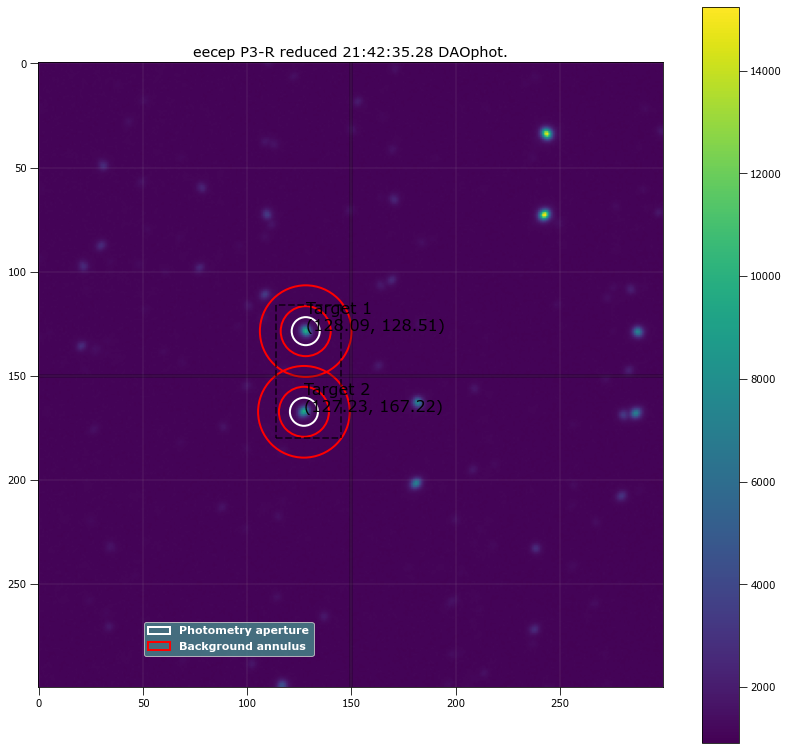

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.09384 128.51179 ...          3476.5547      1128869.8           3457.032
  2 127.23265 167.21714 ...          3416.8073      1128557.3          3455.8446

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.09384 128.51179 ...                 3015.6686             167537.39
  2 127.23265 167.21714 ...                 2956.0795             161595.81

Write this out the excel
459 21:42:35.28 P3-R 20.0 6.732627118644068 128.09383743118036 128.51178940383616 167537.3905855544 3015.6686450927255 1

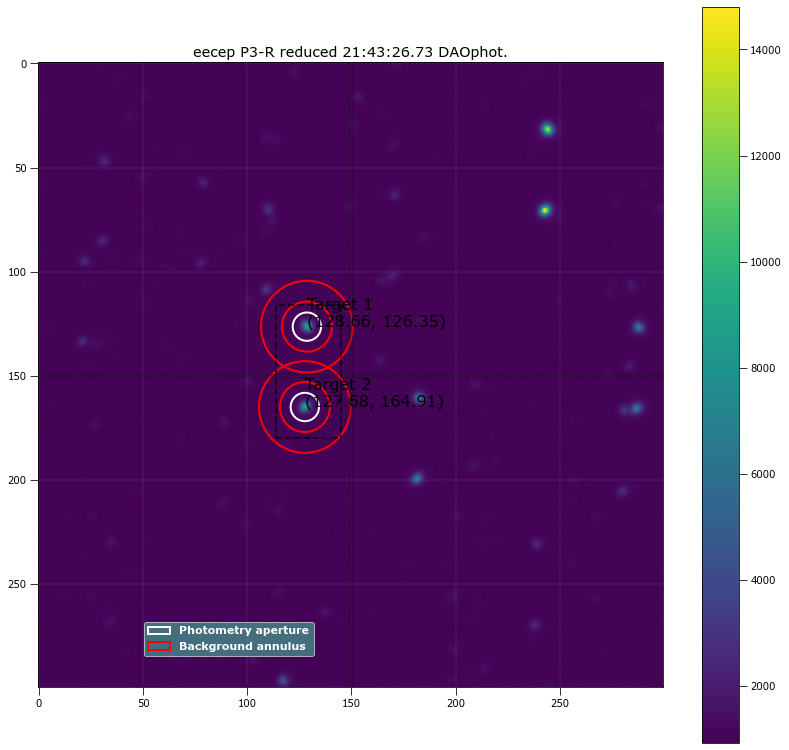

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.65584  126.3549 ...          3376.2721      1125250.3           3445.589
  2 127.67581 164.91302 ...          3322.3114      1125638.5          3446.7437

 Aperture are: 145.53893261452635 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.65584  126.3549 ...                 2906.7956             166657.47
  2 127.67581 164.91302 ...                 2852.6775             160549.31

Write this out the excel
460 21:43:26.73 P3-R 20.0 6.806355932203389 128.65583734437135 126.35490422411806 166657.46743001562 2906.7955926025165

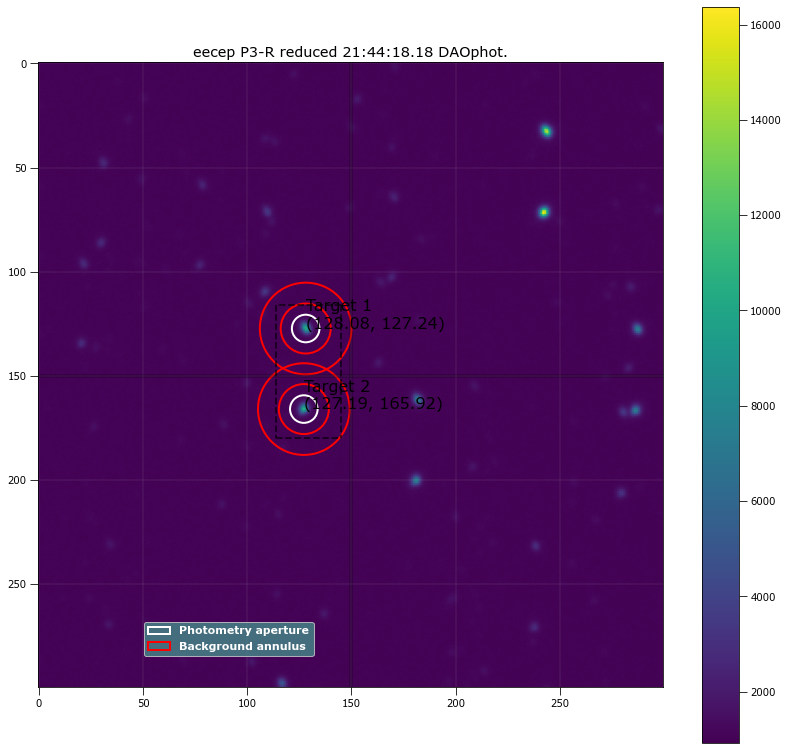

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.08015  127.2363 ...          3568.1714      1123728.3          3441.2626
  2 127.18802 165.91688 ...          3528.0536      1125153.5          3445.5356

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.08015  127.2363 ...                 3124.3363             170442.34
  2 127.18802 165.91688 ...                 3083.6674             164779.03

Write this out the excel
461 21:44:18.18 P3-R 20.0 6.622033898305085 128.08015444105456 127.23630274542263 170442.33878672632 3124.336259239927 

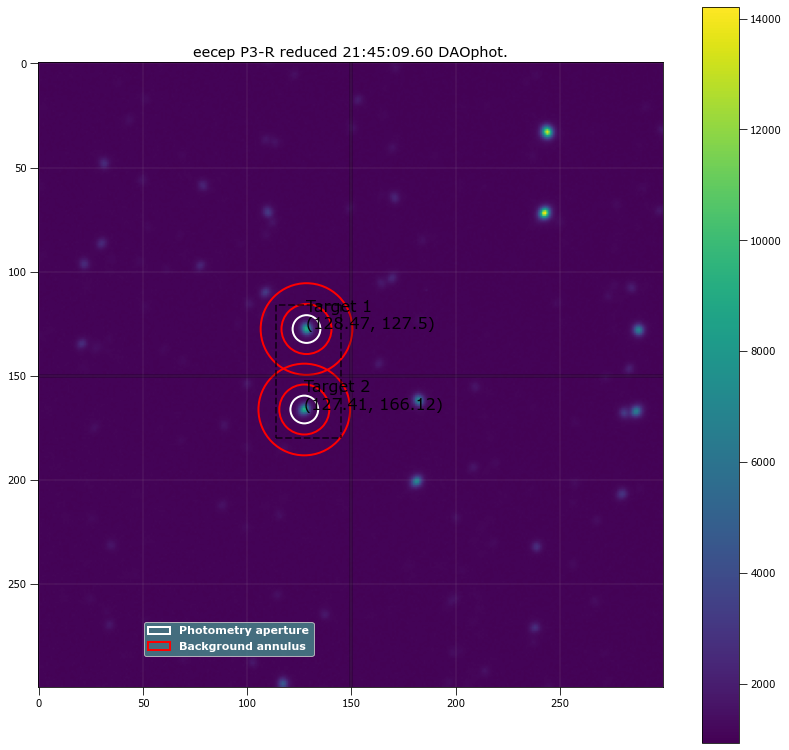

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.46548 127.49735 ...          3410.7943      1124972.1          3444.6481
  2 127.41165 166.12195 ...          3370.2964      1126634.9          3449.6972

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.46548 127.49735 ...                 2961.5623             168207.25
  2 127.41165 166.12195 ...                 2920.4059             163099.17

Write this out the excel
462 21:45:09.60 P3-R 20.0 6.658898305084746 128.46548274422818 127.49735135015491 168207.24781420108 2961.562324081 127

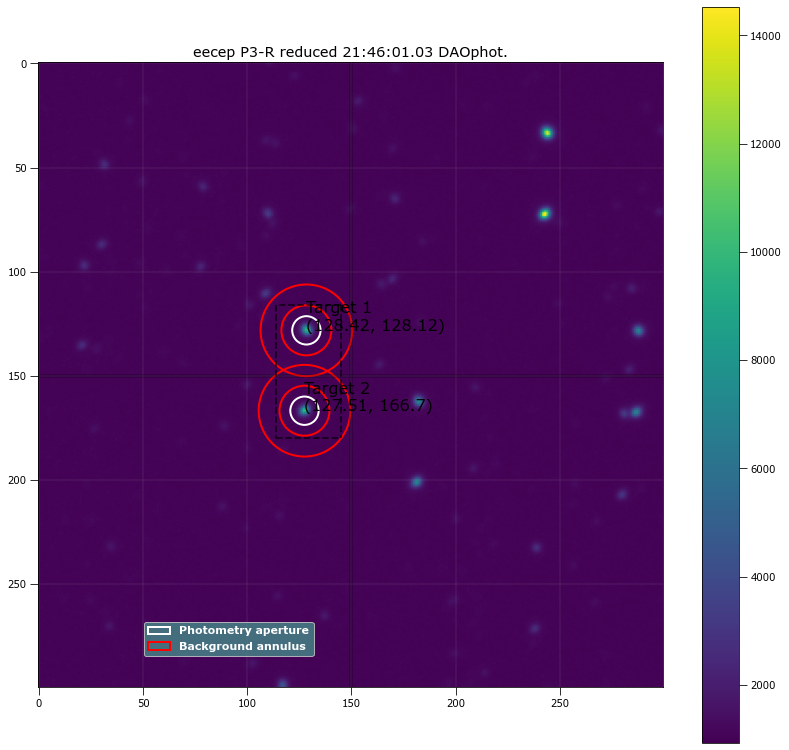

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.42058 128.11848 ...           3499.721      1125020.4          3445.0676
  2  127.5052 166.70421 ...          3476.3271      1123790.7          3441.2182

 Aperture are: 145.5389326145264 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.42058 128.11848 ...                 3030.3155             170424.26
  2  127.5052 166.70421 ...                 3007.4461             165987.31

Write this out the excel
463 21:46:01.03 P3-R 20.0 6.80635593220339 128.42058353561345 128.11847998337916 170424.26305348924 3030.3155256327364 1

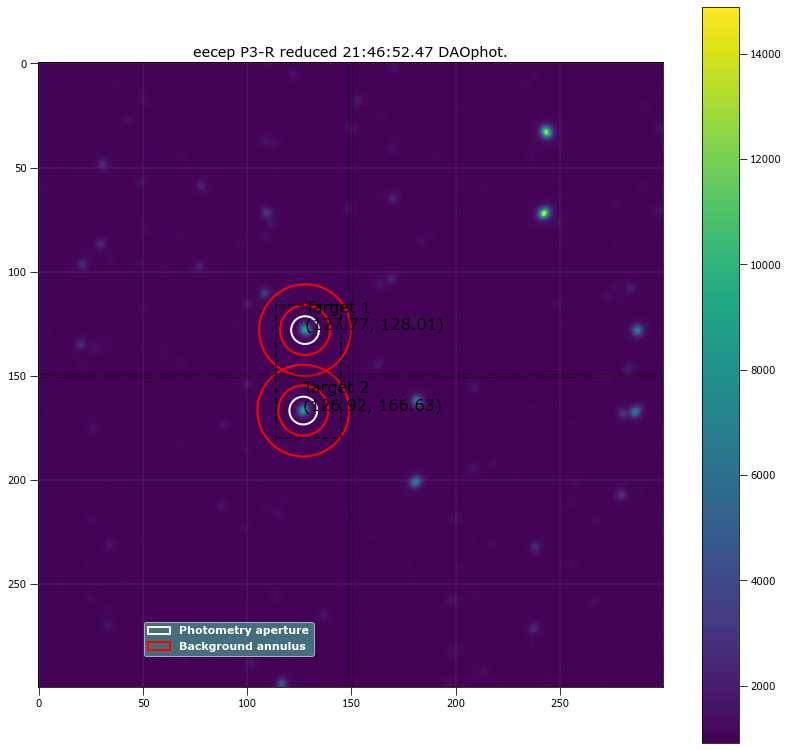

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.77426 128.00641 ...          3389.1852      1119822.4          3429.1509
  2  126.9152 166.63043 ...          3357.5108      1117394.1          3421.6343

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.77426 128.00641 ...                 2941.9742              165776.2
  2  126.9152 166.63043 ...                 2911.2802             161112.53

Write this out the excel
464 21:46:52.47 P3-R 20.0 6.658898305084746 127.77426467627032 128.0064054747851 165776.20274391424 2941.9741904196285 

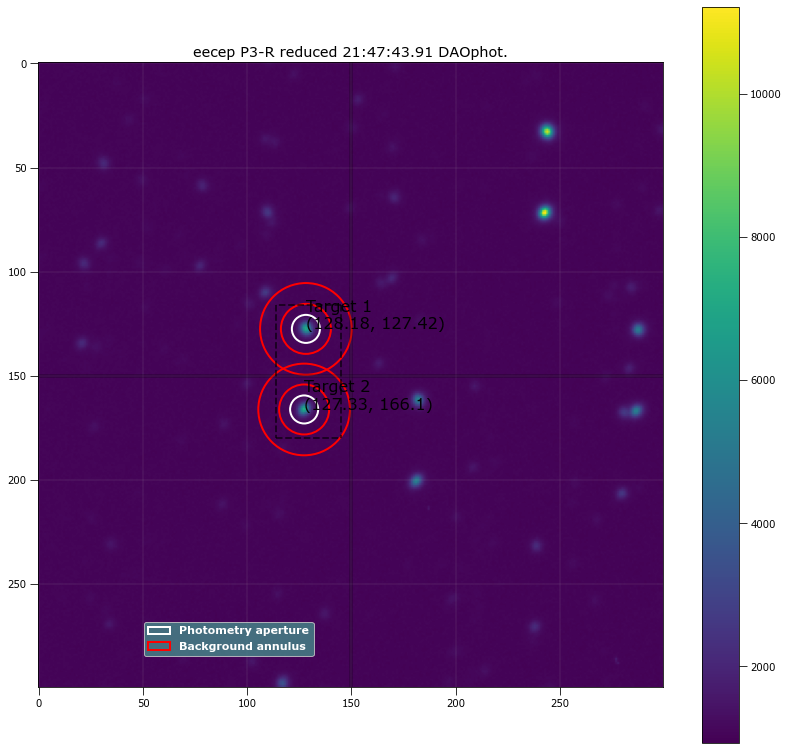

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.18298  127.4209 ...          3107.9171      1119521.6          3427.9121
  2 127.33473 166.10064 ...          3081.0732      1117561.8          3421.4954

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.18298  127.4209 ...                 2650.9132             163241.73
  2 127.33473 166.10064 ...                 2624.9248              158222.3

Write this out the excel
465 21:47:43.91 P3-R 20.0 6.732627118644068 128.18297938895924 127.42090258453267 163241.73385898554 2650.913194528746 1

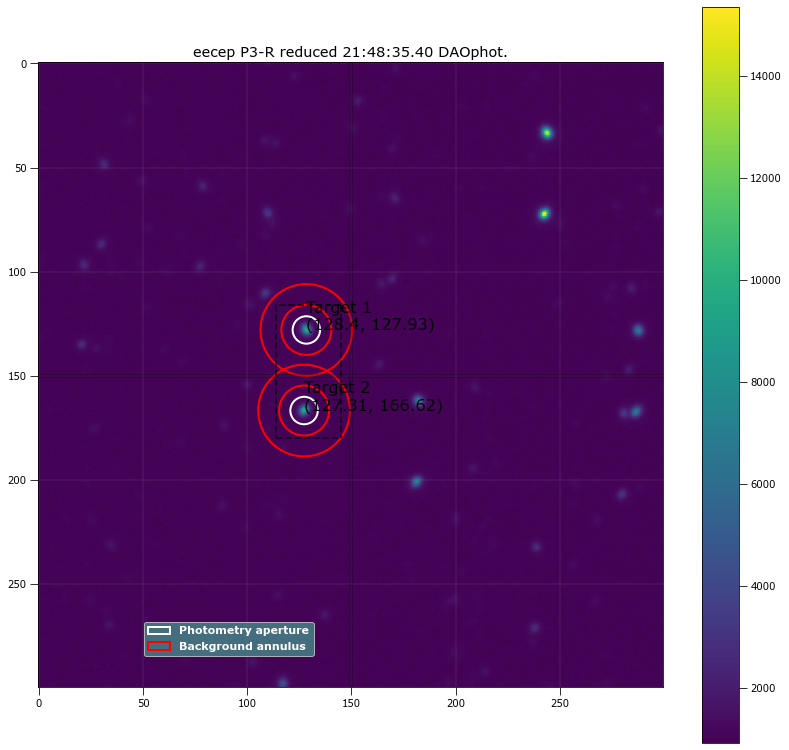

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.39719 127.93162 ...          3475.7239      1119651.8          3428.6258
  2 127.30851 166.61593 ...           3426.558      1120113.8          3430.2332

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.39719 127.93162 ...                 3038.4283             166464.12
  2 127.30851 166.61593 ...                 2989.0574             161264.32

Write this out the excel
466 21:48:35.40 P3-R 20.0 6.5851694915254235 128.39718948144585 127.93161792138906 166464.12205689357 3038.428271317645

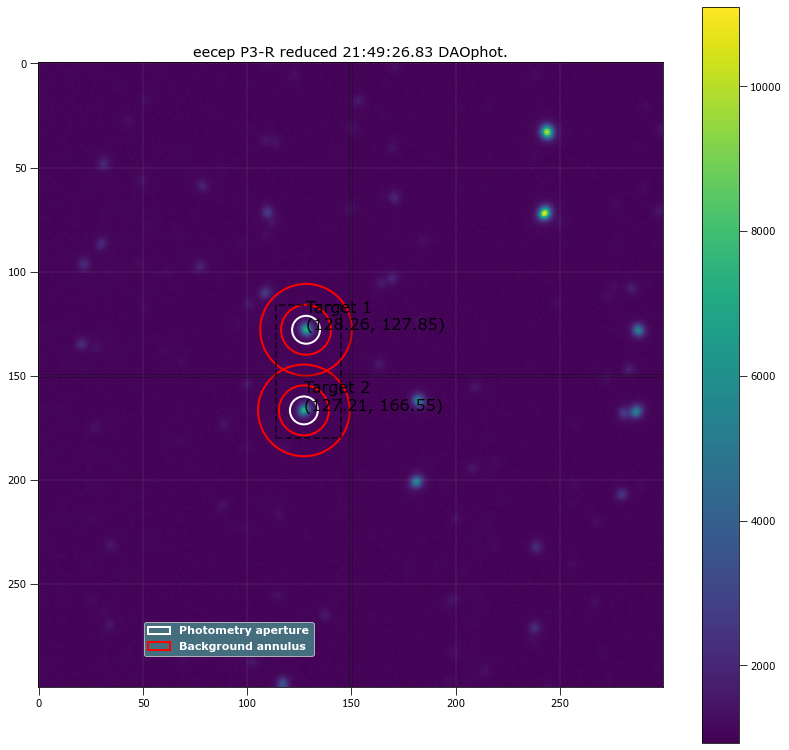

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.25855 127.84568 ...          3139.3647      1117740.8          3422.2114
  2 127.21382 166.54521 ...          3104.2793      1117672.3          3421.7331

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.25855 127.84568 ...                 2688.1034             164277.49
  2 127.21382 166.54521 ...                 2653.0811             159028.92

Write this out the excel
467 21:49:26.83 P3-R 20.0 6.695762711864407 128.25855051229672 127.84567718125446 164277.49138831167 2688.1034411364094

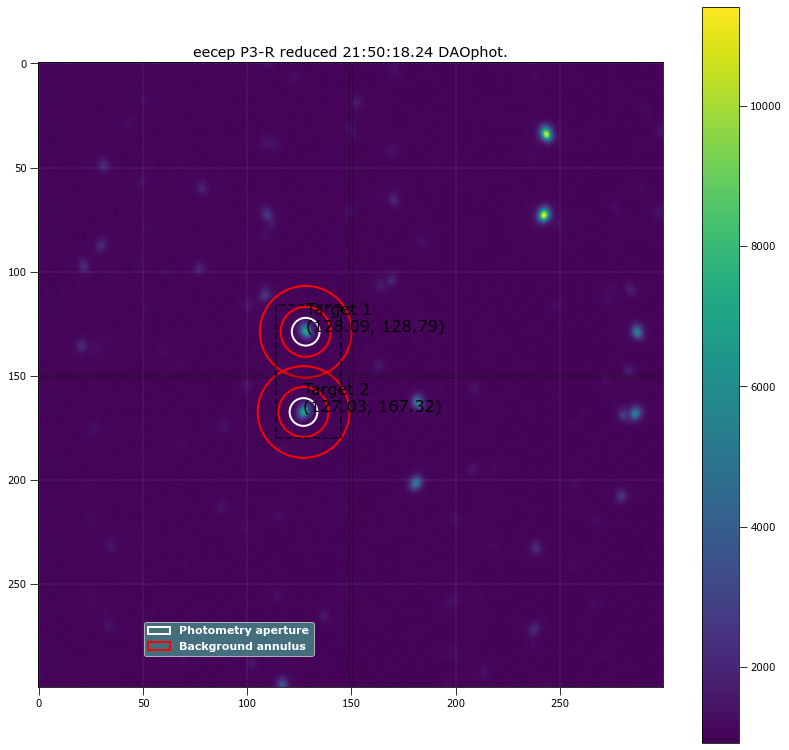

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.08694 128.78869 ...          3138.4606      1115273.2           3414.821
  2 127.02739 167.31884 ...          3086.7893      1115714.8          3416.0637

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.08694 128.78869 ...                 2693.1184             163823.96
  2 127.02739 167.31884 ...                 2641.2851             158355.82

Write this out the excel
468 21:50:18.24 P3-R 20.0 6.658898305084746 128.0869400121237 128.78869100055317 163823.95817529576 2693.118415335131 1

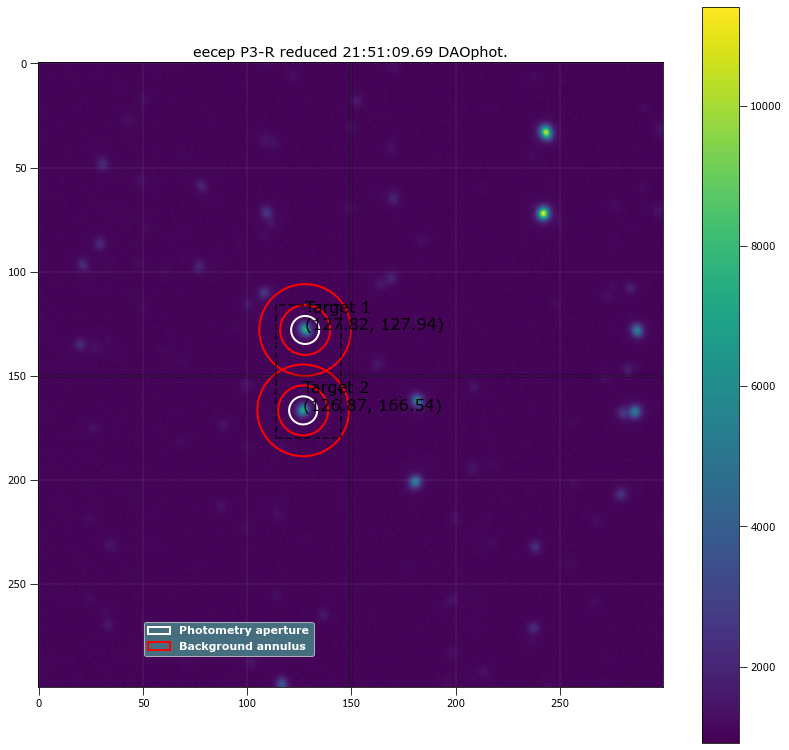

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.8194 127.93904 ...          3163.8341      1111136.8          3402.1641
  2 126.86815 166.53895 ...          3116.0296      1112281.9          3405.4727

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.8194 127.93904 ...                 2710.2629             165598.48
  2 126.86815 166.53895 ...                 2662.0174              161209.2

Write this out the excel
469 21:51:09.69 P3-R 20.0 6.732627118644068 127.8194016241587 127.93904358236988 165598.4788093297 2710.262948589776 126

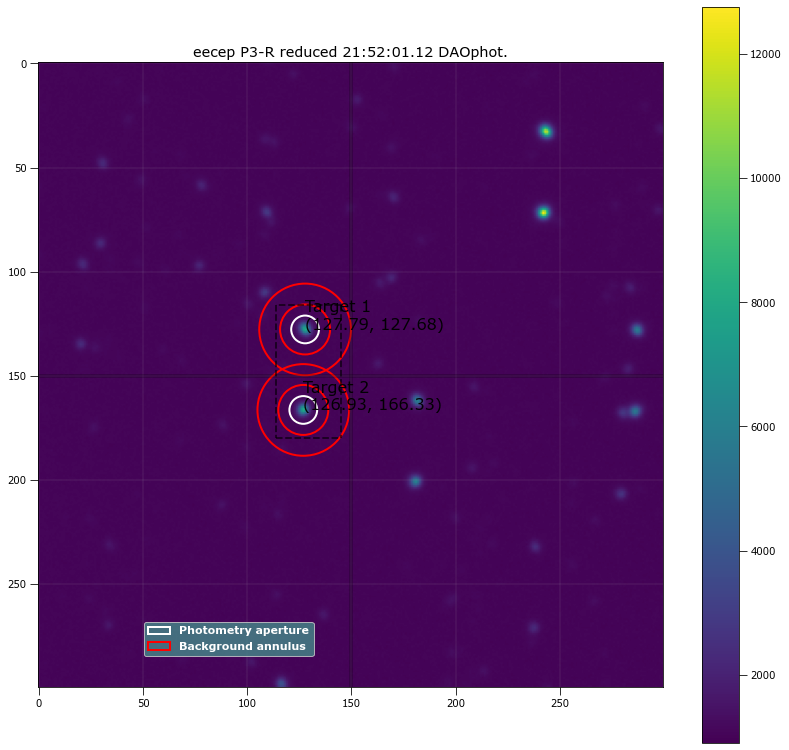

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.78848 127.68444 ...          3245.1063      1107270.6          3390.3656
  2 126.92911 166.33229 ...          3206.9023      1107536.2          3390.9706

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.78848 127.68444 ...                 2802.9535             167735.59
  2 126.92911 166.33229 ...                 2764.6706             162132.87

Write this out the excel
470 21:52:01.12 P3-R 20.0 6.658898305084746 127.78848073266839 127.68443786039157 167735.588746488 2802.953473332953 12

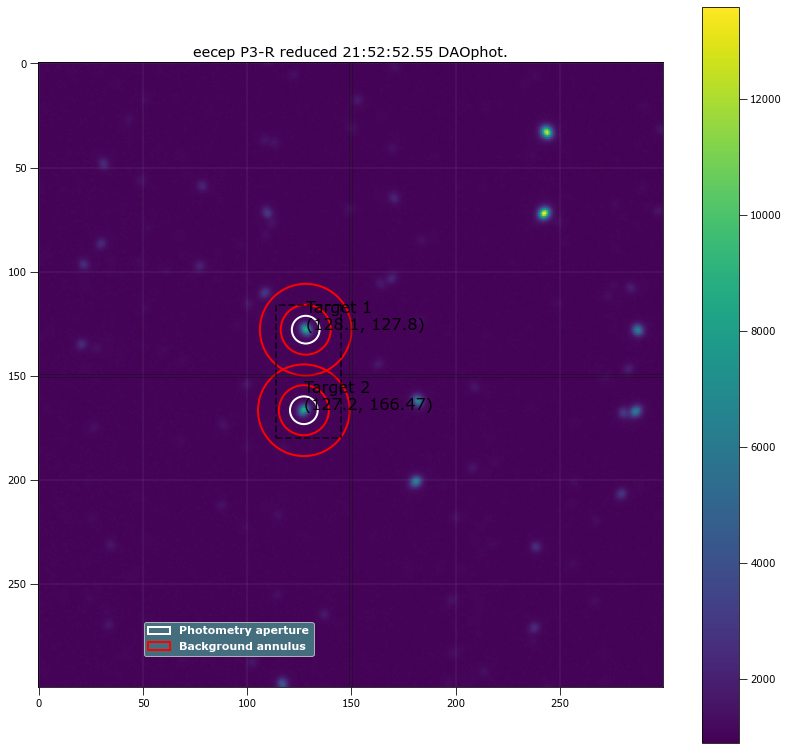

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.09617  127.7996 ...          3365.9968      1103954.8          3380.4826
  2 127.19852 166.47168 ...          3313.3636      1104836.1          3382.9528

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.09617  127.7996 ...                 2925.1329             169549.67
  2 127.19852 166.47168 ...                 2872.1775             163859.48

Write this out the excel
471 21:52:52.55 P3-R 20.0 6.658898305084746 128.09616770634676 127.79959590220297 169549.67060107525 2925.132864574689 

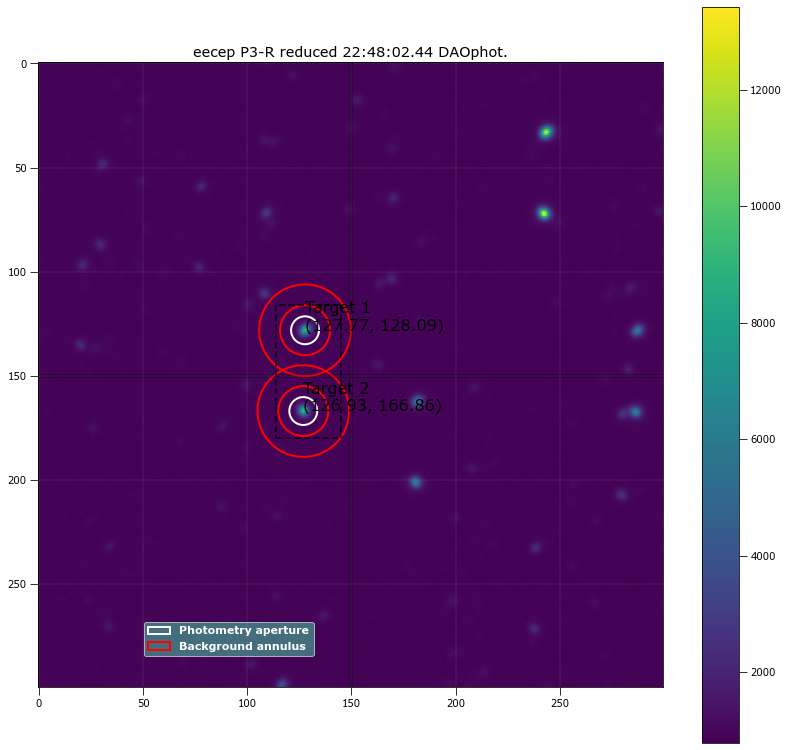

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.7688 128.08648 ...          3347.6086      961271.78          2944.3553
  2 126.92786 166.86079 ...          3297.9272      959341.75          2938.2198

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.7688 128.08648 ...                 2959.3586             179621.12
  2 126.92786 166.86079 ...                 2910.4863             174199.56

Write this out the excel
472 22:48:02.44 P3-R 20.0 6.695762711864406 127.76880438140047 128.08647763967895 179621.11680928635 2959.35864991154 12

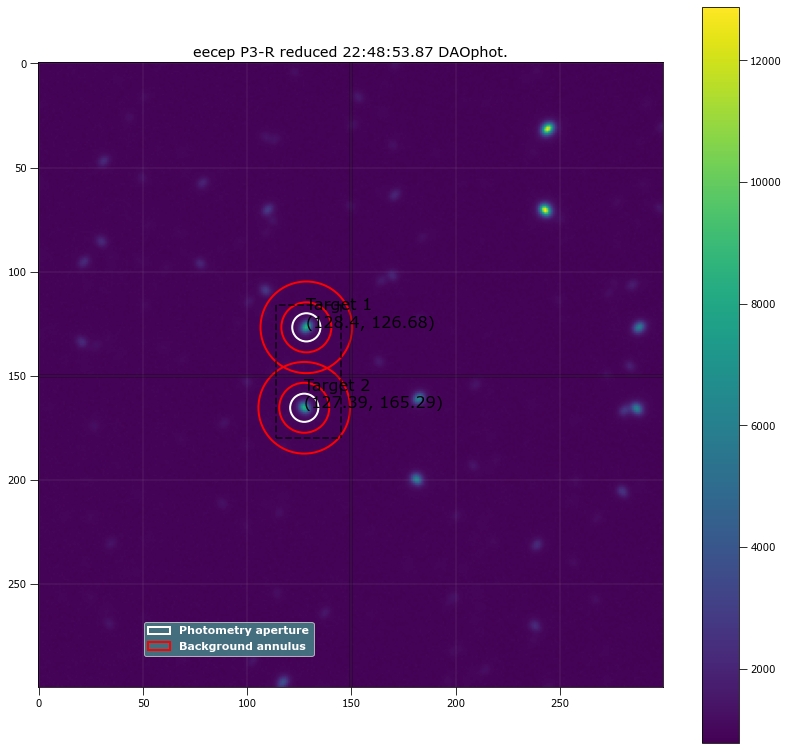

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.39534 126.67837 ...          3295.0055      962602.78          2948.2737
  2 127.39256 165.28869 ...           3225.855      962915.02          2949.1207

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.39534 126.67837 ...                 2897.6301             178114.85
  2 127.39256 165.28869 ...                 2828.3654             172547.14

Write this out the excel
473 22:48:53.87 P3-R 20.0 6.769491525423728 128.39534245480655 126.67837191593956 178114.8480103062 2897.630108971176 1

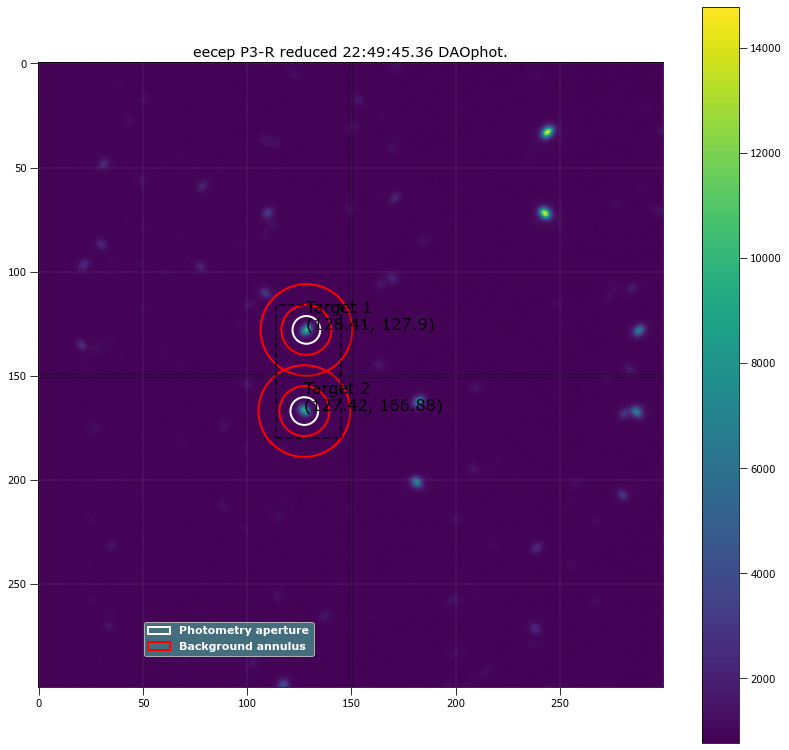

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.41297  127.8991 ...          3526.7323      958878.11          2937.1657
  2 127.41557 166.87757 ...          3421.9908      958798.62          2936.9057

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.41297  127.8991 ...                 3143.6834             181267.52
  2 127.41557 166.87757 ...                 3038.9757             174948.92

Write this out the excel
474 22:49:45.36 P3-R 20.0 6.658898305084746 128.4129673119547 127.89910332912548 181267.52100537444 3143.6833747188716 

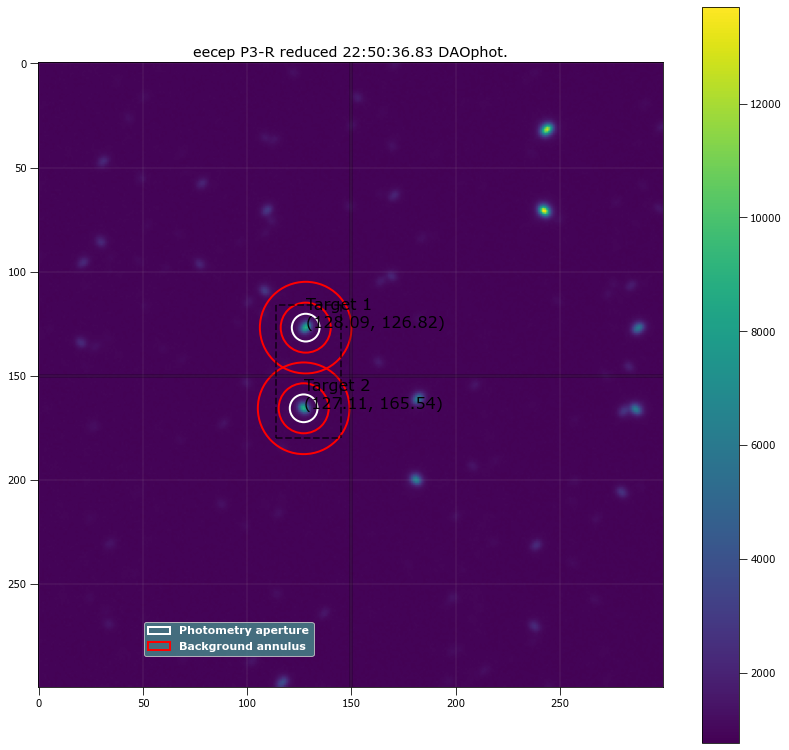

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.08746 126.82118 ...          3335.4762      956399.31          2929.3854
  2 127.11194 165.53887 ...          3276.9076      957908.18          2933.8753

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.08746 126.82118 ...                 2953.4419              179130.1
  2 127.11194 165.53887 ...                 2894.2878             172583.84

Write this out the excel
475 22:50:36.83 P3-R 20.0 6.658898305084746 128.08745992265412 126.8211836661573 179130.0970337055 2953.441869167044 12

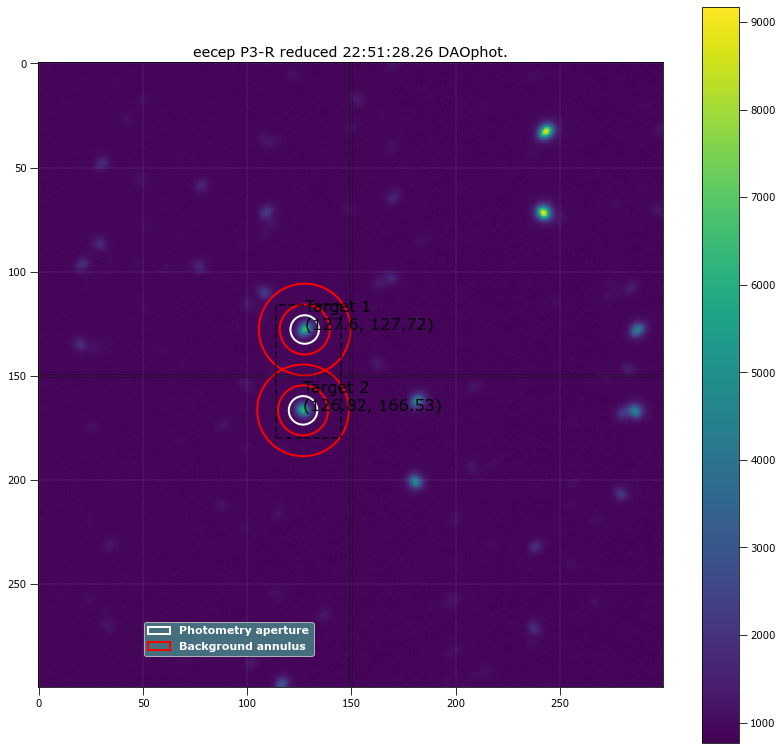

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.59922 127.71616 ...          2974.3352      953952.01          2921.6493
  2 126.81697 166.52848 ...          2897.8587      952057.37          2915.3205

 Aperture are: 147.1197303021624 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.59922 127.71616 ...                 2571.9239             174310.85
  2 126.81697 166.52848 ...                 2496.3191             168263.09

Write this out the excel
476 22:51:28.26 P3-R 20.0 6.84322033898305 127.59922049382084 127.71615902591996 174310.8544864973 2571.923850721577 126

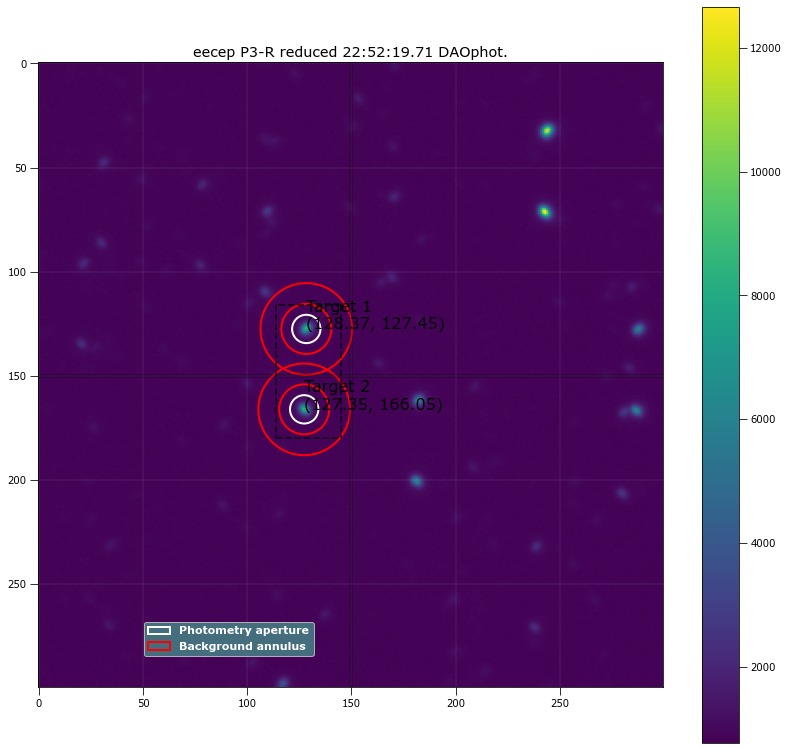

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.37496 127.45409 ...          3246.5084      952317.77           2916.993
  2 127.35402  166.0462 ...          3198.9597         949493          2908.0091

 Aperture are: 145.53893261452635 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.37496 127.45409 ...                 2849.0554             177054.83
  2 127.35402  166.0462 ...                 2802.7308             171576.29

Write this out the excel
477 22:52:19.71 P3-R 20.0 6.806355932203389 128.37496383172805 127.45409160049346 177054.83114153807 2849.0553981783 12

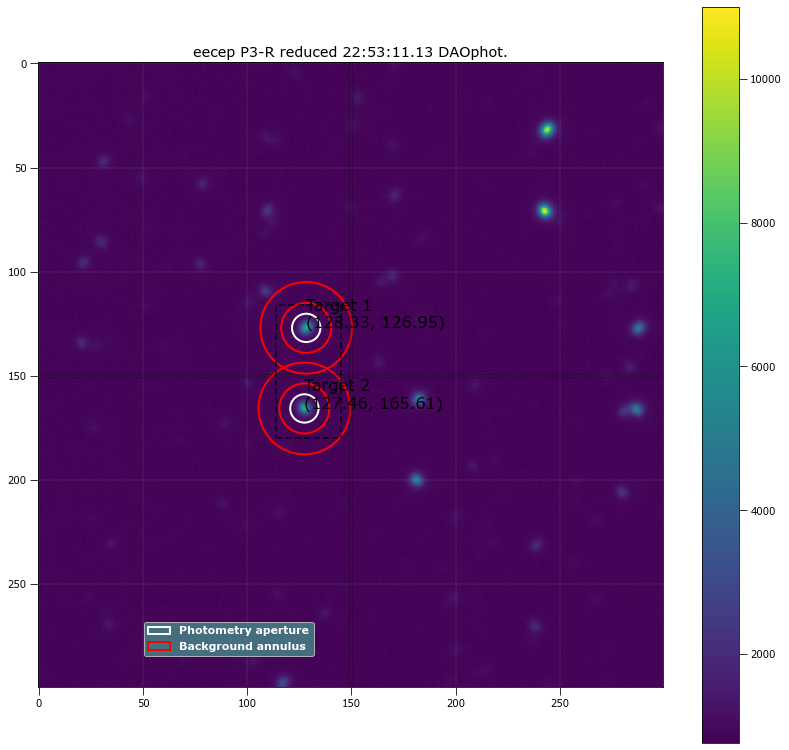

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.32936 126.94705 ...          3052.3513       951744.7          2914.7826
  2  127.4565 165.61244 ...          3026.8817      949694.18          2908.3096

 Aperture are: 145.5389326145264 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.32936 126.94705 ...                 2655.1995             174273.87
  2  127.4565 165.61244 ...                 2630.6118             169268.87

Write this out the excel
478 22:53:11.13 P3-R 20.0 6.80635593220339 128.3293580437107 126.94704502366406 174273.8677484676 2655.1994996567255 127

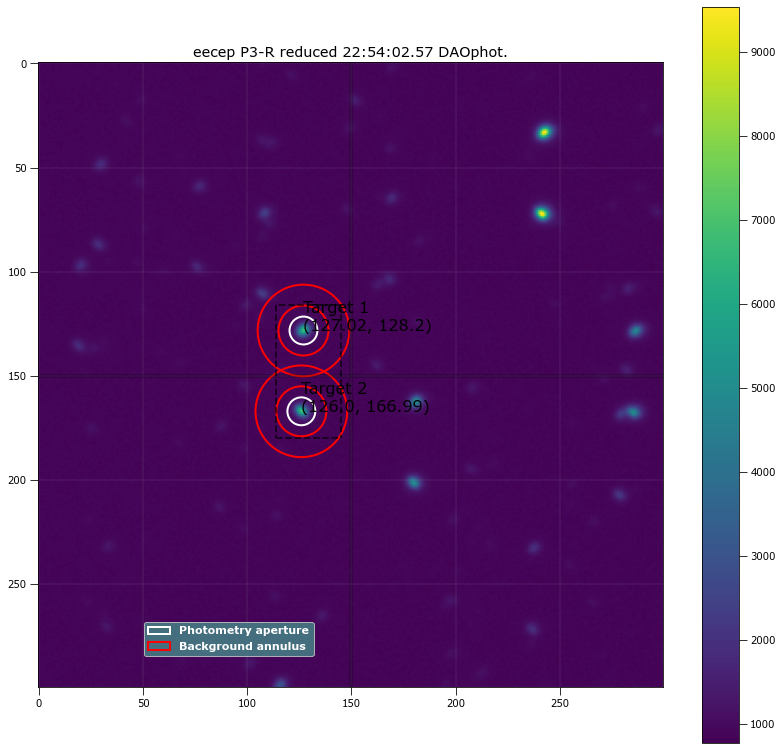

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.01947 128.19909 ...          3016.9226      947244.49          2901.1102
  2 126.00079 166.98704 ...          2979.7773      944306.04          2891.6072

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.01947 128.19909 ...                 2634.3751             174192.47
  2 126.00079 166.98704 ...                 2598.4829             169913.97

Write this out the excel
479 22:54:02.57 P3-R 20.0 6.695762711864407 127.01947348294851 128.1990929373926 174192.46972743317 2634.3750693820925 

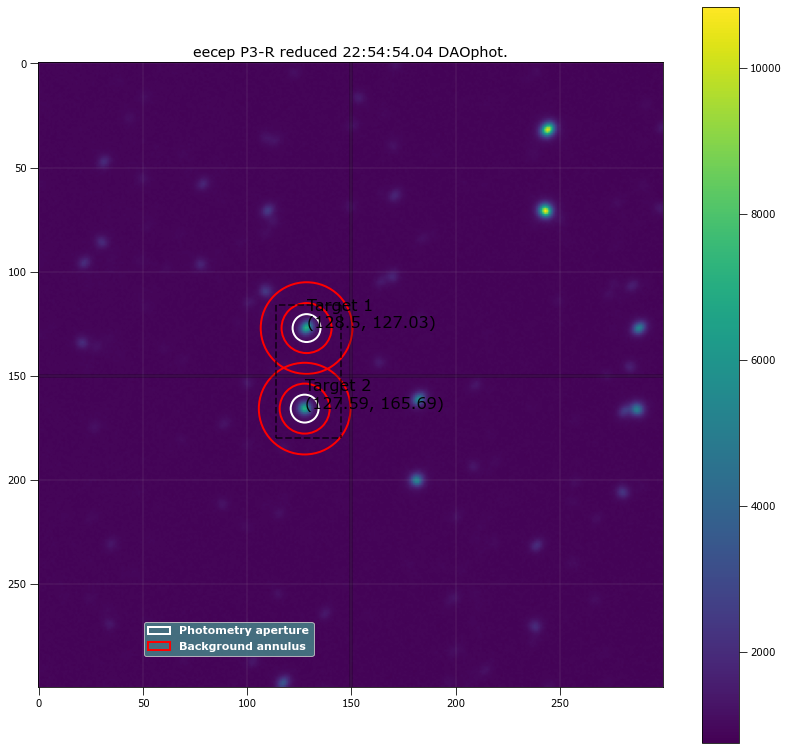

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  128.4984 127.03174 ...          3071.2819      942467.45          2886.4066
  2 127.58945 165.69239 ...           3006.189      941251.19          2882.4072

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  128.4984 127.03174 ...                 2690.6732             176284.07
  2 127.58945 165.69239 ...                 2626.1077             170631.56

Write this out the excel
480 22:54:54.04 P3-R 20.0 6.695762711864407 128.49840077340048 127.03173965836459 176284.06755102574 2690.673242900824 

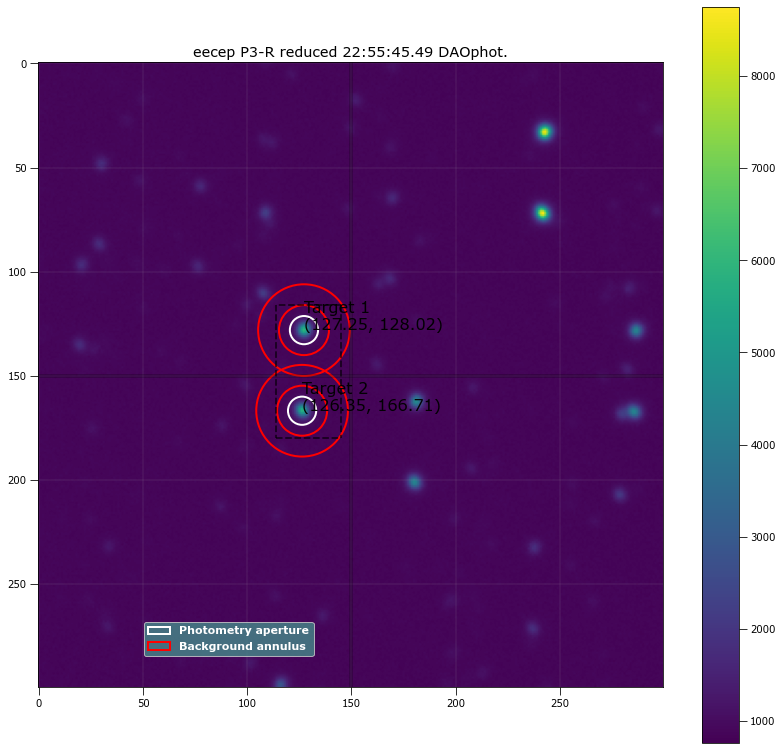

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.25418 128.01561 ...          2921.0314      943155.97          2888.4526
  2 126.35272  166.7071 ...          2849.6481      940459.91          2879.7464

 Aperture are: 143.96667367825307 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.25418 128.01561 ...                 2531.7189             174058.46
  2 126.35272  166.7071 ...                  2461.509              168592.3

Write this out the excel
481 22:55:45.49 P3-R 20.0 6.769491525423728 127.25418238333624 128.01560647809762 174058.4596293468 2531.718867206111 1

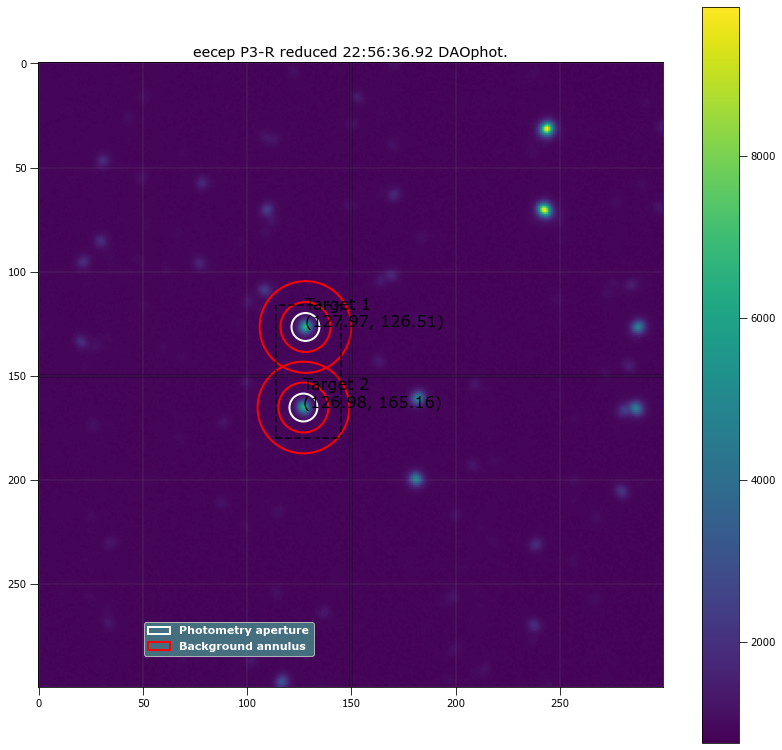

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.96678 126.51166 ...          2996.9655      944290.99          2892.1789
  2 126.97902 165.16437 ...          2909.5272      940522.49          2880.0065

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.96678 126.51166 ...                 2615.5956             174182.19
  2 126.97902 165.16437 ...                 2529.7624             168354.51

Write this out the excel
482 22:56:36.92 P3-R 20.0 6.695762711864407 127.9667812160995 126.51166484244614 174182.18821774976 2615.5956238250105 

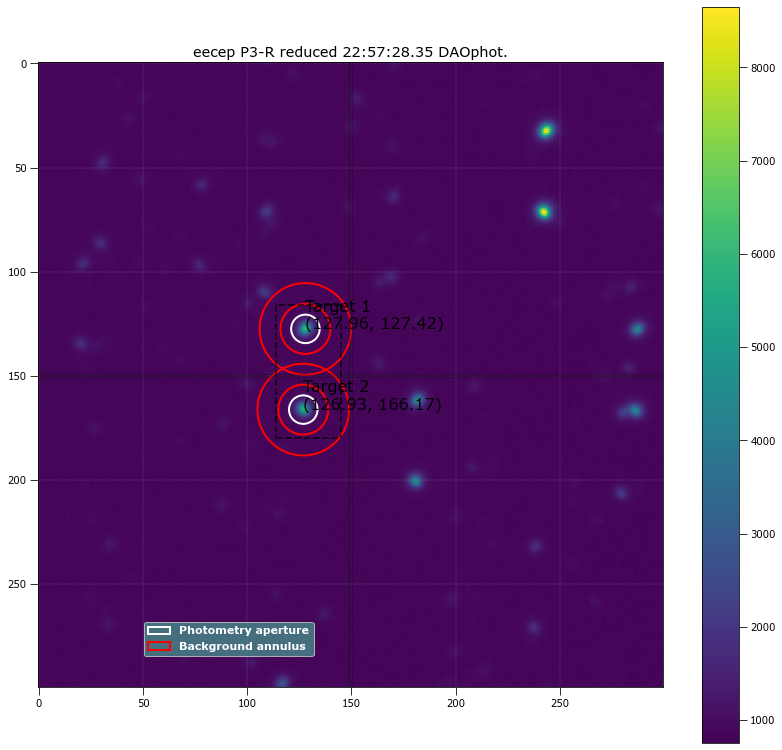

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.95805 127.42443 ...          2865.6279      941899.11          2884.3664
  2 126.92654 166.16782 ...          2809.6985      940165.98          2878.7965

 Aperture are: 147.1197303021624 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.95805 127.42443 ...                 2468.3517             169452.93
  2 126.92654 166.16782 ...                 2413.1895             165189.61

Write this out the excel
483 22:57:28.35 P3-R 20.0 6.84322033898305 127.9580529142125 127.42442679966304 169452.92676033103 2468.351737143651 126

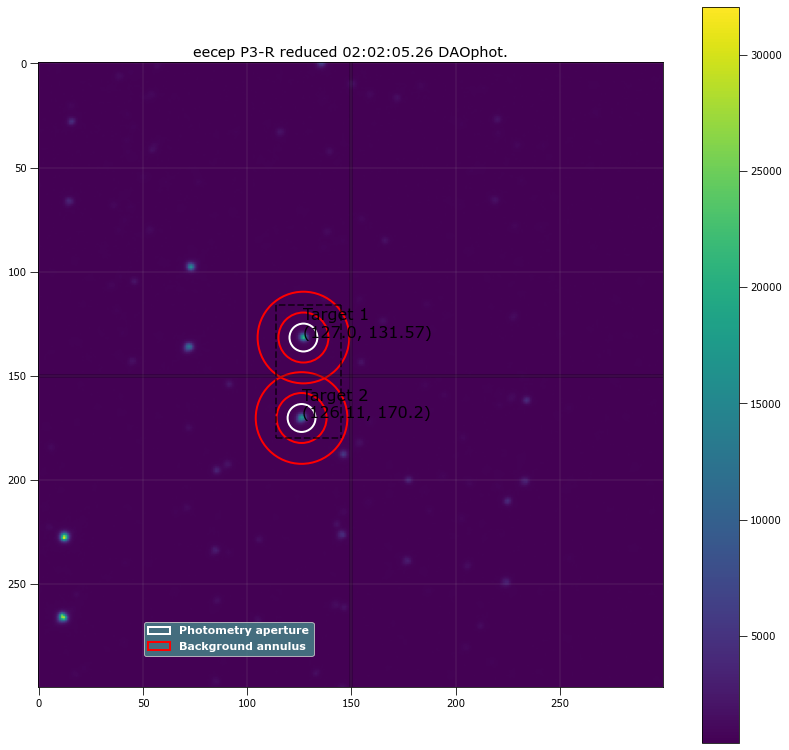

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.00248 131.57013 ...          4897.2032      540008.19          1660.9419
  2 126.10533 170.19958 ...          4440.2158      535935.67           1649.628

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.00248 131.57013 ...                 4678.1873             216588.67
  2 126.10533 170.19958 ...                 4222.6918             211812.85

Write this out the excel
484 02:02:05.26 P3-R 20.0 6.695762711864406 127.00247602819019 131.57013111441233 216588.66828991091 4678.18731974626 12

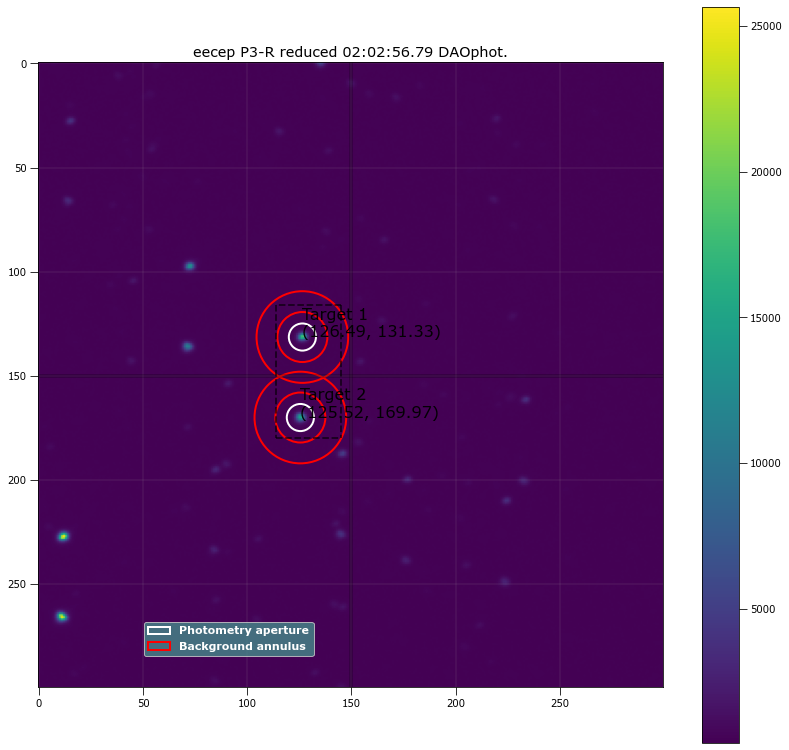

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  126.4945 131.33258 ...          4670.6944      537491.54          1652.1617
  2 125.52332 169.97221 ...          4237.6539      534120.39          1641.9786

 Aperture are: 133.19994616249755 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  126.4945 131.33258 ...                 4464.6657             216335.74
  2 125.52332 169.97221 ...                  4032.895             210998.16

Write this out the excel
485 02:02:56.79 P3-R 20.0 6.511440677966101 126.49450450099526 131.3325751538777 216335.74055136403 4464.665687082369 1

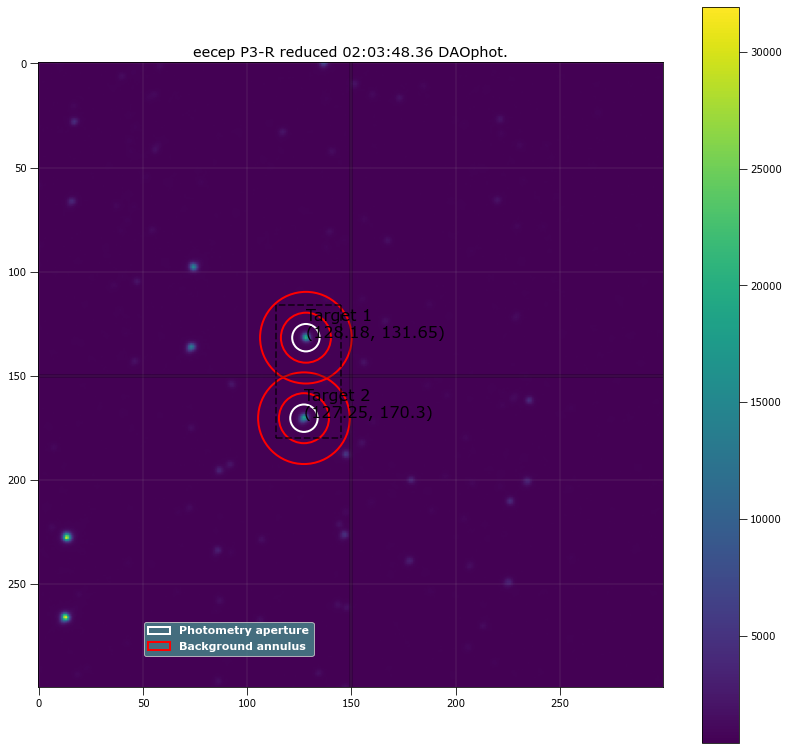

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.18264 131.64661 ...          4858.6548      538412.35           1655.665
  2 127.24871 170.29769 ...          4587.0503      535469.83          1647.8399

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.18264 131.64661 ...                 4647.4872             216849.04
  2 127.24871 170.29769 ...                 4376.8807             212783.41

Write this out the excel
486 02:03:48.36 P3-R 20.0 6.5851694915254235 128.18263626603138 131.64660904365377 216849.03658997873 4647.487153767929

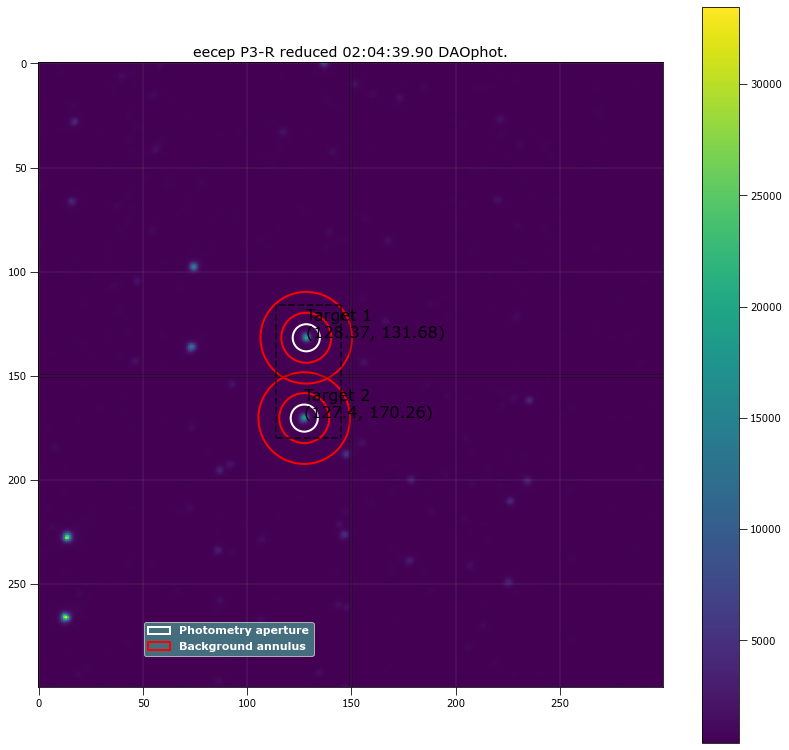

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.36606 131.68134 ...          4918.3991       533717.5          1642.1947
  2 127.39915 170.25649 ...          4612.3349      532388.45          1638.7972

 Aperture are: 133.19994616249755 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.36606 131.68134 ...                 4713.6133              216992.6
  2 127.39915 170.25649 ...                 4407.9728             211707.31

Write this out the excel
487 02:04:39.90 P3-R 20.0 6.511440677966101 128.36606233539246 131.68133971077904 216992.5971204312 4713.613258089949 1

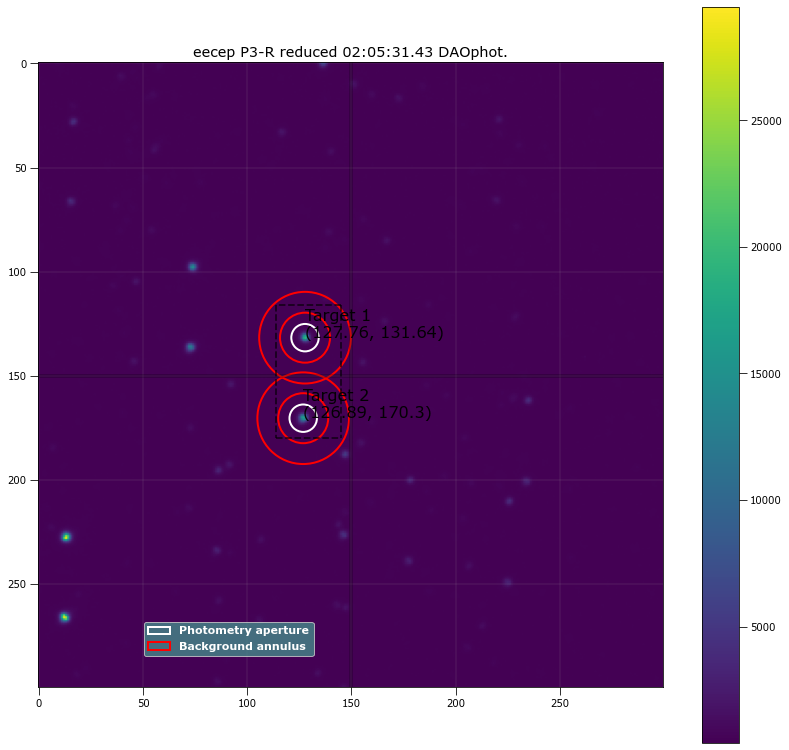

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.75912 131.63958 ...          4776.7479       534497.8           1643.468
  2 126.88877 170.29709 ...          4423.9543       530683.1          1632.9139

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.75912 131.63958 ...                 4567.1358             216223.27
  2 126.88877 170.29709 ...                 4215.6884             211152.58

Write this out the excel
488 02:05:31.43 P3-R 20.0 6.5851694915254235 127.75911936983856 131.63958442082173 216223.2695328205 4567.13584864767 1

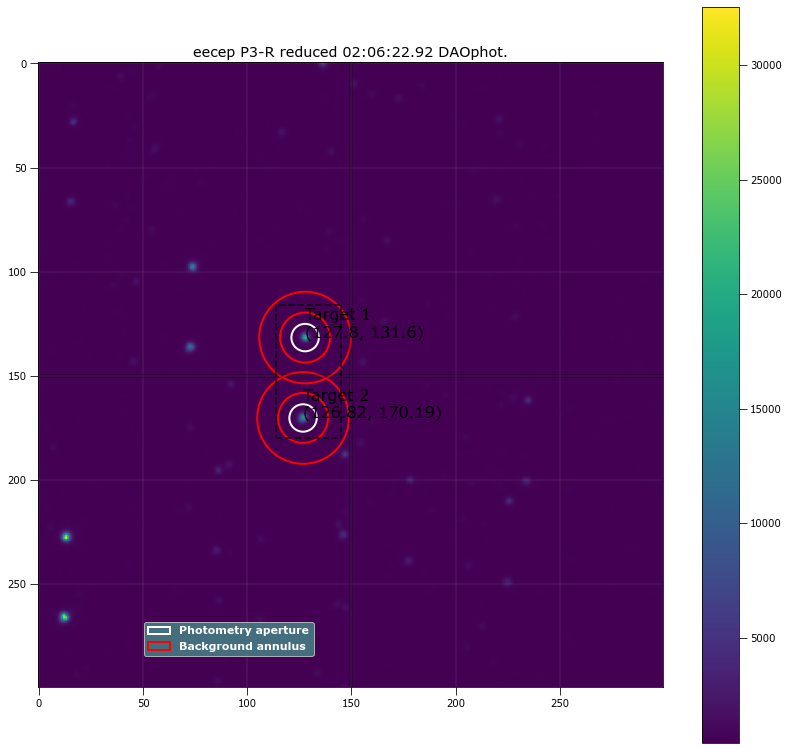

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.80394 131.59542 ...          4906.1766      534811.58          1645.6951
  2 126.82168 170.19141 ...          4426.6165      532272.45          1638.2043

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.80394 131.59542 ...                 4696.2805             216340.01
  2 126.82168 170.19141 ...                 4217.6758             211644.99

Write this out the excel
489 02:06:22.92 P3-R 20.0 6.5851694915254235 127.8039350887482 131.59541678089352 216340.00832776562 4696.280502354987 

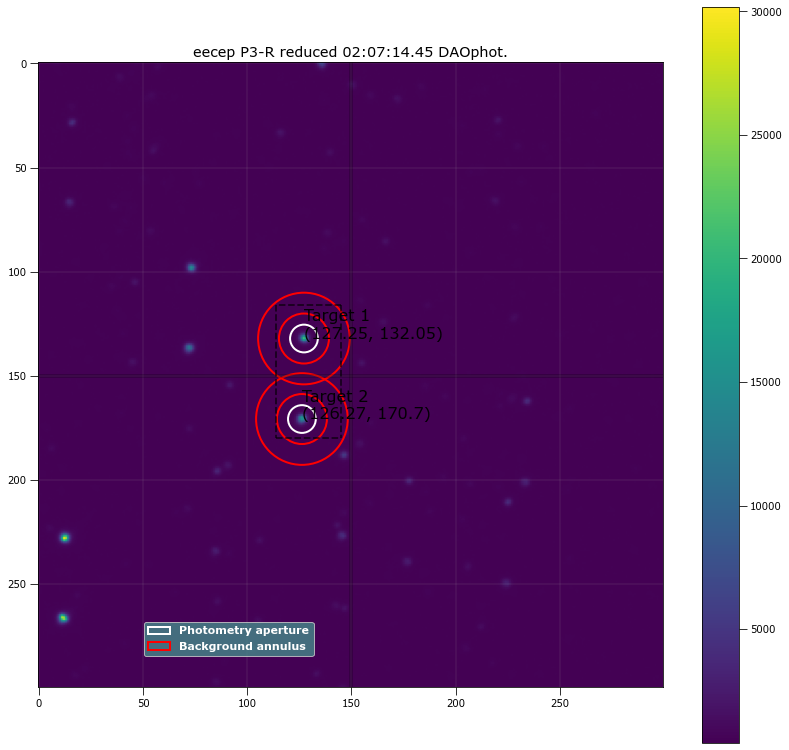

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.24923 132.04501 ...           4858.158      533432.94          1640.6853
  2 126.26899 170.69518 ...          4359.4289      530923.13          1633.5388

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.24923 132.04501 ...                 4644.1889             217408.64
  2 126.26899 170.69518 ...                 4146.3918             211554.95

Write this out the excel
490 02:07:14.45 P3-R 20.0 6.658898305084746 127.24922561116048 132.04501010428768 217408.64130702944 4644.188899504681 

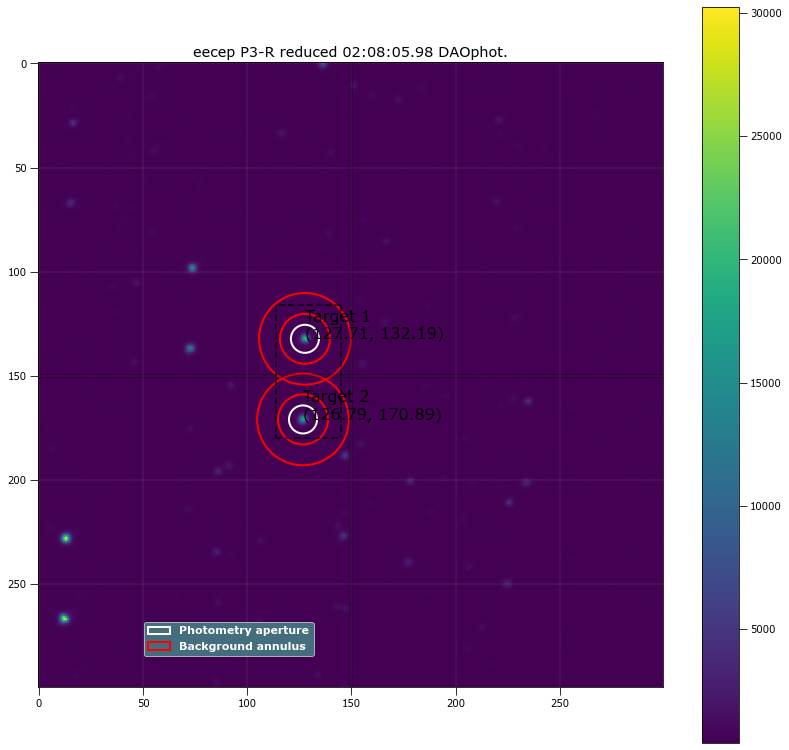

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.71167 132.19021 ...          4847.0449      532668.64          1638.1989
  2 126.79201 170.89159 ...          4462.0315      529587.18          1629.9128

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.71167 132.19021 ...                 4628.6428             217274.71
  2 126.79201 170.89159 ...                  4244.734             212895.91

Write this out the excel
491 02:08:05.98 P3-R 20.0 6.732627118644068 127.7116712373008 132.1902135927698 217274.71373199328 4628.642769148983 126

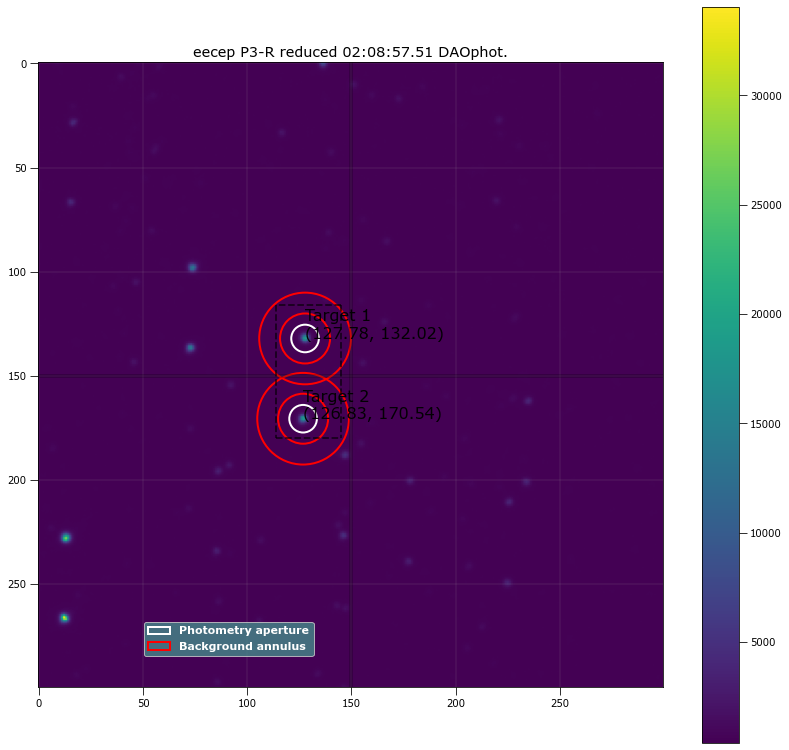

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1  127.7758 132.02217 ...          4712.7857      531381.57           1634.652
  2 126.83404  170.5442 ...          4663.5892      527768.79          1624.1857

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1  127.7758 132.02217 ...                 4501.9573             217432.33
  2 126.83404  170.5442 ...                 4454.1107             211641.62

Write this out the excel
492 02:08:57.51 P3-R 20.0 6.622033898305084 127.77579924149332 132.02216812822286 217432.33451916234 4501.957266595039 

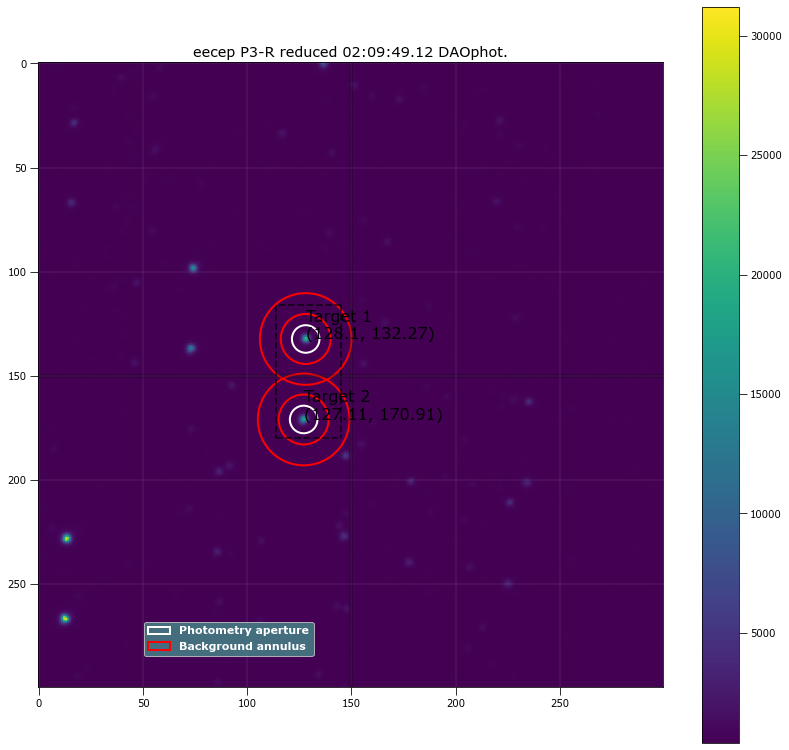

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 128.09596 132.26669 ...          4987.3376      530118.58          1631.1433
  2 127.11175  170.9116 ...          4645.5231       527225.2          1622.8318

 Aperture are: 137.76302544678762 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 128.09596 132.26669 ...                 4776.9617             218318.01
  2 127.11175  170.9116 ...                 4436.2191             214115.61

Write this out the excel
493 02:09:49.12 P3-R 20.0 6.622033898305084 128.09596247293044 132.26669355759165 218318.00959444477 4776.961707094084 

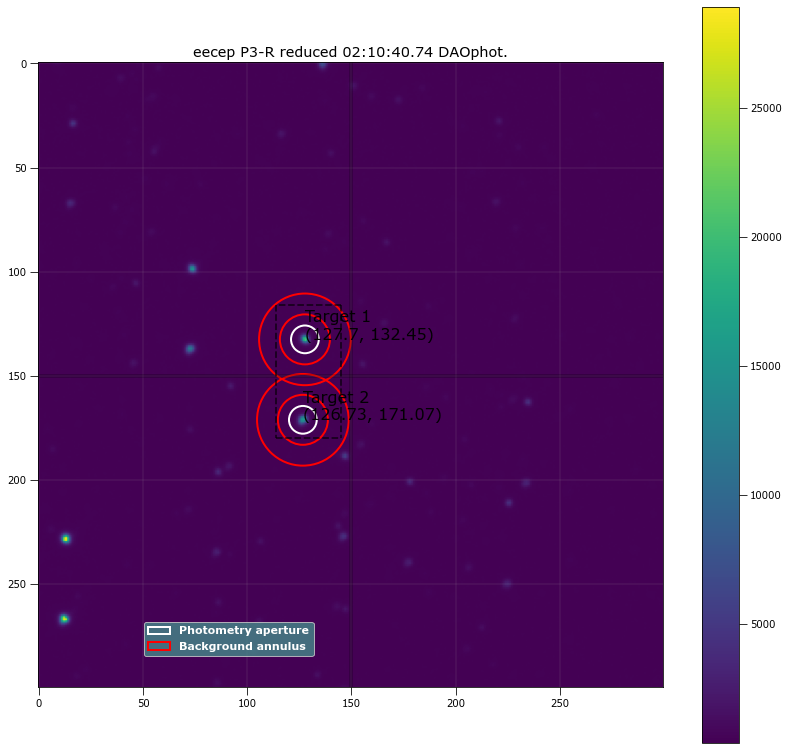

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 127.70279  132.4525 ...          4929.3198      528190.24          1624.7824
  2 126.73028 171.06915 ...          4389.4098       524869.9          1615.2233

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 127.70279  132.4525 ...                 4717.4247             218041.17
  2 126.73028 171.06915 ...                 4178.7613             212710.34

Write this out the excel
494 02:10:40.74 P3-R 20.0 6.658898305084746 127.70279396007398 132.45250190623653 218041.16768857275 4717.424674601635 

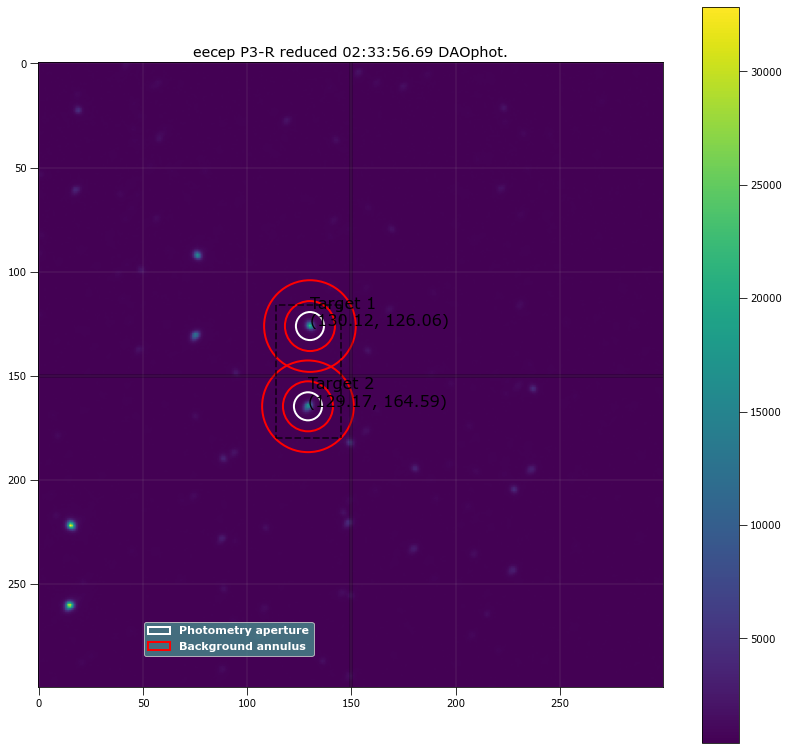

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.11778 126.06252 ...          4984.7198      543544.82          1672.6272
  2 129.16677 164.58714 ...           4488.386      539393.45          1659.4776

 Aperture are: 142.4029534933426 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.11778 126.06252 ...                 4761.7278             219901.64
  2 129.16677 164.58714 ...                  4267.147             213944.07

Write this out the excel
495 02:33:56.69 P3-R 20.0 6.732627118644068 130.11778423465506 126.06251982288745 219901.6426076468 4761.727776747677 12

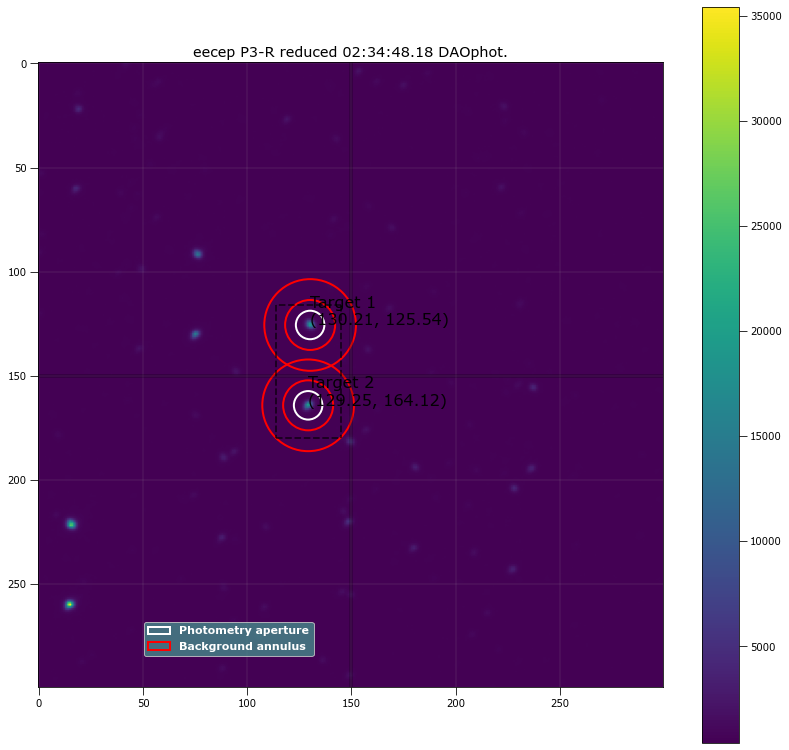

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.20853 125.54439 ...          4769.6745      551161.29          1695.9128
  2 129.25217 164.11592 ...          4679.0967      547349.19           1684.411

 Aperture are: 147.1197303021624 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.20853 125.54439 ...                 4536.0891             221337.94
  2 129.25217 164.11592 ...                 4447.0955             215375.88

Write this out the excel
496 02:34:48.18 P3-R 20.0 6.84322033898305 130.20852506632022 125.54439240448541 221337.93744831896 4536.0890953855405 1

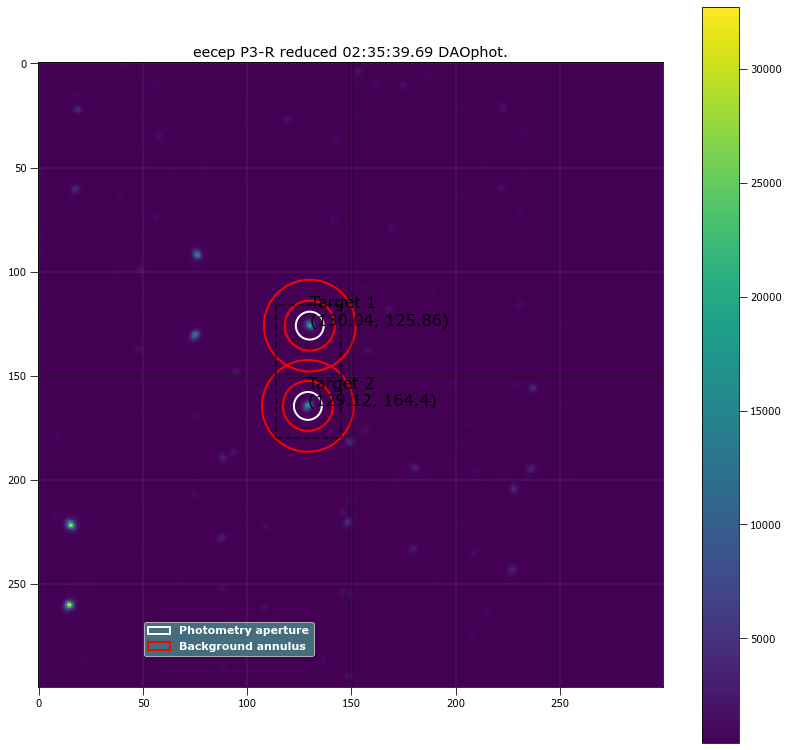

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.04202  125.8584 ...          4955.6802      558008.45          1717.2191
  2  129.1177 164.39968 ...           4588.514      553212.56           1702.051

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.04202  125.8584 ...                 4729.2435             219620.94
  2  129.1177 164.39968 ...                 4364.0774             214625.88

Write this out the excel
497 02:35:39.69 P3-R 20.0 6.695762711864406 130.0420225308195 125.85840223628078 219620.94114103942 4729.2434607508585 1

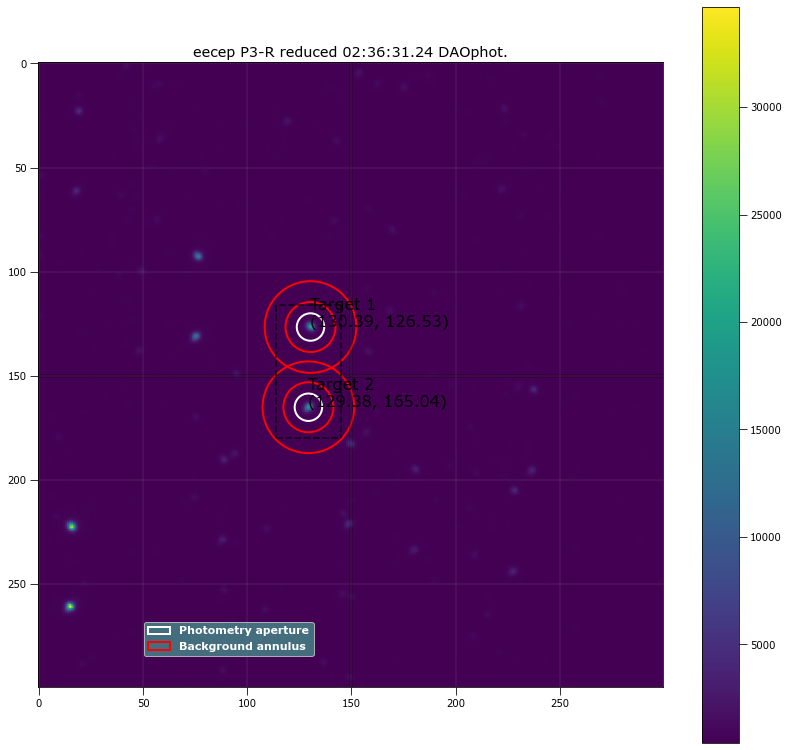

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.38772 126.52992 ...          5029.4817      563608.97          1734.4947
  2 129.37888  165.0353 ...          4719.2821      559724.71          1722.0827

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.38772 126.52992 ...                 4808.2599             221094.38
  2 129.37888  165.0353 ...                 4499.6433             215019.46

Write this out the excel
498 02:36:31.24 P3-R 20.0 6.5851694915254235 130.38772369262358 126.52991756227082 221094.3768287389 4808.259865382448 

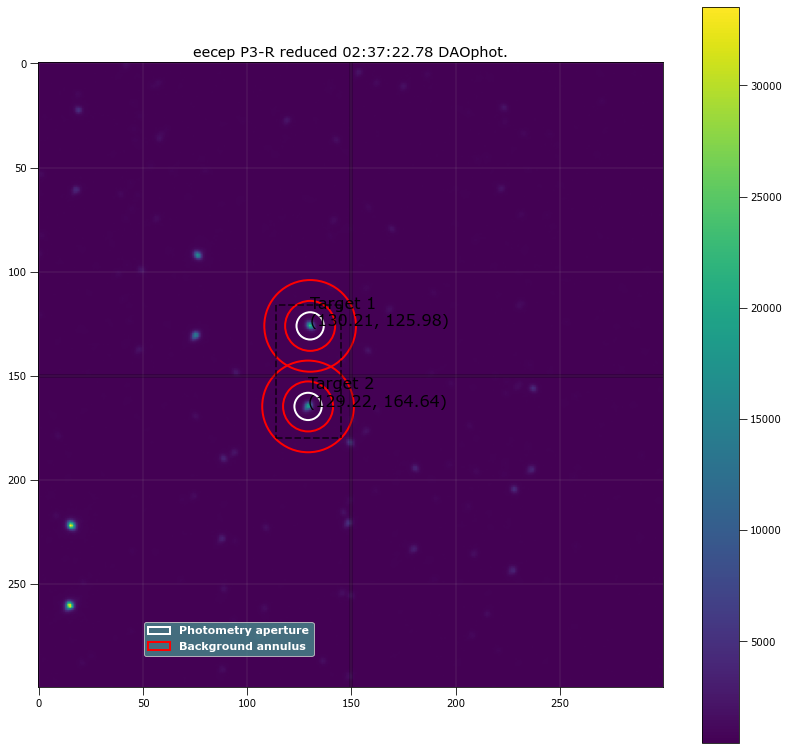

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.21371 125.97579 ...          5205.2386      573022.05          1763.5477
  2 129.21599 164.64295 ...          4847.8059      569615.53          1753.5131

 Aperture are: 134.71243383923147 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.21371 125.97579 ...                 4982.8225             221647.32
  2 129.21599 164.64295 ...                 4626.6554              215837.9

Write this out the excel
499 02:37:22.78 P3-R 20.0 6.5483050847457624 130.21371334849016 125.97579147244176 221647.31884741038 4982.822535623973

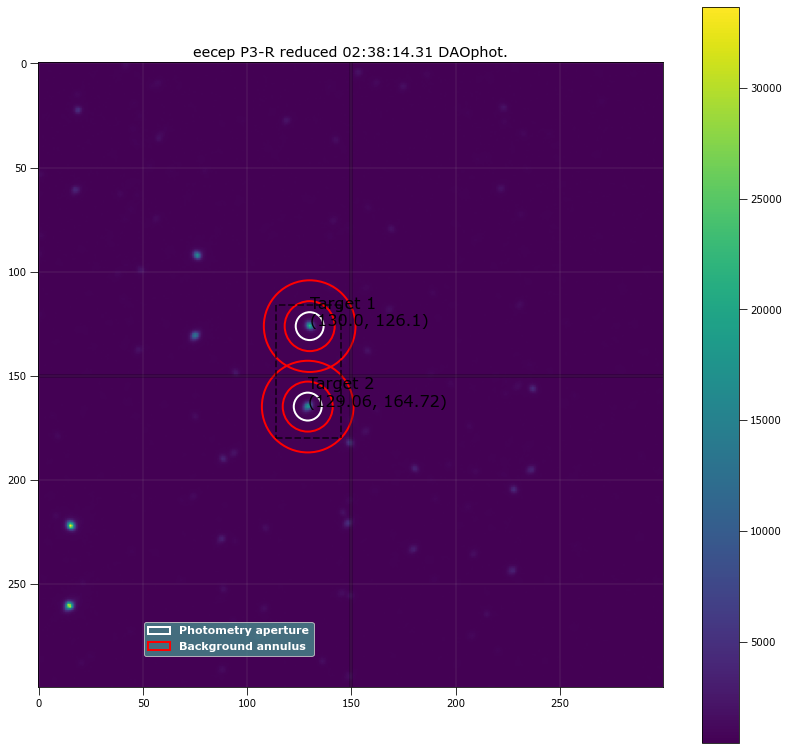

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.99519 126.10066 ...          5059.4176      580646.01           1786.017
  2 129.05718 164.72282 ...          4640.0058       578147.4          1778.2229

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.99519 126.10066 ...                  4823.909             220047.59
  2 129.05718 164.72282 ...                 4405.5249             214552.44

Write this out the excel
500 02:38:14.31 P3-R 20.0 6.695762711864406 129.99519251963173 126.10066360951203 220047.59324885975 4823.9089954423125 

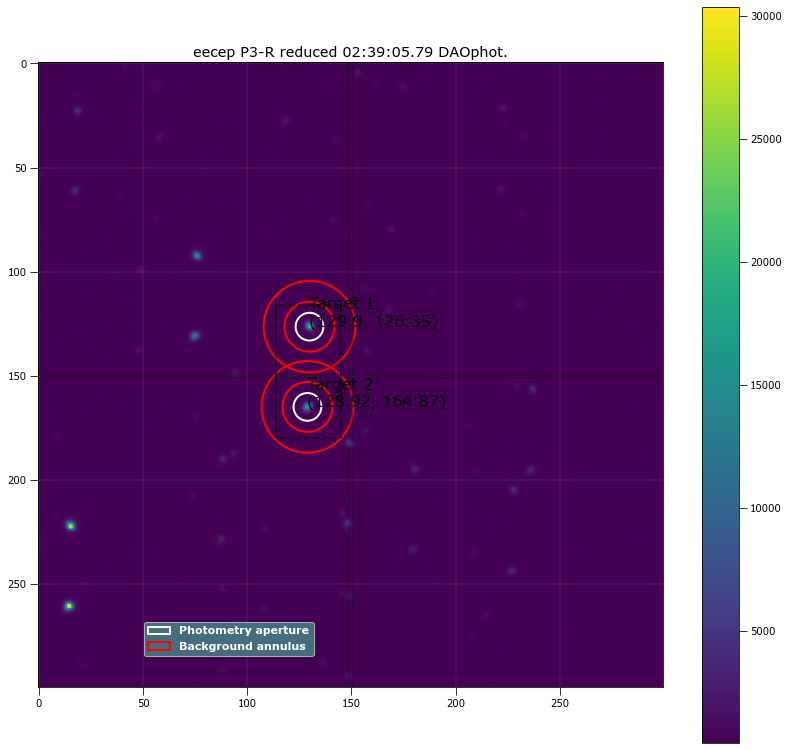

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.90166 126.34907 ...          5042.4802      592636.79          1822.5819
  2 128.91944 164.87148 ...          4623.6031      589822.16          1813.5333

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.90166 126.34907 ...                 4804.7891             221197.99
  2 128.91944 164.87148 ...                 4387.0921             215622.13

Write this out the excel
501 02:39:05.79 P3-R 20.0 6.658898305084746 129.90165740495502 126.34907350474491 221197.98526812508 4804.789081692388 

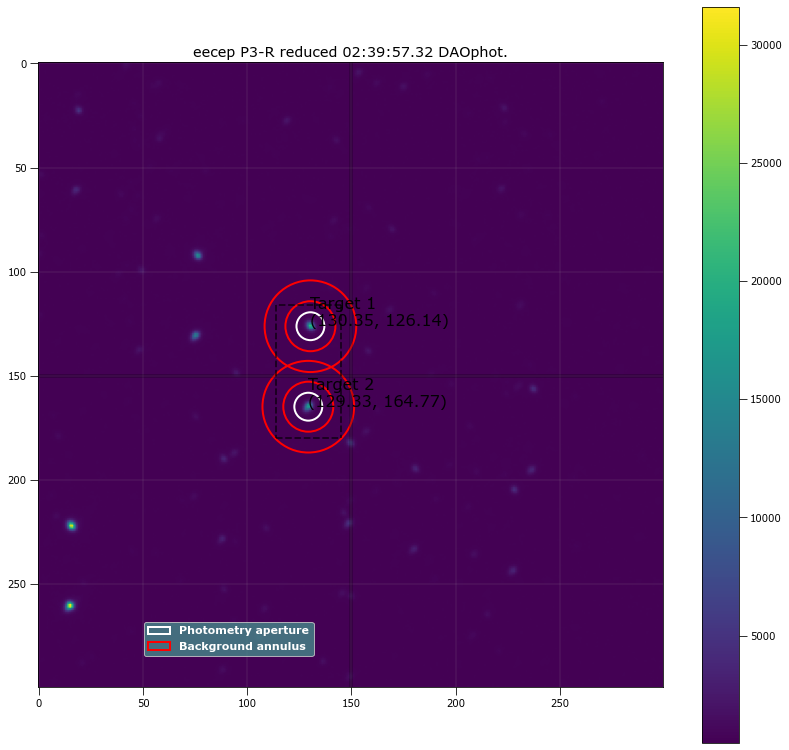

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.35125 126.14181 ...          5029.3799      604651.76          1859.5975
  2  129.3309 164.77074 ...          4646.7724      601999.92          1851.2519

 Aperture are: 140.8477720597948 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.35125 126.14181 ...                 4784.1688             222238.38
  2  129.3309 164.77074 ...                 4402.6618             216222.99

Write this out the excel
502 02:39:57.32 P3-R 20.0 6.695762711864406 130.35124543492742 126.14181253583412 222238.38096745615 4784.168808998589 1

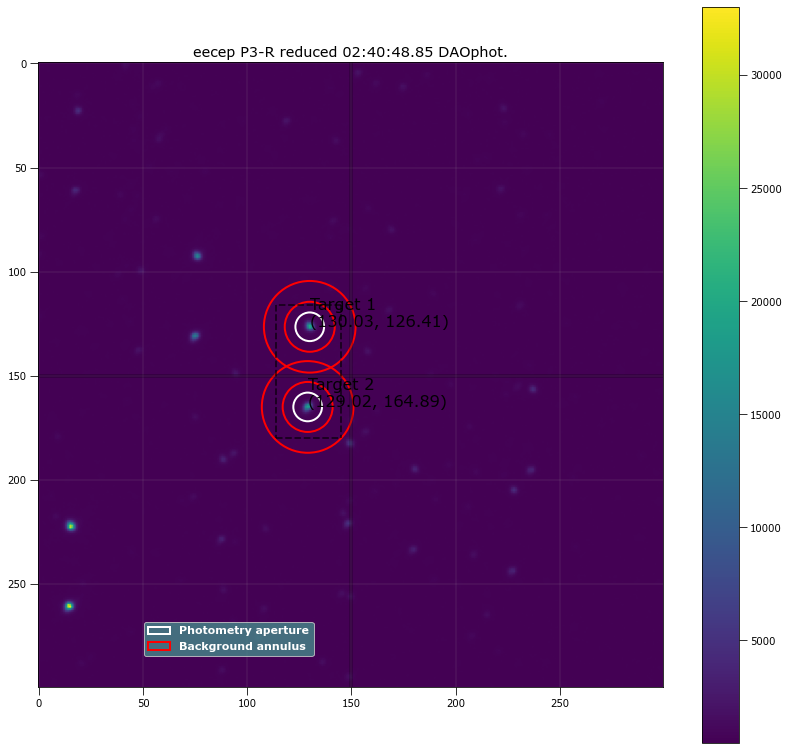

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.02585 126.41008 ...          5034.0542      619202.44          1903.7902
  2  129.0238  164.8909 ...           4786.993      615956.72          1893.5909

 Aperture are: 148.70906674116122 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.02585 126.41008 ...                 4769.0043             222677.92
  2  129.0238  164.8909 ...                  4523.363             217305.21

Write this out the excel
503 02:40:48.85 P3-R 20.0 6.880084745762712 130.02585302184823 126.41008066216078 222677.9150156772 4769.004253701556 1

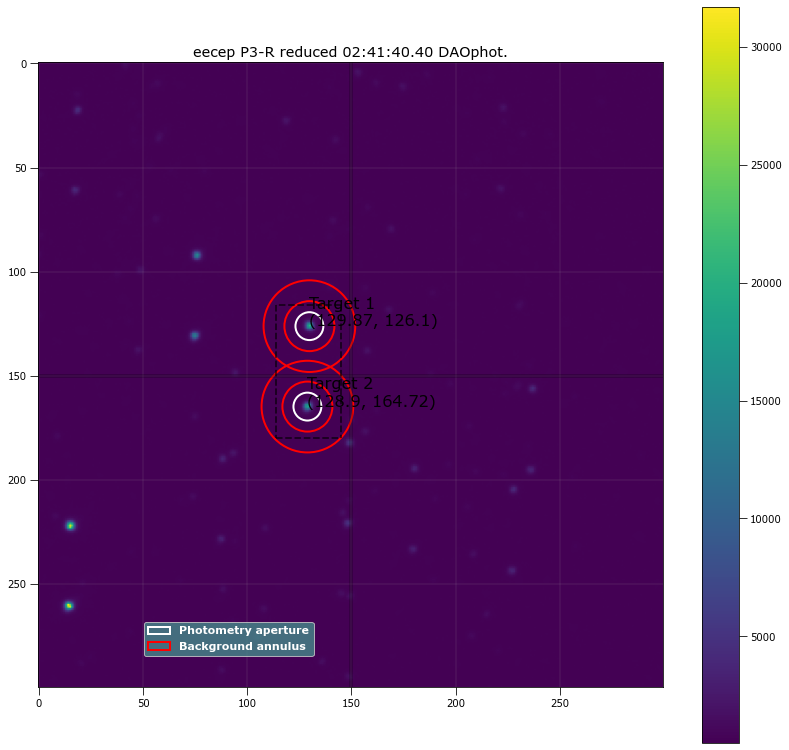

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.86561 126.10418 ...          4937.4031      635090.95          1951.8081
  2 128.90218 164.72372 ...          4703.2822       630235.8          1937.0247

 Aperture are: 140.84777205979486 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.86561 126.10418 ...                 4680.0329              221423.8
  2 128.90218 164.72372 ...                 4447.8613             215684.13

Write this out the excel
504 02:41:40.40 P3-R 20.0 6.695762711864407 129.86561473752775 126.10418335811336 221423.8039480063 4680.032885681228 1

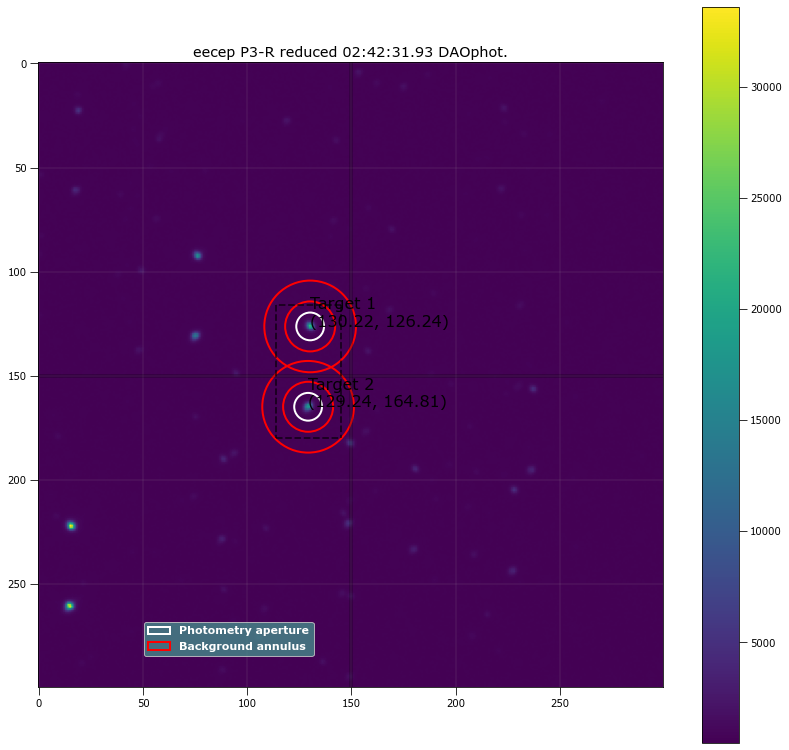

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 130.21865 126.23546 ...          5265.8263      651390.72          2002.3769
  2 129.23909 164.81046 ...          4789.7714      647867.61          1991.4293

 Aperture are: 139.30112937760987 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 130.21865 126.23546 ...                 5004.6873             222891.02
  2 129.23909 164.81046 ...                 4530.0601             216959.47

Write this out the excel
505 02:42:31.93 P3-R 20.0 6.658898305084746 130.21865073858137 126.2354552886272 222891.02360884298 5004.68732880333 12

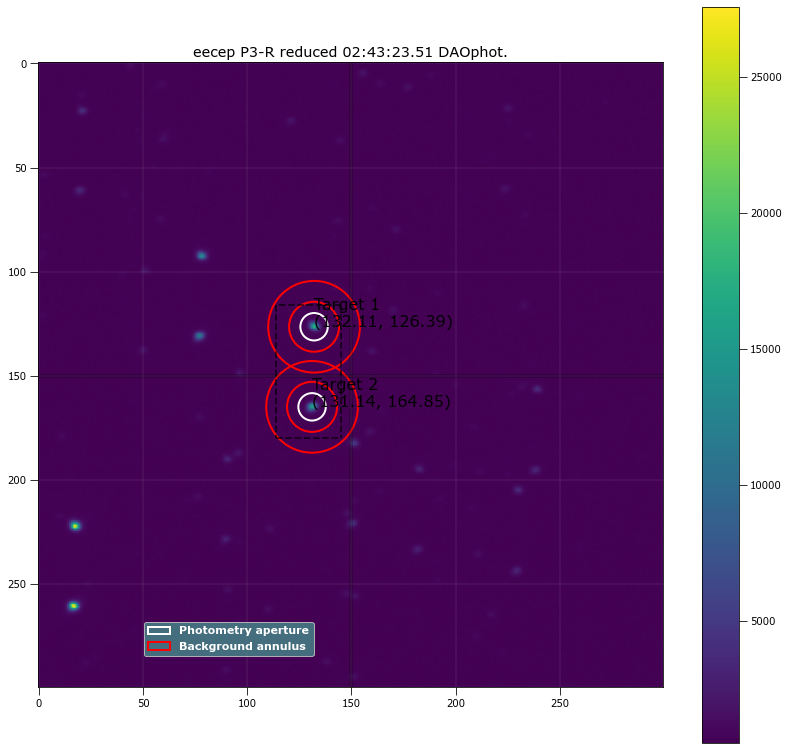

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 132.10626 126.39155 ...          4738.1873      672404.31          2065.1713
  2 131.13967  164.8452 ...           4421.746      668958.31          2054.3742

 Aperture are: 136.23346026732818 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 132.10626 126.39155 ...                 4474.7902             221684.92
  2 131.13967  164.8452 ...                 4159.7259             215170.04

Write this out the excel
506 02:43:23.51 P3-R 20.0 6.5851694915254235 132.10625709799803 126.3915547844488 221684.92060216007 4474.79018933007 1

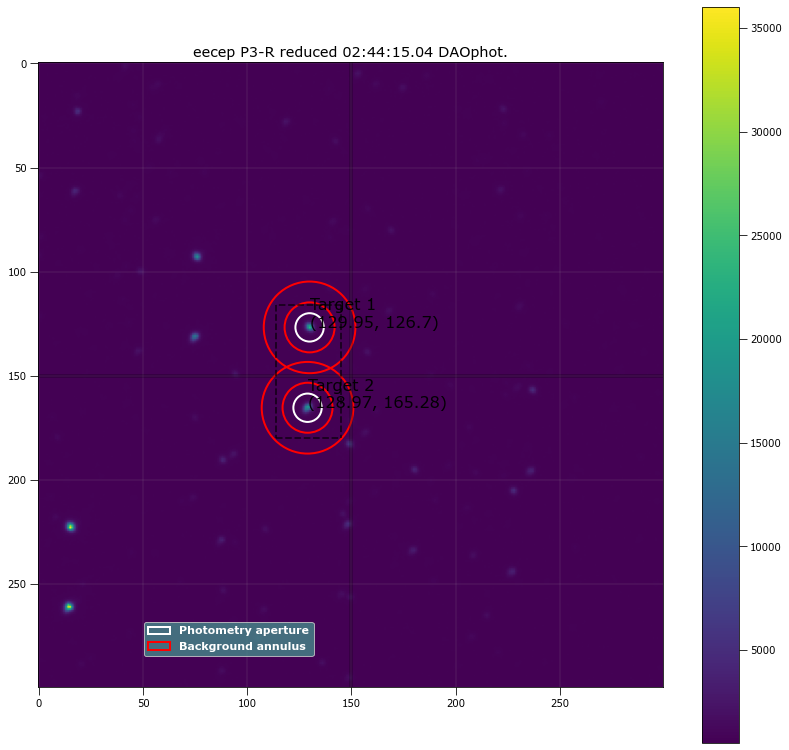

 id  xcenter   ycenter  ... aperture_sum_err_0 aperture_sum_1 aperture_sum_err_1
       pix       pix    ...                                                     
--- --------- --------- ... ------------------ -------------- ------------------
  1 129.95317 126.69545 ...          5270.0418      697612.83           2143.702
  2 128.97055 165.27969 ...          4824.8747      692696.91          2127.9241

 Aperture are: 145.5389326145264 Annulus Area: 1068.1415022205297 

 id  xcenter   ycenter  ... residual_aperture_sum_err residual_aperture_sum
       pix       pix    ...                                                
--- --------- --------- ... ------------------------- ---------------------
  1 129.95317 126.69545 ...                  4977.953             222689.17
  2 128.97055 165.27969 ...                 4534.9358             216928.49

Write this out the excel
507 02:44:15.04 P3-R 20.0 6.80635593220339 129.95317488069907 126.69544862319844 222689.1695415721 4977.953026143124 128

In [59]:
#The pipe!
#we expect 4 targets
#37 doesnt work
#Here is a work around. Incorporate the peak finder into the pipeline and tell the process such that if DAO cannot find the 
#targets, use the peak find coordinates. I suspect the problem is the FWHM.

print("P3-R Filter")

res_apt_sum_list = []

start = 398
end = 508 #So this things sets a new filename for a new file...
filename = astropy.io.fits.open(target[start])[0].header['OBJECT']+"_"+astropy.io.fits.open(target[start])[0].header['FILTER']

workbook = xlsxwriter.Workbook('./stats/'+MJD+"_"+ filename+str(start)+"-" +str(end)  +'.xlsx')
worksheet = workbook.add_worksheet()
worksheet.write('A1', 'int')
worksheet.write('B1', 'time obs')
worksheet.write('C1', 'filter')
worksheet.write('D1', 'exptime')
worksheet.write('E1', 'aperture radius')
worksheet.write('F1', 'target 1 x center')
worksheet.write('G1', 'target 1 y center')
worksheet.write('H1', 'target 1 counts')
worksheet.write('I1', 'target 1 error')
worksheet.write('J1', 'target 2 x center')
worksheet.write('K1', 'target 2 y center')
worksheet.write('L1', 'target 2 counts')
worksheet.write('M1', 'target 2 error')
worksheet.write('N1', 'q')
worksheet.write('O1', 'q error')
worksheet.write('P1', 'u')
worksheet.write('Q1', 'u error')
worksheet.write('R1', 'PD')
worksheet.write('S1', 'PD error')
worksheet.write('T1', 'PA')
worksheet.write('U1', 'PA error')

row = 1
column = 0
search_off = 150
siegma_search = 3
search_bracket = [34, 30, 36, -5]
#Fit variations
#3 to 7
#4.5 to 8
#5 to 8.5

for k in range(start, end ):
    reduced_obj = funcs_calib_and_plot.plot_double_raw_v_reduced(astropy.io.fits.open(target[k]),
                                        [512, 512, 512, 512], 
                                        (m_biast, m_dark, p_3_m_flat), 
                                        False, True, False)

    trial_radii = np.linspace(5, 9.35, num=60)
    target_a = []
    target_b = []
    for radii in trial_radii:
        #Find the position
        DAO_positions = funcs_star_finder.dao_star_finder(reduced_obj, search_bracket, siegma_search, 
                                                          2000, search_off, radii, 12 , 22, False, False)
        
        if (len(DAO_positions) != 2):
            x_targ, y_targ, peak_targ  = funcs_star_finder.source_peak_finder(reduced_obj, 4,search_bracket, 4500 , False, False) #what do I return from this?
            apt_pos = funcs_star_finder.plot_spotted(reduced_obj, search_off, search_bracket , x_targ, y_targ, peak_targ, False, False)
            DAO_positions = funcs_star_finder.peak_to_DAO(apt_pos)        
        
        #Insert Trial
        phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, search_off, search_bracket, DAO_positions, radii, 12 , 22, False, False)
        target_a.append(phot_tab['residual_aperture_sum'][0])
        target_b.append(phot_tab['residual_aperture_sum'][1])

    combine_target = [target_a, target_b]
    
    good_radii=funcs_apt_phot.solve_apt(combine_target, trial_radii, False)

    phot_tab = funcs_apt_phot.apt_phot_local_bkg_sub(reduced_obj, search_off, search_bracket, DAO_positions,good_radii, 12 , 22, True, False)

    res_apt_sum_list.append(phot_tab['residual_aperture_sum'])
    
    print("\nWrite this out the excel")
    print(k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'], #Thats a bug bro
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1],"\n")
    
    write_this = [k, 
          astropy.io.fits.open(target[k])[0].header['TIME-OBS'],
          astropy.io.fits.open(target[k])[0].header['FILTER'],
          astropy.io.fits.open(target[k])[0].header['EXPTIME'],
          good_radii,
          phot_tab['xcenter'][0].value, phot_tab['ycenter'][0].value,
          phot_tab['residual_aperture_sum'][0], phot_tab['residual_aperture_sum_err'][0],
          phot_tab['xcenter'][1].value, phot_tab['ycenter'][1].value,
          phot_tab['residual_aperture_sum'][1], phot_tab['residual_aperture_sum_err'][1]] #It writes by wrow
    
    for item in write_this :
        worksheet.write(row, column, item)
        column += 1
        
    column = 0
    row += 1
    
workbook.close()

target_1 = []
target_2 = []

for things in res_apt_sum_list:
    target_1.append(things[0])
    target_2.append(things[1])